In [1]:
import warnings

In [2]:
from IPython import get_ipython

   ## Тестовое задание на позицию Junior Computer Vision Engineer (Neurus)

   ### Контакты соискателя
   Олег Наволоцкий<br/>
   Email: [...](mailto:...)<br/>
   Telegram: [@oleg_navolotsky](https://t.me/oleg_navolotsky)<br/>
   Телефон: [...](tel:...)<br/>

   ### Поставленная задача
   Тестовое задание было прислано в виде ссылки: https://s.neurus.ru/ml

   Изначально присланная версия тестового задания, которая была доступна по ссылке:
   https://drive.google.com/file/d/1XfebK93SeauFiL6uJ_0uY1Q-43aWlqBP/view?usp=sharing

   Спустя несколько дней задание по ссылке было изменено:
   https://drive.google.com/file/d/1z9bJ3MbkBOK2JIz90ebSseRslT_kyX10/view?usp=sharing

   Первая часть решения покрывает первую, изначальную версию тестового задания.

   Общая часть постановки задачи для обеих версий ТЗ:
   >Необходимо создать и обучить свёрточную нейронную сеть, которая локализует и классифицирует только 1 объект на изображении.
   >
   >Датасет находится в той же папке, где и этот документ.
   >
   >Датасет содержит 1037 изображений кошек и 2348 изображений собак, 3385 всего.
   >К каждому изображению в архиве cats_dogs_dataset.tar соответствует файл разметки RoI (region of interest) изображения. В данном случае это мордочка животного.
   >
   >Файл разметки выполнен в следующей нотации.
   >
   >class xmin ymin xmax ymax
   >
   >Где class это id класса животного. В данном датасете таких класса всего два:
   >1 – кошка
   >2 – собака
   >
   >А xmin ymin xmax ymax это абсолютные координаты bouding box’а на изображении, левого верхнего и правого нижнего углов соответственно.
   >
   >Например, файлу Abyssinian_123.jpg соответствует файл Abyssinian_123.txt, в котором одной
   >строкой записаны следующие цифры:
   >
   >1 153 81 333 221
   >
   >В данном датасете на любом изображении животное присутствует только одно и, как
   >следствие, RoI тоже только один. Один - ни больше, ни меньше.
   >
   >По каждому предложенному Вами решению необходимо прислать полученные метрики точности. Под метрикой точности понимаются два числа: mIoU (см. в ссылках ниже) и
   >accuracy классификации в процентах. Так же необходим численный размер валидационного датасета и время на выполнение одного инференс прохода.
   >
   >Например:
   >mIoU 75%, classification accuracy 94%, 0.09ms, 3000 train, 385 valid.

   ## Используемое ПО и оборудование
   ...

   # Colab & device

In [3]:
COLAB = None
DONT_USE_GPU = None
# DONT_USE_GPU = False

if COLAB is None:
    !pip install imgaug=='0.4.0'
    try:
        import google.colab
    except ModuleNotFoundError:
        COLAB = False
    else:
        COLAB = True

if DONT_USE_GPU is None:
    DONT_USE_GPU = not COLAB

COLAB, DONT_USE_GPU

(True, False)

In [4]:
import torch

if not DONT_USE_GPU and torch.cuda.is_available():
    get_ipython().system('nvidia-smi')

Mon Jun  7 17:04:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P8    12W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

   ## Воспроизводимость
   **Note**: reproducibility depends on [different things](https://pytorch.org/docs/stable/notes/randomness.html):
   >Completely reproducible results are not guaranteed across PyTorch releases, individual commits, or different platforms. Furthermore, results may not be reproducible between CPU and GPU executions, even when using identical seeds.

 ipykernel DeprecationWarning issue fixed:
 https://github.com/ipython/ipykernel/issues/540#event-4516423938
 but ipykernel 6.0 has not been released yet.

In [5]:
import os
import random

import numpy as np
import torch

SEED = 0


def enable_reproducibility(
        seed=SEED, raise_if_no_deterministic=True,
        cudnn_deterministic=True, disable_cudnn_benchmarking=True):
    # https://pytorch.org/docs/stable/notes/randomness.html#avoiding-nondeterministic-algorithms
    torch.use_deterministic_algorithms(raise_if_no_deterministic)

    # https://docs.nvidia.com/cuda/cublas/index.html#cublasApi_reproducibility
    os.environ['CUBLAS_WORKSPACE_CONFIG'] = ":4096:8"

    torch.backends.cudnn.benchmark = not disable_cudnn_benchmarking
    torch.backends.cudnn.deterministic = cudnn_deterministic

    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    try:
        import imgaug as ia
        ia.seed(seed)
    except ImportError:
        pass

In [6]:
enable_reproducibility()

In [7]:
import os

if COLAB:
    get_ipython().system('pip install typing_extensions')
    from google.colab import drive
    drive.mount('/content/drive')
    prev_wd = os.getcwd()
    DATASET_DIR = os.path.join(prev_wd, "cats_dogs_dataset")
    print(f"prev wd: {prev_wd}")
    new_wd = "/content/drive/MyDrive/employers_test_tasks/neurus.ru"
    if not os.path.exists(DATASET_DIR):
        get_ipython().system('mkdir "$DATASET_DIR"')
        get_ipython().system('tar -C "$DATASET_DIR" -xf "$new_wd/cats_dogs_dataset.tar"')
    os.chdir(new_wd)
    CACHE_BASE_DIR = os.path.join(os.getcwd(), ".cache")
    NUM_WORKERS = os.cpu_count()
else:
    CACHE_BASE_DIR = r"C:\.data_science_cache\neurus.ru"
    DATASET_DIR = os.path.join(CACHE_BASE_DIR, "cats_dogs_dataset")
    NUM_WORKERS = 0

print(os.getcwd())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
prev wd: /content
/content/drive/MyDrive/employers_test_tasks/neurus.ru


In [8]:
if COLAB:
    get_ipython().system('ls "$DATASET_DIR" | wc -l')

6770


In [9]:
import os

if COLAB and len(
    [name for name in os.listdir(DATASET_DIR)
     if os.path.isfile(os.path.join(DATASET_DIR, name))]
) != 6770:
    raise ValueError("Colab doesn't want to unpack cats_dogs_dataset.tar properly")

In [10]:
# drive.mount("/content/drive", force_remount=True)
# os.chdir("/content/drive/MyDrive/employers_test_tasks/neurus.ru")

In [11]:
import torch


def try_to_clear_gpu_memory(gpu_related_variables=("model", "optimizer", "criterion", "scheduler")):
    for name in gpu_related_variables:
        try:
            del globals()[name]
        except KeyError:
            pass
    torch.cuda.empty_cache()



In [12]:
import torch

if DONT_USE_GPU:
    DEVICE = torch.device("cpu")
else:
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
DEVICE

device(type='cuda')

   # Данные

   ## Датасет

In [13]:
# os.path.exists("/content/drive/MyDrive/employers_test_tasks/neurus.ru/.cache/cats_dogs_dataset/leonberger_138.jpg")

In [14]:
# os.path.exists("/content/drive/MyDrive/employers_test_tasks/neurus.ru/.cache/cats_dogs_dataset/leonberger_138.txt")

In [15]:
# !ls .cache/cats_dogs_dataset/ | wc -l

In [16]:
# !rm -rf ./.cache/cats_dogs_dataset
# !mkdir ./.cache/cats_dogs_dataset
# !tar -C ./.cache/cats_dogs_dataset -xf cats_dogs_dataset.tar

In [17]:
import glob
import os
from copy import deepcopy

from torch.utils.data import Dataset
from torchvision.io import read_image
from torchvision.io.image import ImageReadMode


def gather_data(folder_path, img_ext=".jpg", annot_ext=".txt", sort=True):
    result = []
    for img_path in glob.glob(os.path.join(folder_path, "*" + img_ext)):
        annot_path = img_path[:-len(img_ext)] + annot_ext
        if not os.path.exists(annot_path):
            raise ValueError(f"cannot find annotation file for {img_path}")
        result.append((img_path, annot_path))
    return sorted(result) if sort else result


class CatsDogsDetectionDataset(Dataset):
    def __init__(self, paths, transform=None, load_bbs_in_rel_coords=False, use_cache=True, cache_transformed=False):
        super().__init__()
        self._paths = tuple(paths)
        self._transform = transform
        self._load_bbs_in_rel_coords = load_bbs_in_rel_coords
        self._use_cache = use_cache
        self._cache_transformed = cache_transformed
        if use_cache:
            self._cache = list([None] * len(paths))

    def _load_data(self, idx):
        img_path, annot_path = self._paths[idx]
        # convert if it is grayscale one, otherwise the tensor
        # will have 1 element in channels dimension:
        img = read_image(img_path, mode=ImageReadMode.RGB)
        with open(annot_path, encoding='utf-8') as file:
            annot_lines = [line.strip() for line in file]
        labels, boxes = [], []
        for line in annot_lines:
            if not line:
                continue
            label, xmin, ymin, xmax, ymax = map(int, line.split())
            labels.append(label)
            if self._load_bbs_in_rel_coords:
                *_, img_h, img_w = img.shape
                boxes.append([xmin / img_w, ymin / img_h, xmax / img_w, ymax / img_h])
            else:
                boxes.append([xmin, ymin, xmax, ymax])
        target = dict(labels=labels, boxes=boxes, idx=idx)
        return img, target

    def __getitem__(self, idx):
        result = None

        if self._use_cache:
            result = self._cache[idx]
            if result is not None:
                if self._cache_transformed:
                    return result
                else:
                    result = deepcopy(result)

        if result is None:
            result = self._load_data(idx)
            if self._use_cache and not self._cache_transformed:
                self._cache[idx] = result
                result = deepcopy(result)

        img, target = result
        labels = torch.tensor(target['labels'])
        boxes = torch.tensor(target['boxes'])

        if self._transform is not None:
            img, boxes = self._transform(img, boxes)

        target['labels'] = labels
        target['boxes'] = boxes
        result = (img, target)

        if self._use_cache and self._cache_transformed:
            self._cache[idx] = result
        return result

    def __len__(self):
        return len(self._paths)

    def get_original_image(self, idx):
        return read_image(self._paths[idx][0], mode=ImageReadMode.RGB)


BACKGROUND_IDX = 0
LABEL_TO_TAG = {BACKGROUND_IDX: 'background', 1: 'cat', 2: 'dog'}

data = gather_data(DATASET_DIR)

   ### Разделение на train-, validation-, test-части

In [18]:
from torch.utils.data import random_split


def random_split_data(data, split_sizes=(0.7,)):
    if any(x < 0 for x in split_sizes):
        raise ValueError("split sizes must be non-negative")
    if not 0 < sum(split_sizes) < 1:
        raise ValueError("split sizes sum must be > 0 and < 1")
    data_len = len(data)
    lengths = [round(data_len * size) for size in split_sizes]
    tail_len = data_len - sum(lengths)
    lengths.append(tail_len)
    splits = random_split(data, lengths=lengths)
    return splits


split_ratio = (0.7, 0.15)
enable_reproducibility()
train_data, valid_data, test_data = splits = random_split_data(data, split_ratio)
tuple(map(len, splits))

(2370, 508, 507)

   ## Аугментация

In [19]:
if COLAB:
    from typing_extensions import Literal
else:
    from typing import Literal

import torch
import torchvision
from torchvision.ops import box_convert


BOX_FORMAT = Literal['xyxy', 'xywh', 'cxcywh']


class ConvertBoundingBoxesToRelativeForm(torch.nn.Module):
    def __init__(self, boundig_boxes_in_fmt: BOX_FORMAT = 'xyxy'):
        super().__init__()
        self._bbs_in_fmt = boundig_boxes_in_fmt

    def forward(self, image: torch.Tensor, boundig_boxes: torch.Tensor):
        *_, img_h, img_w = image.shape
        if self._bbs_in_fmt != 'xyxy':
            boundig_boxes = box_convert(boundig_boxes, in_fmt=self._bbs_in_fmt, out_fmt='xyxy')
        boundig_boxes = boundig_boxes / torch.tensor([img_w, img_h, img_w, img_h])
        if self._bbs_in_fmt != 'xyxy':
            boundig_boxes = box_convert(boundig_boxes, in_fmt='xyxy', out_fmt=self._bbs_in_fmt)
        return image, boundig_boxes

class ResizeWithBoundingBoxes(torchvision.transforms.Resize):
    def forward(self, image: torch.Tensor, boundig_boxes: torch.Tensor):
        resized_image = super().forward(image)
        ratio_in_whwh_form = torch.div(
            torch.as_tensor(resized_image.shape[-2:]),
            torch.as_tensor(image.shape[-2:])
        ).flip(0).repeat(2)
        resized_bounding_boxes = boundig_boxes * ratio_in_whwh_form
        return resized_image, resized_bounding_boxes.type(boundig_boxes.dtype)



import torchvision


class ComposeWithUsingBoundingBoxes(torchvision.transforms.Compose):
    _default_transforms_applicable_to_boxes = [
        ResizeWithBoundingBoxes,
        ConvertBoundingBoxesToRelativeForm
    ]

    def __init__(
            self, transforms,
            transforms_applicable_to_bounding_boxes=None,
            override_default_transforms_applicable_to_boxes=False):
        super().__init__(transforms)
        self.transforms_applicable_to_boxes = (
            [] if override_default_transforms_applicable_to_boxes
            else self._default_transforms_applicable_to_boxes.copy()
        )
        if transforms_applicable_to_bounding_boxes is not None:
            self.transforms_applicable_to_boxes += list(transforms_applicable_to_bounding_boxes)

    def _single_transform_call_impl(self, transform, img, boxes):
        if (
            transform in self.transforms_applicable_to_boxes or
            type(transform) in self.transforms_applicable_to_boxes
        ):
            img, boxes = transform(img, boxes)
        else:
            img = transform(img)
        return img, boxes

    def __call__(self, img, boxes):
        for t in self.transforms:
            img, boxes = self._single_transform_call_impl(t, img, boxes)
        return img, boxes


import imgaug as ia
import imgaug.augmenters as iaa


class ComposeWithUsingBoundingBoxesAndImgaugSupport(ComposeWithUsingBoundingBoxes):
    def _single_transform_call_impl(self, transform, img, boxes):
        if not isinstance(transform, iaa.meta.Augmenter):
            return super()._single_transform_call_impl(transform, img, boxes)
        image = img.permute(1, 2, 0).numpy()
        bounding_boxes = boxes.tolist() if hasattr(boxes, 'tolist') else boxes
        bounding_boxes = [ia.BoundingBox(*box) for box in bounding_boxes]
        image, bounding_boxes = transform(image=image, bounding_boxes=bounding_boxes)
        try:
            img = torch.from_numpy(image).permute(2, 0, 1)
        except ValueError as exc:
            # print(f"Warning ! {exc}")
            if "array.copy()" in exc.args[0]:  # workaround in case of negative strides in ndarray
                img = torch.from_numpy(image.copy()).permute(2, 0, 1)
            else:
                raise
        boxes = torch.vstack([torch.from_numpy(bb.coords.flatten()) for bb in bounding_boxes])
        return img, boxes


from typing import Callable

import matplotlib.pyplot as plt


@torch.no_grad()
def show_transformed_image_with_gt_compared_to_original(tested_transforms: Callable, dataset_with_default_transform, idx=None):
    dataset = dataset_with_default_transform
    original_transforms = dataset._transform

    if idx is None:
        idx = random.randrange(len(dataset))

    print(f"Transformed / original images with boxes for {idx}-th image of the dataset.")

    original_tf_image, original_tf_target = dataset[idx]
    original_tf_gt_boxes = original_tf_target['boxes']

    dataset._transform = tested_transforms
    tested_tf_image, tested_tf_target = dataset[idx]
    tested_tf_gt_boxes = tested_tf_target['boxes']
    dataset._transform = original_transforms

    tested_tf_image = draw_predictions(tested_tf_image, tested_tf_gt_boxes, fill_box=True, box_width=2, show_plot=False)
    original_tf_image = draw_predictions(original_tf_image, original_tf_gt_boxes, fill_box=True, box_width=2, show_plot=False)

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6), squeeze=False)
    axes = axes.flatten()
    axes[0].imshow(tested_tf_image.permute(1, 2, 0))
    axes[0].set_title("tested transforms")
    axes[1].imshow(original_tf_image.permute(1, 2, 0))
    axes[1].set_title("default transforms")
    plt.show()

    return idx, tested_tf_image, tested_tf_target

In [20]:
# All the code in this cell is adopted from here: https://imgaug.readthedocs.io/en/latest/source/examples_basics.html

import imgaug as ia
import imgaug.augmenters as iaa


# A simple and common augmentation sequence
simple_aug_seq_example = iaa.Sequential([
    iaa.Fliplr(0.5), # horizontal flips
    iaa.Crop(percent=(0, 0.1)), # random crops
    # Small gaussian blur with random sigma between 0 and 0.5.
    # But we only blur about 50% of all images.
    iaa.Sometimes(
        0.5,
        iaa.GaussianBlur(sigma=(0, 0.5))
    ),
    # Strengthen or weaken the contrast in each image.
    iaa.LinearContrast((0.75, 1.5)),
    # Add gaussian noise.
    # For 50% of all images, we sample the noise once per pixel.
    # For the other 50% of all images, we sample the noise per pixel AND
    # channel. This can change the color (not only brightness) of the
    # pixels.
    iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
    # Make some images brighter and some darker.
    # In 20% of all cases, we sample the multiplier once per channel,
    # which can end up changing the color of the images.
    iaa.Multiply((0.8, 1.2), per_channel=0.2),
    # Apply affine transformations to each image.
    # Scale/zoom them, translate/move them, rotate them and shear them.
    iaa.Affine(
        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
        translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
        rotate=(-25, 25),
        shear=(-8, 8)
    )
], random_order=True) # apply augmenters in random order


# Heavy Augmentations
sometimes = lambda aug: iaa.Sometimes(0.5, aug)
heavy_aug_seq_example = iaa.Sequential(
    [
        #
        # Apply the following augmenters to most images.
        #
        iaa.Fliplr(0.5), # horizontally flip 50% of all images
        iaa.Flipud(0.2), # vertically flip 20% of all images

        # crop some of the images by 0-10% of their height/width
        sometimes(iaa.Crop(percent=(0, 0.1))),

        # Apply affine transformations to some of the images
        # - scale to 80-120% of image height/width (each axis independently)
        # - translate by -20 to +20 relative to height/width (per axis)
        # - rotate by -45 to +45 degrees
        # - shear by -16 to +16 degrees
        # - order: use nearest neighbour or bilinear interpolation (fast)
        # - mode: use any available mode to fill newly created pixels
        #         see API or scikit-image for which modes are available
        # - cval: if the mode is constant, then use a random brightness
        #         for the newly created pixels (e.g. sometimes black,
        #         sometimes white)
        sometimes(iaa.Affine(
            scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
            translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
            rotate=(-45, 45),
            shear=(-16, 16),
            order=[0, 1],
            cval=(0, 255),
            mode=ia.ALL
        )),

        #
        # Execute 0 to 5 of the following (less important) augmenters per
        # image. Don't execute all of them, as that would often be way too
        # strong.
        #
        iaa.SomeOf((0, 5),
            [
                # Convert some images into their superpixel representation,
                # sample between 20 and 200 superpixels per image, but do
                # not replace all superpixels with their average, only
                # some of them (p_replace).
                sometimes(
                    iaa.Superpixels(
                        p_replace=(0, 1.0),
                        n_segments=(20, 200)
                    )
                ),

                # Blur each image with varying strength using
                # gaussian blur (sigma between 0 and 3.0),
                # average/uniform blur (kernel size between 2x2 and 7x7)
                # median blur (kernel size between 3x3 and 11x11).
                iaa.OneOf([
                    iaa.GaussianBlur((0, 3.0)),
                    iaa.AverageBlur(k=(2, 7)),
                    iaa.MedianBlur(k=(3, 11)),
                ]),

                # Sharpen each image, overlay the result with the original
                # image using an alpha between 0 (no sharpening) and 1
                # (full sharpening effect).
                iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5)),

                # Same as sharpen, but for an embossing effect.
                iaa.Emboss(alpha=(0, 1.0), strength=(0, 2.0)),

                # Search in some images either for all edges or for
                # directed edges. These edges are then marked in a black
                # and white image and overlayed with the original image
                # using an alpha of 0 to 0.7.
                sometimes(iaa.OneOf([
                    iaa.EdgeDetect(alpha=(0, 0.7)),
                    iaa.DirectedEdgeDetect(
                        alpha=(0, 0.7), direction=(0.0, 1.0)
                    ),
                ])),

                # Add gaussian noise to some images.
                # In 50% of these cases, the noise is randomly sampled per
                # channel and pixel.
                # In the other 50% of all cases it is sampled once per
                # pixel (i.e. brightness change).
                iaa.AdditiveGaussianNoise(
                    loc=0, scale=(0.0, 0.05*255), per_channel=0.5
                ),

                # Either drop randomly 1 to 10% of all pixels (i.e. set
                # them to black) or drop them on an image with 2-5% percent
                # of the original size, leading to large dropped
                # rectangles.
                iaa.OneOf([
                    iaa.Dropout((0.01, 0.1), per_channel=0.5),
                    iaa.CoarseDropout(
                        (0.03, 0.15), size_percent=(0.02, 0.05),
                        per_channel=0.2
                    ),
                ]),

                # Invert each image's channel with 5% probability.
                # This sets each pixel value v to 255-v.
                iaa.Invert(0.05, per_channel=True), # invert color channels

                # Add a value of -10 to 10 to each pixel.
                iaa.Add((-10, 10), per_channel=0.5),

                # Change brightness of images (50-150% of original value).
                iaa.Multiply((0.5, 1.5), per_channel=0.5),

                # Improve or worsen the contrast of images.
                iaa.LinearContrast((0.5, 2.0), per_channel=0.5),

                # Convert each image to grayscale and then overlay the
                # result with the original with random alpha. I.e. remove
                # colors with varying strengths.
                iaa.Grayscale(alpha=(0.0, 1.0)),

                # In some images move pixels locally around (with random
                # strengths).
                sometimes(
                    iaa.ElasticTransformation(alpha=(0.5, 3.5), sigma=0.25)
                ),

                # In some images distort local areas with varying strength.
                sometimes(iaa.PiecewiseAffine(scale=(0.01, 0.05)))
            ],
            # do all of the above augmentations in random order
            random_order=True
        )
    ],
    # do all of the above augmentations in random order
    random_order=True
)

 Список преобразований для аугментации

In [21]:
default_train_augmentation_transforms = iaa.Sequential([
    # iaa.AdditiveGaussianNoise(scale=0.05*255),
    # iaa.Affine(translate_px={"x": (300, 50)}),
    iaa.Fliplr(0.5),
    iaa.Resize((0.2, 1.0))
])
# TODO: del this later 
default_train_augmentation_transforms = heavy_aug_seq_example
no_transforms = default_transform = ComposeWithUsingBoundingBoxes([
    # ResizeWithBoundingBoxes((MODEL_IMG_INPUT_SIZE, MODEL_IMG_INPUT_SIZE)),
    ConvertBoundingBoxesToRelativeForm(),
    torchvision.transforms.ConvertImageDtype(torch.float),
    # torchvision.transforms.Normalize(ImagetNet_MEAN, ImageNet_STD)
])
# no_transforms = default_transform
no_transforms_dataset = CatsDogsDetectionDataset(data, no_transforms, use_cache=False)
# tested_transforms = transforms.RandomHorizontalFlip(1)
# show_transformed_image_with_gt_compared_to_original(tested_transforms, no_transforms_dataset);

In [22]:
enable_reproducibility()

import imgaug as ia
import imgaug.augmenters as iaa

seq = iaa.Sequential([
    # iaa.AdditiveGaussianNoise(scale=0.05*255),
    # iaa.Affine(translate_px={"x": (300, 50)}),
    iaa.Crop(percent=(0.3, 0.99), keep_size=False, sample_independently=True),
    # iaa.HorizontalFlip(p=0.5),
])

# seq = simple_aug_seq_example

# images_aug = seq(images=images)
if no_transforms is not None:
    tested_transforms = [seq, *no_transforms.transforms]
else:
    tested_transforms = [seq]
transforms_applicable_to_bounding_boxes = [seq]
tested_transforms = ComposeWithUsingBoundingBoxesAndImgaugSupport(tested_transforms, transforms_applicable_to_bounding_boxes)
# idx, tested_tf_image, tested_tf_target = show_transformed_image_with_gt_compared_to_original(tested_transforms, no_transforms_dataset, idx=1722)

 ## Применение аугментации и преобразование

In [23]:
# Params set according to pretrained MobileNetV3:
MODEL_IMG_INPUT_SIZE = 224
ImagetNet_MEAN = [0.485, 0.456, 0.406]
ImageNet_STD = [0.229, 0.224, 0.225]


default_transform = ComposeWithUsingBoundingBoxes([
    ResizeWithBoundingBoxes((MODEL_IMG_INPUT_SIZE, MODEL_IMG_INPUT_SIZE)),
    ConvertBoundingBoxesToRelativeForm(),
    torchvision.transforms.ConvertImageDtype(torch.float),
    torchvision.transforms.Normalize(ImagetNet_MEAN, ImageNet_STD)
])
train_transform = ComposeWithUsingBoundingBoxesAndImgaugSupport([*default_train_augmentation_transforms, *default_transform.transforms])
valid_transform = test_transform = default_transform
train_dataset = CatsDogsDetectionDataset(train_data, train_transform, cache_transformed=False)
valid_dataset = CatsDogsDetectionDataset(valid_data, valid_transform, cache_transformed=True)
test_dataset = CatsDogsDetectionDataset(test_data, test_transform, cache_transformed=True)
tuple(map(len, (train_dataset, valid_dataset, test_dataset)))

(2370, 508, 507)

   ## Загрузка

In [24]:
from torch.utils.data import DataLoader


def collate_fn(batch):
    collated_images = torch.stack([img for img, _ in batch])
    collated_targets = {}
    for _, target in batch:
        for key, value in target.items():
            try:
                collated_targets[key].append(value)
            except KeyError:
                collated_targets[key] = [value]
    return collated_images, collated_targets


def get_data_loaders(batch_size, num_workers=NUM_WORKERS):
    train_loader = DataLoader(
        train_dataset, batch_size=batch_size, collate_fn=collate_fn, num_workers=num_workers, shuffle=True)
    valid_loader = DataLoader(
        valid_dataset, batch_size=batch_size, collate_fn=collate_fn, num_workers=num_workers)
    test_loader = DataLoader(
        test_dataset, batch_size=batch_size, collate_fn=collate_fn, num_workers=num_workers)
    return train_loader, valid_loader, test_loader


BATCH_SIZE = 8

   # Архитектура сети

In [25]:
from itertools import chain
from typing import Iterable, List, Tuple, Union

if COLAB:
    from typing_extensions import Literal
else:
    from typing import Literal

import torchvision
from torch import nn
from torchvision.ops import box_convert, clip_boxes_to_image


class AuxiliaryConv(nn.Sequential):
    def __init__(
            self, in_channels, out_channels,
            num_channels_decreasing_factor=2, kernel_size=3, bias=True):
        hidden_channels = in_channels // num_channels_decreasing_factor
        super().__init__(
            nn.Conv2d(in_channels, hidden_channels, kernel_size=1, bias=bias),
            nn.BatchNorm2d(hidden_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(hidden_channels, out_channels, kernel_size=kernel_size, bias=bias),
            nn.ReLU(inplace=True))
        self._out_channels = out_channels

    @property
    def out_channels(self):
        return self._out_channels


class SSMBDLikeDetector(nn.Module):
    def __init__(
            self,
            backbone: Iterable[nn.Module], feature_layers_nums: List[int],
            num_aux_layers: int,
            num_classes: int, *,
            priors_aspect_ratios=(1, 2, 1 / 2, 3, 1 / 3),
            extra_priors_aspect_ratios=(1,),
            pred_convs_kwargs=None,
            **kwargs
            # start_scale=0.1,
            # end_scale=0.9
    ):
        super().__init__()

        if pred_convs_kwargs is None:
            pred_convs_kwargs = dict(kernel_size=1, stride=1, padding=0)

        self._feature_layers_nums = tuple(feature_layers_nums)
        self._num_aux_layers = num_aux_layers
        self._num_classes = num_classes
        self._priors_aspect_ratios = priors_aspect_ratios
        self._extra_priors_aspect_ratios = extra_priors_aspect_ratios

        self._num_priors = len(priors_aspect_ratios) + len(extra_priors_aspect_ratios)
        self._priors_scales = [torch.tensor(0.1)] + list(
            torch.linspace(0.2, 0.9, len(feature_layers_nums) + num_aux_layers - 1)
        )
        # self._priors_scales = [0.1] + list(
        #     torch.linspace(0.2, 0.9, len(feature_layers_nums) + num_aux_layers - 1)
        # )
        self._define_layers(backbone, pred_convs_kwargs, **kwargs)
        self._default_boxes_cache = {}
        self._init()

    def _define_layers(self, backbone, pred_convs_kwargs, **kwargs):
        self.backbone_convs = nn.ModuleList(backbone)
        self.auxiliary_convs = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        self._backbone_feature_layers = []
        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)
            self.loc_convs.append(nn.Conv2d(in_channels=layer.out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=layer.out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

        prev_layer = backbone[-1]
        for _ in range(self._num_aux_layers):
            aux_conv = AuxiliaryConv(
                in_channels=prev_layer.out_channels,
                out_channels=prev_layer.out_channels)
            prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            self.loc_convs.append(nn.Conv2d(in_channels=aux_conv.out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=aux_conv.out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

    @torch.no_grad()
    def _init(self):
        for layer in chain(self.auxiliary_convs, self.loc_convs, self.clf_convs):
            for module in layer.modules():
                if isinstance(module, nn.Conv2d):
                    nn.init.xavier_uniform_(module.weight, gain=nn.init.calculate_gain('relu'))
                    module.bias.zero_()

    @property
    def device(self):
        return next(self.parameters()).device

    @property
    def priors_scales(self):
        return self._priors_scales

    def _generate_default_boxes(self, feature_maps_shapes: List[Tuple[int, int]]):
        if len(feature_maps_shapes) != len(self._priors_scales):
            raise ValueError(
                f"length of `feature_maps_shapes` must be equal to {len(self._priors_scales)} "
                "(number of layers used to make predictions).")
        shapes = tuple([tuple(shape[-2:]) for shape in feature_maps_shapes])
        device = self.device

        cached = self._default_boxes_cache.get(shapes)
        if cached is not None:
            cached = self._default_boxes_cache[shapes] = [
                feature_map_boxes.to(device) for feature_map_boxes in cached
            ]
            return list(cached)

        boxes = self._default_boxes_cache[shapes] = []
        for (h, w), scale, subsequent_scale in zip(shapes,
                                                   self._priors_scales,
                                                   self._priors_scales[1:] + [1]):
            feature_map_boxes = []

            cell_half_x = 0.5 / w
            centers_x = torch.linspace(cell_half_x, 1 - cell_half_x, w, device=device)
            cell_half_y = 0.5 / h
            centers_y = torch.linspace(cell_half_y, 1 - cell_half_y, h, device=device)
            # 1st returned value (generated from 1st argument) is chaging over 1st dimension,
            # 2nd returned value (generated from 2nd argument) is chaging over 2nd dimension:
            grid_cy, grid_cx = torch.meshgrid(centers_y, centers_x)

            for ar in self._priors_aspect_ratios:
                ar_root = ar ** 0.5
                grid_w = torch.full((h, w), scale * ar_root, device=device)
                grid_h = torch.full((h, w), scale / ar_root, device=device)
                feature_map_boxes.append(torch.stack([grid_cx, grid_cy, grid_w, grid_h], dim=-1))

            extra_scale = (scale * subsequent_scale) ** 0.5
            for ar in self._extra_priors_aspect_ratios:
                ar_root = ar ** 0.5
                grid_w = torch.full((h, w), extra_scale * ar_root, device=device)
                grid_h = torch.full((h, w), extra_scale / ar_root, device=device)
                feature_map_boxes.append(torch.stack([grid_cx, grid_cy, grid_w, grid_h], dim=-1))

            # from list of tensors of shape of (features dim #1, features dim #2, 4) ->
            # to tensor of shape of (features dim #1, features dim #2, num priors, 4):
            feature_map_boxes = torch.stack(feature_map_boxes, dim=-2)

            # clip the priors which overshooted the edges:
            feature_map_boxes = box_convert(feature_map_boxes, 'cxcywh', 'xyxy')
            feature_map_boxes = clip_boxes_to_image(feature_map_boxes, size=(1.0, 1.0))
            feature_map_boxes = box_convert(feature_map_boxes, 'xyxy', 'cxcywh')

            boxes.append(feature_map_boxes)
        return list(boxes)

    def _predict_offsets_and_scores_impl(self, input):
        boxes_gcx_gcy_gw_gh = []
        boxes_cls_scores = []
        result_conv_num = 0
        features = input
        for conv in self.backbone_convs:
            features = conv(features)
            if conv in self._backbone_feature_layers:
                boxes_gcx_gcy_gw_gh.append(self.loc_convs[result_conv_num](features))
                boxes_cls_scores.append(self.clf_convs[result_conv_num](features))
                result_conv_num += 1
        for conv, loc_conv, clf_conv in zip(self.auxiliary_convs,
                                            self.loc_convs[result_conv_num:],
                                            self.clf_convs[result_conv_num:]):
            features = conv(features)
            boxes_gcx_gcy_gw_gh.append(loc_conv(features))
            boxes_cls_scores.append(clf_conv(features))
        return boxes_gcx_gcy_gw_gh, boxes_cls_scores

    def forward(self, input, out_fmt: BOX_FORMAT = 'xyxy'):
        *_, h, w = input.shape

        boxes_gcx_gcy_gw_gh, boxes_cls_scores = self._predict_offsets_and_scores_impl(input)

        default_boxes_cx_cy_w_h = self._generate_default_boxes(
            [feature_map_boxes.shape[-2:] for feature_map_boxes in boxes_gcx_gcy_gw_gh]
        )
        for i, (defaults, offsets, scores) in enumerate(zip(default_boxes_cx_cy_w_h,
                                                            boxes_gcx_gcy_gw_gh,
                                                            boxes_cls_scores)):
            # from shape of (batch size, num priors * 4, features dim #0, features dim #1) ->
            # to shape of (batch size, num boxes, 4)
            # where num priors is the number of priors per cell and
            # features dim #0 * features dim #1 * num priors is the number of
            # boxes per feature map:
            boxes_gcx_gcy_gw_gh[i] = offsets.permute(0, 2, 3, 1).reshape(offsets.shape[0], -1, 4)
            # reshape related default boxes tensor to the same shape:
            default_boxes_cx_cy_w_h[i] = defaults.view(-1, 4)
            # from shape of (batch size, num priors * num classes, features dim #0, features #1) ->
            # to shape of (batch size, num boxes, num classes):
            boxes_cls_scores[i] = scores.permute(0, 2, 3, 1).reshape(scores.shape[0], -1, self._num_classes)

        # print(f"{default_boxes_cx_cy_w_h[-1].shape = }; {boxes_cls_scores[-1].shape = }")  # TODO: del
        default_boxes_cx_cy_w_h = torch.cat(default_boxes_cx_cy_w_h, dim=0)  # no batch dim
        boxes_gcx_gcy_gw_gh = torch.cat(boxes_gcx_gcy_gw_gh, dim=1)
        boxes_cls_scores = torch.cat(boxes_cls_scores, dim=1)

        def_cx, def_cy, def_w, def_h = default_boxes_cx_cy_w_h.unbind(-1)
        gcx, gcy, gw, gh = boxes_gcx_gcy_gw_gh.unbind(-1)

        # offset the default boxes by the predicted values:
        cx = def_cx + def_w * gcx
        cy = def_cy + def_h * gcy
        w = def_w * gw.exp()
        h = def_h * gh.exp()

        # TODO: debug, turn off offsets to check overlaping default boxes with gt boxes
        # cx = def_cx.expand(input.shape[0], *def_cx.shape) + 0
        # cy = def_cy.expand(input.shape[0], *def_cy.shape) + 0
        # w = def_w.expand(input.shape[0], *def_w.shape) * 1
        # h = def_h.expand(input.shape[0], *def_h.shape) * 1

        boxes_cx_cy_w_h = torch.stack((cx, cy, w, h), dim=-1)
        # print(f"boxes_cx_cy_w_h.shape = {boxes_cx_cy_w_h.shape}")
        # print(f"boxes_cx_cy_w_h.shape = {boxes_cx_cy_w_h.shape}; boxes_cls_scores.shape = {boxes_cls_scores.shape}") # TODO: del
        # return boxes_cx_cy_w_h, boxes_cls_scores, default_boxes_cx_cy_w_h  # TODO: del 3rd
        boxes = boxes_cx_cy_w_h if out_fmt == 'cxcywh' else box_convert(boxes_cx_cy_w_h, 'cxcywh', out_fmt)
        # if out_fmt == 'cxcywh':
        #     boxes = boxes_cx_cy_w_h
        # else:
        #     boxes = box_convert(boxes_cx_cy_w_h, 'cxcywh', out_fmt)
        return boxes, boxes_cls_scores

    def __str__(self):
        return (f"{self.__class__.__name__}<"
                f"feature_layers_nums={self._feature_layers_nums}, "
                f"num_aux_layers={self._num_aux_layers}, "
                f"num_classes={self._num_classes}>")


def build_mobilenetv3_small_based_ssd_detector(
        network: torchvision.models.mobilenetv3.MobileNetV3, num_classes):
    return SSMBDLikeDetector(net.features, feature_layers_nums=(3, 8, 12),
                             num_aux_layers=3, num_classes=num_classes)


# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model_3_8_12 = SSMBDLikeDetector(
#  net.features, feature_layers_nums=(3, 8, 12), num_aux_layers=3, num_classes=3).to(DEVICE)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model_3_8_12(batch)
# print([r.shape for r in results])

   # Утилиты

In [26]:
def count_boxes_overshooted_edges(boxes_cx_cy_h_w):
    cx, cy, w, h = boxes_cx_cy_h_w.unbind(-1)
    overshooted_left_edge = (cx - w / 2) < 0
    overshooted_right_edge = (cx + w / 2) > 1
    overshooted_top_edge = (cy - h / 2) < 0
    overshooted_bottom_edge = (cy + h / 2) > 1
    overshooted = torch.stack(
        (
            overshooted_left_edge,
            overshooted_right_edge,
            overshooted_top_edge,
            overshooted_bottom_edge
        ),
        dim=-1)
    return overshooted.any(dim=-1).sum().item()

   # Метрики

In [27]:
import time

import torch


@torch.no_grad()
def benchmark(model, input_shape=(1024, 1, 32, 32), dtype='fp32',
              nwarmup=50, nruns=1000, device='cuda'):
    was_training = model.training
    model.eval()
    device = torch.device(device)
    if device.type == torch.device('cuda').type:
        was_in_benchmark = torch.backends.cudnn.benchmark
        torch.backends.cudnn.benchmark = True

    input_data = torch.randn(input_shape)
    input_data = input_data.to(device)
    if dtype == 'fp16':
        input_data = input_data.half()

    if nwarmup > 0:
        print("Warm up ...")
    for _ in range(nwarmup):
        model(input_data)
    torch.cuda.synchronize()
    print("Start timing ...")
    timings = []
    for i in range(1, nruns + 1):
        start_time = time.time()
        pred_loc, pred_label, *_ = model(input_data)
        torch.cuda.synchronize()
        end_time = time.time()
        timings.append(end_time - start_time)
        if i % 100 == 0:
            print("Iteration {:d}/{:d}, avg batch time {:.2f} ms".format(
                  i, nruns, torch.tensor(timings).mean() * 1000))

    model.train(was_training)
    if device.type == torch.device('cuda').type:
        torch.backends.cudnn.benchmark = was_in_benchmark

    print("Input shape:", input_data.size())
    print("Output location prediction size:", pred_loc.size())
    print("Output label prediction size:", pred_label.size())
    print("Average batch time: {:.2f} ms".format(torch.tensor(timings).mean() * 1000))

# benchmark(model, input_shape=(1, 3, 224, 224), nwarmup=0, nruns=1, device='cpu')

   # Обучение

   ## Визуализация

In [28]:
from typing import Optional

import ipywidgets
import torch
from IPython.display import clear_output, display
from ipywidgets.widgets.interaction import show_inline_matplotlib_plots

get_ipython().run_line_magic('matplotlib', 'inline')
import matplotlib.pyplot as plt
from torchvision.transforms import functional as TF
from torchvision.utils import draw_bounding_boxes


def show_image(image: torch.Tensor):
    plt.imshow(image.permute(1, 2, 0).cpu())


LABEL_TO_COLOR = {0: 'red', 1: 'yellow', 2: 'purple'}


def draw_predictions(
        image: torch.Tensor, boxes: torch.Tensor, labels: Optional[torch.Tensor] = None, probs: Optional[torch.Tensor] = None,
        *, label2tag=LABEL_TO_TAG, label2color=LABEL_TO_COLOR, fill_box=False, box_width=1, font=None, font_size_ratio_to_img_height=1 / 17, show_plot=False):
    if labels is not None:
        labels = labels.tolist()
        colors = [label2color.get(l, 'blue') for l in labels]
    else:
        colors = ['green'] * len(boxes)
    if labels is not None:
        labels = [label2tag.get(l, "unknown") for l in labels]
        if probs is not None:
            labels = [f"{l}: {round(float(p), 2)}" for l, p in zip(labels, probs)]

    if not isinstance(image, torch.Tensor):
        raise TypeError("`image` must be `torch.Tensor` instance")
    if image.is_floating_point():
        image = TF.convert_image_dtype(image, torch.uint8)
    if boxes.is_floating_point():
        img_w_h = image.shape[-2:][::-1]
        img_w_h_w_h_t = torch.tensor(img_w_h).repeat(2)
        # convert boxes coordinates to absolute form
        boxes = (boxes * img_w_h_w_h_t).round().type(torch.long)
    img_h = image.shape[-2]
    if font_size_ratio_to_img_height is not None:
        font_size = round(img_h * font_size_ratio_to_img_height)
    else:
        font_size = 10
    image = draw_bounding_boxes(image, boxes, labels=labels, colors=colors,
                                fill=fill_box, width=box_width,
                                font=font, font_size=font_size)
    if show_plot:
        show_image(image)
    return image


# output_widget = ipywidgets.Output()

def show_plots_legacy(
        train_loss, train_metrics, valid_loss, valid_metrics,
        image=None, predicted_boxes=None, predicted_boxes_labels=None, predicted_boxes_probs=None,
        ground_truth_boxes=None, ground_truth_boxes_labels=None,
        image_plot_title="boxes prediction example of valid set",
        model_name=None, epoch_num: Optional[None] = None, save_to_file=False, clear_prev_output=False, logscale_loss=False, logscale_metrics=False):

    if save_to_file and (model_name is None or epoch_num is None):
        raise ValueError(
            "both `model_name` and `epoch_num` must be not None "
            f"when `save_to_file={save_to_file}`")

    nrows, ncols = 1, 1
    if train_metrics is not None or valid_metrics is not None:
        ncols += 1
    if image is not None:
        if image.ndim != 3:
            raise TypeError("`image` must be 3-dimensional tensor")
        ncols += 1
        if predicted_boxes is not None:
            image = draw_predictions(image, predicted_boxes, predicted_boxes_labels, predicted_boxes_probs, fill_box=True, box_width=1, show_plot=False)
        if ground_truth_boxes is not None:
            image = draw_predictions(image, ground_truth_boxes, ground_truth_boxes_labels, fill_box=True, box_width=2, show_plot=False)
        if image.shape[0] == 3:
            image = image.permute(1, 2, 0)

    fig, axes = plt.subplots(nrows, ncols, figsize=(6 * ncols, 6 * nrows), squeeze=True)

    ax_idx = 0
    ax = axes[ax_idx]
    if logscale_loss:
        ax.set_yscale('log')
    ax.plot(np.arange(1, len(train_loss) + 1), train_loss, label="train loss", marker='.')
    best_epoch = np.argmin(train_loss)
    best_value = train_loss[best_epoch]
    best_epoch += 1
    ax.axvline(best_epoch, color='r', label=f"best epoch ({best_epoch}) by train loss: {best_value:.3e}")
    ax.legend(loc='best')

    if valid_loss is not None:
        ax.plot(np.arange(1, len(valid_loss) + 1), valid_loss, label="valid loss", marker='.')
        best_epoch = np.argmin(valid_loss)
        best_value = valid_loss[best_epoch]
        best_epoch += 1
        ax.axvline(best_epoch, color='r', label=f"best epoch ({best_epoch}) by valid loss: {best_value:.3e}")
        ax.legend(loc='best')
    ax.set_title("loss")
    ax.set_xlabel("epoch")
    ax.set_ylabel("loss")

    if train_metrics is not None or valid_metrics is not None:
        ax_idx += 1
        ax = axes[ax_idx]
        if logscale_metrics:
            ax.set_yscale('log')
        if train_metrics is not None:
            for name, values in train_metrics.items():
                ax.plot(np.arange(1, len(values) + 1), values, label="train {}".format(name), marker='.')
                best_epoch = np.argmax(values)
                best_value = values[best_epoch]
                best_epoch += 1
                ax.axvline(best_epoch, color='r', label=f"best epoch ({best_epoch}) by train {name}: {best_value:.2f}")
        if valid_metrics is not None:
            for name, values in valid_metrics.items():
                ax.plot(np.arange(1, len(values) + 1), values, label="valid {}".format(name), marker='.')
                best_epoch = np.argmax(values)
                best_value = values[best_epoch]
                best_epoch += 1
                ax.axvline(best_epoch, color='r', label=f"best epoch ({best_epoch}) by valid {name}: {best_value:.2f}")
                # ax.axvline(best_epoch, label="best epoch by {}".format(name))
        ax.legend(loc='best')
        ax.set_title("metrics")
        ax.set_xlabel("epoch")
        ax.set_ylabel("metric")

    if image is not None:
        ax_idx += 1
        ax = axes[ax_idx]
        ax.imshow(image)
        ax.set_title(image_plot_title)

    suptitle_parts = []
    if model_name is not None:
        suptitle_parts.append(model_name)
    if epoch_num is not None:
        suptitle_parts.append(f"epoch {epoch_num}")
    if suptitle_parts:
        fig.suptitle(": ".join(suptitle_parts))

    # display(output_widget)
    # with output_widget:
    #     if clear_prev_output:
    #         clear_output(wait=False)
    #     display(fig)
    #     show_inline_matplotlib_plots()
    # display(output_widget)

    if save_to_file:
        path = get_path_for_saving_plots(model_name, epoch_num)
        # with open(path, 'wb') as file:
        # fig.savefig(file)
        fig.savefig(path)

    if clear_prev_output:
        clear_output(wait=True)

    plt.show()


def prepare_history_storage(
        history: list,
        loss=('train', 'valid'), mIoU=('valid',), accuracy=('valid',),
        gt_boxes_detected=None, mean_num_pos_def_boxes=None, priors_scales_usage=None):
    min_metrics_names = ("loss",)
    metrics = history.setdefault('metrics', {})
    for name, splits in zip(
            [
                "loss", "mIoU", "accuracy",
                "gt_boxes_detected", "mean_num_pos_def_boxes"],
            [
                loss, mIoU, accuracy,
                gt_boxes_detected, mean_num_pos_def_boxes]
    ):
        if splits is not None:
            if isinstance(splits, str):
                splits = (splits,)
            for prefix in splits:
                full_name = f"{prefix} {name}"
                if full_name in metrics:
                    continue
                metrics[full_name] = {
                    "y_values": [], "x_values": [],
                    "best_value_type": "min" if name in min_metrics_names else "max"
                }
    if priors_scales_usage is not None:
        if isinstance(priors_scales_usage, str):
            priors_scales_usage = (priors_scales_usage,)
        priors_scales_usage_history = history.setdefault('priors_scales_usage', {})
        for prefix in priors_scales_usage:
            priors_scales_usage_history.setdefault(prefix, {})


def get_plots_template(
        loss=None, mIoU=None, accuracy=None,
        gt_boxes_detected=None, mean_num_pos_def_boxes=None):
    plots = []
    if loss is not None:
        if isinstance(loss, str):
            loss = (loss,)
        plot = {"title": "loss",
                "ylabel": "loss",
                "xlabel": "epoch",
                "y_logscale": True,
                "lines": []}
        plots.append(plot)
        for prefix in loss:
            line = {"metric_name": f"{prefix} loss",
                    "label": f"{prefix} loss",
                    "show_best": True,
                    "best_value_label_fmt": "best epoch ({best_value_idx}) by {label}: {best_value:.3e}"}
            plot['lines'].append(line)
    if any([x is not None for x in (accuracy, mIoU)]):
        plot = {"title": "metrics",
                "ylabel": "metric",
                "xlabel": "epoch",
                "y_logscale": False,
                "lines": []}
        plots.append(plot)
        if mIoU is not None:
            if isinstance(mIoU, str):
                mIoU = (mIoU,)
            for prefix in mIoU:
                line = {"metric_name": f"{prefix} mIoU",
                        "label": f"{prefix} mIoU",
                        "show_best": True,
                        "best_value_label_fmt": "best epoch ({best_value_idx}) by {label}: {best_value:.2f}"}
                plot['lines'].append(line)
        if accuracy is not None:
            if isinstance(accuracy, str):
                accuracy = (accuracy,)
            for prefix in accuracy:
                line = {"metric_name": f"{prefix} accuracy",
                        "label": f"{prefix} accuracy",
                        "show_best": True,
                        "best_value_label_fmt": "best epoch ({best_value_idx}) by {label}: {best_value:.2f}"}
                plot['lines'].append(line)
    if any([x is not None for x in (gt_boxes_detected,)]):
        plot = {"title": "metrics",
                "ylabel": "metric",
                "xlabel": "epoch",
                "y_logscale": False,
                "lines": []}
        plots.append(plot)
        if gt_boxes_detected is not None:
            if isinstance(gt_boxes_detected, str):
                gt_boxes_detected = (gt_boxes_detected,)
            for prefix in gt_boxes_detected:
                line = {"metric_name": f"{prefix} gt_boxes_detected",
                        "label": f"{prefix} gt_boxes_detected",
                        "show_best": True,
                        "best_value_label_fmt": "best epoch ({best_value_idx}) by {label}: {best_value:.2f}"}
                plot['lines'].append(line)
    if any([x is not None for x in (mean_num_pos_def_boxes,)]):
        plot = {"title": "metrics",
                "ylabel": "metric",
                "xlabel": "epoch",
                "y_logscale": False,
                "lines": []}
        plots.append(plot)
        if mean_num_pos_def_boxes is not None:
            if isinstance(mean_num_pos_def_boxes, str):
                mean_num_pos_def_boxes = (mean_num_pos_def_boxes,)
            for prefix in mean_num_pos_def_boxes:
                line = {"metric_name": f"{prefix} mean_num_pos_def_boxes",
                        "label": f"{prefix} mean_num_pos_def_boxes",
                        "show_best": True,
                        "best_value_label_fmt": "best epoch ({best_value_idx}) by {label}: {best_value:.2f}"}
                plot['lines'].append(line)
    return plots


from typing import Dict, List, Optional


def show_plots_new(
        history: dict, plots_template: Optional[list] = None,
        image=None, predicted_boxes=None, predicted_boxes_labels=None, predicted_boxes_probs=None,
        ground_truth_boxes=None, ground_truth_boxes_labels=None,
        image_plot_title=None,
        model_name=None, epoch_num: Optional[int] = None,
        plots_in_row=3, x_values_enum_start=1, save_to_file=False, clear_prev_output=False):

    metrics_history = history['metrics']

    if plots_template is None:
        used_metrics = {}
        for split_metric_name in metrics_history:
            split_name, metric_name = split_metric_name.split(maxsplit=1)
            used_metrics.setdefault(metric_name, []).append(split_name)
        plots_template = get_plots_template(**used_metrics)

    if save_to_file and (model_name is None or epoch_num is None):
        raise ValueError(
            "both `model_name` and `epoch_num` must be not None "
            f"when `save_to_file={save_to_file}`")

    if image is not None:
        if image.ndim != 3:
            raise TypeError("`image` must be 3-dimensional tensor")
        if predicted_boxes is not None:
            image = draw_predictions(
                image, predicted_boxes, predicted_boxes_labels, predicted_boxes_probs,
                fill_box=True, box_width=1, show_plot=False)
        if ground_truth_boxes is not None:
            image = draw_predictions(
                image, ground_truth_boxes, ground_truth_boxes_labels,
                fill_box=True, box_width=2, show_plot=False)
        if image.shape[0] == 3:
            image = image.permute(1, 2, 0)

    num_plots = len(plots_template) + (1 if image is not None else 0)
    ncols = min(plots_in_row, num_plots)
    nrows = (num_plots + plots_in_row - 1) // plots_in_row

    fig, axes = plt.subplots(nrows, ncols, figsize=(6 * ncols, 6 * nrows), squeeze=False)
    axes = axes.flatten()
    for ax in axes[num_plots:]:
        fig.delaxes(ax)

    for plot, ax in zip(plots_template, axes):
        if plot.get('y_logscale', False):
            ax.set_yscale('log')
        if plot.get('x_logscale', False):
            ax.set_xscale('log')
        title = plot.get('title')
        xlabel = plot.get('xlabel')
        ylabel = plot.get('ylabel')
        if title is not None:
            ax.set_title(title)
        if xlabel is not None:
            ax.set_xlabel(xlabel)
        if ylabel is not None:
            ax.set_ylabel(ylabel)
        for line in plot['lines']:
            metric_history = metrics_history.get(line['metric_name'])
            if metric_history is None:
                continue
            y_values = metric_history['y_values']
            x_values = metric_history['x_values']
            if x_values is None:
                x_values = np.arange(x_values_enum_start, len(y_values) + x_values_enum_start)
            label = line.get('label')
            ax.plot(x_values, y_values, label=label, marker='.')
            if line.get('show_best', False):
                fn = np.argmin if metric_history['best_value_type'] == 'min' else np.argmax
                best_y_value_idx = fn(y_values)
                best_value = y_values[best_y_value_idx]
                best_value_idx = x_values[best_y_value_idx]
                label_fmt = line.get('best_value_label_fmt')
                if label_fmt is not None:
                    ax.axvline(
                        best_value_idx, color='r',
                        label=label_fmt.format(
                            label=label, best_value_idx=best_value_idx, best_value=best_value))
        ax.legend(loc=plot.get('legend_loc', 'best'))

    if image is not None:
        ax = axes[num_plots - 1]
        ax.imshow(image)
        if image_plot_title is not None:
            ax.set_title(image_plot_title)

    suptitle_parts = []
    if model_name is not None:
        suptitle_parts.append(model_name)
    if epoch_num is not None:
        suptitle_parts.append(f"epoch {epoch_num}")
    if suptitle_parts:
        fig.suptitle(": ".join(suptitle_parts))

    # display(output_widget)
    # with output_widget:
    #     if clear_prev_output:
    #         clear_output(wait=False)
    #     display(fig)
    #     show_inline_matplotlib_plots()
    # display(output_widget)

    if save_to_file:
        path = get_path_for_saving_plots(model_name, epoch_num)
        fig.savefig(path)

    if clear_prev_output:
        clear_output(wait=True)

    plt.show()


def show_plots(*args, **kwargs):
    if not args or 'metrics' not in args[0]:
        show_plots_legacy(*args, **kwargs)
    else:
        show_plots_new(*args, **kwargs)

# def find_metric_in_history(train_history, label):
#  for plot in train_history:
#      for line in plot['lines']:
#          if line['label'] == label:
#              return line
#  return None


def show_train_history_plots(history, model_name=None, epochs=None, **kwargs):
    if 'metrics' not in history:
        train_loss = history['train']['loss']
        valid_loss = history['valid']['loss']
        history_train_metrics = history['train']['metrics']
        history_valid_metrics = history['valid']['metrics']
        train_metrics = history_train_metrics if history_train_metrics else None
        valid_metrics = history_valid_metrics if history_valid_metrics else None
        if epochs is None:
            epochs = len(train_loss)
        show_plots(
            train_loss=train_loss,
            train_metrics=train_metrics,
            valid_loss=valid_loss if valid_loss else None,
            valid_metrics=valid_metrics,
            model_name=model_name,
            epoch_num=epochs,
            **kwargs)
        # logscale_loss=True, logscale_metrics=False)
    else:
        train_loss = history['metrics'].get('train loss')
        if train_loss is not None:
            epochs = len(train_loss['y_values'])
        show_plots(history, model_name=model_name, epoch_num=epochs, **kwargs)


def convert_legacy_train_history(legacy_train_history, x_values_enum_start=1):
    metrics = {}
    for split, content in legacy_train_history.items():
        if 'loss' in content:
            prefixes = metrics.setdefault('loss', [])
            prefixes.append(split)
        for metric in content['metrics']:
            prefixes = metrics.setdefault(metric, [])
            prefixes.append(split)
    converted_history = {}
    prepare_history_storage(converted_history, **metrics)
    for split, content in legacy_train_history.items():
        if 'loss' in content:
            copied_values = content['loss']
            label = split + ' ' + 'loss'
            converted_metric_history = converted_history['metrics'][label]
            converted_metric_history['best_value_type'] = 'min'
            converted_metric_history['y_values'].extend(copied_values)
            converted_metric_history['x_values'].extend(
                list(range(x_values_enum_start, x_values_enum_start + len(copied_values)))
            )
        for metric, copied_values in content['metrics'].items():
            label = split + ' ' + metric
            converted_metric_history = converted_history['metrics'][label]
            converted_metric_history['best_value_type'] = 'max'
            converted_metric_history['y_values'].extend(copied_values)
            converted_metric_history['x_values'].extend(
                list(range(x_values_enum_start, x_values_enum_start + len(copied_values)))
            )
    return converted_history

   ## Чекпоинтинг

In [29]:
if COLAB:
    from typing_extensions import Literal
else:
    from typing import Literal

from typing import Optional, Union

MODEL_FILENAME_FMT = "{model_name}.epoch_{epoch}"
MODEL_STORAGE_DIR = os.path.join(CACHE_BASE_DIR, "models")
# MODEL_STORAGE_DIR = os.path.join(CACHE_BASE_DIR, "checkpoints")
# MODEL_TRAINING_PLOTS_DIR = os.path.join(CACHE_BASE_DIR, "plots")


def get_path_for_saving_model(model_name, epoch):
    path = os.path.join(
        MODEL_STORAGE_DIR,
        model_name,
        "checkpoints",
        MODEL_FILENAME_FMT.format(model_name=model_name, epoch=epoch) + '.pt')
    os.makedirs(os.path.dirname(path), exist_ok=True)
    return path


def get_path_for_saving_plots(model_name, epoch):
    path = os.path.join(
        MODEL_STORAGE_DIR,
        model_name,
        "plots",
        MODEL_FILENAME_FMT.format(model_name=model_name, epoch=epoch) + '.png')
    os.makedirs(os.path.dirname(path), exist_ok=True)
    return path


SAVED_EPOCH_TYPE = Literal['best', 'last', 'intermediate']
LOADED_EPOCH_TYPE = Union[int, Literal['best', 'last']]


def save_states_and_train_info(
        model_name, epoch_num: int, train_history, model, optimizer,
        lr_scheduler=None, epoch_type: SAVED_EPOCH_TYPE = 'intermediate', **kwargs):
    path = get_path_for_saving_model(
        model_name, epoch_num if epoch_type == 'intermediate' else epoch_type)
    states = {
        'model_name': model_name,
        'epoch_num': epoch_num,
        'train_history': train_history,
        'model_state': model.state_dict(),
        'optimizer_state': optimizer.state_dict(),
        'lr_scheduler_state': None if lr_scheduler is None else lr_scheduler.state_dict()
    }
    states.update(kwargs)
    directory = os.path.dirname(os.path.abspath(path))
    os.makedirs(directory, exist_ok=True)
    torch.save(states, path)


def load_states_and_train_info(model_name, epoch: LOADED_EPOCH_TYPE = 'best', device='cpu'):
    path = get_path_for_saving_model(model_name, epoch)
    return torch.load(path, map_location=device)


def load_state_dicts_and_get_train_history(
        states: dict, model, optimizer=None, lr_scheduler=None, **kwargs):
    train_history = states['train_history']
    model.load_state_dict(states['model_state'])
    if optimizer is not None:
        optimizer.load_state_dict(states['optimizer_state'])
    if lr_scheduler is not None:
        lr_scheduler.load_state_dict(states['lr_scheduler_state'])
    for key, instance in kwargs.items():
        if not hasattr(instance, 'load_state_dict'):
            raise TypeError(f"{instance} for `{key}` has no `load_state_dict` method")
        if key not in states:
            raise ValueError(f"`{key}` is not found in state dicts")
    return train_history

   ## Матчинг предсказаний и ground truth, функция потерь

In [30]:
import torch
from torchvision.ops import box_iou

# as in the paper: https://arxiv.org/abs/1512.02325
IOU_POSITIVE_MATCH_THRESHOLD = 0.5
HARD_NEGATIVE_MINING_NEG_TO_POS_RATIO = 3
LOCATION_LOSS_COEFF = 1


def compute_image_multibox_loss(
        boxes, gt_boxes, cls_scores, gt_labels,
        loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls,
        *,
        return_num_gt_boxes_covered_with_not_background_preds=False,
        return_num_positive_default_boxes=False,
        return_gt_boxes_covered_with_not_background_preds=False,
        alpha=LOCATION_LOSS_COEFF, background_idx=BACKGROUND_IDX):
    def get_returned_values():
        if num_positives == 0:
            return (
                image_loss,
                torch.tensor(0).item() if return_num_gt_boxes_covered_with_not_background_preds else None,
                num_positives if return_num_positive_default_boxes else None,
                gt_boxes[[]] if return_gt_boxes_covered_with_not_background_preds else None)
        if return_num_gt_boxes_covered_with_not_background_preds or return_gt_boxes_covered_with_not_background_preds:
            idxs_matched_positively = idxs_matched[positive_match_cond]
            not_background_match_cond = positive_cls_scores.argmax(-1) != background_idx
            gt_boxes_covered_with_not_background_preds_idxs = idxs_matched_positively[not_background_match_cond].unique()
        return (
            image_loss,
            gt_boxes_covered_with_not_background_preds_idxs.shape[0] if return_num_gt_boxes_covered_with_not_background_preds else None,
            num_positives if return_num_positive_default_boxes else None,
            gt_boxes[gt_boxes_covered_with_not_background_preds_idxs] if return_gt_boxes_covered_with_not_background_preds else None)
    # it's old_compute_image_multibox_loss because it works better
    device = boxes.device
    loc_criterion = loc_criterion_cls(reduction='sum')
    conf_pos_critertion = conf_pos_critertion_cls(reduction='sum')
    conf_neg_critertion = conf_neg_critertion_cls(reduction='none')

    iou = box_iou(boxes, gt_boxes)
    iou_matched, idxs_matched = iou.max(dim=-1)
    # print(f"iou_matched.shape = {iou_matched.shape} ")
    # print(f"idxs_matched.shape = {idxs_matched.shape} ")
    matched_gt_boxes = gt_boxes[idxs_matched]
    matched_gt_labels = gt_labels[idxs_matched]

    # iou threshold to consider the match as "positive"
    positive_match_cond = iou_matched > IOU_POSITIVE_MATCH_THRESHOLD
    negative_match_cond = ~positive_match_cond

    # print(f"positive_match_cond.shape = {positive_match_cond.shape}; boxes.shape = {boxes.shape}")
    positive_boxes = boxes[positive_match_cond]
    num_positives = positive_boxes.shape[0]
    # no positive matches so according to the paper, set the loss to zero:
    # TODO: debug
    # if num_positives > 100:
    #     print(f"gt_boxes = {gt_boxes}")
    #     print(f"iou = {iou}")
    #     print(f"iou_matched = {iou_matched}")
    #     print(f"positive_match_cond = {positive_match_cond}")
    #     print(f"positive_match_cond.sum() = {positive_match_cond.sum()}")
    #     print(f"iou_matched[positive_match_cond] = {iou_matched[positive_match_cond]}")
    #     print(f"cls_scores[positive_match_cond] = {cls_scores[positive_match_cond]}")
    #     raise Exception("debug")
    if num_positives == 0:
        # TODO: debug
        # raise RuntimeError("no positive matches")
        # non-zero-dimensional float tensor is required to `.cat(batch_losses).mean()` and
        # then `.backward()` because zero-dimensional tensors cannot be concatenated and
        # mean can be calculated only for floating types
        image_loss = torch.tensor([.0]).to(device)
        # or `image_loss = torch.tensor(0, dtype=torch.float).unsqueeze(0)`
        # return image_loss
        return get_returned_values()

    positive_gt_boxes = matched_gt_boxes[positive_match_cond]
    loc_loss = loc_criterion(positive_boxes, positive_gt_boxes)
    # print(f"{loc_loss.item() = }")  # TODO: del

    positive_cls_scores = cls_scores[positive_match_cond]
    positive_gt_labels = matched_gt_labels[positive_match_cond]
    # print(f"positive_cls_scores.shape = {positive_cls_scores.shape}; positive_gt_labels.shape = {positive_gt_labels.shape}")  # TODO: del this
    conf_loss_pos = conf_pos_critertion(positive_cls_scores, positive_gt_labels)

    negative_cls_scores = cls_scores[negative_match_cond]
    negative_gt_labels = torch.full(negative_cls_scores.shape[:-1], background_idx, device=device)
    negatives_losses = conf_neg_critertion(negative_cls_scores, negative_gt_labels)
    num_negatives = negatives_losses.shape[0]
    num_hard_negatives = int(num_positives * HARD_NEGATIVE_MINING_NEG_TO_POS_RATIO)
    if num_negatives > num_hard_negatives:
        hard_negatives_losses, _ = negatives_losses.topk(num_hard_negatives, largest=True, sorted=False)
    else:
        hard_negatives_losses = negatives_losses
    # print(f"num_positives = {num_positives}; hard_negatives_losses.shape = {hard_negatives_losses.shape}") # TODO: del this
    # multiplied by the ratio because all the three losses are
    # reduced by the same number of positives in the paper:
    # conf_loss_neg = hard_negatives_losses.sum() * HARD_NEGATIVE_MINING_NEG_TO_POS_RATIO
    conf_loss_neg = hard_negatives_losses.sum()

    # print(f"{conf_loss_pos.item() = }; {conf_loss_neg.item() = }; {loc_loss.item() = }") # TODO: del, #2
    # print(f"conf_loss_pos = {conf_loss_pos}; conf_loss_neg = {conf_loss_neg}; loc_loss = {loc_loss}")
    # all the losses are reduced by the same number of positives in the paper:
    image_loss = torch.unsqueeze(
        (conf_loss_pos + conf_loss_neg + alpha * loc_loss) / num_positives, dim=0)
    # if return_num_positives or return_not_gt_boxes_covered_with_not_background_preds:
    #     result = [image_loss, None, None]
    # else:
    #     result = image_loss
    # if return_num_positives:
    #     result[1] = num_positives
    # if return_not_gt_boxes_covered_with_not_background_preds:
    #     gt_boxes_idxs = torch.arange(0, gt_boxes.shape[-1], device=device)
    #     covered_gt_boxes_idxs = idxs_matched.unique()
    #     not_convered_gt_boxes_idxs = torch.tensor(
    #         [idx for idx in gt_boxes_idxs if idx not in covered_gt_boxes_idxs],
    #         device=device)
    #     not_gt_boxes_covered_with_not_background_preds = gt_boxes.index_select(dim=-1, index=not_convered_gt_boxes_idxs)
    #     result[2] = not_gt_boxes_covered_with_not_background_preds
    # return result
    return get_returned_values()

   ## Фильтрация предсказаний

In [31]:
from typing import Iterable, Union

import torch
from torchvision.ops import batched_nms

# as in the paper (they seemed to be used in inference time to calculate mAP)
NMS_IOU_THRESHOLD = 0.45
CONFIDENCE_THRESHOLD = 0.01
NUM_TOP_DETECTIONS = 200


def filter_image_boxes_predictions(
        boxes: torch.Tensor, cls_scores: torch.Tensor,
        confidence_threshold=CONFIDENCE_THRESHOLD,
        nms_iou_threshold=NMS_IOU_THRESHOLD,
        topk: int = NUM_TOP_DETECTIONS,
        background_idx: int = BACKGROUND_IDX,
        not_to_filter_out_background_boxes=False):
    """Return filtered boxes, labels, probabilities

    Args:
        boxes: `torch.Tensor` of shape of (N, 4) with N boxes
            and 4 coordinates in format `xyxy`
        cls_scores: `torch.Tensor` of shape of (N, M) with logits
            where M is number of the classes
    """
    cls_probs = cls_scores.softmax(-1)
    box_probs, labels = cls_probs.max(-1)

    if not_to_filter_out_background_boxes:
        not_background_cond = torch.ones_like(labels).bool()
    else:
        not_background_cond = labels != background_idx
    confident_preds_cond = box_probs > confidence_threshold

    not_background_confident_preds_cond = not_background_cond & confident_preds_cond
    confident_boxes = boxes[not_background_confident_preds_cond]
    confident_boxes_probs = box_probs[not_background_confident_preds_cond]
    confident_boxes_labels = labels[not_background_confident_preds_cond]
    proper_boxes_idxs = batched_nms(
        confident_boxes, confident_boxes_probs, confident_boxes_labels, nms_iou_threshold)
    proper_boxes_idxs = proper_boxes_idxs[:topk]
    proper_boxes = confident_boxes[proper_boxes_idxs]
    proper_boxes_probs = confident_boxes_probs[proper_boxes_idxs]
    proper_boxes_labels = confident_boxes_labels[proper_boxes_idxs]

    return proper_boxes, proper_boxes_labels, proper_boxes_probs


@torch.no_grad()
def make_prediction(
        model: torch.nn.Module, data: Union[torch.Tensor, torch.utils.data.DataLoader],
        *, confidence_threshold=CONFIDENCE_THRESHOLD, nms_iou_threshold=NMS_IOU_THRESHOLD, topk=NUM_TOP_DETECTIONS,
        out_fmt: BOX_FORMAT = 'xyxy', background_idx=BACKGROUND_IDX,
        not_to_filter_out_background_boxes=False, device='cpu'):
    def batch_predict(batch):
        results = []
        batch = batch.to(device)
        batch_boxes, batch_cls_scores = model(batch, out_fmt=out_fmt)
        if out_fmt != 'xyxy':
            batch_boxes = box_convert(batch_boxes, in_fmt=out_fmt, out_fmt='xyxy')
        for boxes, cls_scores in zip(batch_boxes, batch_cls_scores):
            # print(f"boxes.shape = {boxes.shape}")# TODO: del
            filtered_boxes, labels, probs = filter_image_boxes_predictions(
                boxes, cls_scores,
                confidence_threshold, nms_iou_threshold, topk, background_idx,
                not_to_filter_out_background_boxes)
            if out_fmt != 'xyxy':
                filtered_boxes = box_convert(filtered_boxes, in_fmt='xyxy', out_fmt=out_fmt)
            results.append((filtered_boxes, labels, probs))
        return results
    was_training = model.training
    model.eval()
    single_image_passed = False
    predictions = []
    unappropriate_data_type_msg = (
        "`data` must be 4-dimensional (image batch) or 3-dimensional (single image) tensor,"
        " or `torch.utils.data.DataLoader` of such tensors")
    if isinstance(data, torch.Tensor):
        if data.ndim == 3:
            single_image_passed = True
            data = data.unsqueeze(0)
        elif data.ndim != 4:
            raise TypeError(unappropriate_data_type_msg)
        predictions.extend(batch_predict(data))
    elif isinstance(data, torch.utils.data.DataLoader):
        data_loader_with_unappropriate_data_type_msg_msg = (
            "got data of unknown type from passed `data` argument of "
            "type `torch.utils.data.DataLoder`, "
            "`torch.Tensor` or `Iterable` containing of the such one expected")
        for d in data:
            if not isinstance(d, torch.Tensor):
                if not isinstance(d, Iterable):
                    raise TypeError(data_loader_with_unappropriate_data_type_msg_msg)
                for batch in d:
                    if isinstance(batch, torch.Tensor):
                        break
                else:
                    raise TypeError(data_loader_with_unappropriate_data_type_msg_msg)
            else:
                batch = d
            predictions.extend(batch_predict(batch))
    else:
        raise TypeError(unappropriate_data_type_msg)
    model.train(was_training)
    return predictions[0] if single_image_passed else predictions

   ## Цикл обучения

In [32]:
import torch
from tqdm.notebook import tqdm


@torch.no_grad()
def count_boxes_that_seem_to_must_be_matched_to_prior_boxes_with_given_scales(priors_scales, boxes):  # , device=None):
    # if not boxes.is_floating_point():
    #     raise TypeError("`boxes` must contain coordinates in relative format (xmin, ymin, xmax, ymax)")
    # priors_scales = torch.tensor(model._priors_scales, device=device)
    if boxes.shape[0] == 0:
        raise ValueError('`boxes` must not be empty')
    priors_scales_t = torch.tensor(priors_scales, device=boxes.device)
    priors_areas = priors_scales_t * priors_scales_t
    xmin, ymin, xmax, ymax = boxes.unbind(-1)
    boxes_areas = (xmax - xmin) * (ymax - ymin)
    correct_boxes_areas = boxes_areas[boxes_areas > 0]
    prior_to_gt_area_diff = (priors_areas.unsqueeze(-1) - correct_boxes_areas).abs()
    priors_idxs, num_matched_boxes = prior_to_gt_area_diff.argmin(0).unique(return_counts=True, sorted=True)
    return [priors_scales[idx] for idx in priors_idxs], num_matched_boxes


class MetricsCalculator:
    _instances = []

    def __init__(self, mIoU=False, accuracy=False, mAP=False,
                 gt_boxes_detected=False, mean_num_pos_def_boxes=False,
                 priors_scales_usage=False, priors_scales=None,
                 iou_positive_match_threshold=IOU_POSITIVE_MATCH_THRESHOLD,
                 confidence_threshold=CONFIDENCE_THRESHOLD, nms_iou_threshold=NMS_IOU_THRESHOLD, topk=NUM_TOP_DETECTIONS,
                 # alpha=LOCATION_LOSS_COEFF,
                 background_idx=BACKGROUND_IDX):  # , device='cpu'):
        # TODO: debug
        self.__class__._instances.append(self)

        for key, value in locals().items():
            if key != 'self':
                setattr(self, key, value)

        if priors_scales_usage and priors_scales is None:
            raise ValueError(f"`priors_scales` must be given when `priors_scales_usage={priors_scales_usage}`")

        self.total_images = 0
        self.total_gt_boxes = 0

        if self.mIoU:
            self.top1_iou_sum = 0
        if self.accuracy:
            self.top1_tp_tn_preds, self.total_cls_preds = 0, 0
        if self.gt_boxes_detected:
            self.num_gt_boxes_covered_with_not_background_preds = 0
        if self.mean_num_pos_def_boxes:
            self.num_positive_default_boxes = 0
        if self.priors_scales_usage:
            self.priors_scales_to_num_gt_boxes = dict.fromkeys(priors_scales, 0)
            self.priors_scales_to_num_gt_boxes_covered_with_not_background_preds = dict.fromkeys(priors_scales, 0)

    @torch.no_grad()
    def update(self, gt_boxes, gt_labels, raw_boxes, raw_cls_scores,
               filtered_boxes=None, filtered_boxes_labels=None, filtered_boxes_probs=None,
               num_gt_boxes_covered_with_not_background_preds=None, num_positive_default_boxes=None, gt_boxes_covered_with_not_background_preds=None):
        if self.gt_boxes_detected and num_gt_boxes_covered_with_not_background_preds is None:
            raise ValueError("`num_gt_boxes_covered_with_not_background_preds` is required to calc `gt_boxes_detected`")
        if self.mean_num_pos_def_boxes and num_positive_default_boxes is None:
            raise ValueError("`gt_boxes_detected` is required to calc `mean_num_pos_def_boxes`")
        if self.priors_scales_usage and gt_boxes_covered_with_not_background_preds is None:
            raise ValueError("`gt_boxes_covered_with_not_background_preds` is required to calc `priors_scales_usage`")

        self.total_images += 1
        self.total_gt_boxes += gt_boxes.shape[0]
        if filtered_boxes is None:
            filtered_boxes, filtered_boxes_labels, filtered_boxes_probs = filter_image_boxes_predictions(
                raw_boxes, raw_cls_scores,
                self.confidence_threshold, self.nms_iou_threshold, self.topk, self.background_idx)

        if self.mIoU or self.accuracy:
            if gt_boxes.shape[0] != 1:
                raise ValueError(
                    "image must have exactly one ground truth box to be "
                    "able used in calculation mIoU or accuracy")
            predictions_empty = filtered_boxes.shape[0] == 0
            if not predictions_empty:
                max_confident_idx = filtered_boxes_probs.argmax(dim=-1)
                max_condfident_box = filtered_boxes[max_confident_idx]
                max_condfident_box_label = filtered_boxes_labels[max_confident_idx]
                iou = box_iou(max_condfident_box.unsqueeze(0), gt_boxes).item()
                if self.mIoU:
                    self.top1_iou_sum += iou
                if self.accuracy and iou > self.iou_positive_match_threshold:
                    self.top1_tp_tn_preds += (gt_labels[0] == max_condfident_box_label).item()
                    self.total_cls_preds += 1
        if self.mAP:
            raise NotImplementedError
        if self.gt_boxes_detected:
            self.num_gt_boxes_covered_with_not_background_preds += num_gt_boxes_covered_with_not_background_preds
        if self.mean_num_pos_def_boxes:
            self.num_positive_default_boxes += num_positive_default_boxes
        if self.priors_scales_usage:
            if gt_boxes_covered_with_not_background_preds.shape[0] != 0:
                results = count_boxes_that_seem_to_must_be_matched_to_prior_boxes_with_given_scales(self.priors_scales, gt_boxes_covered_with_not_background_preds)
                for prior_scale, num_boxes in zip(*results):
                    self.priors_scales_to_num_gt_boxes_covered_with_not_background_preds[prior_scale] += num_boxes.item()
            results = count_boxes_that_seem_to_must_be_matched_to_prior_boxes_with_given_scales(self.priors_scales, gt_boxes)
            for prior_scale, num_boxes in zip(*results):
                self.priors_scales_to_num_gt_boxes[prior_scale] += num_boxes.item()

    def results(self):
        metrics = {}
        if self.mIoU:
            metrics.update(mIoU=self.top1_iou_sum / self.total_images)
        if self.accuracy:
            metrics.update(accuracy=0 if self.total_cls_preds == 0 else self.top1_tp_tn_preds / self.total_cls_preds)
        if self.mAP:
            raise NotImplementedError
        if self.gt_boxes_detected:
            metrics.update(gt_boxes_detected=self.num_gt_boxes_covered_with_not_background_preds / self.total_gt_boxes)
        if self.mean_num_pos_def_boxes:
            metrics.update(mean_num_pos_def_boxes=self.num_positive_default_boxes / self.total_images)
        if self.priors_scales_usage:
            priors_scales_usage_report = {}
            for prior_scale in self.priors_scales:
                num_pos_gt_boxes = self.priors_scales_to_num_gt_boxes_covered_with_not_background_preds[prior_scale]
                num_gt_boxes = self.priors_scales_to_num_gt_boxes[prior_scale]
                if isinstance(prior_scale, torch.Tensor):
                    prior_scale = prior_scale.item()
                priors_scales_usage_report[prior_scale] = dict(
                    gt_boxes_detected=num_pos_gt_boxes / num_gt_boxes if num_gt_boxes else 0,
                    gt_boxes_total=num_gt_boxes)
            metrics.update(priors_scales_usage=priors_scales_usage_report)
        return metrics


def train_epoch(
        model, data_loader,
        loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls, optimizer,
        *, max_grad_norm=None, calc_mIoU=False, calc_accuracy=False, calc_mAP=False,
        calc_gt_boxes_detected=False, calc_mean_num_pos_def_boxes=False,
        report_priors_scales_usage=False,
        confidence_threshold=CONFIDENCE_THRESHOLD, nms_iou_threshold=NMS_IOU_THRESHOLD, topk=NUM_TOP_DETECTIONS,
        alpha=LOCATION_LOSS_COEFF, background_idx=BACKGROUND_IDX, device='cpu'):

    was_training = model.training
    model.train()

    epoch_loss_sum = 0
    total_images = 0

    metrics_calc = MetricsCalculator(
        mIoU=calc_mIoU, accuracy=calc_accuracy, mAP=calc_mAP,
        gt_boxes_detected=calc_gt_boxes_detected,
        mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes,
        priors_scales_usage=report_priors_scales_usage,
        priors_scales=None if not report_priors_scales_usage else model.priors_scales,
        confidence_threshold=confidence_threshold, nms_iou_threshold=nms_iou_threshold, topk=topk,
        # alpha=LOCATION_LOSS_COEFF,
        background_idx=background_idx  # , device=device
    )

    for batch in tqdm(data_loader, desc="training", leave=False):
        images, targets = batch
        images = images.to(device)

        optimizer.zero_grad()
        batch_boxes_xmin_ymin_xmax_ymax, batch_cls_scores = model(images, out_fmt='xyxy')

        batch_losses = []
        for boxes, gt_boxes, cls_scores, gt_labels in zip(batch_boxes_xmin_ymin_xmax_ymax,
                                                          targets['boxes'],
                                                          batch_cls_scores,
                                                          targets['labels']):
            gt_boxes = gt_boxes.to(device)
            gt_labels = gt_labels.to(device)
            # print(f"gt_boxes.shape = {gt_boxes.shape} & gt_labels.shape = {gt_labels.shape} before, ", end='') # TODO: del, this is for debug
            # gt_boxes = gt_boxes.repeat(3, 1) # TODO: del, this is for debug
            # gt_labels = gt_labels.repeat(3) # TODO: del, this is for debug
            # print(f"for debug we fake it: gt_boxes.shape = {gt_boxes.shape} & gt_labels.shape = {gt_labels.shape}") # TODO: del, this is for debug
            image_loss, num_gt_boxes_covered_with_not_background_preds, num_positive_default_boxes, gt_boxes_covered_with_not_background_preds = compute_image_multibox_loss(
                boxes, gt_boxes, cls_scores, gt_labels,
                loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls,
                return_num_gt_boxes_covered_with_not_background_preds=calc_gt_boxes_detected,
                return_num_positive_default_boxes=calc_mean_num_pos_def_boxes,
                return_gt_boxes_covered_with_not_background_preds=report_priors_scales_usage,
                alpha=alpha, background_idx=background_idx)
            batch_losses.append(image_loss)
            epoch_loss_sum += image_loss.item()
            total_images += 1

            metrics_calc.update(
                gt_boxes, gt_labels, boxes, cls_scores,
                num_gt_boxes_covered_with_not_background_preds=num_gt_boxes_covered_with_not_background_preds,
                num_positive_default_boxes=num_positive_default_boxes,
                gt_boxes_covered_with_not_background_preds=gt_boxes_covered_with_not_background_preds)

        batch_loss = torch.cat(batch_losses).mean()
        if batch_loss.isnan():
            raise RuntimeError(
                "batch loss got a not-a-number value:\n"
                f"batch_losses = {batch_losses}")

        # [sometimes happens] all images in the batch have no positive matches
        # so go to the next:
        if not batch_loss.requires_grad:
            print(f"all images in the batch have no positive matches")
            continue
        batch_loss.backward()
        if max_grad_norm is not None:
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
        optimizer.step()
        check_res = is_there_nan_params_named(model)
        if check_res is not None:
            raise RuntimeError(f"Name of param with nan: {check_res}")

    metrics = metrics_calc.results()
    epoch_mean_loss = epoch_loss_sum / total_images
    metrics.update(loss=epoch_mean_loss)
    model.train(was_training)
    return metrics


@torch.no_grad()
def evaluate(
        model, data_loader,
        loc_criterion_cls=None, conf_pos_critertion_cls=None, conf_neg_critertion_cls=None,
        *, test=False, calc_mIoU=False, calc_accuracy=False, calc_mAP=False,
        calc_gt_boxes_detected=False, calc_mean_num_pos_def_boxes=False,
        report_priors_scales_usage=False,
        prediction_example_choosing: Literal['first', 'last', 'random', 'none'] = 'none',
        confidence_threshold=CONFIDENCE_THRESHOLD, nms_iou_threshold=NMS_IOU_THRESHOLD, topk=NUM_TOP_DETECTIONS,
        alpha=LOCATION_LOSS_COEFF, background_idx=BACKGROUND_IDX, device='cpu'):

    loss_clss_none = [x is None for x in (
        loc_criterion_cls, conf_pos_critertion_cls, conf_pos_critertion_cls)]
    if any(loss_clss_none) and not all(loss_clss_none):
        raise ValueError(
            "either all of "
            "`loc_criterion_cls`, "
            "`conf_pos_critertion_cls`, "
            "`conf_pos_critertion_cls` "
            "args must be None or no one must"
        )
    if (
        calc_gt_boxes_detected or
        calc_mean_num_pos_def_boxes or
        report_priors_scales_usage
    ):
        if any(loss_clss_none):
            raise ValueError(
                "all of "
                "`loc_criterion_cls`, "
                "`conf_pos_critertion_cls`, "
                "`conf_pos_critertion_cls` "
                "args must be given when at least one of the `calc_gt_boxes_detected`, "
                "`calc_mean_num_pos_def_boxes` "
                "`report_priors_scales_usage` params set to True"
            )
        else:
            calc_loss_as_by_product = True
    else:
        calc_loss_as_by_product = False

    calc_loss = not all(loss_clss_none)

    was_training = model.training
    model.eval()

    epoch_loss_sum = 0
    total_images = 0

    metrics_calc = MetricsCalculator(
        mIoU=calc_mIoU, accuracy=calc_accuracy, mAP=calc_mAP,
        gt_boxes_detected=calc_gt_boxes_detected,
        mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes,
        priors_scales_usage=report_priors_scales_usage,
        priors_scales=None if not report_priors_scales_usage else model.priors_scales,
        confidence_threshold=confidence_threshold, nms_iou_threshold=nms_iou_threshold, topk=topk,
        # alpha=LOCATION_LOSS_COEFF,
        background_idx=background_idx  # , device=device
    )

    prediction_example = None
    prediction_example_image_num = torch.randint(len(data_loader.dataset), (1,)).item()

    for batch in tqdm(data_loader, desc="testing" if test else "validation", leave=False):
        images, targets = batch
        images = images.to(device)

        batch_boxes_xmin_ymin_xmax_ymax, batch_cls_scores = model(images, out_fmt='xyxy')

        for boxes, gt_boxes, cls_scores, gt_labels, image_idx in zip(batch_boxes_xmin_ymin_xmax_ymax,
                                                                     targets['boxes'],
                                                                     batch_cls_scores,
                                                                     targets['labels'],
                                                                     targets['idx']):
            gt_boxes = gt_boxes.to(device)
            gt_labels = gt_labels.to(device)
            # print(f"gt_boxes.shape = {gt_boxes.shape} & gt_labels.shape = {gt_labels.shape} before, ", end='') # TODO: del, this is for debug
            # gt_boxes = gt_boxes.repeat(3, 1) # TODO: del, this is for debug
            # gt_labels = gt_labels.repeat(3) # TODO: del, this is for debug
            # print(f"for debug we fake it: gt_boxes.shape = {gt_boxes.shape} & gt_labels.shape = {gt_labels.shape}") # TODO: del, this is for debug
            if calc_loss or calc_loss_as_by_product:
                image_loss, num_gt_boxes_covered_with_not_background_preds, num_positive_default_boxes, gt_boxes_covered_with_not_background_preds = compute_image_multibox_loss(
                    boxes, gt_boxes, cls_scores, gt_labels,
                    loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls,
                    return_num_gt_boxes_covered_with_not_background_preds=calc_gt_boxes_detected,
                    return_num_positive_default_boxes=calc_mean_num_pos_def_boxes,
                    return_gt_boxes_covered_with_not_background_preds=report_priors_scales_usage,
                    alpha=alpha, background_idx=background_idx)
                epoch_loss_sum += image_loss.item()

            image_boxes_predictions_filtered = filter_image_boxes_predictions(
                boxes, cls_scores,
                confidence_threshold, nms_iou_threshold, topk, background_idx)
            image_boxes, image_boxes_labels, image_boxes_probs = image_boxes_predictions_filtered
            predictions_empty = image_boxes.shape[0] == 0
            if predictions_empty:
                image_boxes = image_boxes_labels = image_boxes_probs = None

            metrics_calc.update(
                gt_boxes, gt_labels, boxes, cls_scores,
                *image_boxes_predictions_filtered,
                num_gt_boxes_covered_with_not_background_preds=num_gt_boxes_covered_with_not_background_preds,
                num_positive_default_boxes=num_positive_default_boxes,
                gt_boxes_covered_with_not_background_preds=gt_boxes_covered_with_not_background_preds)

            if (
                prediction_example is None and
                (
                    prediction_example_choosing == 'first' or
                    (
                        prediction_example_choosing == 'random' and
                        total_images == prediction_example_image_num
                    )
                )
            ):
                image = data_loader.dataset.get_original_image(image_idx).to(device)
                prediction_example = [image, image_boxes, image_boxes_labels, image_boxes_probs, gt_boxes, gt_labels]

            total_images += 1

    if (
        prediction_example_choosing == 'last' or
        (prediction_example_choosing == 'random' and prediction_example is None)
    ):
        image = data_loader.dataset.get_original_image(image_idx).to(device)
        prediction_example = [image, image_boxes, image_boxes_labels, image_boxes_probs, gt_boxes, gt_labels]

    metrics = metrics_calc.results()
    if calc_loss:
        epoch_mean_loss = epoch_loss_sum / total_images
        metrics.update(loss=epoch_mean_loss)
    model.train(was_training)
    return metrics, prediction_example


import enum


class MetricsCalculation(enum.Enum):
    neither = None
    train = 'train'
    valid = 'valid'
    both = ('train', 'valid')


def get_priors_scales_usage_report_text(priors_scales_usage, split, epoch_num):
    priors_scales_usage_report = ""
    priors_scales_usage_report += f"priors scales usage report for {split} (epoch {epoch_num}):\n"
    priors_scales_usage_report += '-' * 11 + '---' + '-' * 17 + '---' + '-' * 14 + '\n'
    priors_scales_usage_report += "prior scale | gt boxes detected | gt boxes total\n"
    priors_scales_usage_report += '-' * 11 + '---' + '-' * 17 + '---' + '-' * 14 + '\n'
    priors_scales_usage_report += "\n".join(
        f"{scale:11.2f} | {usage['gt_boxes_detected']:17.2f} | {int(usage['gt_boxes_total']):14,d}"
        for scale, usage in priors_scales_usage.items()
    ) + '\n'
    priors_scales_usage_report += '-' * 11 + '---' + '-' * 17 + '---' + '-' * 14 + '\n'
    return priors_scales_usage_report


def train(
        history: List[Dict],
        model_name, model, num_epochs, train_loader,
        loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls,
        optimizer, valid_loader, *,
        lr_scheduler=None, lr_scheduler_1st_epoch=None, use_valid_loss_for_scheduler=False, init_epoch_callback=None, max_grad_norm=None,
        calc_mIoU=MetricsCalculation.neither, calc_accuracy=MetricsCalculation.neither,
        calc_gt_boxes_detected=MetricsCalculation.neither, calc_mean_num_pos_def_boxes=MetricsCalculation.neither,
        report_priors_scales_usage=MetricsCalculation.neither,
        save_at_every_epoch=True,
        prediction_example_choosing: Literal['first', 'last', 'random', 'none'] = 'first',
        show_only_last_plot=True, save_plots=True,
        early_stopping=False, es_patience=5, es_rel_threshold=5e-2, use_valid_loss_for_es=True,
        confidence_threshold=CONFIDENCE_THRESHOLD, nms_iou_threshold=NMS_IOU_THRESHOLD, topk=NUM_TOP_DETECTIONS,
        alpha=LOCATION_LOSS_COEFF, background_idx=BACKGROUND_IDX, device='cpu', resume=False):
    TRAIN_PREFIX = 'train'
    VALID_PREFIX = 'valid'

    calc_mIoU = MetricsCalculation(calc_mIoU)
    calc_accuracy = MetricsCalculation(calc_accuracy)
    calc_gt_boxes_detected = MetricsCalculation(calc_gt_boxes_detected)
    calc_mean_num_pos_def_boxes = MetricsCalculation(calc_mean_num_pos_def_boxes)
    report_priors_scales_usage = MetricsCalculation(report_priors_scales_usage)

    train_metric_calculation = (MetricsCalculation.train, MetricsCalculation.both)
    valid_metric_calculation = (MetricsCalculation.valid, MetricsCalculation.both)

    if not isinstance(history, dict):
        raise TypeError("`history` must be `dict` instance")
    if history and not resume:
        raise ValueError(f"`history` must be empty dict when `resume={resume}` is given")
    elif not history and resume:
        raise ValueError(f"`history` must be non-empty dict when `resume={resume}` is given")

    if 'metrics' not in history:
        converted_history = convert_legacy_train_history(history)
        history.clear()
        history.update(converted_history)

    prepare_history_storage(
        history,
        loss=(TRAIN_PREFIX, VALID_PREFIX),
        mIoU=calc_mIoU.value,
        accuracy=calc_accuracy.value,
        gt_boxes_detected=calc_gt_boxes_detected.value,
        mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes.value,
        priors_scales_usage=report_priors_scales_usage.value)

    plots_template = get_plots_template(
        loss=(TRAIN_PREFIX, VALID_PREFIX),
        mIoU=calc_mIoU.value,
        accuracy=calc_accuracy.value,
        gt_boxes_detected=calc_gt_boxes_detected.value,
        mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes.value)

    if lr_scheduler_1st_epoch is None:
        lr_scheduler_1st_epoch = 1

    train_loss_history = history['metrics'][f'{TRAIN_PREFIX} loss']['y_values']
    valid_loss_history = history['metrics'][f'{VALID_PREFIX} loss']['y_values']

    min_valid_loss = min([float('inf')] + valid_loss_history)

    es_prev_valid_loss = None
    es_num_epochs_without_improvements = 0

    start_epoch = len(train_loss_history) + 1
    for epoch_num in tqdm(range(start_epoch, start_epoch + num_epochs), desc="epochs"):
        if init_epoch_callback is not None:
            init_epoch_callback(epoch_num)

        train_metrics = train_epoch(
            model, train_loader, loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls, optimizer,
            max_grad_norm=max_grad_norm,
            calc_mIoU=calc_mIoU in train_metric_calculation,
            calc_accuracy=calc_mIoU in train_metric_calculation,
            calc_gt_boxes_detected=calc_gt_boxes_detected in train_metric_calculation,
            calc_mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes in train_metric_calculation,
            report_priors_scales_usage=report_priors_scales_usage in train_metric_calculation,
            alpha=alpha, background_idx=background_idx, device=device)
        train_loss = train_metrics['loss']

        valid_metrics, prediction_example = evaluate(
            model, valid_loader, loc_criterion_cls, conf_pos_critertion_cls, conf_neg_critertion_cls,
            test=False,
            calc_mIoU=calc_mIoU in valid_metric_calculation,
            calc_accuracy=calc_mIoU in valid_metric_calculation,
            calc_gt_boxes_detected=calc_gt_boxes_detected in valid_metric_calculation,
            calc_mean_num_pos_def_boxes=calc_mean_num_pos_def_boxes in valid_metric_calculation,
            report_priors_scales_usage=report_priors_scales_usage in valid_metric_calculation,
            prediction_example_choosing=prediction_example_choosing,
            confidence_threshold=confidence_threshold, nms_iou_threshold=nms_iou_threshold, topk=topk,
            alpha=alpha, background_idx=background_idx, device=device)
        valid_loss = valid_metrics['loss']

        if lr_scheduler is not None and epoch_num >= lr_scheduler_1st_epoch:
            lr_scheduler.step(valid_loss if use_valid_loss_for_scheduler else train_loss)

        priors_scales_usage_reports = ""
        for split, metrics in zip([TRAIN_PREFIX, VALID_PREFIX], [train_metrics, valid_metrics]):
            priors_scales_usage = metrics.pop('priors_scales_usage', None)
            if priors_scales_usage is not None:
                history['priors_scales_usage'][split][epoch_num] = priors_scales_usage
                # prepare report for print:
                priors_scales_usage_reports += get_priors_scales_usage_report_text(priors_scales_usage, split, epoch_num)
                priors_scales_usage_reports += '\n'

            for label, value in metrics.items():
                label = split + ' ' + label
                metric_history = history['metrics'][label]
                metric_history['y_values'].append(value)
                metric_history['x_values'].append(epoch_num)

        if valid_loss < min_valid_loss:
            min_valid_loss = valid_loss
            save_states_and_train_info(
                model_name, epoch_num,
                history, model, optimizer, lr_scheduler,
                epoch_type='best')

        if save_at_every_epoch:
            save_states_and_train_info(
                model_name, epoch_num,
                history, model, optimizer, lr_scheduler,
                epoch_type='intermediate')

        if prediction_example is not None:
            image, boxes, labels, probs, gt_boxes, gt_labels = prediction_example
            image = image.cpu()
            gt_boxes = gt_boxes.cpu()
            gt_labels = gt_labels.cpu()
            if boxes is not None:
                boxes = boxes.cpu()
                labels = labels.cpu()
                probs = probs.cpu()
        else:
            image = boxes = labels = probs = gt_boxes = gt_labels = None

        show_plots(
            history, plots_template,
            image=image,
            predicted_boxes=boxes,
            predicted_boxes_labels=labels,
            predicted_boxes_probs=probs,
            ground_truth_boxes=gt_boxes,
            # ground_truth_boxes_labels=gt_labels,
            # ground_truth_boxes_labels=None,
            image_plot_title="boxes prediction example (valid set)",
            model_name=model_name,
            epoch_num=epoch_num,
            save_to_file=save_plots,
            clear_prev_output=show_only_last_plot
        )
        if priors_scales_usage_reports:
            print(priors_scales_usage_reports)

        if early_stopping:
            loss = valid_loss if use_valid_loss_for_es else train_loss
            if es_prev_valid_loss is None:
                es_prev_valid_loss = loss
                es_num_epochs_without_improvements = 0
            elif loss < es_prev_valid_loss * (1 - es_rel_threshold):
                es_prev_valid_loss = loss
                es_num_epochs_without_improvements = 0
            else:
                es_num_epochs_without_improvements += 1
            if es_num_epochs_without_improvements > es_patience:
                print(
                    f"Early stopping at {epoch_num} epoch after {es_num_epochs_without_improvements} "
                    f"epochs without improvements.\nCurrent epoch loss: {loss}, "
                    f"Previous loss after significant change: {es_prev_valid_loss}.\n"
                    f"Used loss: {VALID_PREFIX if use_valid_loss_for_es else TRAIN_PREFIX}.")
                break

    save_states_and_train_info(
        model_name, epoch_num,
        history, model, optimizer, lr_scheduler,
        epoch_type='last')


from typing import Iterable, Union

import torch.nn as nn


def set_requires_grad(model: Union[nn.Module, Iterable[nn.Module]], value: bool):
    modules = []
    if isinstance(model, nn.Module):
        modules = [model]
    elif isinstance(model, Iterable):
        modules = list(model)
    if not modules or not all(isinstance(m, nn.Module) for m in modules):
        raise TypeError("`model` must be instance of `nn.Module` or `Iterable` of `nn.Module`")
    for m in modules:
        for param in m.parameters():
            param.requires_grad_(value)


def freeze_all_weights(model):
    set_requires_grad(model, False)


def unfreeze_all_weights(model):
    set_requires_grad(model, True)


def init_epoch(epoch, model, unfreeze_at_epoch):
    if epoch == unfreeze_at_epoch:
        print(f"unfreezed at {epoch}")
        unfreeze_all_weights(model)


def is_there_nan_params(model):
    return any(param.isnan().any() for param in model.parameters())


def is_there_nan_params_named(model):
    for name, param in model.named_parameters():
        if param.isnan().any():
            return name
    return None


def count_num_params(model, only_trainable=True):
    return sum(param.numel() for param in model.parameters() if not only_trainable or param.requires_grad)


import torch.nn as nn


@torch.no_grad()
def compare_nets(*instances: nn.Module, print_results=True, input_image_shape=(224, 224), device='cpu'):
    batch = torch.randn(3, *input_image_shape).unsqueeze(0).to(device)
    comparison = []
    for instance in instances:
        num_params = count_num_params(instance)
        if isinstance(instance, SSMBDLikeDetector):
            boxes, scores = instance(batch)
            num_boxes = boxes.shape[1]
            desc = str(instance)
        else:
            num_boxes = None
            desc = ""
        comparison.append(
            dict(class_=instance.__class__.__name__, desc=desc,
                 num_boxes=num_boxes, num_params=num_params)
        )

    if print_results:
        for net in comparison:
            for key, value in net.items():
                if not value:
                    continue
                if isinstance(value, int):
                    value = f"{value:,}"
                print(f"{key}: {value}")
            print("\n---\n")
    return comparison

   # Процесс обучения

In [33]:
# debug_data = list(train_data)[:int(len(train_data)*0.01)]
# debug_dataset = CatsDogsDetectionDataset(debug_data, transform=train_transform)
# train_loader = DataLoader(debug_dataset, batch_size=BATCH_SIZE, num_workers=0, shuffle=True)
# debug_dataloader = valid_loader = test_loader = DataLoader(debug_dataset, batch_size=BATCH_SIZE, num_workers=0)

   ## Modified MobileNetV3-Small

In [34]:
import functools

import torchvision
import torchvision.models.mobilenetv3 as mobilenetv3


class OutputConvAppendix(nn.Sequential):
    @property
    def out_channels(self):
        for i in range(len(self) - 1, -1, -1):
            if hasattr(self[i], 'out_channels'):
                return self[i].out_channels
        raise RuntimeError('no `out_channels` found in all the modules')


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector(SSMBDLikeDetector):
    def __init__(
            self,
            backbone: Iterable[nn.Module], feature_layers_nums: List[int],
            # bacbone_feature_layers_appendices: Iterable[nn.Module],
            num_aux_layers: int,
            num_classes: int, *,
            priors_aspect_ratios=(1, 2, 1 / 2, 3, 1 / 3),
            extra_priors_aspect_ratios=(1,),
            # start_scale=0.1,
            # end_scale=0.9
            norm_layer=None,
            aux_convs_decreasing_factor=1,
            aux_convs_bias=False,
            pred_convs_kwargs=dict(kernel_size=1, stride=1, padding=0)
    ):
        backbone = list(backbone)
        if len(backbone) != 13:
            raise ValueError("`backbone` must contain exactly 13 layers")
        if not all([0 <= num < 12 for num in feature_layers_nums]):
            raise ValueError("`feature_layers_nums` must contain ints between 0 (incl) and 12 (excl)")
        super().__init__(
            backbone, feature_layers_nums, num_aux_layers, num_classes,
            priors_aspect_ratios=priors_aspect_ratios, extra_priors_aspect_ratios=extra_priors_aspect_ratios, pred_convs_kwargs=pred_convs_kwargs,
            norm_layer=norm_layer, aux_convs_decreasing_factor=aux_convs_decreasing_factor, aux_convs_bias=aux_convs_bias)

    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                output_channels = 6 * input_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

        prev_layer = self.backbone_convs[-1]
        for _ in range(self._num_aux_layers):
            aux_conv = AuxiliaryConv(
                in_channels=prev_layer.out_channels,
                out_channels=prev_layer.out_channels,
                num_channels_decreasing_factor=aux_convs_decreasing_factor,
                bias=aux_convs_bias)
            prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            self.loc_convs.append(nn.Conv2d(in_channels=aux_conv.out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=aux_conv.out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

    @property
    def potentially_trained_layers(self):
        return self._potentially_trained_layers

    @torch.no_grad()
    def _init(self):
        for layer in chain(self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)

        for layer in chain(self.auxiliary_convs, self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if isinstance(m, nn.Conv2d):
                    nn.init.xavier_uniform_(m.weight, gain=nn.init.calculate_gain('relu'))
                    if m.bias is not None:
                        m.bias.zero_()

    def _predict_offsets_and_scores_impl(self, input):
        boxes_gcx_gcy_gw_gh = []
        boxes_cls_scores = []
        result_conv_num = 0
        output = input
        for conv in self.backbone_convs:
            output = conv(output)
            if conv not in self._backbone_feature_layers:
                continue
            if self.backbone_outputs_convs_appendices:
                output_appendix = self.backbone_outputs_convs_appendices[result_conv_num]
                features = output_appendix(output)
            else:
                features = output

            boxes_gcx_gcy_gw_gh.append(self.loc_convs[result_conv_num](features))
            boxes_cls_scores.append(self.clf_convs[result_conv_num](features))
            result_conv_num += 1
        for i, (conv, loc_conv, clf_conv) in enumerate(zip(self.auxiliary_convs,
                                                           self.loc_convs[result_conv_num:],
                                                           self.clf_convs[result_conv_num:])):
            output = conv(output)
            if self.auxiliary_convs_appendices:
                features = self.auxiliary_convs_appendices[i](output)
            else:
                features = output
            boxes_gcx_gcy_gw_gh.append(loc_conv(features))
            boxes_cls_scores.append(clf_conv(features))
        return boxes_gcx_gcy_gw_gh, boxes_cls_scores


# PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])

In [35]:
class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorAuxWithAppendix(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                output_channels = 6 * input_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

        prev_layer = self.backbone_convs[-1]
        for i in range(self._num_aux_layers):
            aux_conv = AuxiliaryConv(
                in_channels=prev_layer.out_channels,
                out_channels=prev_layer.out_channels,
                num_channels_decreasing_factor=aux_convs_decreasing_factor,
                bias=aux_convs_bias)
            input_channels = aux_conv.out_channels
            output_channels = 6 * input_channels
            appendix = [
                nn.Conv2d(
                    in_channels=input_channels,
                    out_channels=output_channels,
                    kernel_size=1, bias=False)]
            if i != self._num_aux_layers - 1:
                appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            appendix.append(nn.ReLU())
            appendix = OutputConvAppendix(*appendix)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorAuxWithAppendix(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper

In [36]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    #                     nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED")
        for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices, ):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)
                # elif isinstance(m, (nn.ReLU, nn.Hardswish, nn.modules.activation.Ac))
                # else:
                #     raise TypeError(f"module of layer must be `nn.BatchNorm2d` or `nn.GroupNorm` instance, not {type(m)}")
        for layer in chain(self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if isinstance(m, nn.Conv2d):
                    nn.init.normal_(m.weight, 0, 0.01)
                    nn.init.zeros_(m.bias)
                # else:
                #     raise TypeError(f"module of layer must be `nn.Conv2d` instance, not {type(m)}")

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper with dropout

In [37]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperWithDropout(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED")
        for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices, ):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)
                # elif isinstance(m, (nn.ReLU, nn.Hardswish, nn.modules.activation.Ac))
                # else:
                #     raise TypeError(f"module of layer must be `nn.BatchNorm2d` or `nn.GroupNorm` instance, not {type(m)}")
        for layer in chain(self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if isinstance(m, nn.Conv2d):
                    nn.init.normal_(m.weight, 0, 0.01)
                    nn.init.zeros_(m.bias)
                # else:
                #     raise TypeError(f"module of layer must be `nn.Conv2d` instance, not {type(m)}")

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper No Dropout with Xavier on pred convs

In [38]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperNoDropoutXavierOnConvPreds(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    #                     nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED (XAVIER)")
        for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)
        for layer in chain(self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if isinstance(m, nn.Conv2d):
                    nn.init.xavier_uniform_(m.weight, gain=nn.init.calculate_gain('relu'))
                    if m.bias is not None:
                        m.bias.zero_()

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper No Dropout with Xavier On all convs without gain

In [39]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperNoDropoutXavierAllConvsWoGain(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED (XAVIER ALL LAYERS WITHOUT GAIN)")
        for layer in chain(
                self.backbone_convs, self.auxiliary_convs,
                self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices,
                self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.xavier_uniform_(m.weight)
                    if m.bias is not None:
                        m.bias.zero_()
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # Sup dup incorrect ident reproducing

In [40]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperReproducingIncorrentIdent(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    #                     nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )
        # incorrect ident

        @torch.no_grad()
        def _init(self):
            print("INIT CALLED")
            for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices, ):
                for m in layer.modules():
                    if m in self.potentially_trained_layers:
                        continue
                    if isinstance(m, nn.Conv2d):
                        nn.init.kaiming_normal_(m.weight, mode='fan_out')
                        if m.bias is not None:
                            nn.init.zeros_(m.bias)
                    elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                        nn.init.ones_(m.weight)
                        nn.init.zeros_(m.bias)
                    # elif isinstance(m, (nn.ReLU, nn.Hardswish, nn.modules.activation.Ac))
                    # else:
                    #     raise TypeError(f"module of layer must be `nn.BatchNorm2d` or `nn.GroupNorm` instance, not {type(m)}")
            for layer in chain(self.loc_convs, self.clf_convs):
                for m in layer.modules():
                    if isinstance(m, nn.Conv2d):
                        nn.init.normal_(m.weight, 0, 0.01)
                        nn.init.zeros_(m.bias)
                    # else:
                    #     raise TypeError(f"module of layer must be `nn.Conv2d` instance, not {type(m)}")

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper with kaiming_normal_ everywhere

In [41]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperNoDropoutWithKaiming_normal_Everywhere(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED (kaiming_normal_ everywhere)")
        for layer in chain(
                self.backbone_convs, self.auxiliary_convs,
                self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices,
                self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # SuperDuper no dropout with xavier on pred convs wo gain

In [42]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuperNoDropoutXavierOnPredConvsWithoutGAIN(ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector):
    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=576, dropout=None):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_layers = list(self.backbone_convs)
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d, eps=0.001, momentum=0.01)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_small", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # 3-th layer needs larger receptive field so let's
            # build additional conv block as the next but without halving dimensions
            if layer_num == 3:
                conf = inverted_residual_setting[layer_num + 1]
                # increases receptive field without halving dimensions
                conf.stride = 1
                addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
                appendix.append(addit_conv_for_receptive_field)
                input_channels = addit_conv_for_receptive_field.out_channels
            else:
                input_channels = backbone[layer_num].out_channels

            # layer #12 is already such a conv
            if layer_num == 11:
                addit_conv_for_receptive_field = backbone[-1]
                self._potentially_trained_layers.append(addit_conv_for_receptive_field)
                appendix.append(addit_conv_for_receptive_field)
            else:
                # output_channels = 6 * input_channels
                output_channels = appendices_out_channels
                addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                    input_channels, output_channels, kernel_size=1,
                    norm_layer=norm_layer, activation_layer=nn.Hardswish)
                appendix.append(addit_conv_for_channels)

            appendix = OutputConvAppendix(*appendix)
            self.backbone_outputs_convs_appendices.append(appendix)

            # self.loc_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=appendix.out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            # output_channels = 6 * input_channels
            output_channels = appendices_out_channels
            addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                input_channels, output_channels, kernel_size=1,
                norm_layer=norm_layer, activation_layer=nn.Hardswish)
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(addit_conv_for_channels)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            # self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * self._num_classes,
            #                                 **pred_convs_kwargs))

            # self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
            #                                 out_channels=self._num_priors * 4,
            #                                 **pred_convs_kwargs))
            self.loc_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
                )
            )
            self.clf_convs.append(
                nn.Sequential(
                    nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
                    nn.Hardswish(inplace=True),
                    # nn.Dropout(p=dropout, inplace=True),
                    nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
                )
            )

    @torch.no_grad()
    def _init(self):
        print("INIT CALLED (XAVIER WO GAIN on preds convs)")
        for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out')
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)
                elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
                    nn.init.ones_(m.weight)
                    nn.init.zeros_(m.bias)
        for layer in chain(self.loc_convs, self.clf_convs):
            for m in layer.modules():
                if m in self.potentially_trained_layers:
                    continue
                if isinstance(m, nn.Conv2d):
                    nn.init.xavier_uniform_(m.weight)
                    if m.bias is not None:
                        nn.init.zeros_(m.bias)

# # PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorSuperDuper(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=2, num_classes=3).to(DEVICE)
# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

    # MobileNetV3Large

In [43]:
import torchvision.models.mobilenetv3 as mobilenetv3


class ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(SSMBDLikeDetector):
    def __init__(
            self,
            backbone: Iterable[nn.Module], feature_layers_nums: List[int],
            # bacbone_feature_layers_appendices: Iterable[nn.Module],
            num_aux_layers: int,
            num_classes: int, *,
            priors_aspect_ratios=(1, 2, 1 / 2, 3, 1 / 3),
            extra_priors_aspect_ratios=(1,),
            # start_scale=0.1,
            # end_scale=0.9
            norm_layer=None,
            aux_convs_decreasing_factor=1,
            aux_convs_bias=False,
            pred_convs_kwargs=None,
            all_preds_layers_have_same_input_size=False
    ):
        if pred_convs_kwargs is None:
            pred_convs_kwargs = dict(kernel_size=3, stride=1, padding=1)
        backbone = list(backbone)
        NUM_FEATURES_LAYERS = 17
        if len(backbone) != NUM_FEATURES_LAYERS:
            raise ValueError(f"`backbone` must contain exactly {NUM_FEATURES_LAYERS} layers")
        if not all([0 <= num < NUM_FEATURES_LAYERS - 1 for num in feature_layers_nums]):
            raise ValueError(f"`feature_layers_nums` must contain ints between 0 (incl) and {NUM_FEATURES_LAYERS - 1} (excl)")
        super().__init__(
            backbone, feature_layers_nums, num_aux_layers, num_classes,
            priors_aspect_ratios=priors_aspect_ratios, extra_priors_aspect_ratios=extra_priors_aspect_ratios, pred_convs_kwargs=pred_convs_kwargs,
            norm_layer=norm_layer, aux_convs_decreasing_factor=aux_convs_decreasing_factor, aux_convs_bias=aux_convs_bias, all_preds_layers_have_same_input_size=all_preds_layers_have_same_input_size)

    @property
    def potentially_trained_modules(self):
        return self._potentially_trained_modules

    def _predict_offsets_and_scores_impl(self, input):
        boxes_gcx_gcy_gw_gh = []
        boxes_cls_scores = []
        result_conv_num = 0
        output = input
        for conv in self.backbone_convs:
            output = conv(output)
            if conv not in self._backbone_feature_layers:
                continue
            if self.backbone_outputs_convs_appendices:
                output_appendix = self.backbone_outputs_convs_appendices[result_conv_num]
                features = output_appendix(output)
            else:
                features = output

            boxes_gcx_gcy_gw_gh.append(self.loc_convs[result_conv_num](features))
            boxes_cls_scores.append(self.clf_convs[result_conv_num](features))
            result_conv_num += 1
        for i, (conv, loc_conv, clf_conv) in enumerate(zip(self.auxiliary_convs,
                                                           self.loc_convs[result_conv_num:],
                                                           self.clf_convs[result_conv_num:])):
            output = conv(output)
            if self.auxiliary_convs_appendices:
                features = self.auxiliary_convs_appendices[i](output)
            else:
                features = output
            boxes_gcx_gcy_gw_gh.append(loc_conv(features))
            boxes_cls_scores.append(clf_conv(features))
        return boxes_gcx_gcy_gw_gh, boxes_cls_scores

    def _define_layers(self, backbone, pred_convs_kwargs, norm_layer, aux_convs_decreasing_factor, aux_convs_bias, appendices_out_channels=None, dropout=None, all_preds_layers_have_same_input_size=False):
        self.backbone_convs = nn.ModuleList(backbone[:-1])
        self._backbone_feature_layers = []
        self._potentially_trained_modules = list(chain.from_iterable(layer.modules() for layer in self.backbone_convs))
        self.backbone_outputs_convs_appendices = nn.ModuleList()
        self.auxiliary_convs = nn.ModuleList()
        self.auxiliary_convs_appendices = nn.ModuleList()
        self.loc_convs = nn.ModuleList()
        self.clf_convs = nn.ModuleList()

        if appendices_out_channels is None:
            appendices_out_channels = backbone[-1].out_channels

        if dropout is None:
            dropout = 0.2

        if norm_layer is None:
            norm_layer = functools.partial(nn.BatchNorm2d)
        inverted_residual_setting, last_channel = mobilenetv3._mobilenet_v3_conf(
            arch="mobilenet_v3_large", params={})

        # Pad setting list with None as the 1st layer of the backbone is not a residual block
        inverted_residual_setting = [None] + inverted_residual_setting
        # The last layer of backbone is not a residual either
        if len(inverted_residual_setting) != len(backbone) - 1:
            raise ValueError("There is mismatching between the passed backbone and residual settings")

        for layer_num in self._feature_layers_nums:
            layer = self.backbone_convs[layer_num]
            self._backbone_feature_layers.append(layer)

            appendix = []

            # # 3-th layer needs larger receptive field so let's
            # # build additional conv block as the next but without halving dimensions
            # if layer_num == 3:
            #     conf = inverted_residual_setting[layer_num + 1]
            #     # increases receptive field without halving dimensions
            #     conf.stride = 1
            #     addit_conv_for_receptive_field = mobilenetv3.InvertedResidual(conf, norm_layer)
            #     appendix.append(addit_conv_for_receptive_field)
            #     input_channels = addit_conv_for_receptive_field.out_channels
            # else:
            #     input_channels = backbone[layer_num].out_channels
            input_channels = backbone[layer_num].out_channels

            # layer #15 is already such a conv
            if layer_num == 15:
                addit_conv_for_channels = backbone[-1][0]
                self._potentially_trained_modules.extend(addit_conv_for_channels.modules())
                appendix.append(addit_conv_for_channels)
                appendix.append(nn.Hardswish())
                # output_channels = addit_conv_for_channels

            else:
                if all_preds_layers_have_same_input_size:
                    output_channels = appendices_out_channels
                else:
                    output_channels = 6 * input_channels
                # addit_conv_for_channels = mobilenetv3.ConvBNActivation(
                #     input_channels, output_channels, kernel_size=1,
                #     norm_layer=norm_layer, activation_layer=nn.Hardswish)
                addit_conv_for_channels = nn.Conv2d(input_channels, output_channels, kernel_size=1, bias=False)
                appendix.append(addit_conv_for_channels)
                appendix.append(nn.Hardswish())
            appendix = OutputConvAppendix(*appendix)
            appendix_out_channels = appendix.out_channels
            # appendix_out_channels = output_channels
            self.backbone_outputs_convs_appendices.append(appendix)

            self.loc_convs.append(nn.Conv2d(in_channels=appendix_out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=appendix_out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))
            # self.loc_convs.append(
            #     nn.Sequential(
            #         nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
            #         nn.Hardswish(inplace=True),
            #         # nn.Dropout(p=dropout, inplace=True),
            #         nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
            #     )
            # )
            # self.clf_convs.append(
            #     nn.Sequential(
            #         nn.Conv2d(in_channels=appendix.out_channels, out_channels=last_channel, kernel_size=1),
            #         nn.Hardswish(inplace=True),
            #         # nn.Dropout(p=dropout, inplace=True),
            #         nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
            #     )
            # )

        # prev_layer = self.backbone_convs[-1]
        conf = inverted_residual_setting[-1]
        # conf.stride = 1  # cannot use it, because it is impossible to pass padding to Residual constructor
        conf.stride = 2
        conf.kernel = 5  # by default,
        # conf.kernel = 3 # or use can reduce it
        for i in range(self._num_aux_layers):
            # aux_conv = AuxiliaryConv(
            #     in_channels=prev_layer.out_channels,
            #     out_channels=prev_layer.out_channels,
            #     num_channels_decreasing_factor=aux_convs_decreasing_factor,
            #     bias=aux_convs_bias)
            aux_conv = mobilenetv3.InvertedResidual(conf, norm_layer)
            input_channels = aux_conv.out_channels
            if all_preds_layers_have_same_input_size:
                output_channels = appendices_out_channels
            else:
                output_channels = 6 * input_channels
            # addit_conv_for_channels = mobilenetv3.ConvBNActivation(
            #     input_channels, output_channels, kernel_size=1,
            #     norm_layer=norm_layer, activation_layer=nn.Hardswish)
            appendix = []
            addit_conv_for_channels = nn.Conv2d(input_channels, output_channels, kernel_size=1, bias=False)
            appendix.append(addit_conv_for_channels)
            appendix.append(nn.Hardswish())
            # appendix = [
            #     nn.Conv2d(
            #         in_channels=input_channels,
            #         out_channels=output_channels,
            #         kernel_size=1, bias=False)]
            # if i != self._num_aux_layers - 1:
            #     appendix.append(nn.BatchNorm2d(output_channels, eps=0.001, momentum=0.01))
            # appendix.append(nn.ReLU())
            # appendix = OutputConvAppendix(*appendix)
            appendix = OutputConvAppendix(*appendix)
            self.auxiliary_convs_appendices.append(appendix)
            aux_conv_branch_out_channels = output_channels
            # prev_layer = aux_conv
            self.auxiliary_convs.append(aux_conv)
            self.loc_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
                                            out_channels=self._num_priors * 4,
                                            **pred_convs_kwargs))
            self.clf_convs.append(nn.Conv2d(in_channels=aux_conv_branch_out_channels,
                                            out_channels=self._num_priors * self._num_classes,
                                            **pred_convs_kwargs))
            # self.loc_convs.append(
            #     nn.Sequential(
            #         nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
            #         nn.Hardswish(inplace=True),
            #         # nn.Dropout(p=dropout, inplace=True),
            #         nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * 4, kernel_size=1),
            #     )
            # )
            # self.clf_convs.append(
            #     nn.Sequential(
            #         nn.Conv2d(in_channels=aux_conv_branch_out_channels, out_channels=last_channel, kernel_size=1),
            #         nn.Hardswish(inplace=True),
            #         # nn.Dropout(p=dropout, inplace=True),
            #         nn.Conv2d(in_channels=last_channel, out_channels=self._num_priors * self._num_classes, kernel_size=1),
            #     )
            # )

#     @torch.no_grad()
#     def _init(self):
#         print("INIT CALLED (XAVIER WO GAIN on preds convs)")
#         for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices):
#             for m in layer.modules():
#                 if m in self.potentially_trained_modules:
#                     continue
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.kaiming_normal_(m.weight, mode='fan_out')
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#                 elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
#                     nn.init.ones_(m.weight)
#                     nn.init.zeros_(m.bias)
#         for layer in chain(self.loc_convs, self.clf_convs):
#             for m in layer.modules():
#                 if m in self.potentially_trained_modules:
#                     continue
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.xavier_uniform_(m.weight)
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#     @torch.no_grad()
#     def _init(self):
#         print("INIT CALLED (INIT_kaiming_n_usual_norm_on_preds)")
#         for layer in chain(self.backbone_convs, self.auxiliary_convs, self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices):
#             for m in layer.modules():
#                 if m in self.potentially_trained_modules:
#                     continue
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.kaiming_normal_(m.weight, mode='fan_out')
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#                 elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
#                     nn.init.ones_(m.weight)
#                     nn.init.zeros_(m.bias)
#         for layer in chain(self.loc_convs, self.clf_convs):
#             for m in layer.modules():
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.normal_(m.weight, 0, 0.01)
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#     @torch.no_grad()
#     def _init(self):
#         print("INIT CALLED (Kaiming normal on ConvBNA, Xavier uniform on simple convs (bias zeroed))")
#         for layer in chain(self.backbone_convs, self.auxiliary_convs):
#             for m in layer.modules():
#                 if m in self.potentially_trained_modules:
#                     continue
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.kaiming_normal_(m.weight, mode='fan_out')
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#                 elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
#                     nn.init.ones_(m.weight)
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#         for layer in chain(self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices, self.loc_convs, self.clf_convs):
#             for m in layer.modules():
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.xavier_uniform_(m.weight)
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#     @torch.no_grad()
#     def _init(self):
#         # _init() from
#         print("INIT CALLED (Xavier_uniform_everywhere)")
#         # original = next(self.backbone_convs[0].parameters()).clone()
#         for layer in chain(
#                 self.backbone_convs, self.auxiliary_convs,
#                 self.backbone_outputs_convs_appendices, self.auxiliary_convs_appendices,
#                 self.loc_convs, self.clf_convs):
#             for m in layer.modules():
#                 if m in self.potentially_trained_modules:
#                     continue
#                 if isinstance(m, nn.Conv2d):
#                     nn.init.xavier_uniform_(m.weight)
#                     if m.bias is not None:
#                         nn.init.zeros_(m.bias)
#                 elif isinstance(m, (nn.BatchNorm2d, nn.GroupNorm)):
#                     nn.init.ones_(m.weight)
#                     nn.init.zeros_(m.bias)
#         # after = next(self.backbone_convs[0].parameters()).clone()
#         # assert torch.allclose(original, after), torch.allclose(original, after)
    @torch.no_grad()
    def _init(self):
        print("INIT CALLED (no init)")


# PyTorch MobileNetV3-Large implementation pretrained on ImageNet
# net_large = torchvision.models.mobilenet_v3_large(pretrained=True)
# model = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#     net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3).to(DEVICE)

# # print(model)
# batch = torch.randn(3, 224, 224).unsqueeze(0)
# results = model(batch)
# print([r.shape for r in results])
# model

In [44]:
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
# net_large = torchvision.models.mobilenet_v3_large(pretrained=True)
# # model_4_8_11 = SSMBDLikeDetector(
# #  net.features, feature_layers_nums=(4, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# # model_4_8_12 = SSMBDLikeDetector(
# #  net.features, feature_layers_nums=(4, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# # model_3_8_12 = SSMBDLikeDetector(
# #  net.features, feature_layers_nums=(3, 8, 12), num_aux_layers=3, num_classes=3).to(DEVICE)
# # model_3_8_11_extended = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector(
# #  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# # model_3_8_11_ext_pred_convs_kernel_3 = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector(
# #  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3,
# #  pred_convs_kwargs=dict(kernel_size=3, padding=1)).to(DEVICE)
# # model_3_8_11_extended_k1_aux_appx = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetectorAuxWithAppendix(
# #  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3).to(DEVICE)
# model_large_k1 = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#  net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=1)).to(DEVICE)
# model_large_k1_all_pred_convs_have_same_input_size = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#  net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=1), all_preds_layers_have_same_input_size=True).to(DEVICE)
# model_large_k3 = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#  net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=3, padding=1)).to(DEVICE)
# model_large_k3_all_pred_convs_have_same_input_size = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#  net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=3, padding=1), all_preds_layers_have_same_input_size=True).to(DEVICE)
# model_large_k3_all_pred_convs_have_same_input_size_more_boxes_for_2nd_scale = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
#  net_large.features, feature_layers_nums=(5, 6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=3, padding=1), all_preds_layers_have_same_input_size=True).to(DEVICE)



In [45]:
# compared = compare_nets(net, net_large, model_4_8_11, model_4_8_12, model_3_8_12, model_3_8_11_extended, model_3_8_11_ext_pred_convs_kernel_3, model_3_8_11_extended_k1_aux_appx, device=DEVICE)
# compared = compare_nets(net, net_large, model_large_k1, model_large_k1_all_pred_convs_have_same_input_size, model_large_k3, model_large_k3_all_pred_convs_have_same_input_size, model_large_k3_all_pred_convs_have_same_input_size_more_boxes_for_2nd_scale, device=DEVICE)
# compared

   # TRAIN NOW

In [46]:
from functools import partial

import torchvision
from torch import nn, optim

enable_reproducibility()

BATCH_SIZE = 32  # 8 = ~1.5–3gb in colab
NUM_EPOCHS_BACKBONE_FREEZED = 1
# NUM_EPOCHS_BACKBONE_FREEZED = 10
# NUM_EPOCHS_BACKBONE_FREEZED = None
MAX_GRAD_NORM = 1
# LEARNING_RATE = 1e-3  # 3rd ep: Name of param with nan: backbone_convs.0.0.weight
# LEARNING_RATE = 5e-4  # 10th (!) ep: RuntimeError: Name of param with nan: backbone_convs.0.0.weight
LEARNING_RATE = 3e-4
# LEARNING_RATE = 1e-4
# IT SEEMS like `nn.init.normal_(m.weight, 0, 0.01)` is required on the last convs

# PyTorch MobileNetV3-Small implementation pretrained on ImageNet
# net = torchvision.models.mobilenet_v3_small(pretrained=True)
net_large = torchvision.models.mobilenet_v3_large(pretrained=True)
# model = ModifiedMobileNetV3SmallBackboneSSMBDLikeDetector(
#  net.features, feature_layers_nums=(3, 8, 11), num_aux_layers=3, num_classes=3,
#  pred_convs_kwargs=dict(kernel_size=3, padding=1)).to(DEVICE)
model = ModifiedMobileNetV3LargeBackboneSSMBDLikeDetectorSimpleConvs(
    net_large.features, feature_layers_nums=(6, 12, 15), num_aux_layers=2, num_classes=3, pred_convs_kwargs=dict(kernel_size=3, padding=1), all_preds_layers_have_same_input_size=True).to(DEVICE)

if NUM_EPOCHS_BACKBONE_FREEZED is not None:
    weights_to_freeze = model.potentially_trained_modules
    freeze_all_weights(weights_to_freeze)
    init_epoch_callback = partial(
        init_epoch, model=weights_to_freeze, unfreeze_at_epoch=NUM_EPOCHS_BACKBONE_FREEZED + 1)
else:
    init_epoch_callback = None


optimizer = optim.AdamW(model.parameters(), lr=LEARNING_RATE)
# optimizer = optim.SGD(model.parameters(), lr=1e-3, momentum=0.9, weight_decay=5e-4)
loc_criterion_cls = nn.SmoothL1Loss
conf_pos_criterion_cls = nn.CrossEntropyLoss
conf_neg_criterion_cls = nn.CrossEntropyLoss


# lr_scheduler = None
lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    factor=0.5,
    #  patience=1, threshold=1e-1, # gives 40% loss decrease in 5 epochs
    patience=4, threshold=1e-3,
    cooldown=0,
    verbose=True,
    # min_lr=1e-6  # too small, 5e-5 better or even 1e-4
    min_lr=5e-5
)

# BATCH_SIZE = 2
# debug_train_data = list(train_data)[:max(1, int(len(train_data)*0.01))]
# debug_valid_data = list(valid_data)[:max(1, int(len(valid_data)*0.01))]
# debug_test_data = list(test_data)[:max(1, int(len(test_data)*0.01))]
# debug_train_dataset = CatsDogsDetectionDataset(debug_train_data, transform=train_transform)
# debug_valid_dataset = CatsDogsDetectionDataset(debug_valid_data, transform=valid_transform)
# debug_test_dataset = CatsDogsDetectionDataset(debug_test_data, transform=test_transform)
# train_loader = DataLoader(debug_train_dataset, num_workers=0, batch_size=BATCH_SIZE, shuffle=True)
# valid_loader = DataLoader(debug_valid_dataset, num_workers=0, batch_size=BATCH_SIZE, shuffle=False)
# test_loader = DataLoader(debug_test_dataset, num_workers=0, batch_size=BATCH_SIZE, shuffle=False)

# # MORE DATA:
# more_data = list(train_data) + list(test_data)
# train_dataset = CatsDogsDetectionDataset(more_data, train_transform)
# valid_dataset = CatsDogsDetectionDataset(valid_data, default_transform)
# train_loader = DataLoader(
#     train_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, num_workers=NUM_WORKERS, shuffle=True)
# valid_loader = DataLoader(
#     valid_dataset, batch_size=BATCH_SIZE, collate_fn=collate_fn, num_workers=NUM_WORKERS)
# test_loader = None

train_loader, valid_loader, test_loader = get_data_loaders(BATCH_SIZE)

# NUM_EPOCHS = 200
# NUM_EPOCHS = 150
# NUM_EPOCHS = 100
# NUM_EPOCHS = 2
# NUM_EPOCHS = 50

MODEL_NAME = "mn3l_6_12_15_n_aux_2_simple_convs_k3_all_preds_same_input_size_freez1_INIT_no_any_init_alpha_10_heavy_ex_augs_n_min_lr_5e-5"
# model
# MODEL_NAME = "debug"
TRAIN_HISTORY_STORAGE = {}

# train(
#  TRAIN_HISTORY_STORAGE,
#  MODEL_NAME, model, NUM_EPOCHS,
#  train_loader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls, optimizer, valid_loader,
#  lr_scheduler=lr_scheduler, lr_scheduler_1st_epoch=3, use_valid_loss_for_scheduler=False, init_epoch_callback=init_epoch_callback, max_grad_norm=MAX_GRAD_NORM,
#  calc_mIoU=MetricsCalculation.valid, calc_accuracy=MetricsCalculation.valid,
#  calc_gt_boxes_detected=MetricsCalculation.both, calc_mean_num_pos_def_boxes=MetricsCalculation.both,
#  report_priors_scales_usage=MetricsCalculation.both,
#  prediction_example_choosing='first', show_only_last_plot=False,
#  # early_stopping=True, es_patience=2, es_rel_threshold=5e-2,
#  # early_stopping=True, es_patience=3, es_rel_threshold=5e-2,
#  # early_stopping=True, es_patience=5, es_rel_threshold=5e-2,
#  # early_stopping=True, es_patience=7, es_rel_threshold=5e-2,
#  # early_stopping=True, es_patience=9, es_rel_threshold=1e-2,
#  # early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=True,
#  early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=False,
#  device=DEVICE)

INIT CALLED (no init)


In [48]:
len(train_dataset), len(valid_dataset), len(train_dataset) / (len(train_dataset) + len(valid_dataset))

(2370, 508, 0.8234885337039611)

In [49]:
ia.__version__

'0.4.0'

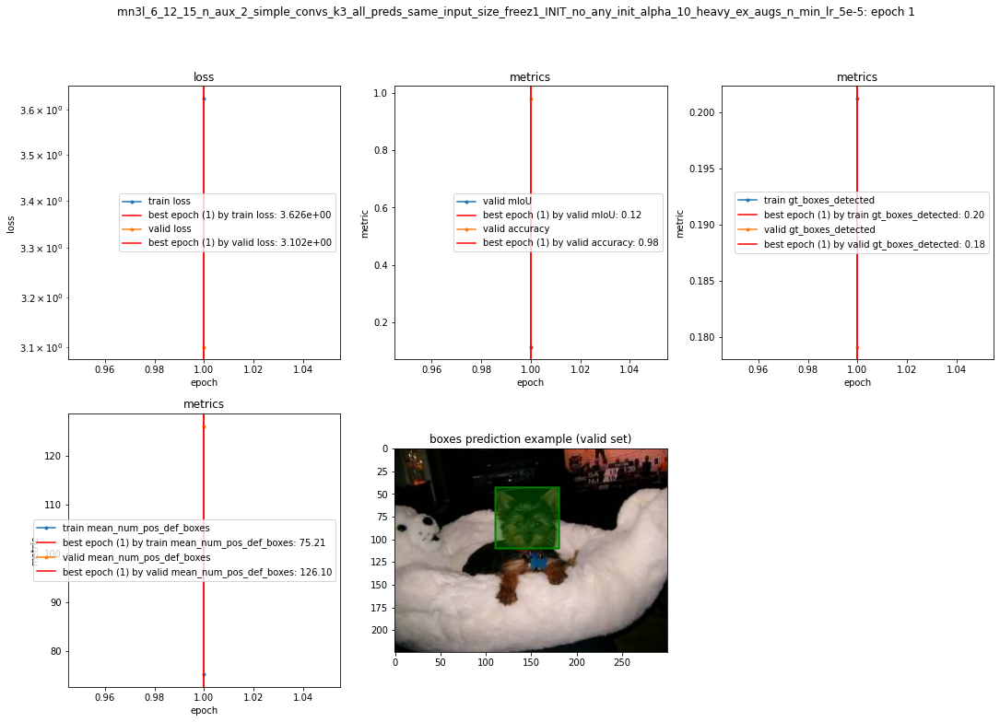

priors scales usage report for train (epoch 1):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             24
       0.20 |              0.13 |            566
       0.43 |              0.18 |            933
       0.67 |              0.27 |            562
       0.90 |              0.28 |            285
------------------------------------------------

priors scales usage report for valid (epoch 1):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.01 |            174
       0.43 |              0.19 |            219
       0.67 |              0.43 |             87
       0.90 |              0.86 |             14
------------------------------------------------


unfreezed at 2


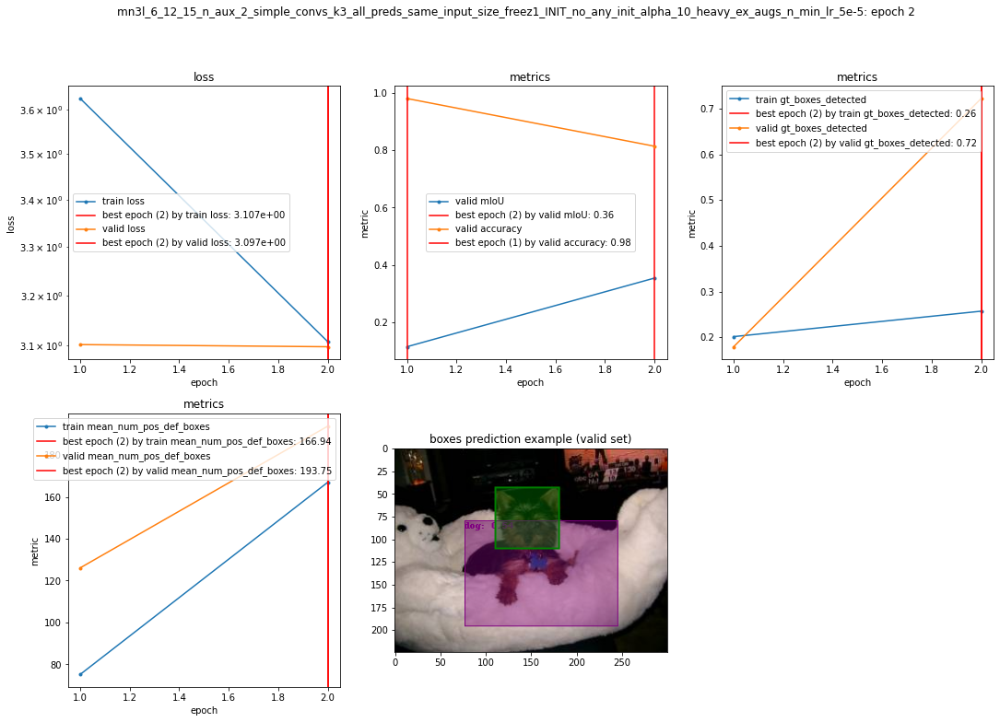

priors scales usage report for train (epoch 2):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             15
       0.20 |              0.03 |            551
       0.43 |              0.20 |            956
       0.67 |              0.45 |            593
       0.90 |              0.54 |            255
------------------------------------------------

priors scales usage report for valid (epoch 2):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.40 |            174
       0.43 |              0.91 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




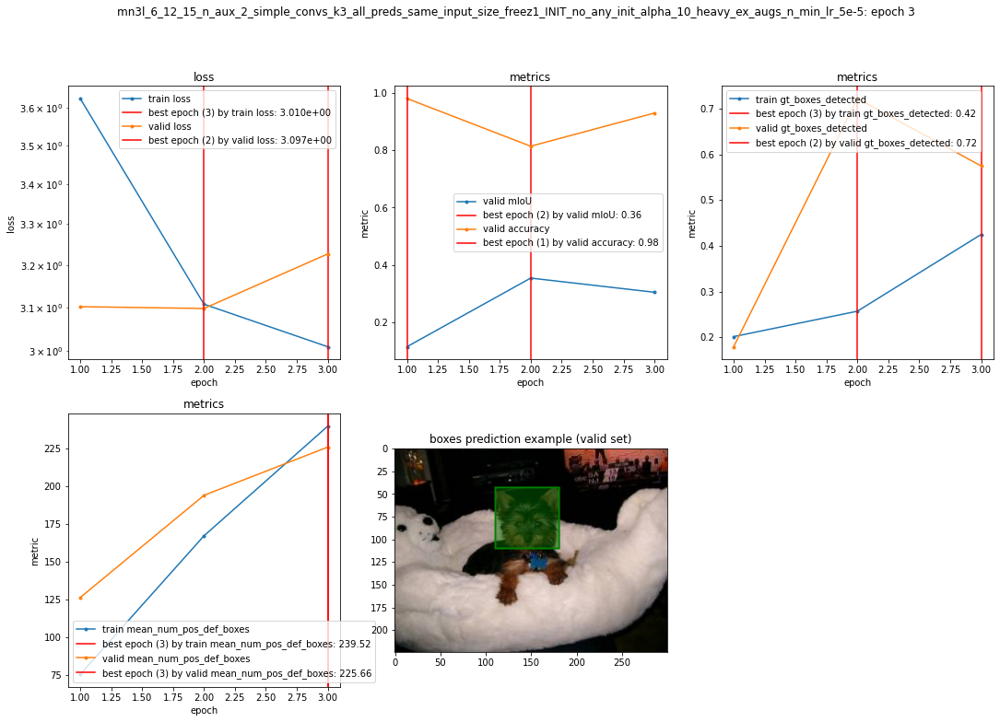

priors scales usage report for train (epoch 3):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.06 |            558
       0.43 |              0.37 |            946
       0.67 |              0.71 |            614
       0.90 |              0.80 |            235
------------------------------------------------

priors scales usage report for valid (epoch 3):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.17 |            174
       0.43 |              0.75 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




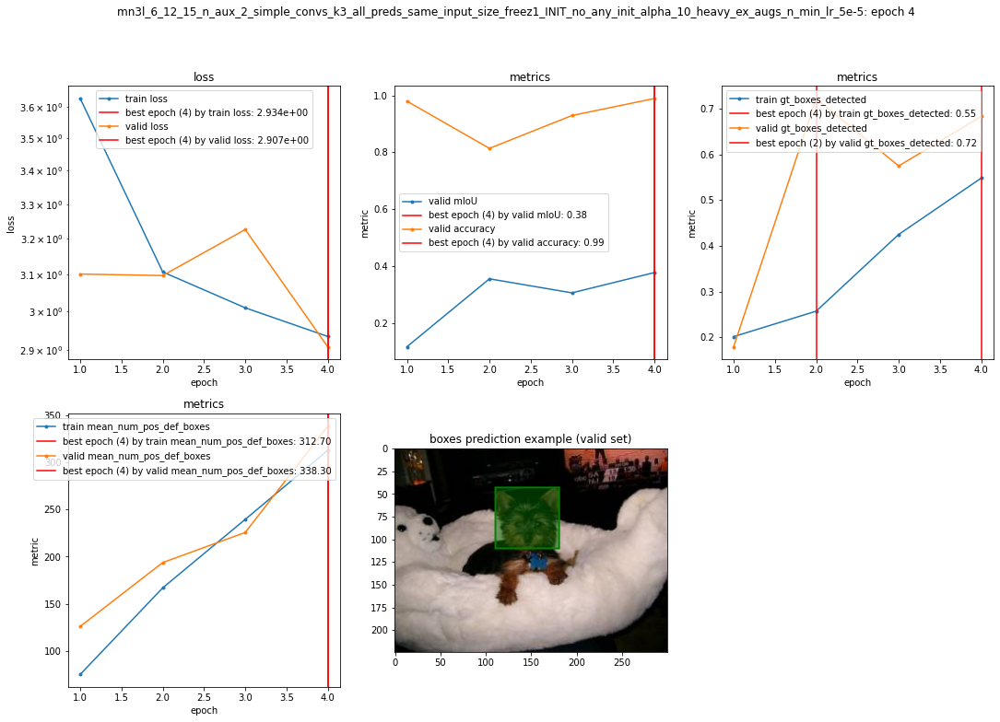

priors scales usage report for train (epoch 4):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.10 |            565
       0.43 |              0.55 |            942
       0.67 |              0.84 |            584
       0.90 |              0.88 |            260
------------------------------------------------

priors scales usage report for valid (epoch 4):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.29 |            174
       0.43 |              0.89 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




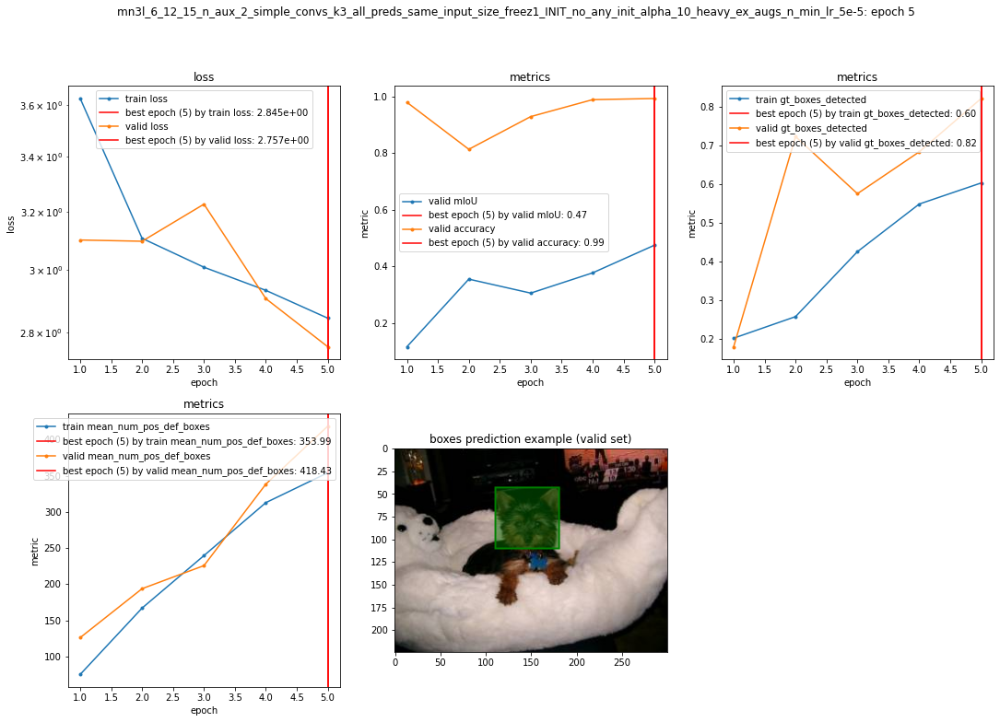

priors scales usage report for train (epoch 5):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.17 |            566
       0.43 |              0.63 |            943
       0.67 |              0.86 |            589
       0.90 |              0.90 |            255
------------------------------------------------

priors scales usage report for valid (epoch 5):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.61 |            174
       0.43 |              0.97 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




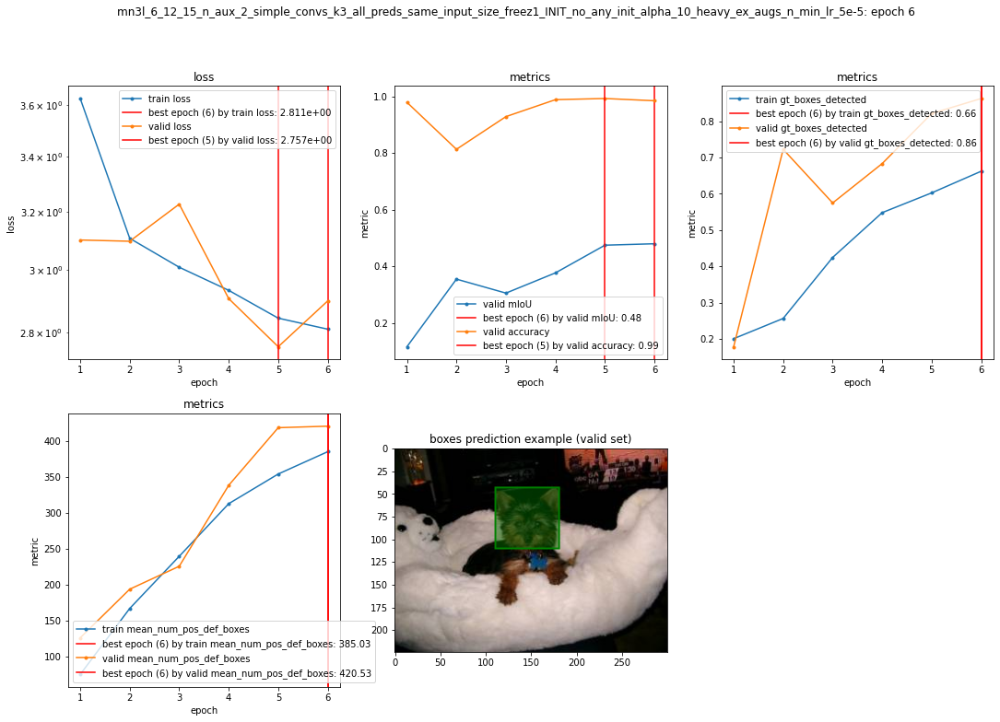

priors scales usage report for train (epoch 6):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.28 |            568
       0.43 |              0.71 |            984
       0.67 |              0.89 |            524
       0.90 |              0.88 |            276
------------------------------------------------

priors scales usage report for valid (epoch 6):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.70 |            174
       0.43 |              0.98 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




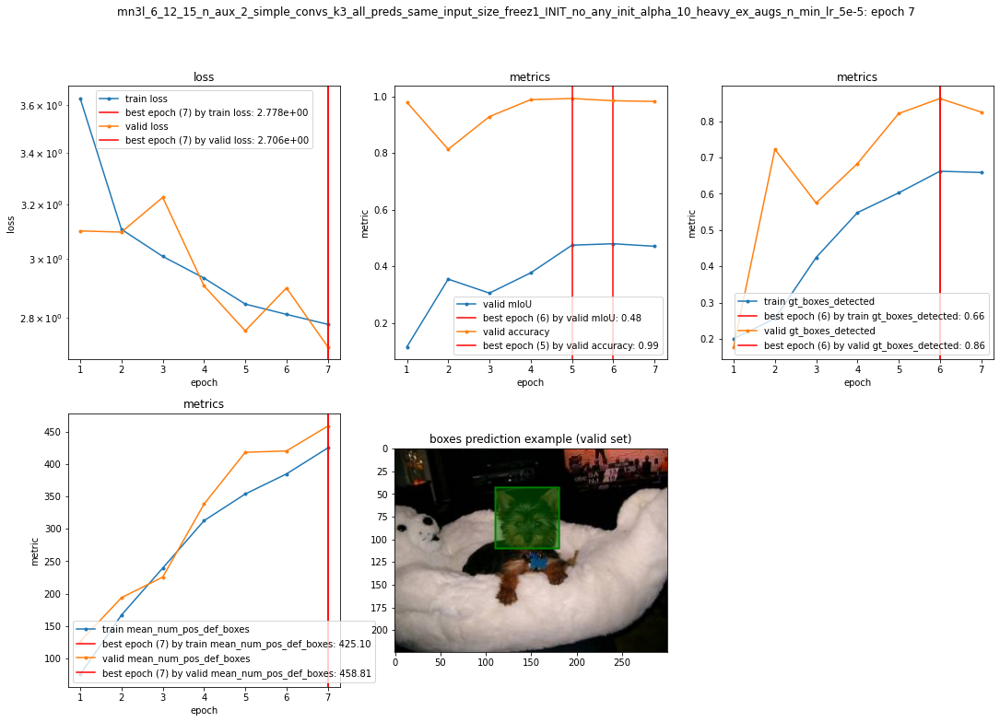

priors scales usage report for train (epoch 7):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.25 |            549
       0.43 |              0.72 |            983
       0.67 |              0.86 |            560
       0.90 |              0.87 |            261
------------------------------------------------

priors scales usage report for valid (epoch 7):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.60 |            174
       0.43 |              0.98 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




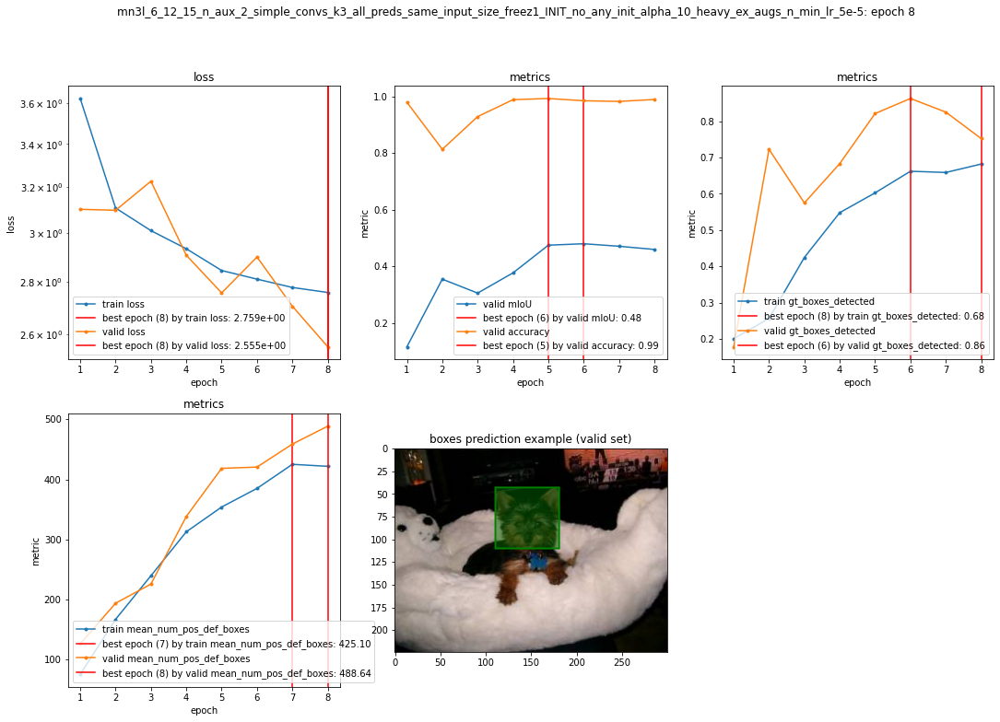

priors scales usage report for train (epoch 8):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             22
       0.20 |              0.32 |            540
       0.43 |              0.73 |            968
       0.67 |              0.87 |            557
       0.90 |              0.89 |            283
------------------------------------------------

priors scales usage report for valid (epoch 8):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.45 |            174
       0.43 |              0.95 |            219
       0.67 |              0.95 |             87
       0.90 |              1.00 |             14
------------------------------------------------




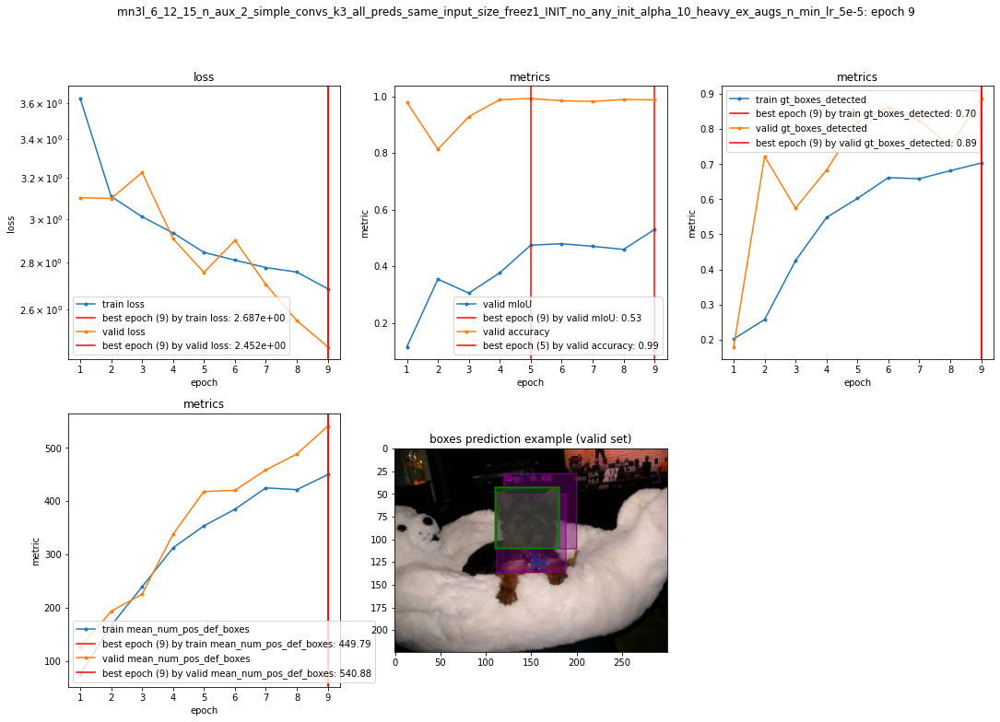

priors scales usage report for train (epoch 9):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.34 |            545
       0.43 |              0.76 |            983
       0.67 |              0.89 |            579
       0.90 |              0.89 |            243
------------------------------------------------

priors scales usage report for valid (epoch 9):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.76 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




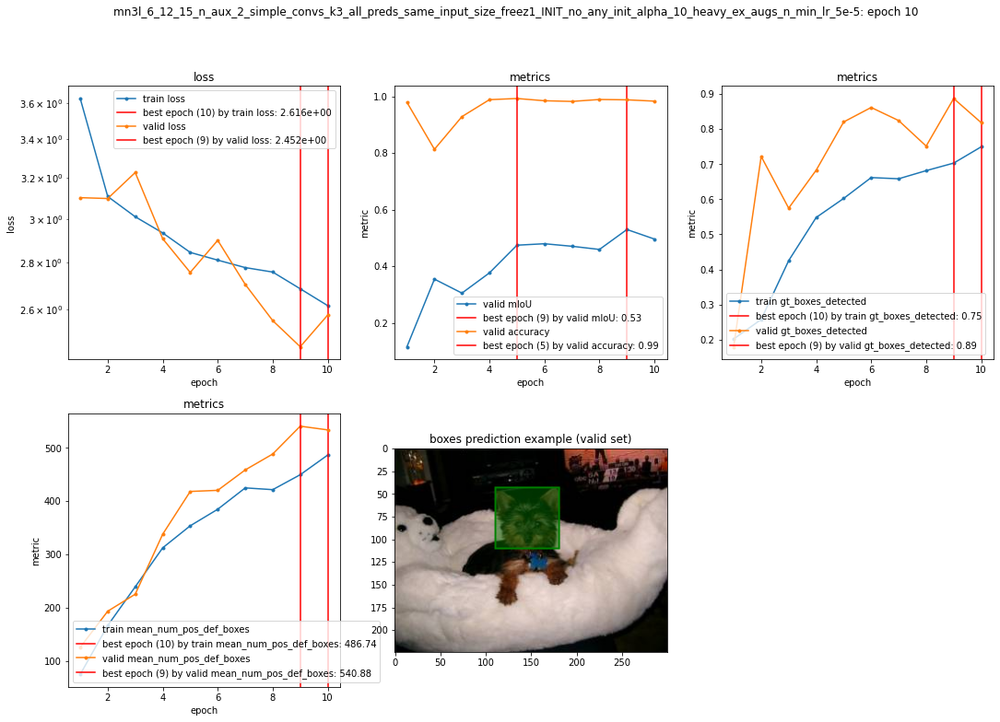

priors scales usage report for train (epoch 10):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.43 |            554
       0.43 |              0.81 |            960
       0.67 |              0.92 |            568
       0.90 |              0.90 |            268
------------------------------------------------

priors scales usage report for valid (epoch 10):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.57 |            174
       0.43 |              1.00 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




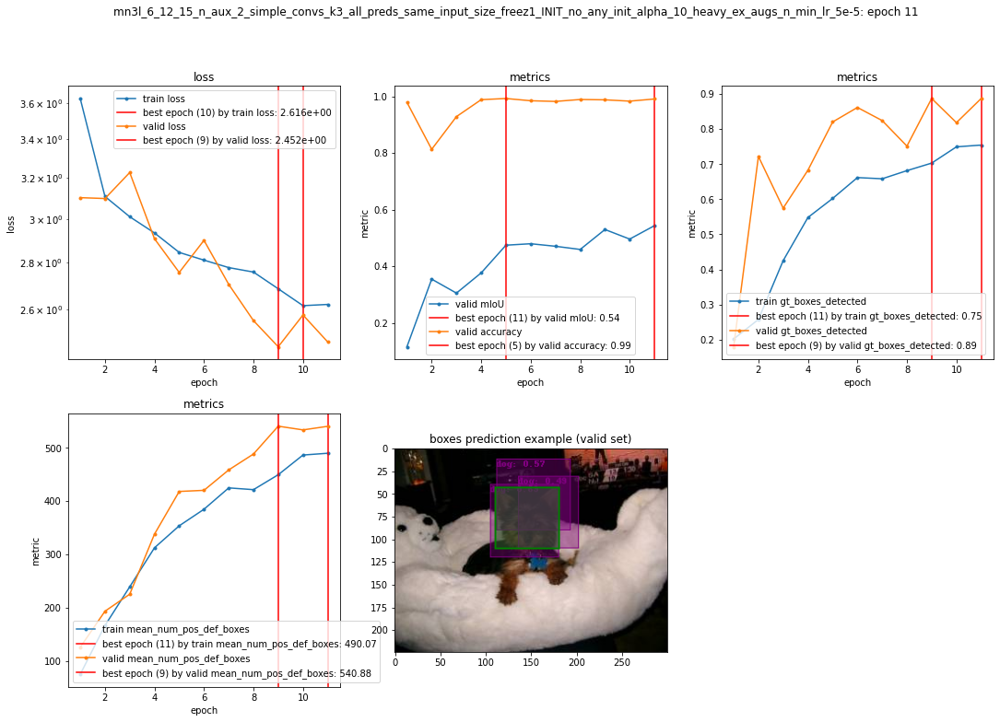

priors scales usage report for train (epoch 11):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.45 |            548
       0.43 |              0.81 |            972
       0.67 |              0.91 |            570
       0.90 |              0.92 |            261
------------------------------------------------

priors scales usage report for valid (epoch 11):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.79 |            174
       0.43 |              0.99 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




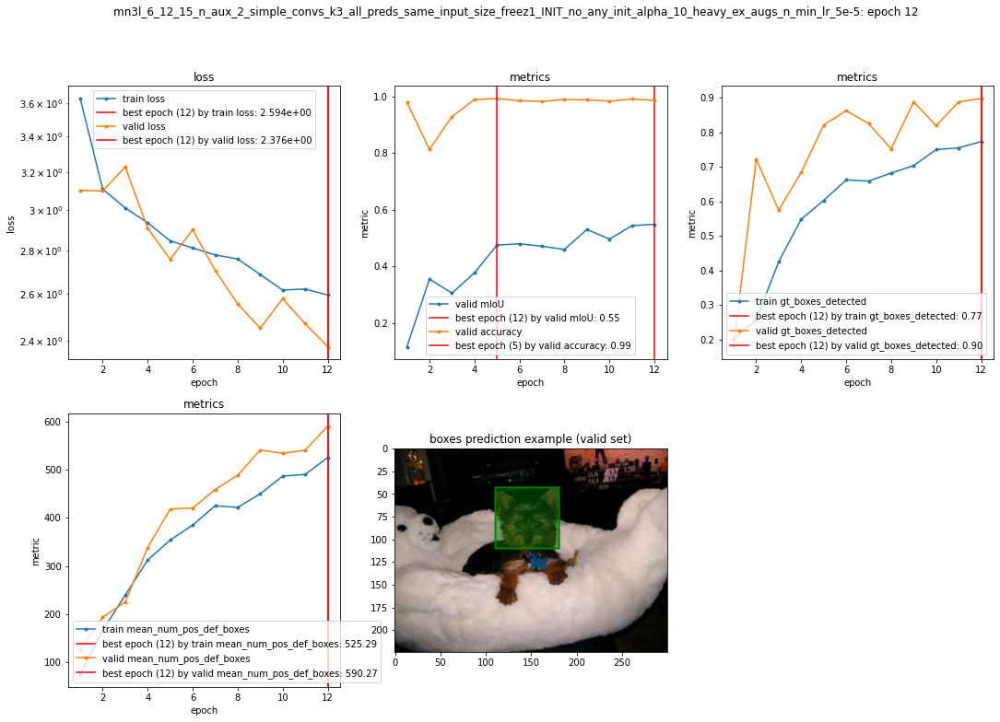

priors scales usage report for train (epoch 12):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.51 |            541
       0.43 |              0.82 |            963
       0.67 |              0.92 |            591
       0.90 |              0.88 |            256
------------------------------------------------

priors scales usage report for valid (epoch 12):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.80 |            174
       0.43 |              1.00 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




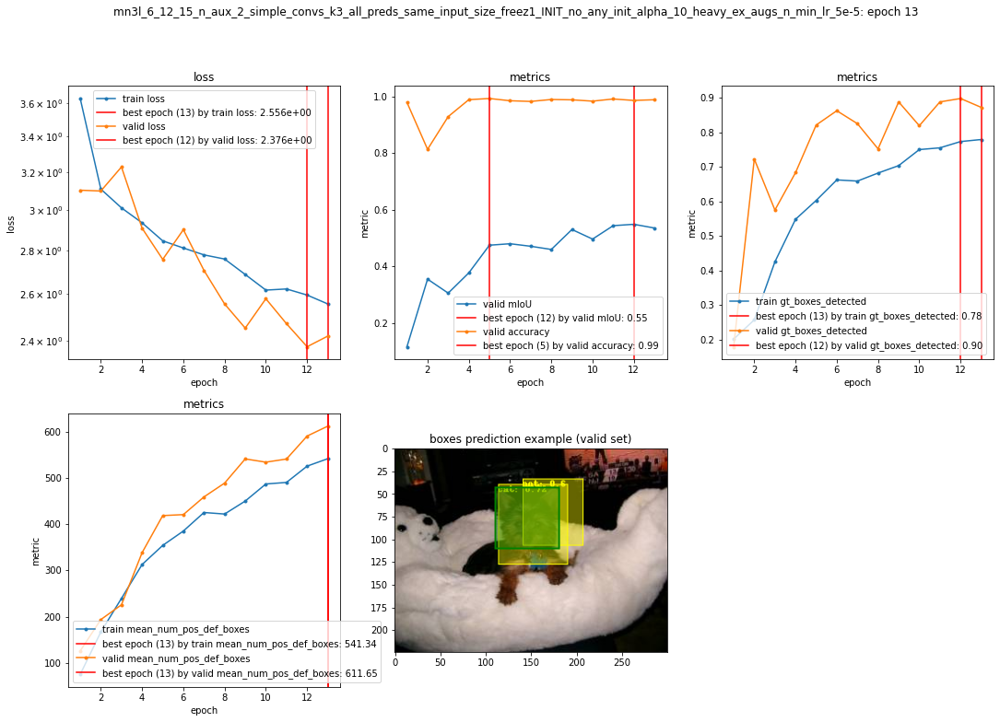

priors scales usage report for train (epoch 13):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.53 |            585
       0.43 |              0.83 |            926
       0.67 |              0.91 |            588
       0.90 |              0.91 |            253
------------------------------------------------

priors scales usage report for valid (epoch 13):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.73 |            174
       0.43 |              0.99 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




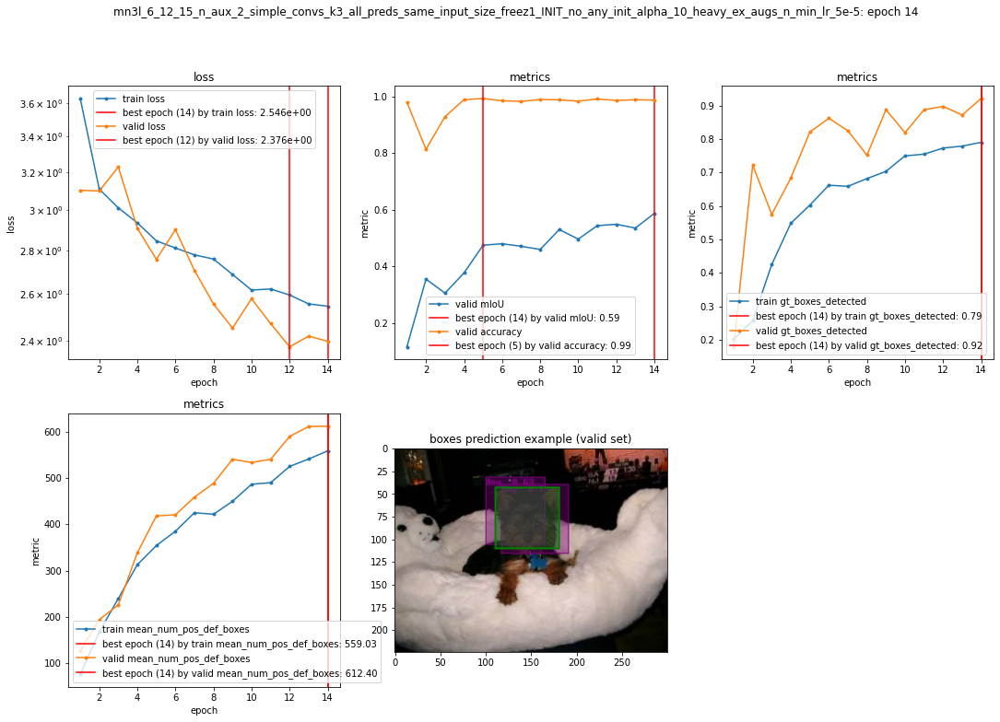

priors scales usage report for train (epoch 14):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             27
       0.20 |              0.55 |            548
       0.43 |              0.84 |            965
       0.67 |              0.93 |            576
       0.90 |              0.89 |            254
------------------------------------------------

priors scales usage report for valid (epoch 14):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.88 |            174
       0.43 |              0.99 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




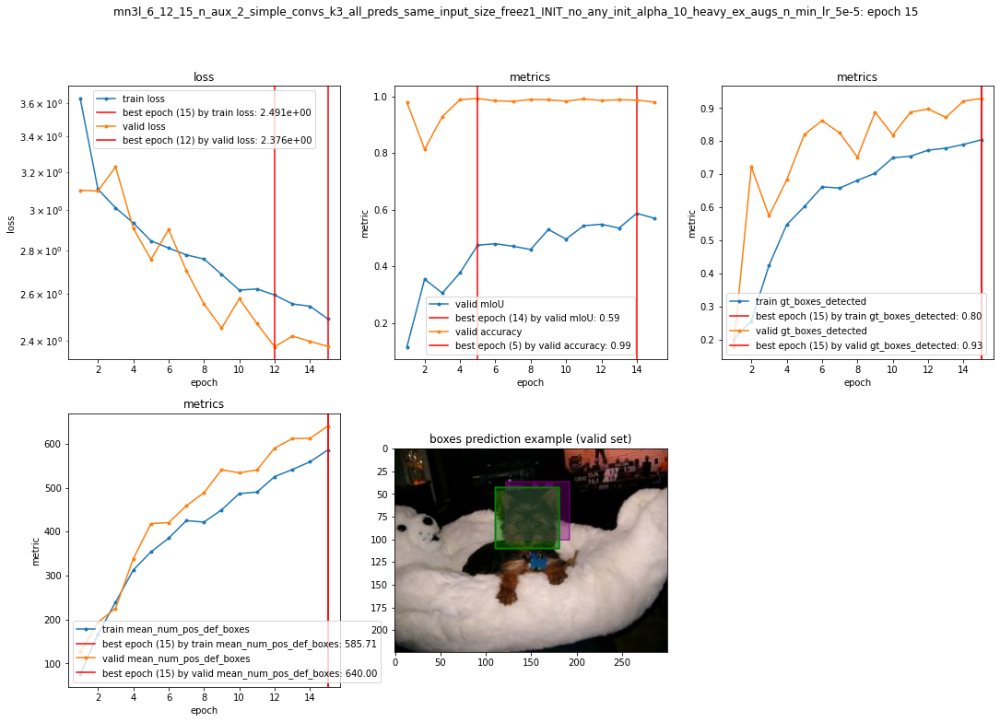

priors scales usage report for train (epoch 15):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.57 |            572
       0.43 |              0.87 |            931
       0.67 |              0.91 |            577
       0.90 |              0.91 |            271
------------------------------------------------

priors scales usage report for valid (epoch 15):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.88 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




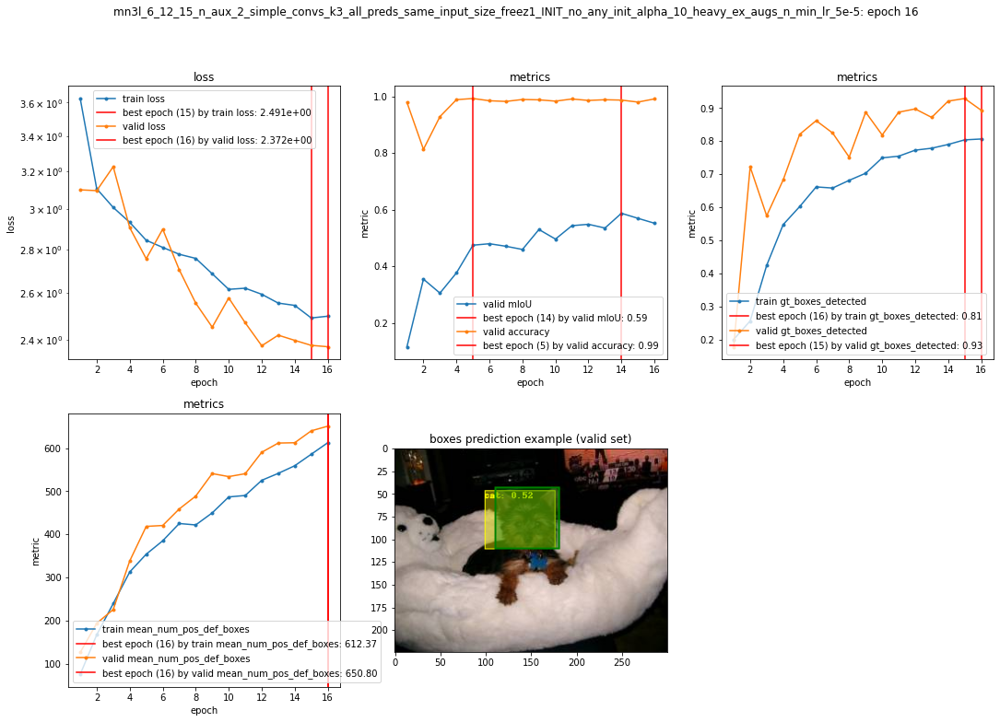

priors scales usage report for train (epoch 16):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.55 |            557
       0.43 |              0.85 |            944
       0.67 |              0.93 |            589
       0.90 |              0.97 |            260
------------------------------------------------

priors scales usage report for valid (epoch 16):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.80 |            174
       0.43 |              0.98 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




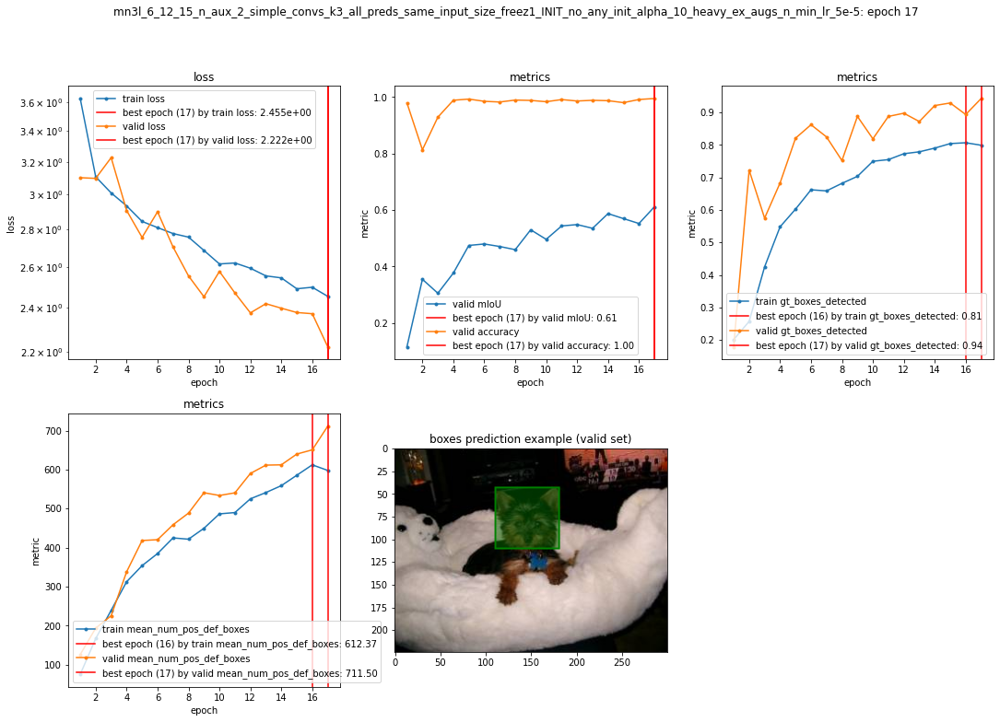

priors scales usage report for train (epoch 17):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.06 |             18
       0.20 |              0.59 |            579
       0.43 |              0.85 |            949
       0.67 |              0.90 |            579
       0.90 |              0.91 |            245
------------------------------------------------

priors scales usage report for valid (epoch 17):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.91 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




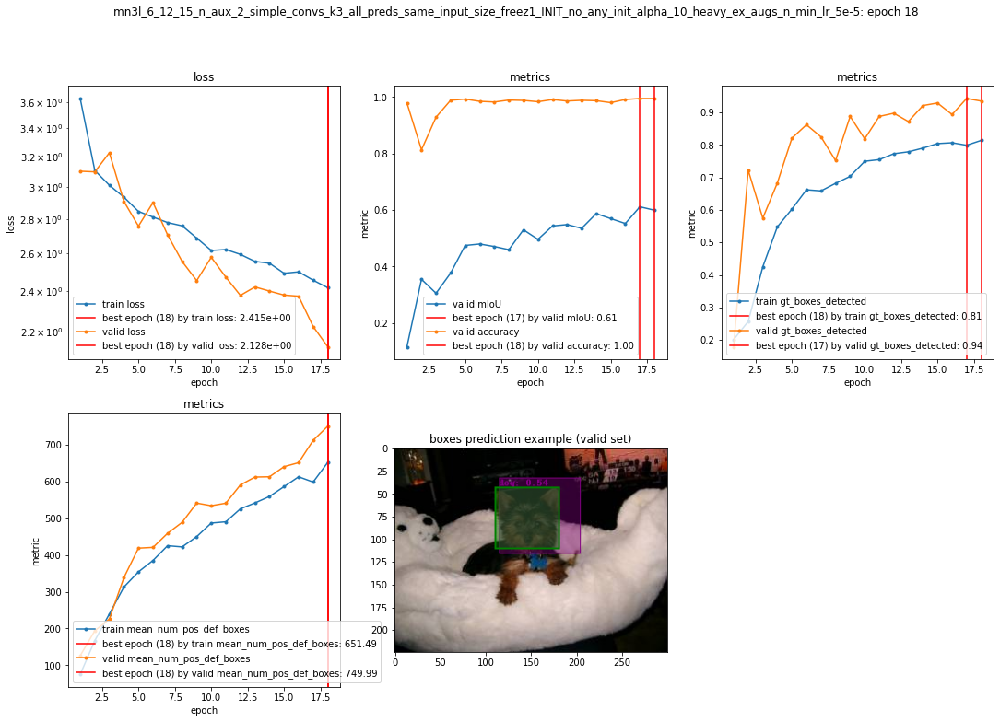

priors scales usage report for train (epoch 18):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             22
       0.20 |              0.62 |            548
       0.43 |              0.86 |            966
       0.67 |              0.90 |            581
       0.90 |              0.93 |            253
------------------------------------------------

priors scales usage report for valid (epoch 18):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.90 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




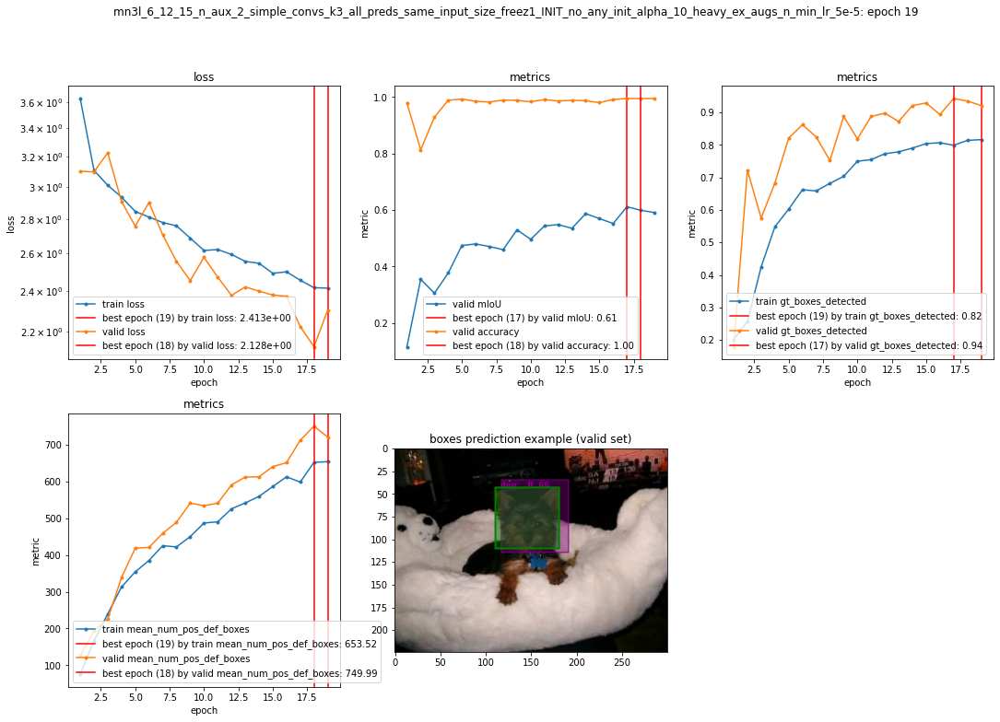

priors scales usage report for train (epoch 19):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.61 |            569
       0.43 |              0.88 |            943
       0.67 |              0.90 |            582
       0.90 |              0.90 |            258
------------------------------------------------

priors scales usage report for valid (epoch 19):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.86 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




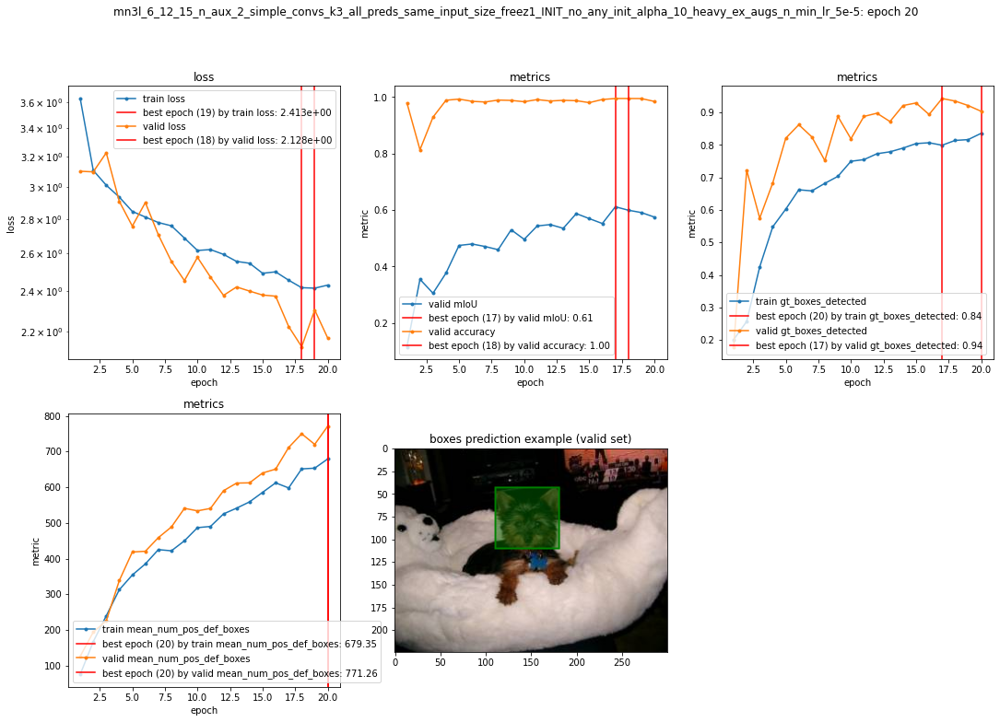

priors scales usage report for train (epoch 20):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.06 |             17
       0.20 |              0.63 |            552
       0.43 |              0.88 |            964
       0.67 |              0.93 |            588
       0.90 |              0.93 |            249
------------------------------------------------

priors scales usage report for valid (epoch 20):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.82 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




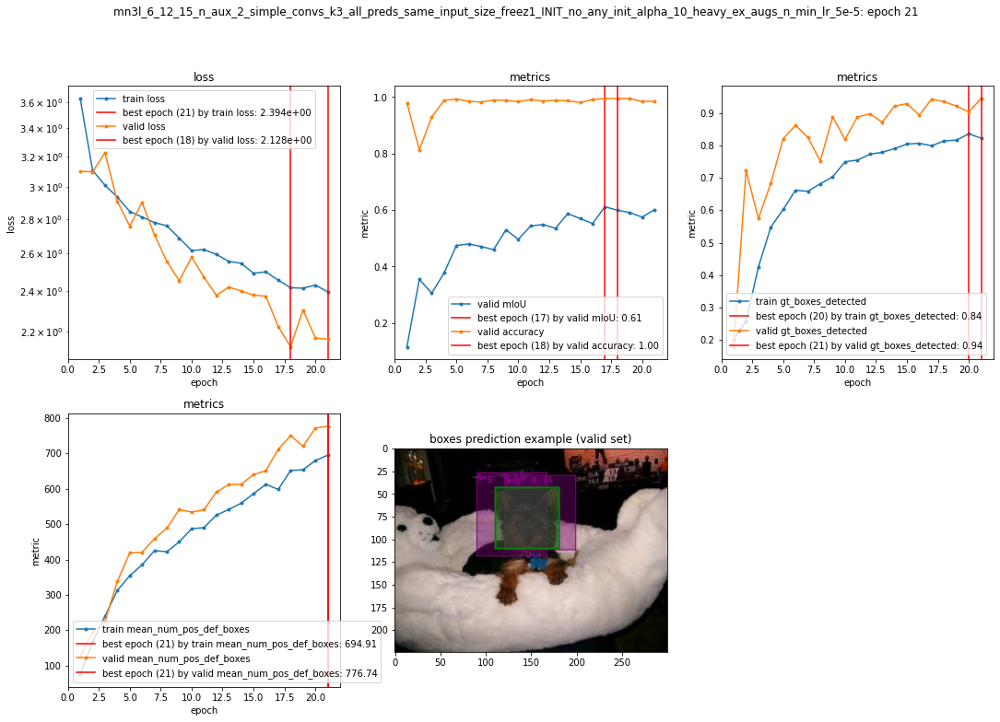

priors scales usage report for train (epoch 21):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             27
       0.20 |              0.61 |            550
       0.43 |              0.87 |            944
       0.67 |              0.92 |            589
       0.90 |              0.94 |            260
------------------------------------------------

priors scales usage report for valid (epoch 21):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.93 |            174
       0.43 |              1.00 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




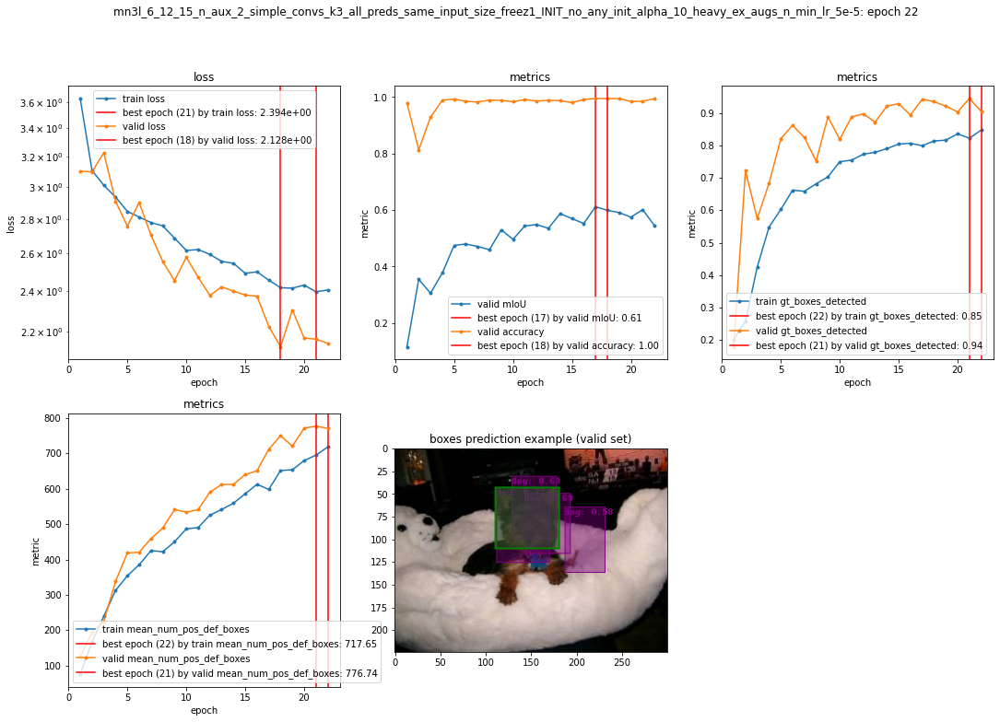

priors scales usage report for train (epoch 22):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             21
       0.20 |              0.68 |            555
       0.43 |              0.89 |            955
       0.67 |              0.93 |            571
       0.90 |              0.93 |            268
------------------------------------------------

priors scales usage report for valid (epoch 22):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.84 |            174
       0.43 |              0.99 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




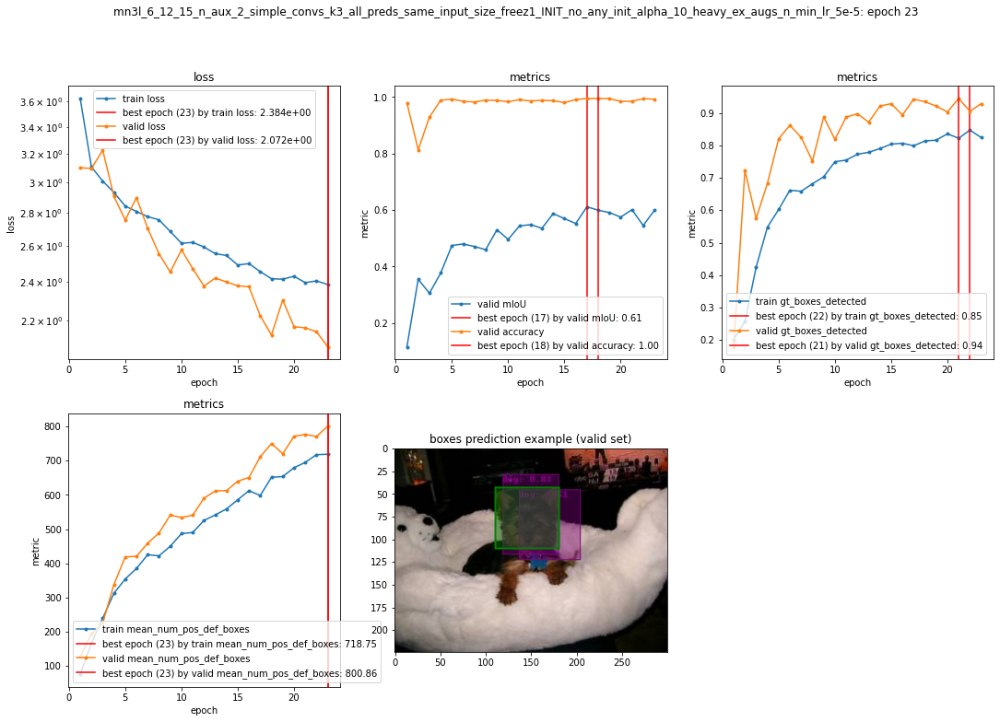

priors scales usage report for train (epoch 23):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.61 |            559
       0.43 |              0.88 |            982
       0.67 |              0.93 |            552
       0.90 |              0.91 |            257
------------------------------------------------

priors scales usage report for valid (epoch 23):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.89 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




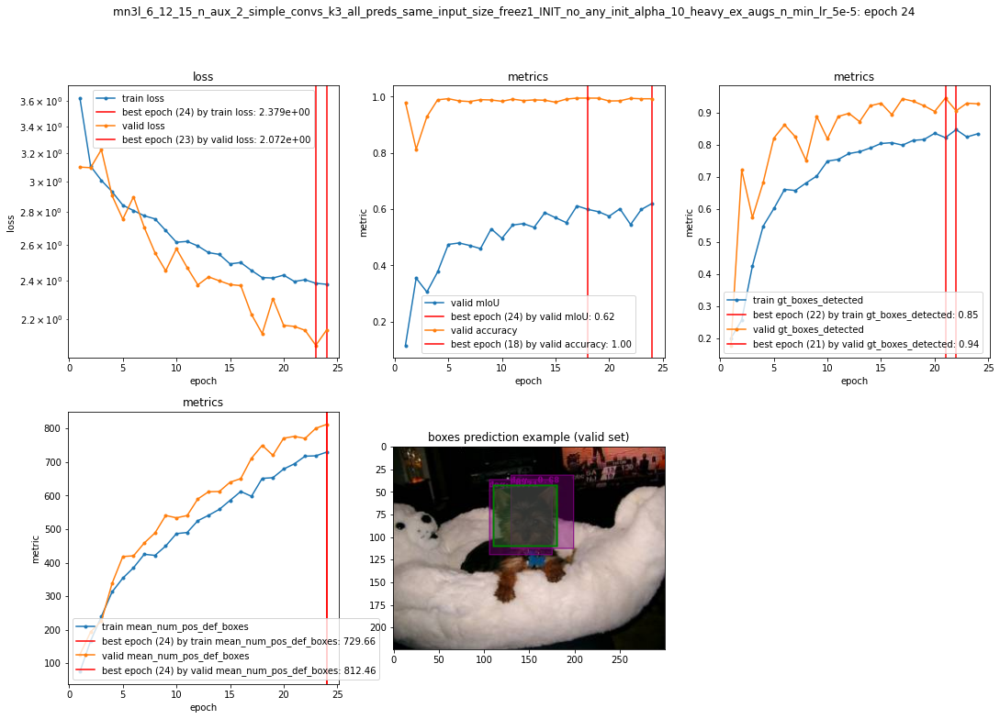

priors scales usage report for train (epoch 24):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             22
       0.20 |              0.66 |            544
       0.43 |              0.87 |            974
       0.67 |              0.92 |            565
       0.90 |              0.94 |            265
------------------------------------------------

priors scales usage report for valid (epoch 24):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.89 |            174
       0.43 |              0.99 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




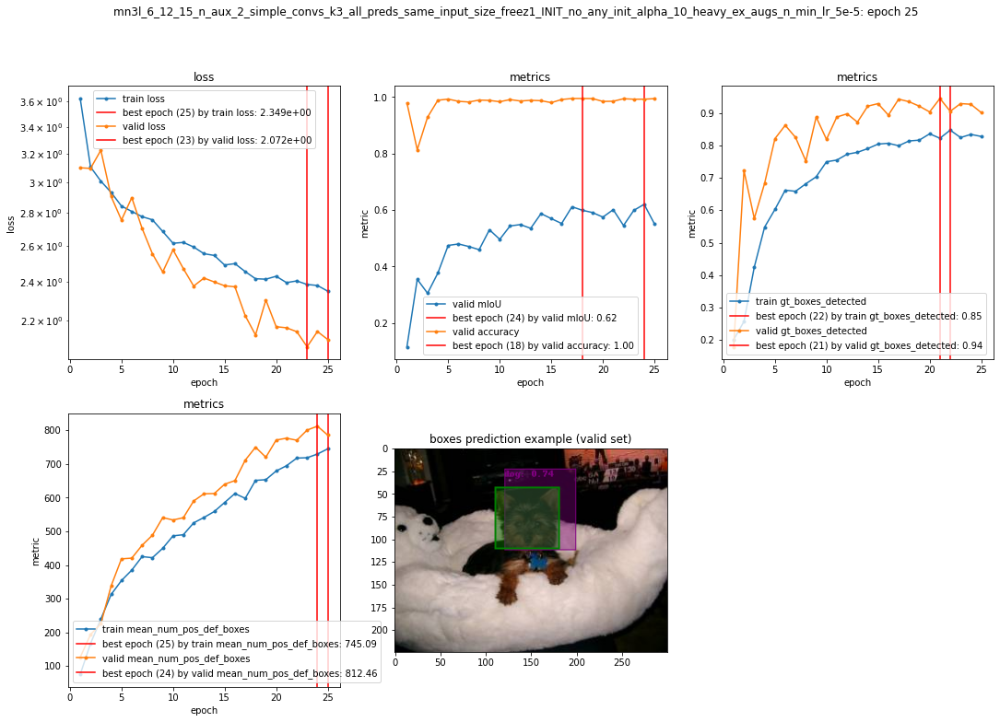

priors scales usage report for train (epoch 25):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             25
       0.20 |              0.69 |            553
       0.43 |              0.86 |            955
       0.67 |              0.91 |            566
       0.90 |              0.91 |            271
------------------------------------------------

priors scales usage report for valid (epoch 25):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.83 |            174
       0.43 |              0.99 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




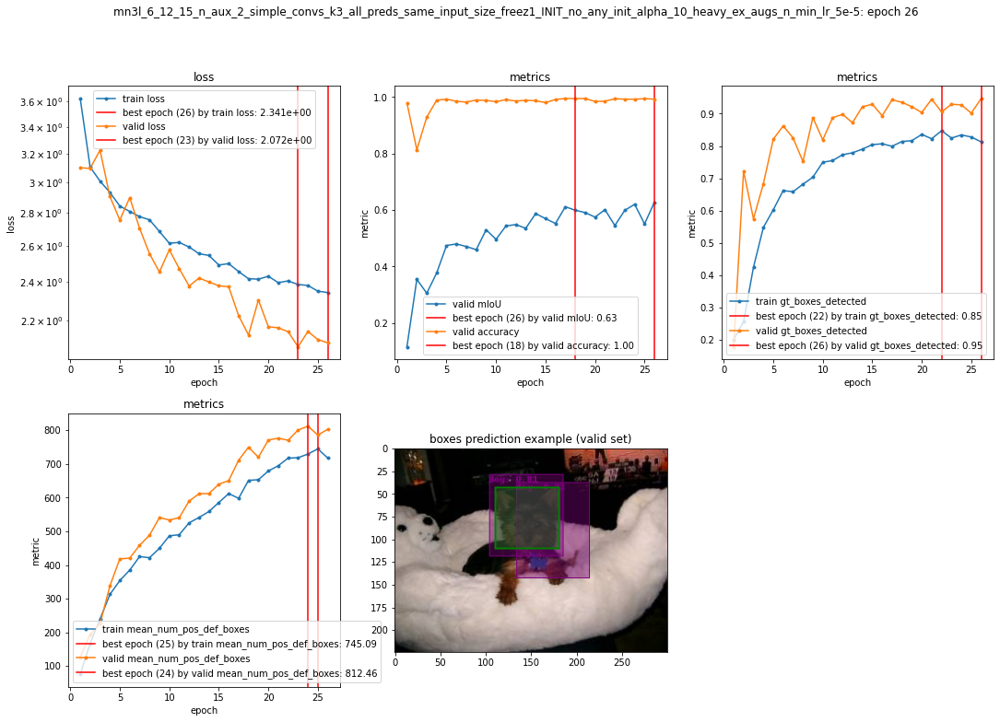

priors scales usage report for train (epoch 26):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.63 |            556
       0.43 |              0.85 |            965
       0.67 |              0.90 |            551
       0.90 |              0.91 |            280
------------------------------------------------

priors scales usage report for valid (epoch 26):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.94 |            174
       0.43 |              0.99 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




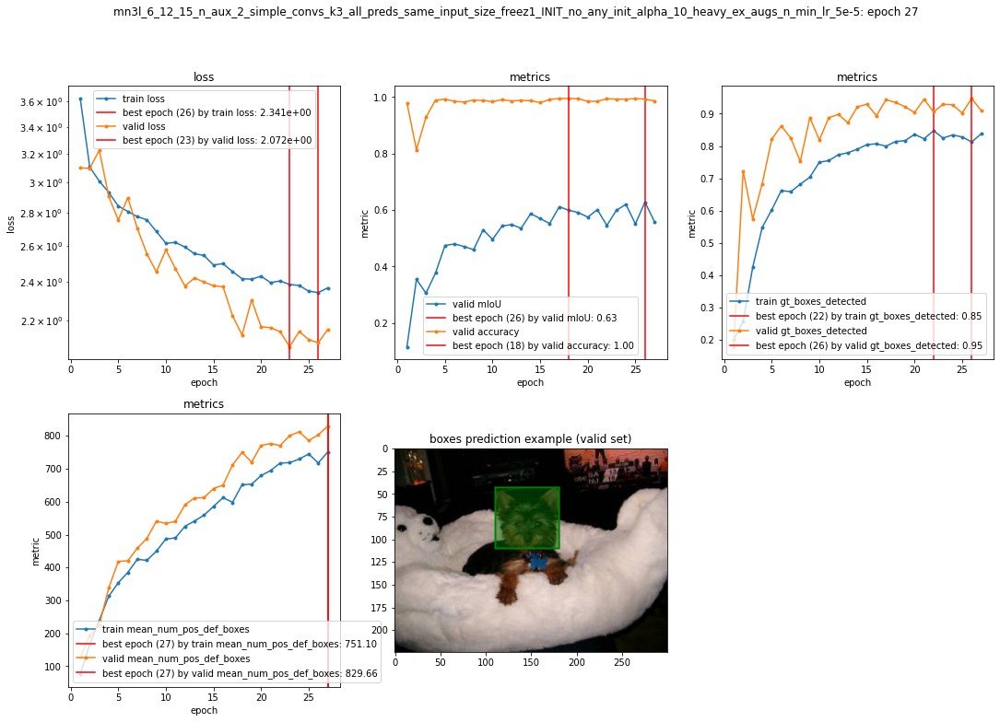

priors scales usage report for train (epoch 27):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.66 |            570
       0.43 |              0.89 |            951
       0.67 |              0.90 |            598
       0.90 |              0.93 |            233
------------------------------------------------

priors scales usage report for valid (epoch 27):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.84 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




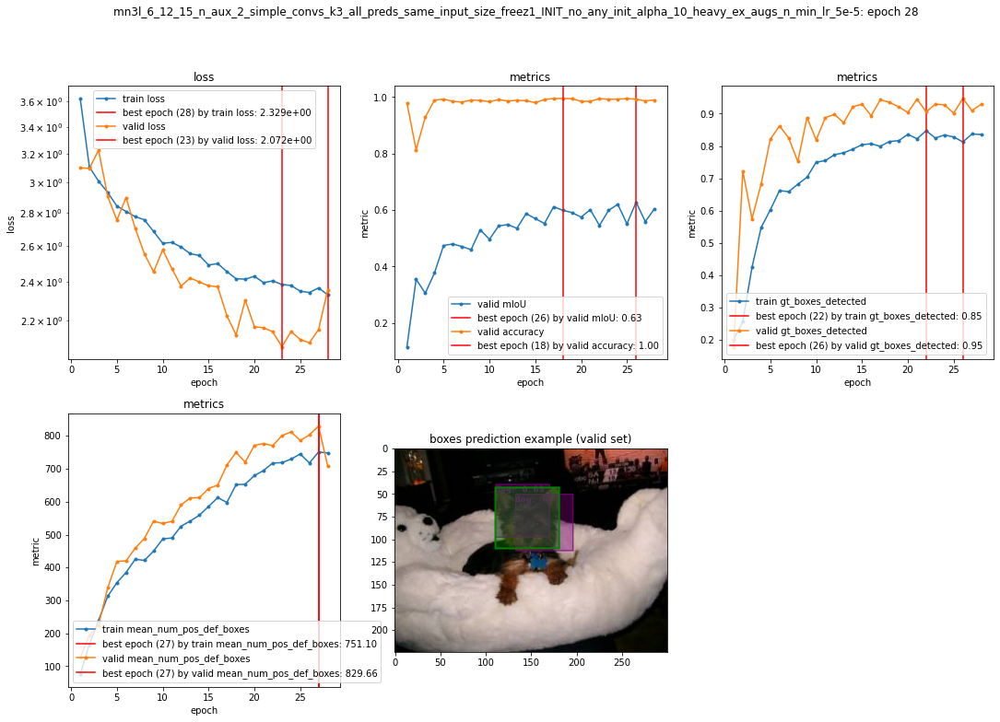

priors scales usage report for train (epoch 28):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.68 |            560
       0.43 |              0.87 |            949
       0.67 |              0.93 |            576
       0.90 |              0.91 |            265
------------------------------------------------

priors scales usage report for valid (epoch 28):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.89 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




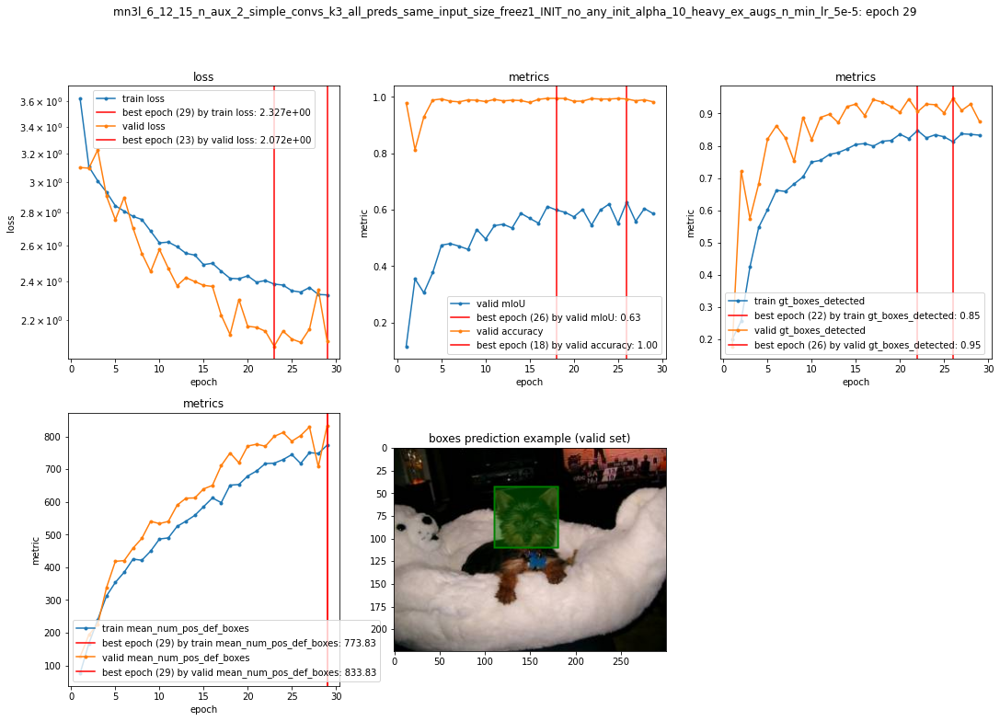

priors scales usage report for train (epoch 29):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             22
       0.20 |              0.66 |            564
       0.43 |              0.87 |            953
       0.67 |              0.93 |            565
       0.90 |              0.93 |            266
------------------------------------------------

priors scales usage report for valid (epoch 29):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.78 |            174
       0.43 |              0.97 |            219
       0.67 |              0.97 |             87
       0.90 |              1.00 |             14
------------------------------------------------




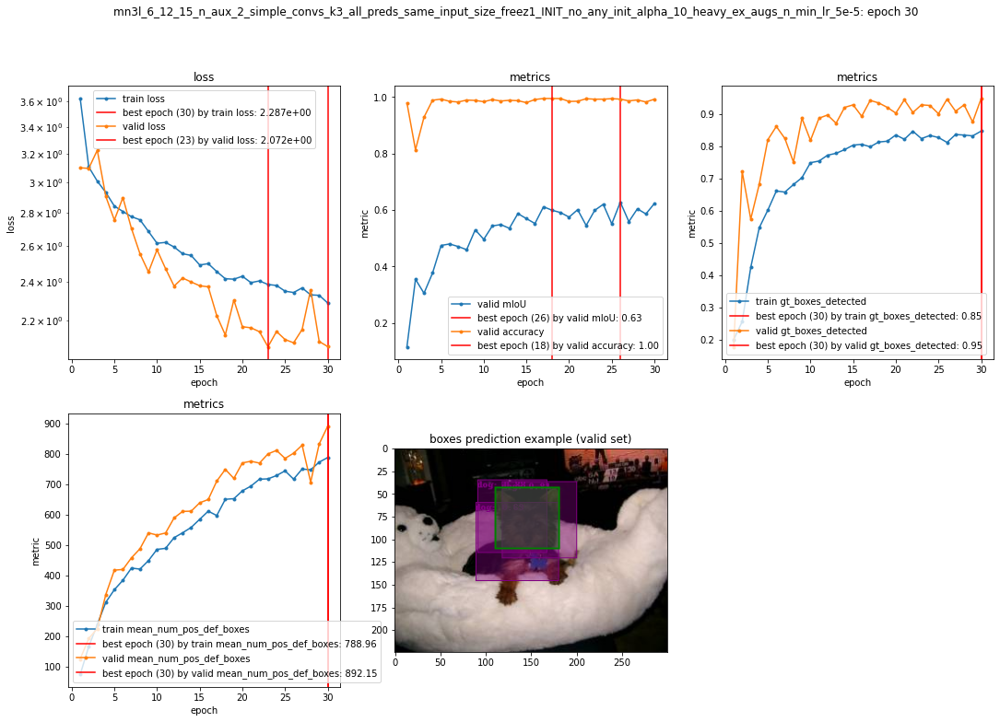

priors scales usage report for train (epoch 30):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.71 |            557
       0.43 |              0.88 |            946
       0.67 |              0.92 |            607
       0.90 |              0.91 |            243
------------------------------------------------

priors scales usage report for valid (epoch 30):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.95 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




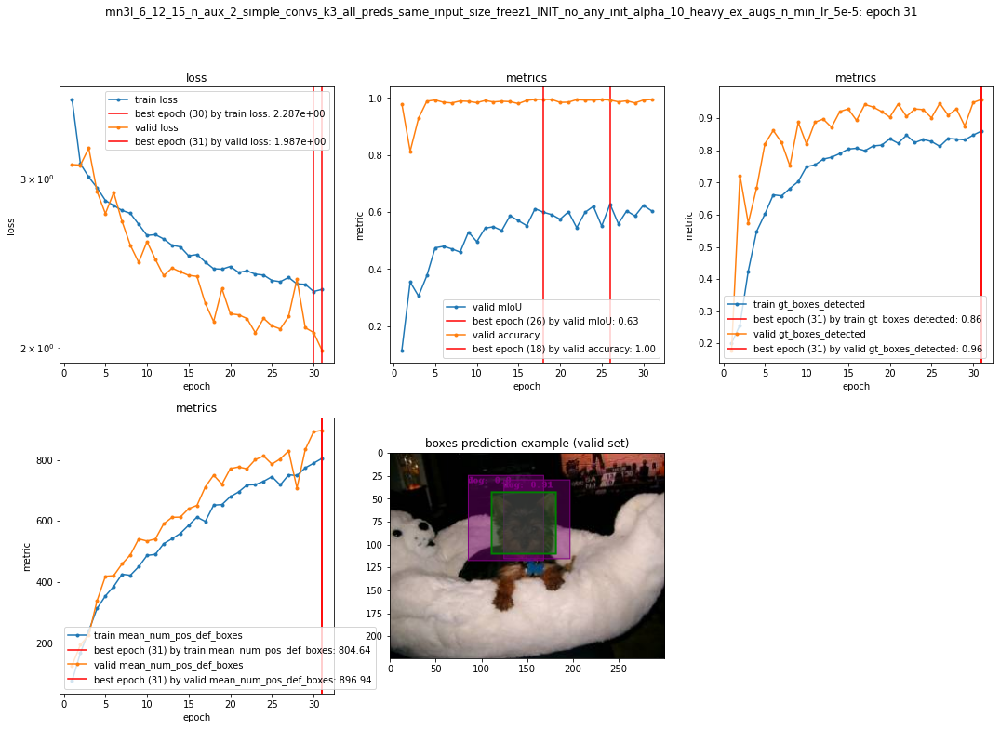

priors scales usage report for train (epoch 31):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.08 |             25
       0.20 |              0.74 |            544
       0.43 |              0.88 |            958
       0.67 |              0.93 |            594
       0.90 |              0.94 |            249
------------------------------------------------

priors scales usage report for valid (epoch 31):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.95 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




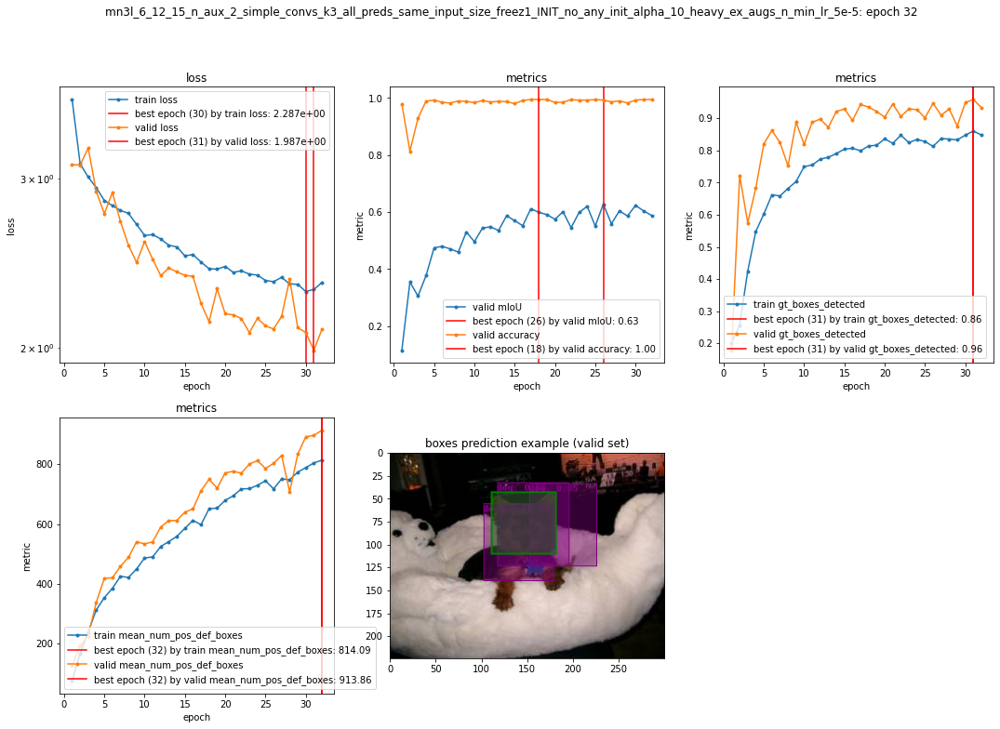

priors scales usage report for train (epoch 32):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.73 |            539
       0.43 |              0.87 |            989
       0.67 |              0.92 |            584
       0.90 |              0.89 |            238
------------------------------------------------

priors scales usage report for valid (epoch 32):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.89 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




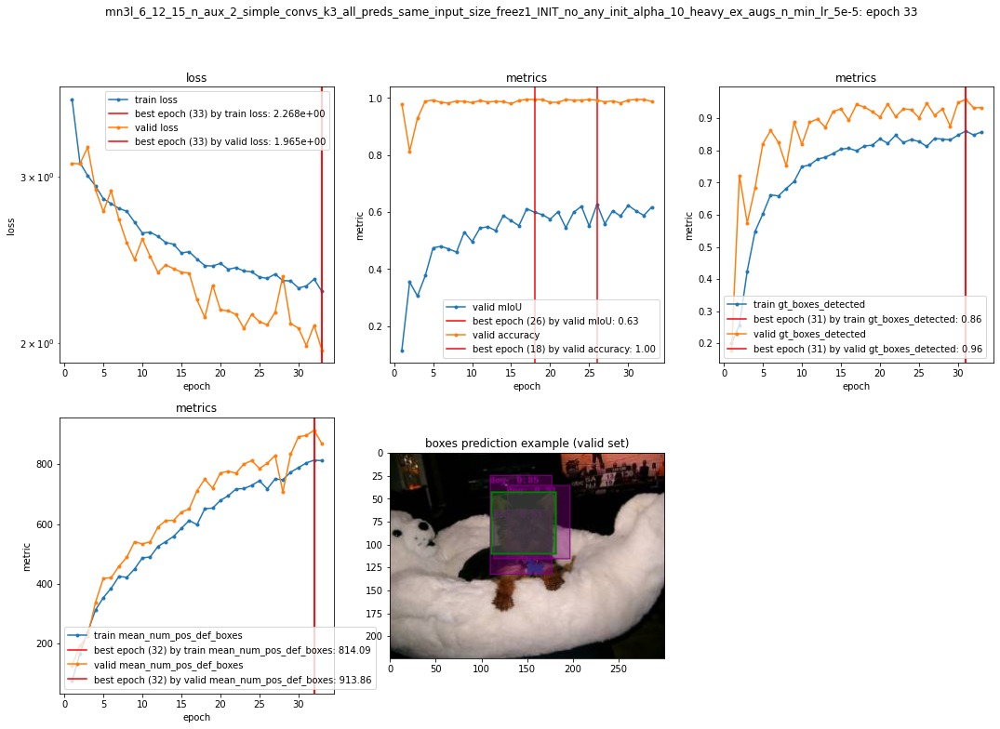

priors scales usage report for train (epoch 33):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.69 |            584
       0.43 |              0.90 |            928
       0.67 |              0.95 |            578
       0.90 |              0.94 |            261
------------------------------------------------

priors scales usage report for valid (epoch 33):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.91 |            174
       0.43 |              0.99 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




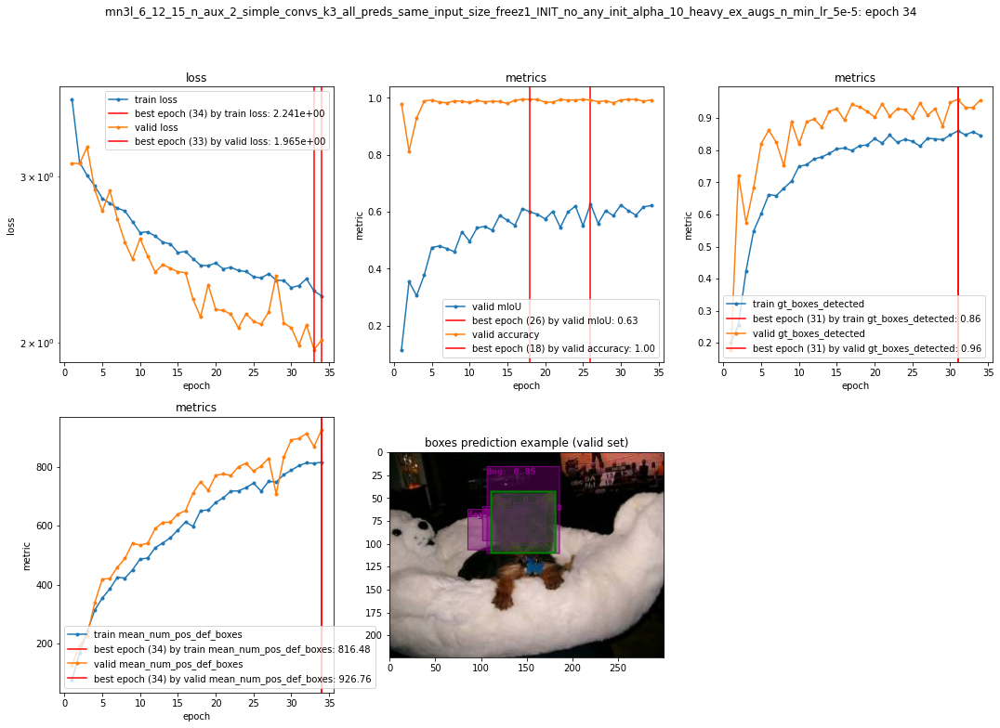

priors scales usage report for train (epoch 34):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             21
       0.20 |              0.70 |            556
       0.43 |              0.89 |            972
       0.67 |              0.90 |            567
       0.90 |              0.93 |            254
------------------------------------------------

priors scales usage report for valid (epoch 34):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.96 |            174
       0.43 |              1.00 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




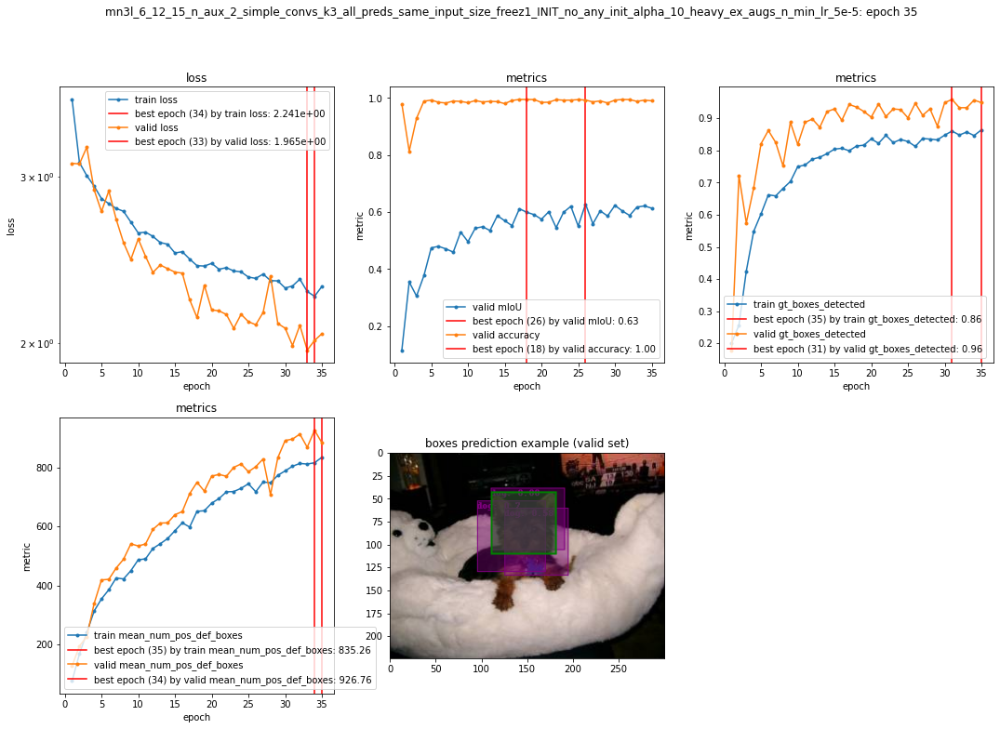

priors scales usage report for train (epoch 35):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.72 |            559
       0.43 |              0.91 |            960
       0.67 |              0.93 |            576
       0.90 |              0.93 |            258
------------------------------------------------

priors scales usage report for valid (epoch 35):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.94 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




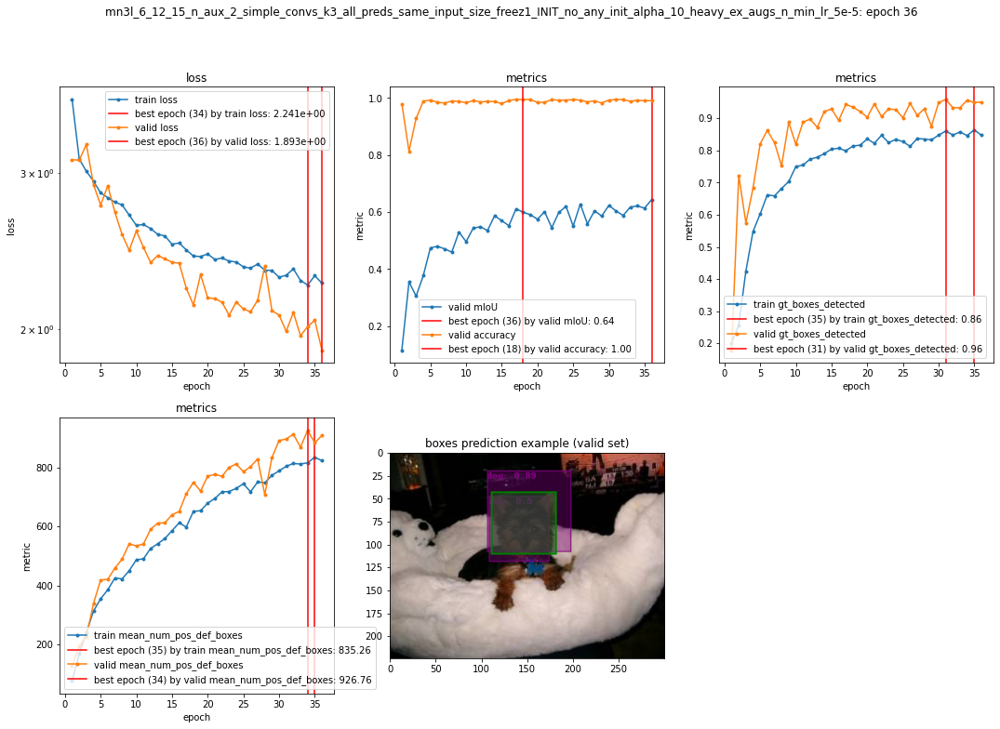

priors scales usage report for train (epoch 36):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             20
       0.20 |              0.70 |            542
       0.43 |              0.89 |          1,006
       0.67 |              0.92 |            548
       0.90 |              0.92 |            254
------------------------------------------------

priors scales usage report for valid (epoch 36):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.95 |            174
       0.43 |              1.00 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




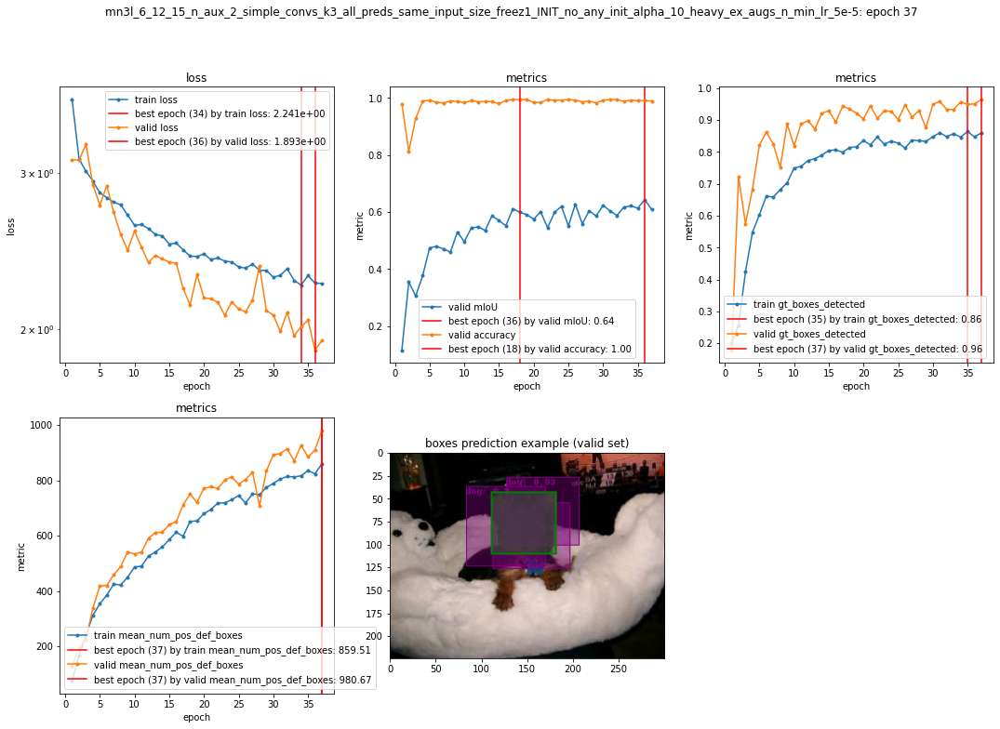

priors scales usage report for train (epoch 37):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             21
       0.20 |              0.76 |            576
       0.43 |              0.89 |            929
       0.67 |              0.92 |            597
       0.90 |              0.92 |            247
------------------------------------------------

priors scales usage report for valid (epoch 37):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.98 |            174
       0.43 |              1.00 |            219
       0.67 |              0.98 |             87
       0.90 |              1.00 |             14
------------------------------------------------




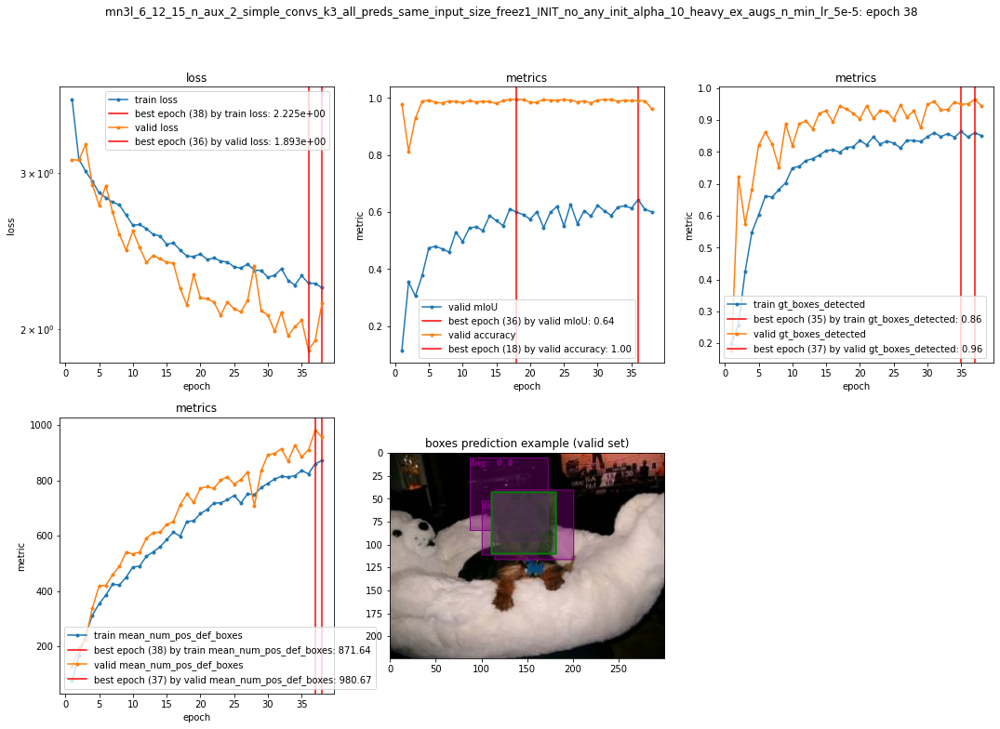

priors scales usage report for train (epoch 38):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             22
       0.20 |              0.73 |            559
       0.43 |              0.90 |            950
       0.67 |              0.91 |            587
       0.90 |              0.89 |            252
------------------------------------------------

priors scales usage report for valid (epoch 38):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.93 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




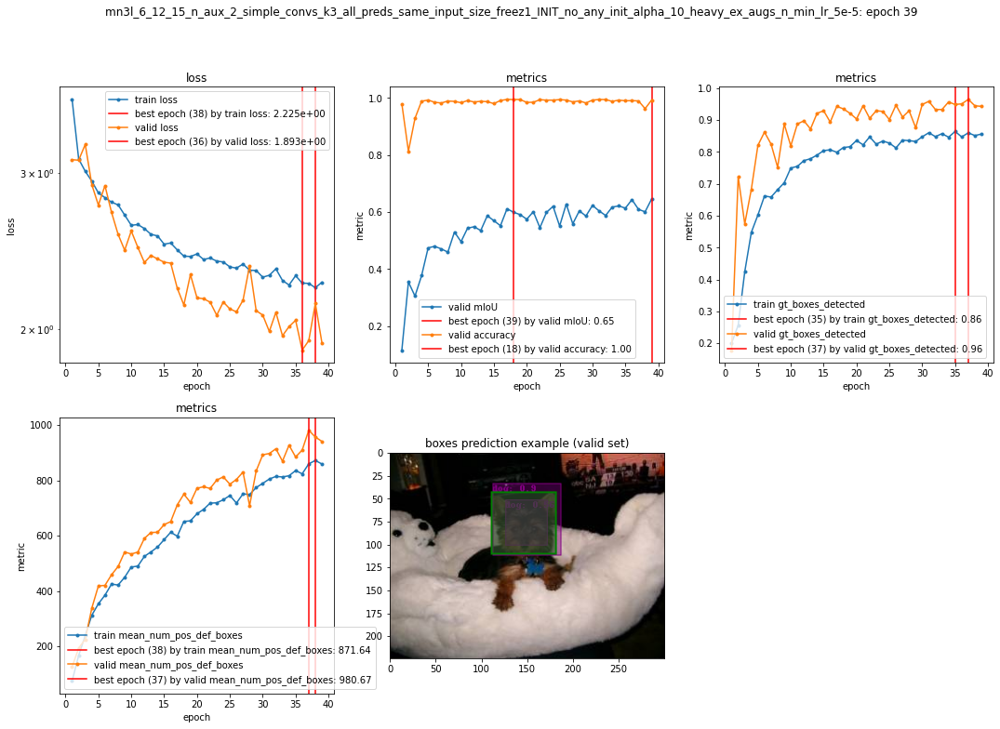

priors scales usage report for train (epoch 39):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             20
       0.20 |              0.69 |            557
       0.43 |              0.90 |            960
       0.67 |              0.93 |            581
       0.90 |              0.95 |            252
------------------------------------------------

priors scales usage report for valid (epoch 39):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.92 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




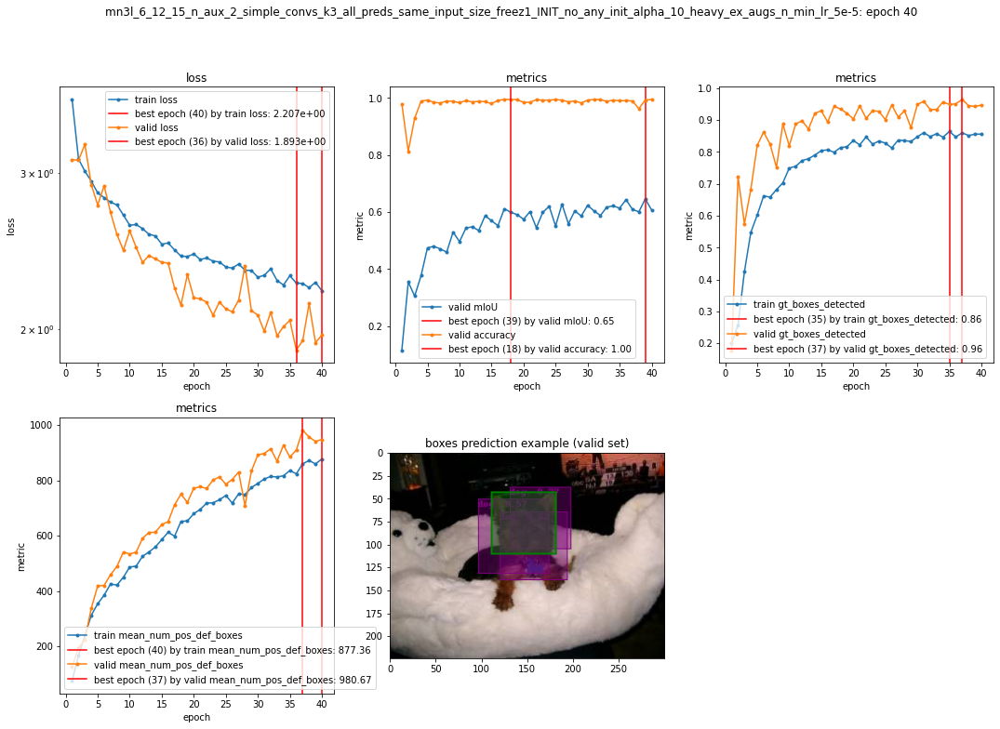

priors scales usage report for train (epoch 40):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.09 |             22
       0.20 |              0.72 |            546
       0.43 |              0.89 |            970
       0.67 |              0.94 |            570
       0.90 |              0.91 |            262
------------------------------------------------

priors scales usage report for valid (epoch 40):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.93 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




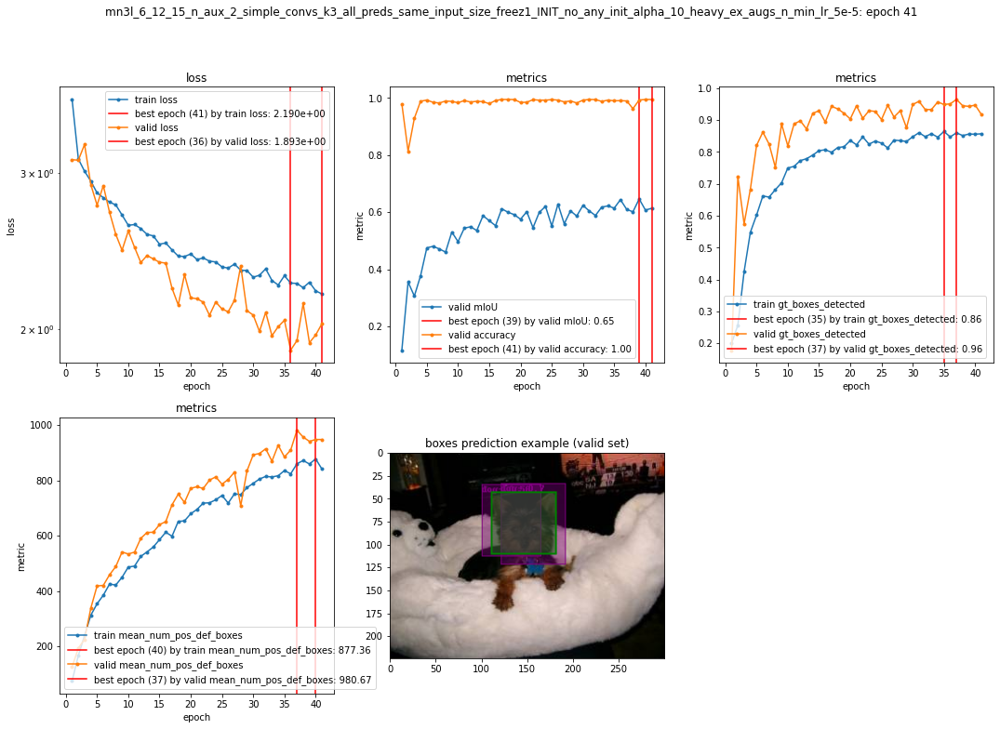

priors scales usage report for train (epoch 41):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             17
       0.20 |              0.74 |            579
       0.43 |              0.88 |            952
       0.67 |              0.93 |            559
       0.90 |              0.94 |            263
------------------------------------------------

priors scales usage report for valid (epoch 41):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.86 |            174
       0.43 |              0.98 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




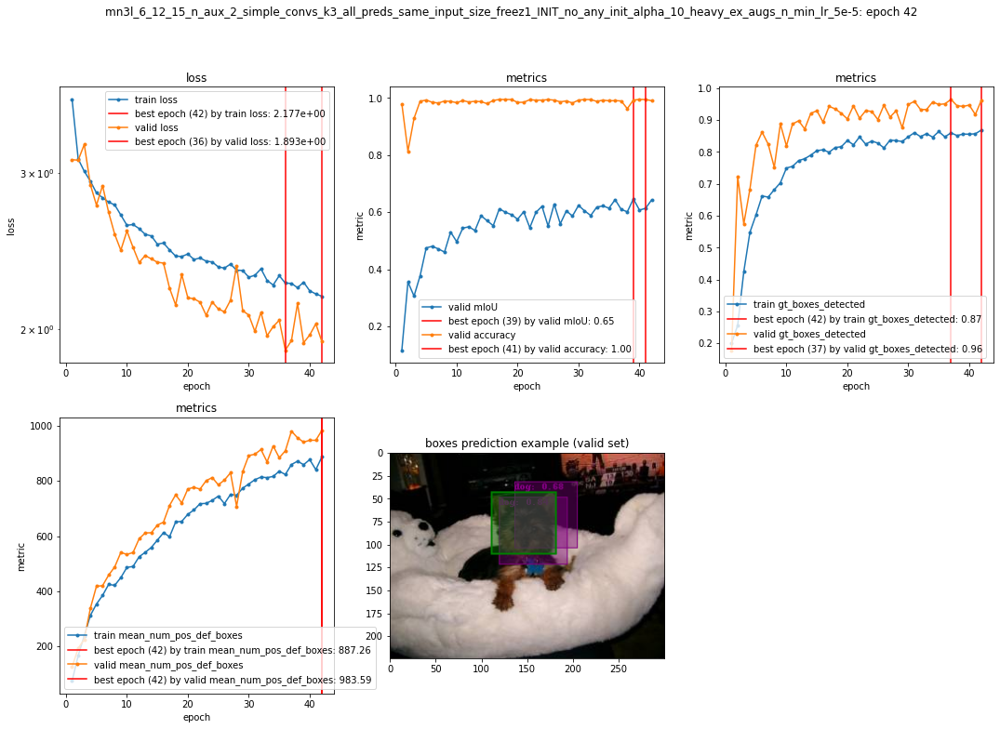

priors scales usage report for train (epoch 42):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.72 |            556
       0.43 |              0.91 |            950
       0.67 |              0.93 |            593
       0.90 |              0.96 |            252
------------------------------------------------

priors scales usage report for valid (epoch 42):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.97 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




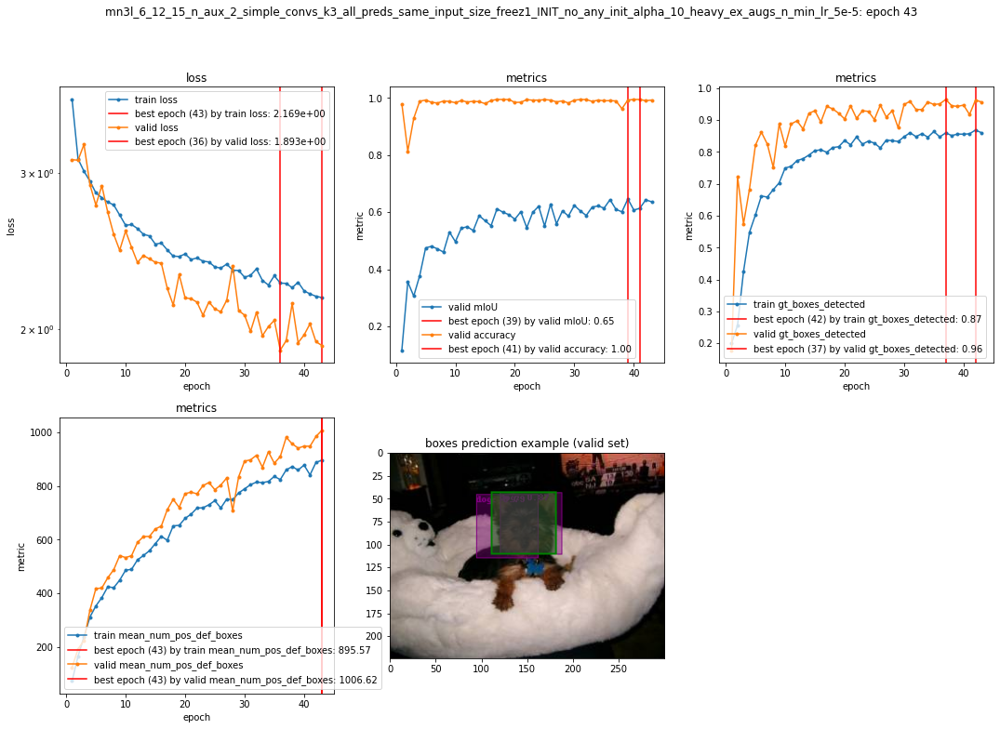

priors scales usage report for train (epoch 43):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             22
       0.20 |              0.74 |            549
       0.43 |              0.90 |            976
       0.67 |              0.93 |            578
       0.90 |              0.91 |            245
------------------------------------------------

priors scales usage report for valid (epoch 43):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.95 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




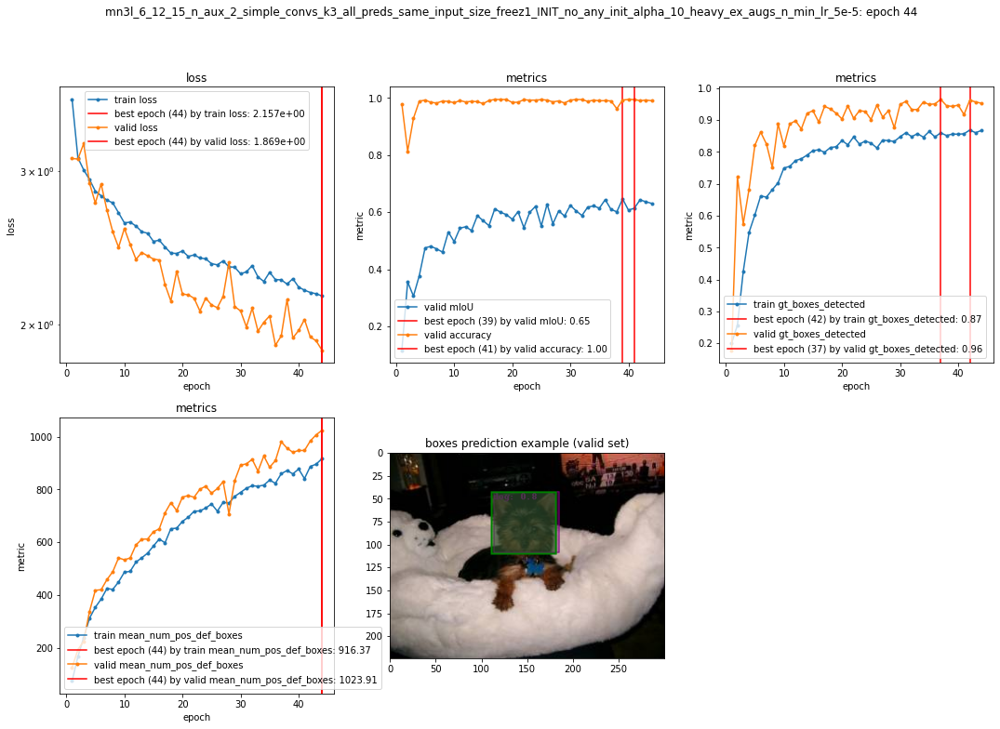

priors scales usage report for train (epoch 44):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             22
       0.20 |              0.75 |            557
       0.43 |              0.90 |            959
       0.67 |              0.92 |            570
       0.90 |              0.93 |            262
------------------------------------------------

priors scales usage report for valid (epoch 44):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.96 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




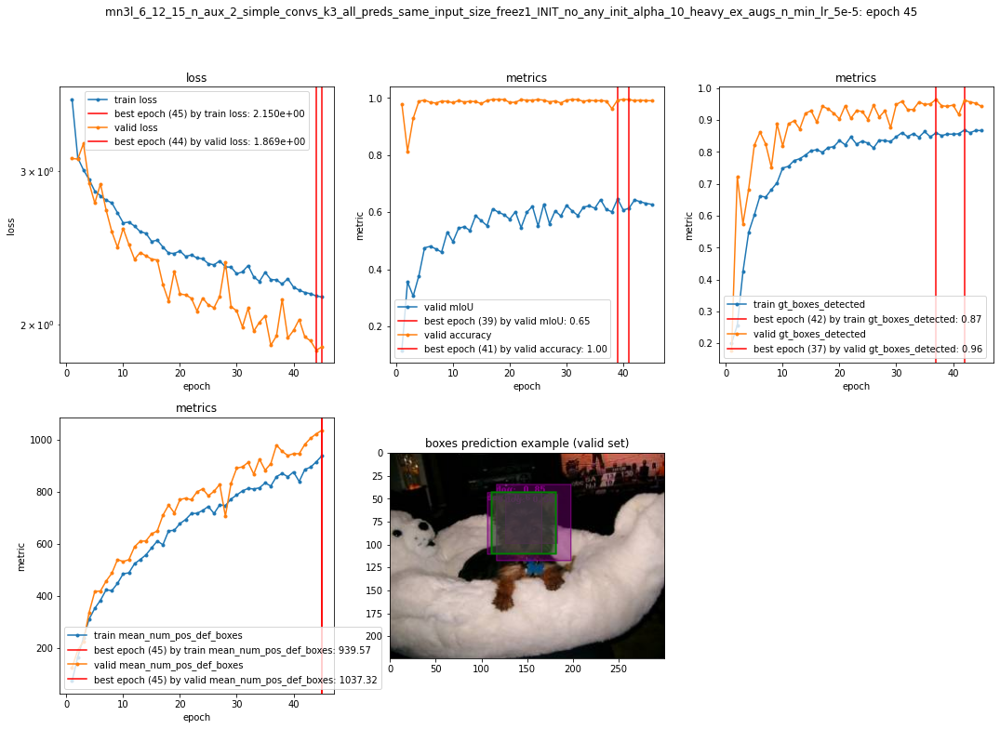

priors scales usage report for train (epoch 45):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             25
       0.20 |              0.75 |            562
       0.43 |              0.89 |            952
       0.67 |              0.94 |            572
       0.90 |              0.94 |            259
------------------------------------------------

priors scales usage report for valid (epoch 45):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.93 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




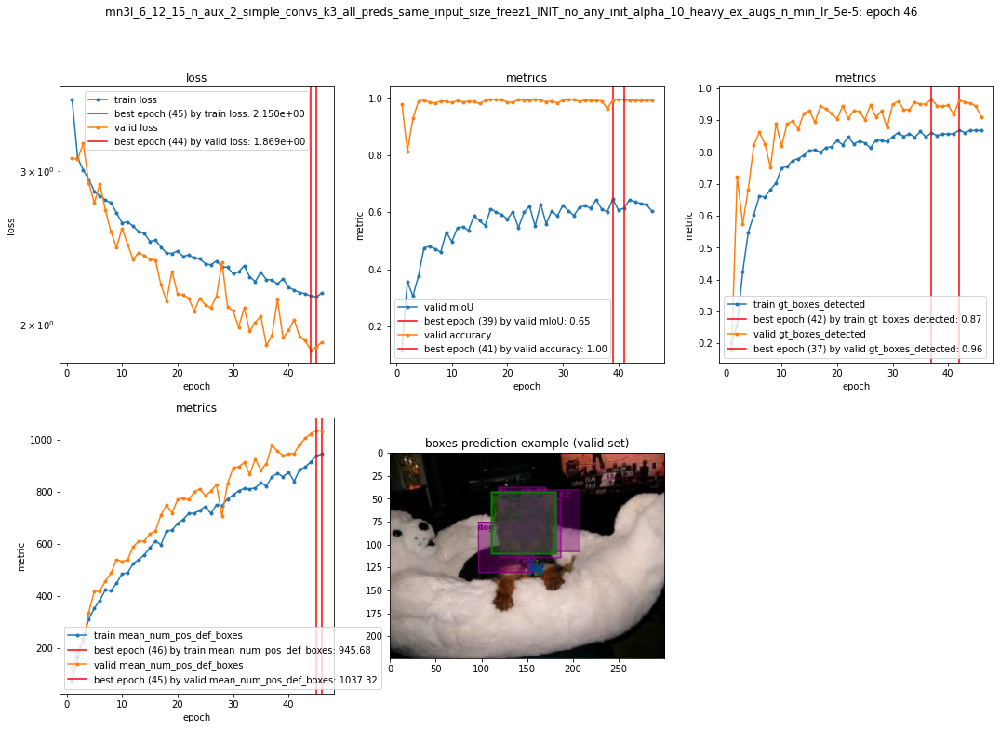

priors scales usage report for train (epoch 46):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             25
       0.20 |              0.75 |            556
       0.43 |              0.90 |            958
       0.67 |              0.93 |            556
       0.90 |              0.95 |            275
------------------------------------------------

priors scales usage report for valid (epoch 46):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.84 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




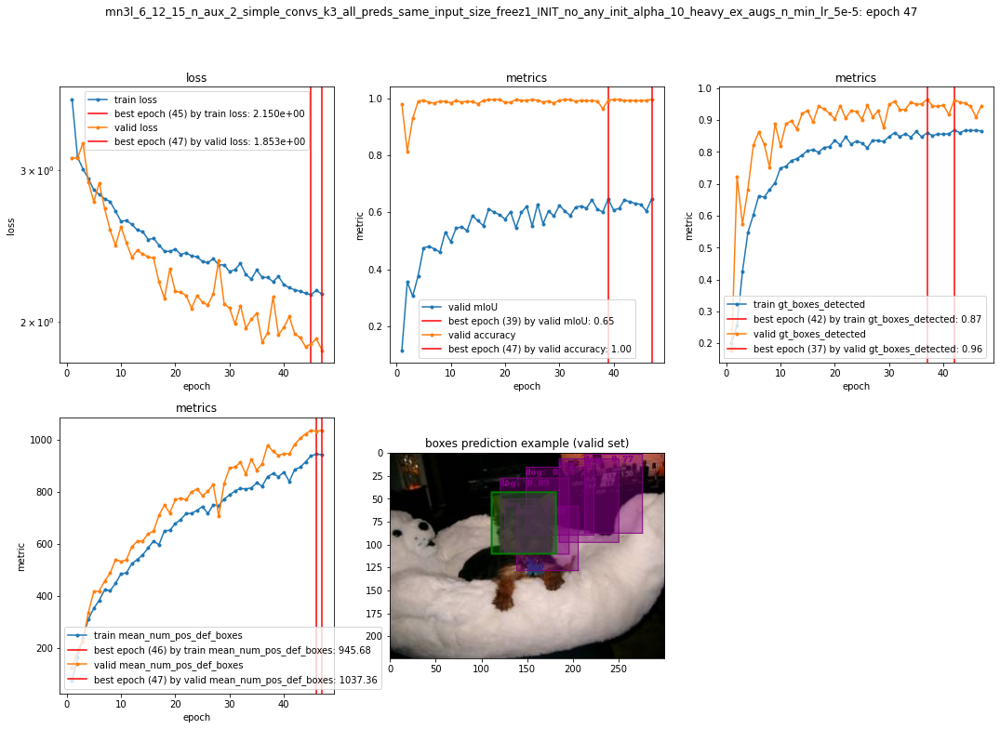

priors scales usage report for train (epoch 47):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             22
       0.20 |              0.74 |            548
       0.43 |              0.90 |            936
       0.67 |              0.93 |            594
       0.90 |              0.94 |            270
------------------------------------------------

priors scales usage report for valid (epoch 47):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.94 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




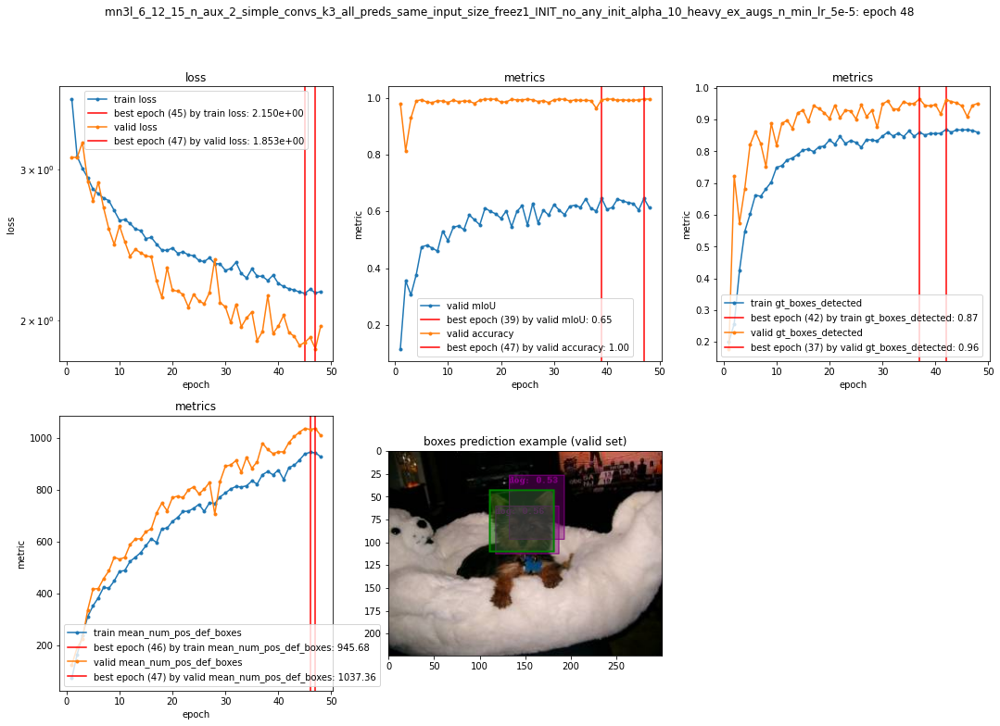

priors scales usage report for train (epoch 48):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.72 |            567
       0.43 |              0.89 |            941
       0.67 |              0.94 |            578
       0.90 |              0.95 |            265
------------------------------------------------

priors scales usage report for valid (epoch 48):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.94 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




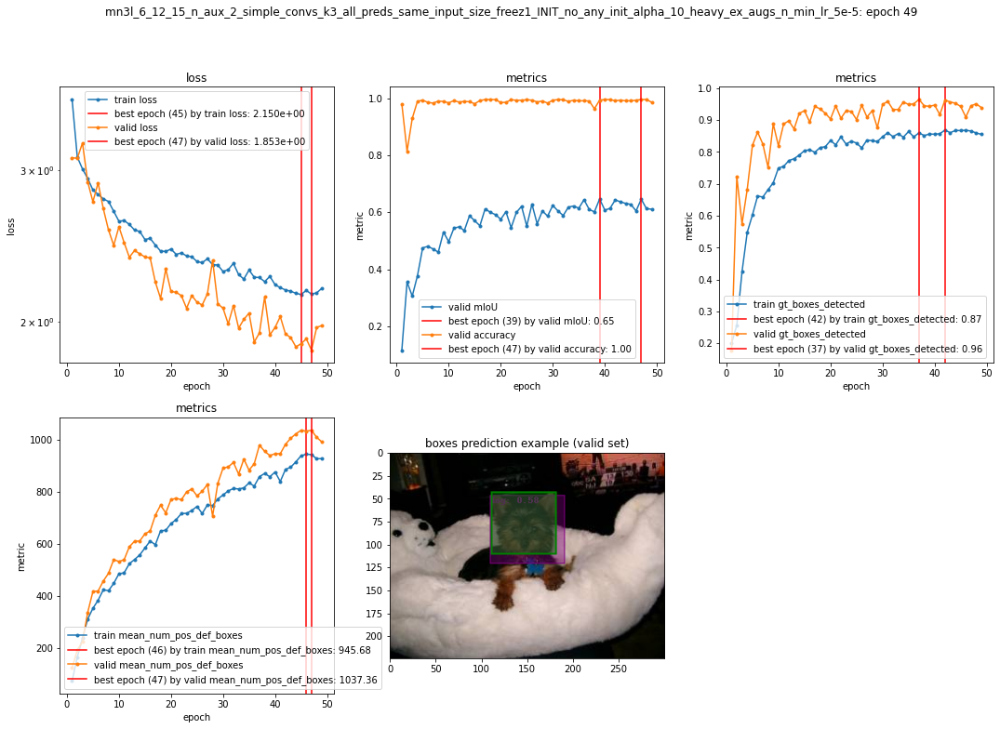

priors scales usage report for train (epoch 49):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             19
       0.20 |              0.75 |            553
       0.43 |              0.88 |            959
       0.67 |              0.92 |            581
       0.90 |              0.89 |            258
------------------------------------------------

priors scales usage report for valid (epoch 49):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.92 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




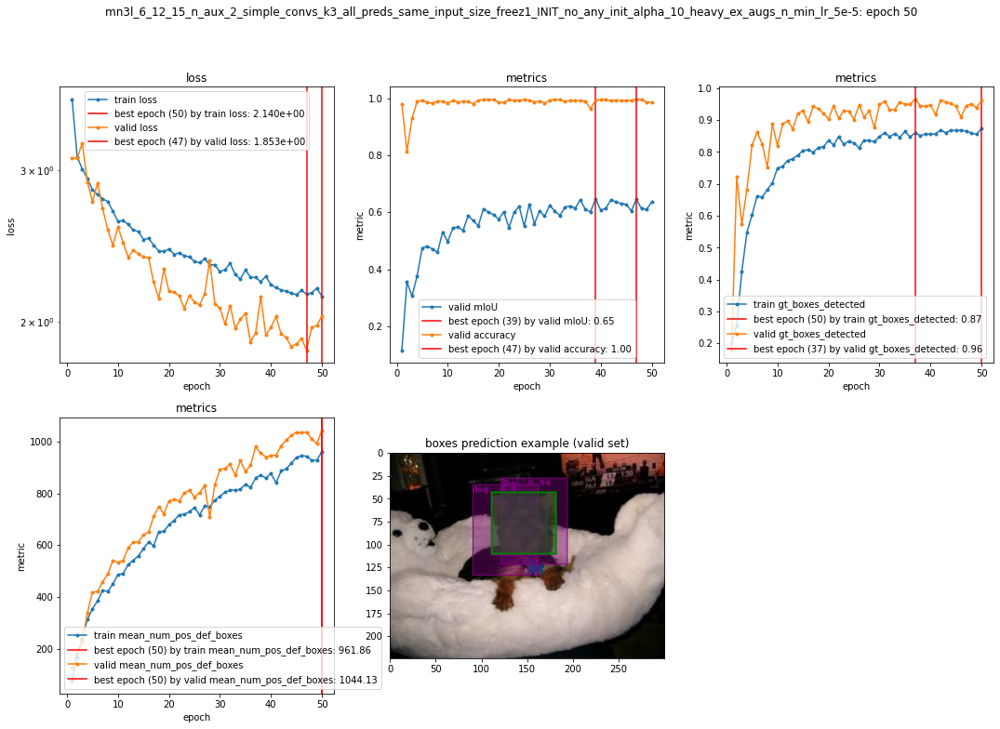

priors scales usage report for train (epoch 50):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             21
       0.20 |              0.74 |            570
       0.43 |              0.91 |            928
       0.67 |              0.94 |            603
       0.90 |              0.96 |            248
------------------------------------------------

priors scales usage report for valid (epoch 50):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.97 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------





In [50]:
NUM_EPOCHS = 50
train(
    TRAIN_HISTORY_STORAGE,
    MODEL_NAME, model, NUM_EPOCHS,
    train_loader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls, optimizer, valid_loader,
    alpha=10,
    lr_scheduler=lr_scheduler, lr_scheduler_1st_epoch=3, use_valid_loss_for_scheduler=False, init_epoch_callback=init_epoch_callback, max_grad_norm=MAX_GRAD_NORM,
    calc_mIoU=MetricsCalculation.valid, calc_accuracy=MetricsCalculation.valid,
    calc_gt_boxes_detected=MetricsCalculation.both, calc_mean_num_pos_def_boxes=MetricsCalculation.both,
    report_priors_scales_usage=MetricsCalculation.both,
    prediction_example_choosing='first', show_only_last_plot=False,
    # early_stopping=True, es_patience=2, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=3, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=5, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=7, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=9, es_rel_threshold=1e-2,
    # early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=True,
    early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=False,
    device=DEVICE)

In [51]:
len(optimizer.param_groups), optimizer.param_groups[0]['lr']



(1, 0.0003)

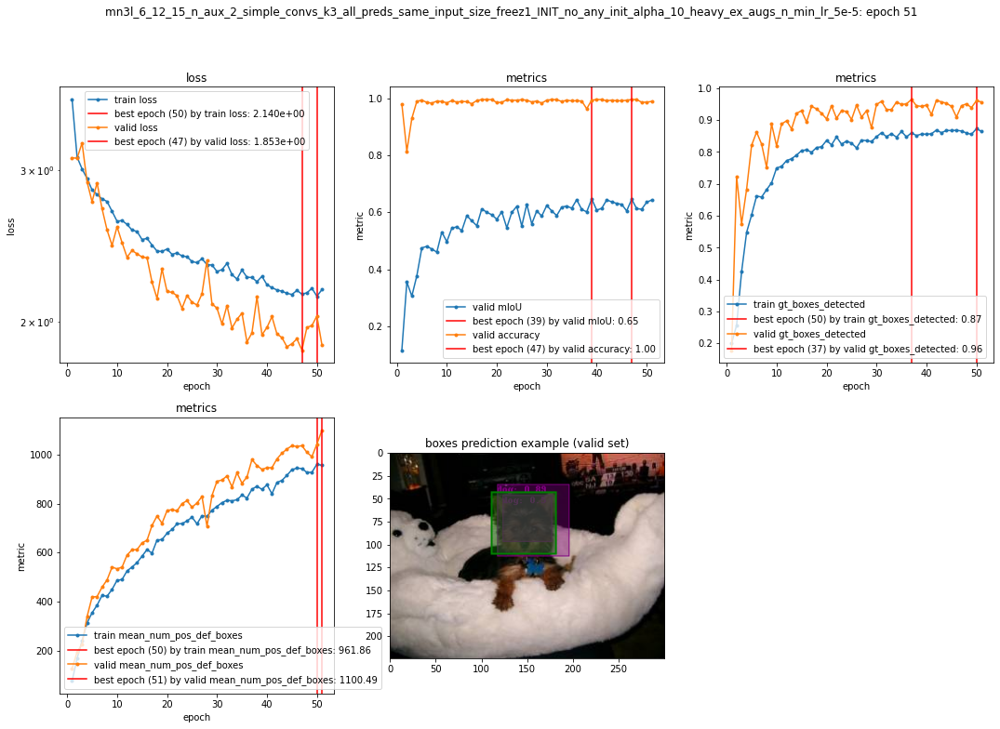

priors scales usage report for train (epoch 51):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.04 |             23
       0.20 |              0.76 |            567
       0.43 |              0.88 |            968
       0.67 |              0.94 |            555
       0.90 |              0.95 |            257
------------------------------------------------

priors scales usage report for valid (epoch 51):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.97 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




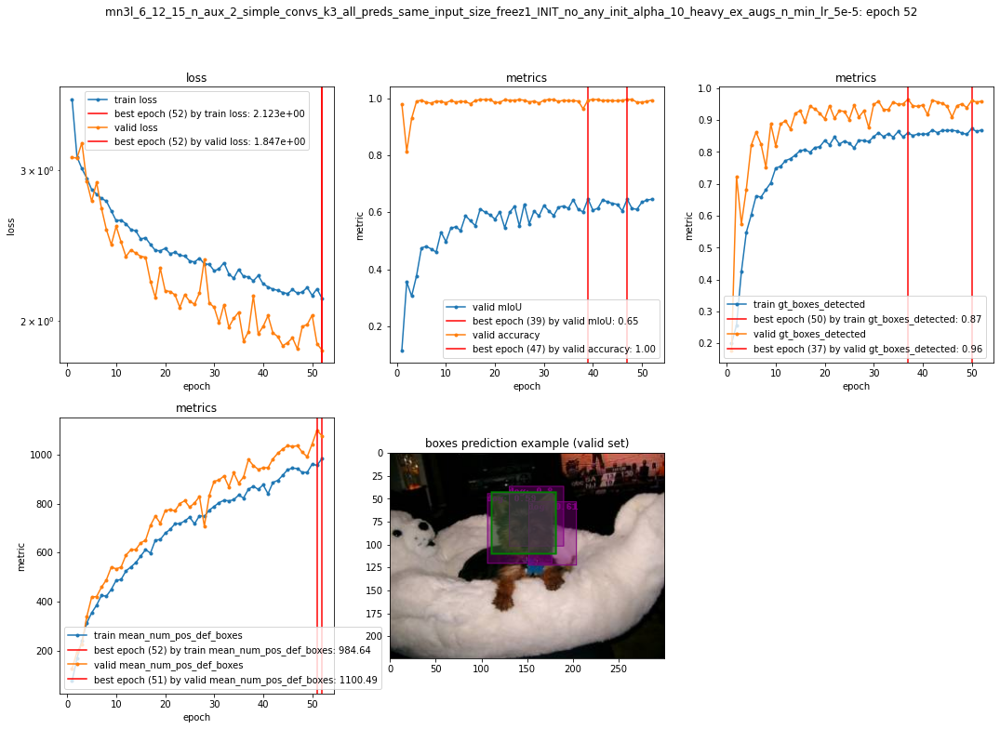

priors scales usage report for train (epoch 52):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.11 |             18
       0.20 |              0.77 |            556
       0.43 |              0.90 |            967
       0.67 |              0.92 |            563
       0.90 |              0.89 |            266
------------------------------------------------

priors scales usage report for valid (epoch 52):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.97 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




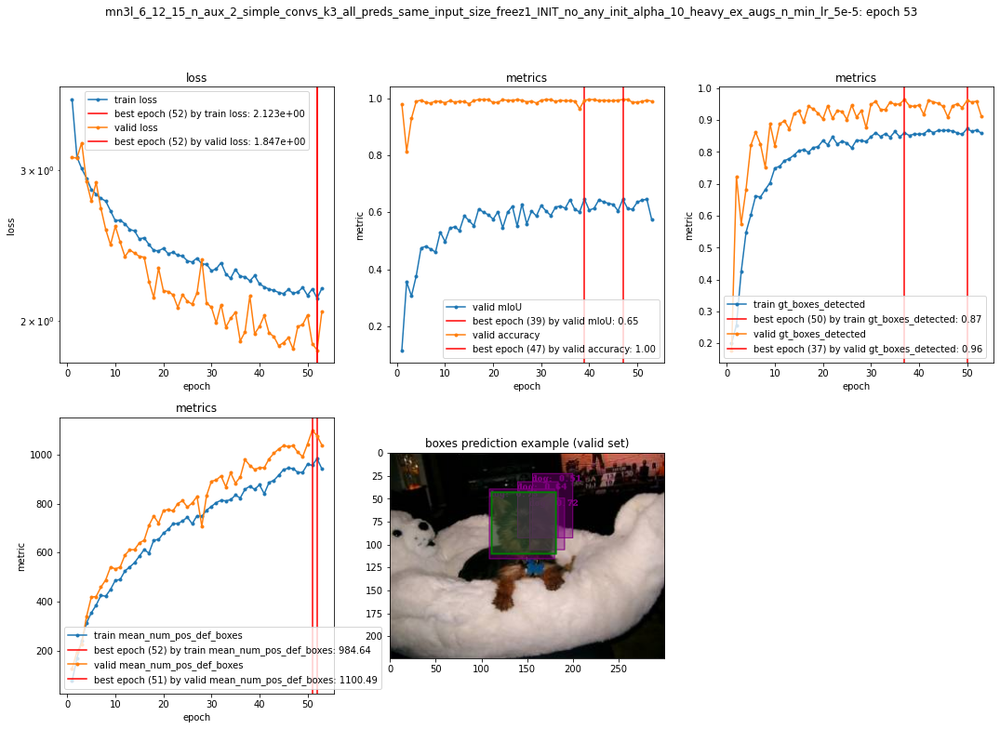

priors scales usage report for train (epoch 53):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             21
       0.20 |              0.73 |            547
       0.43 |              0.90 |            966
       0.67 |              0.92 |            589
       0.90 |              0.92 |            247
------------------------------------------------

priors scales usage report for valid (epoch 53):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.84 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




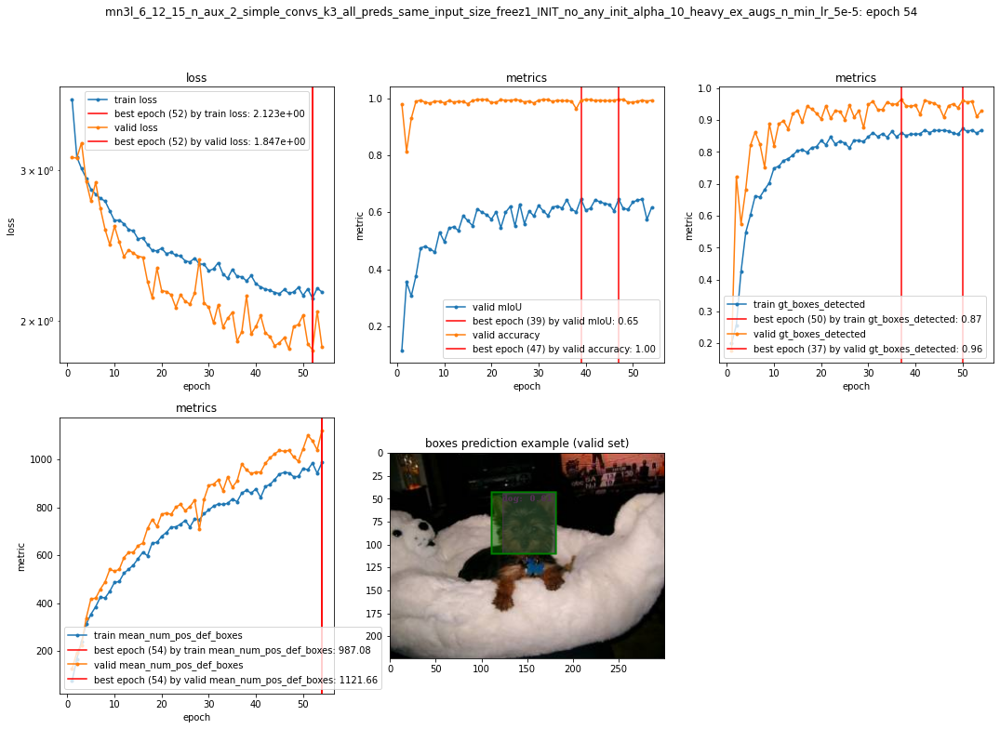

priors scales usage report for train (epoch 54):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.04 |             23
       0.20 |              0.76 |            563
       0.43 |              0.91 |            933
       0.67 |              0.92 |            573
       0.90 |              0.93 |            278
------------------------------------------------

priors scales usage report for valid (epoch 54):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.88 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




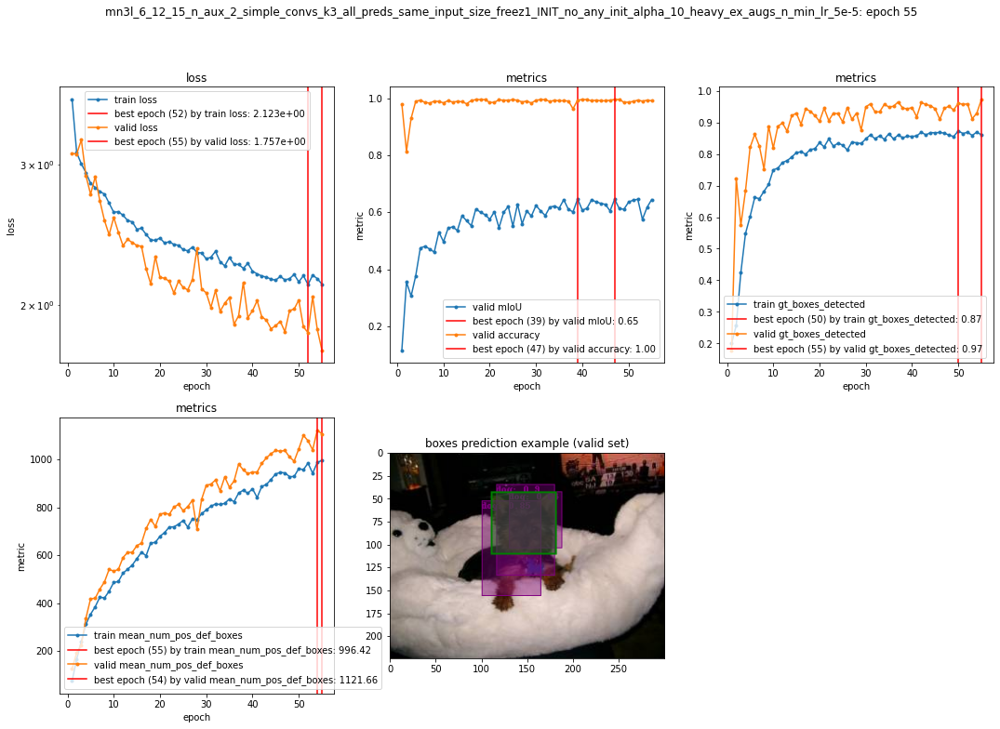

priors scales usage report for train (epoch 55):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             21
       0.20 |              0.74 |            579
       0.43 |              0.88 |            942
       0.67 |              0.93 |            569
       0.90 |              0.95 |            259
------------------------------------------------

priors scales usage report for valid (epoch 55):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.98 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




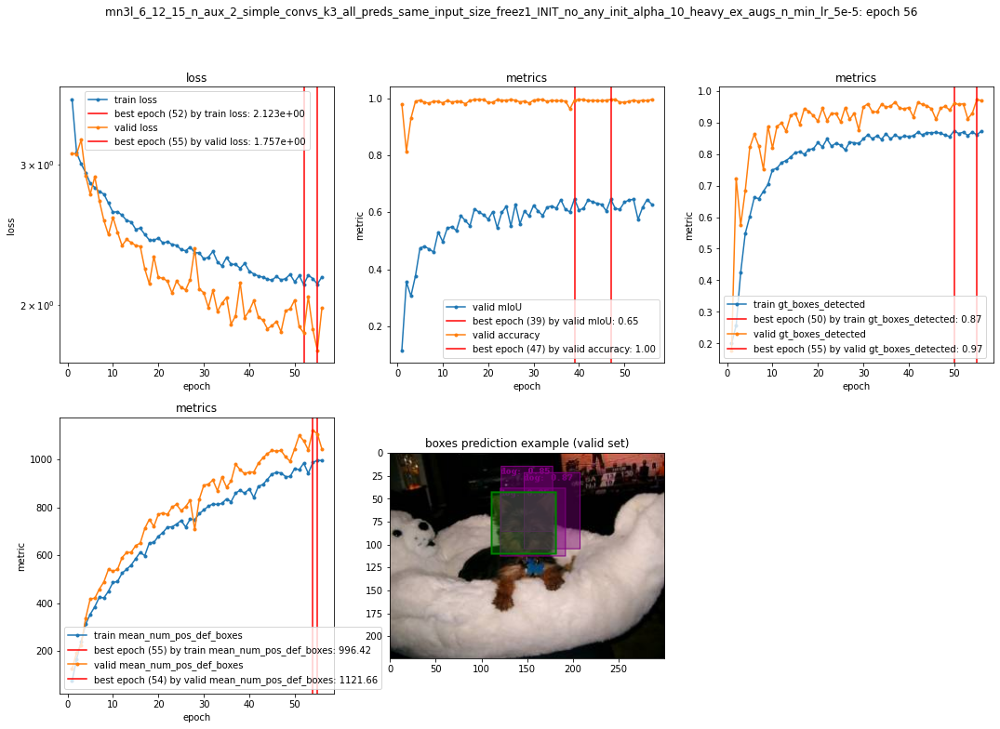

priors scales usage report for train (epoch 56):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             20
       0.20 |              0.79 |            557
       0.43 |              0.89 |            972
       0.67 |              0.94 |            544
       0.90 |              0.92 |            277
------------------------------------------------

priors scales usage report for valid (epoch 56):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.98 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




Epoch    55: reducing learning rate of group 0 to 1.5000e-04.


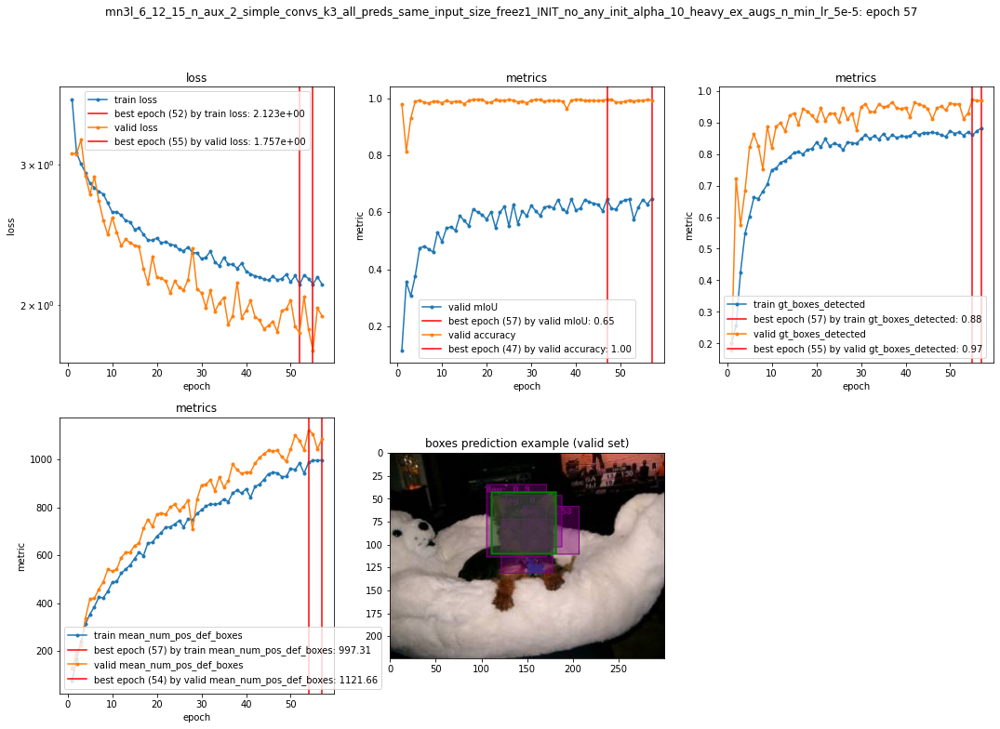

priors scales usage report for train (epoch 57):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             22
       0.20 |              0.75 |            551
       0.43 |              0.91 |            966
       0.67 |              0.95 |            575
       0.90 |              0.97 |            256
------------------------------------------------

priors scales usage report for valid (epoch 57):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




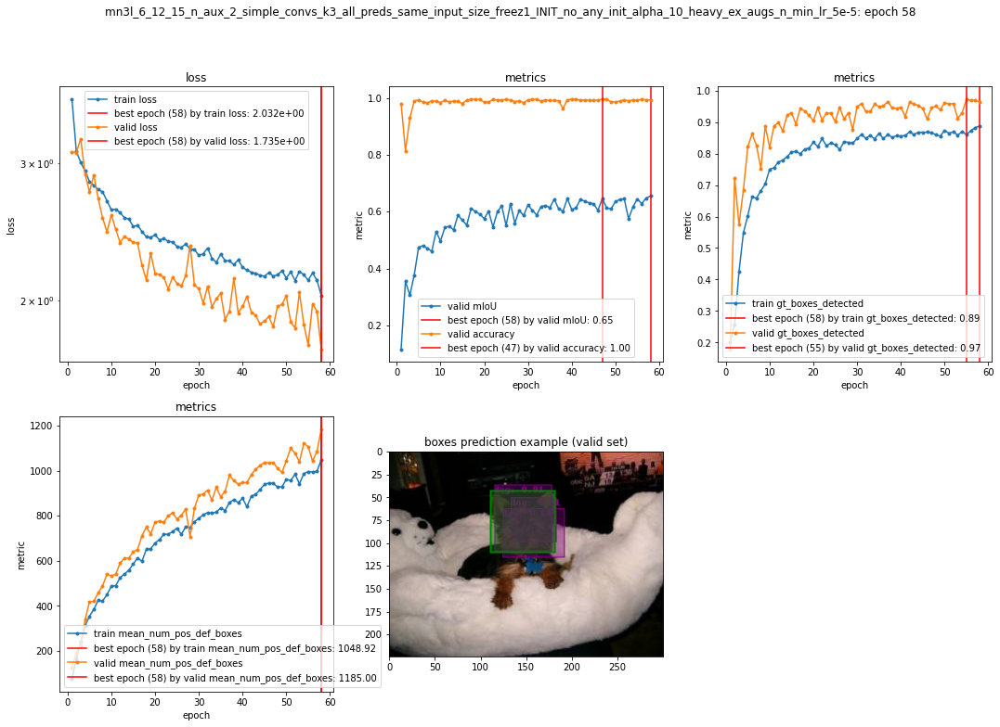

priors scales usage report for train (epoch 58):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             23
       0.20 |              0.80 |            553
       0.43 |              0.92 |            965
       0.67 |              0.94 |            563
       0.90 |              0.92 |            266
------------------------------------------------

priors scales usage report for valid (epoch 58):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.97 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




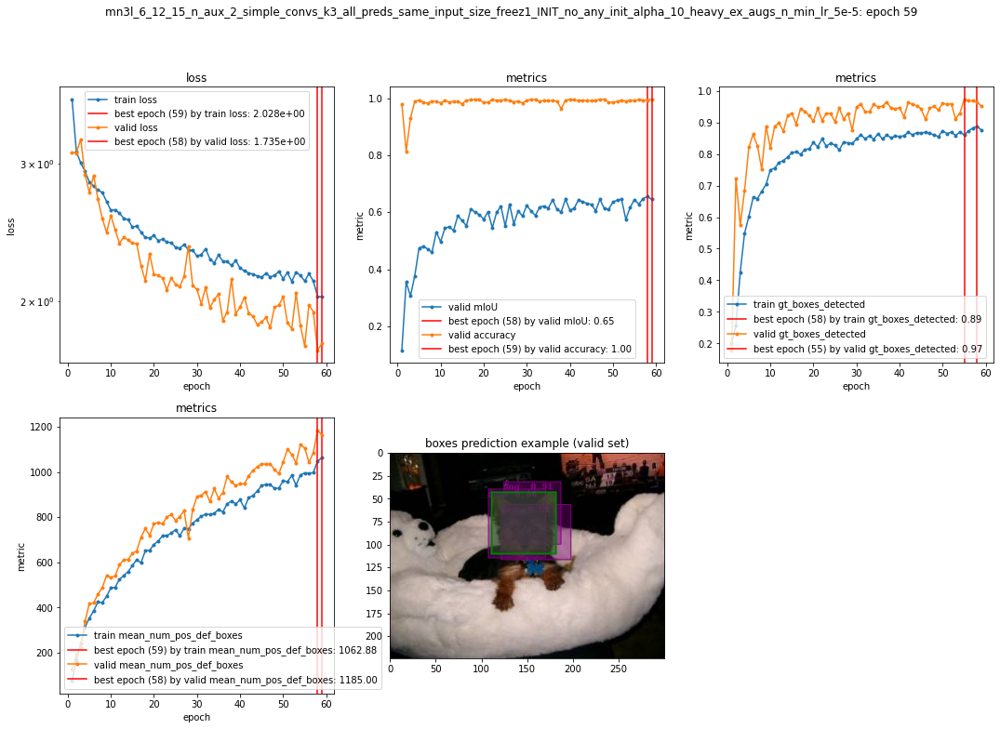

priors scales usage report for train (epoch 59):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.16 |             19
       0.20 |              0.79 |            570
       0.43 |              0.90 |            943
       0.67 |              0.91 |            596
       0.90 |              0.93 |            242
------------------------------------------------

priors scales usage report for valid (epoch 59):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.07 |             14
       0.20 |              0.95 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




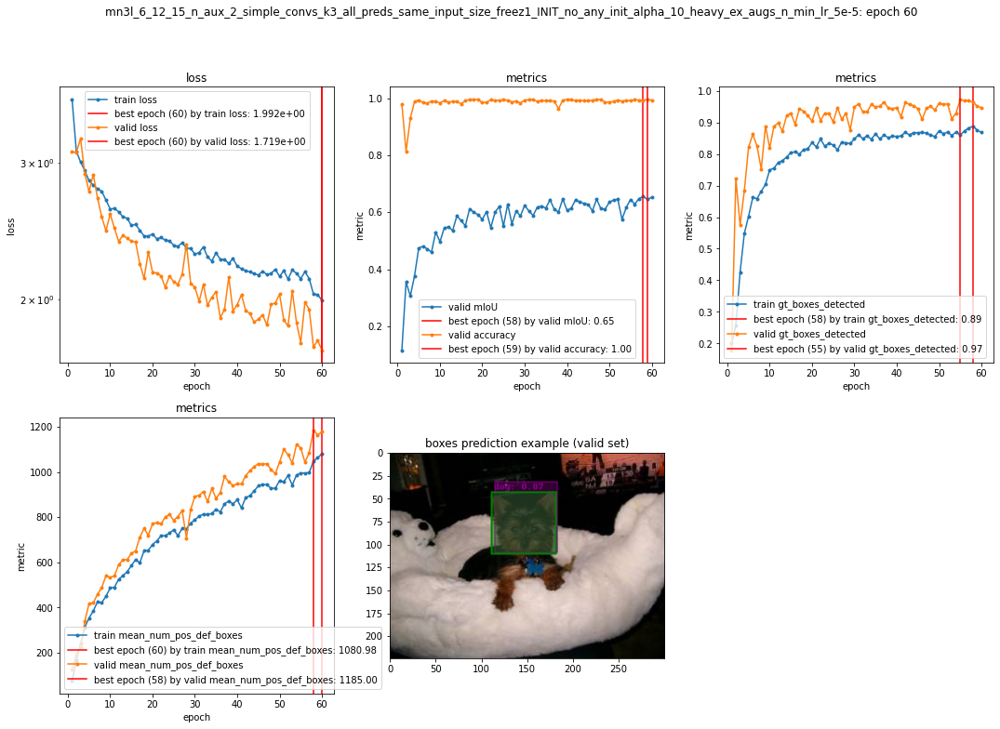

priors scales usage report for train (epoch 60):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.06 |             16
       0.20 |              0.75 |            561
       0.43 |              0.89 |            982
       0.67 |              0.93 |            549
       0.90 |              0.95 |            262
------------------------------------------------

priors scales usage report for valid (epoch 60):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.93 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




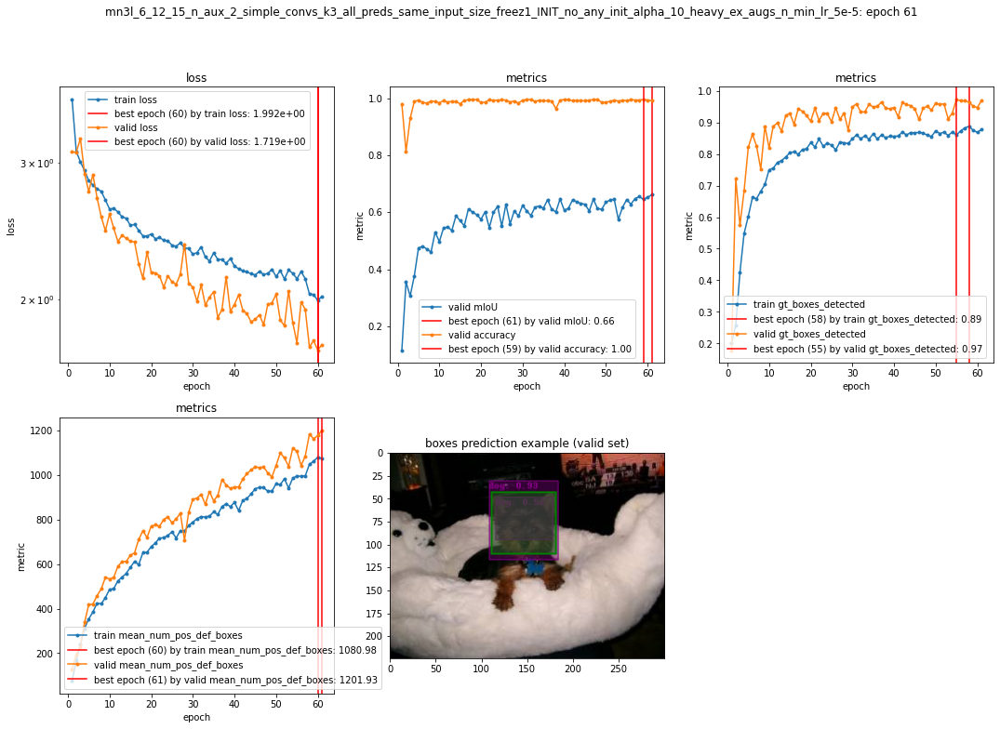

priors scales usage report for train (epoch 61):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.78 |            531
       0.43 |              0.90 |            975
       0.67 |              0.94 |            591
       0.90 |              0.93 |            252
------------------------------------------------

priors scales usage report for valid (epoch 61):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




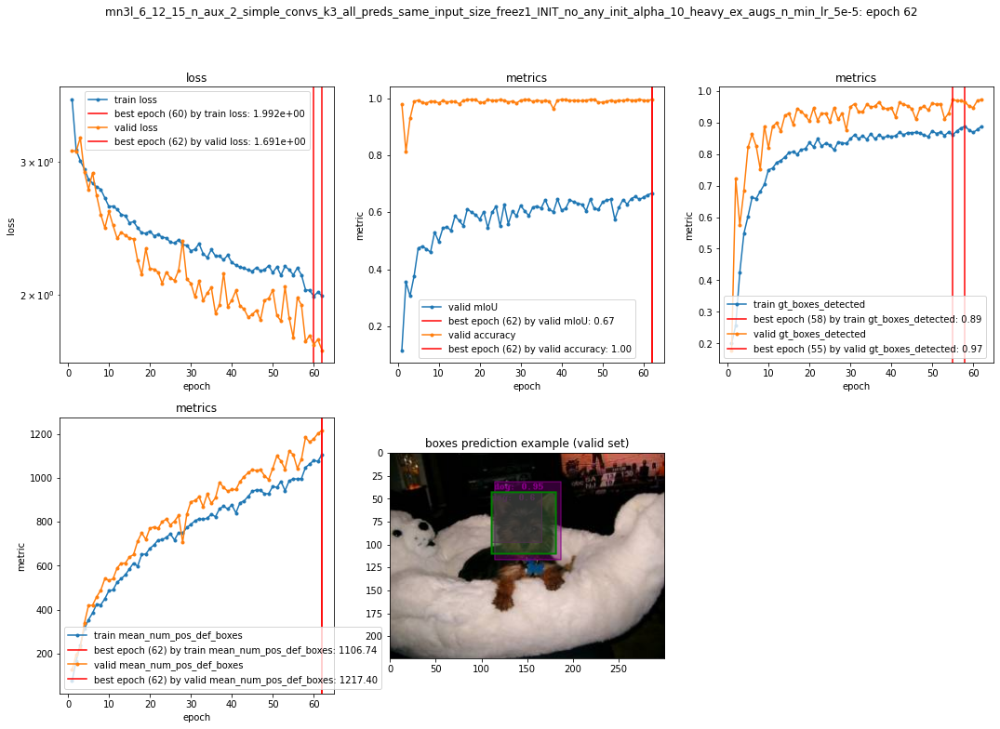

priors scales usage report for train (epoch 62):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.82 |            570
       0.43 |              0.90 |            952
       0.67 |              0.94 |            582
       0.90 |              0.94 |            249
------------------------------------------------

priors scales usage report for valid (epoch 62):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




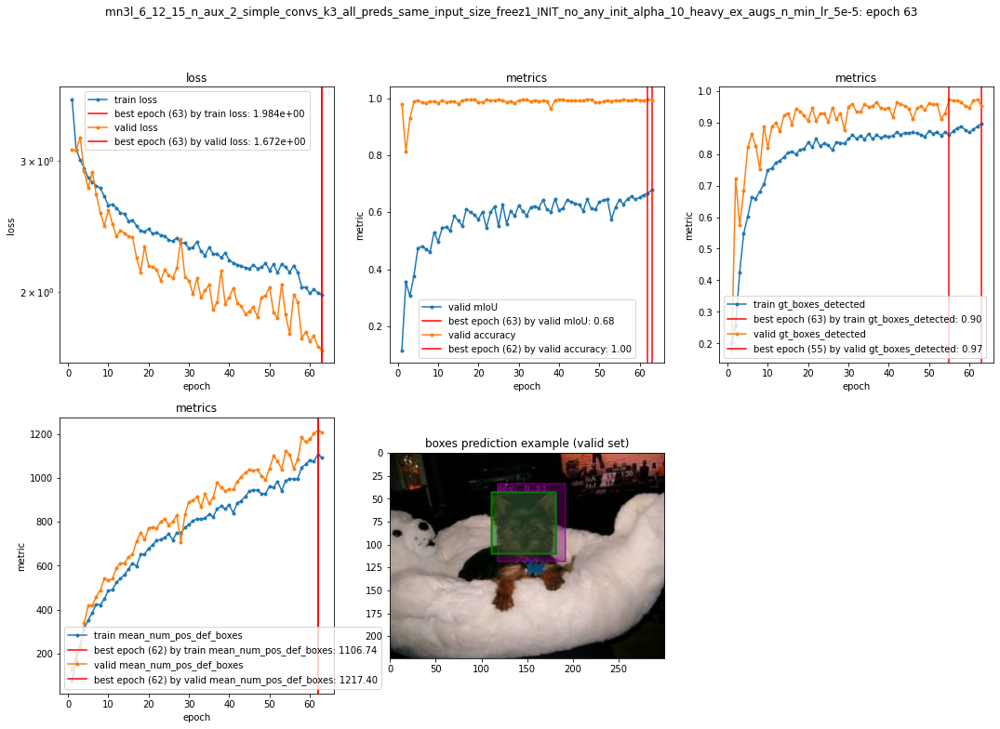

priors scales usage report for train (epoch 63):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.18 |             22
       0.20 |              0.81 |            558
       0.43 |              0.91 |            977
       0.67 |              0.94 |            535
       0.90 |              0.98 |            278
------------------------------------------------

priors scales usage report for valid (epoch 63):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.95 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




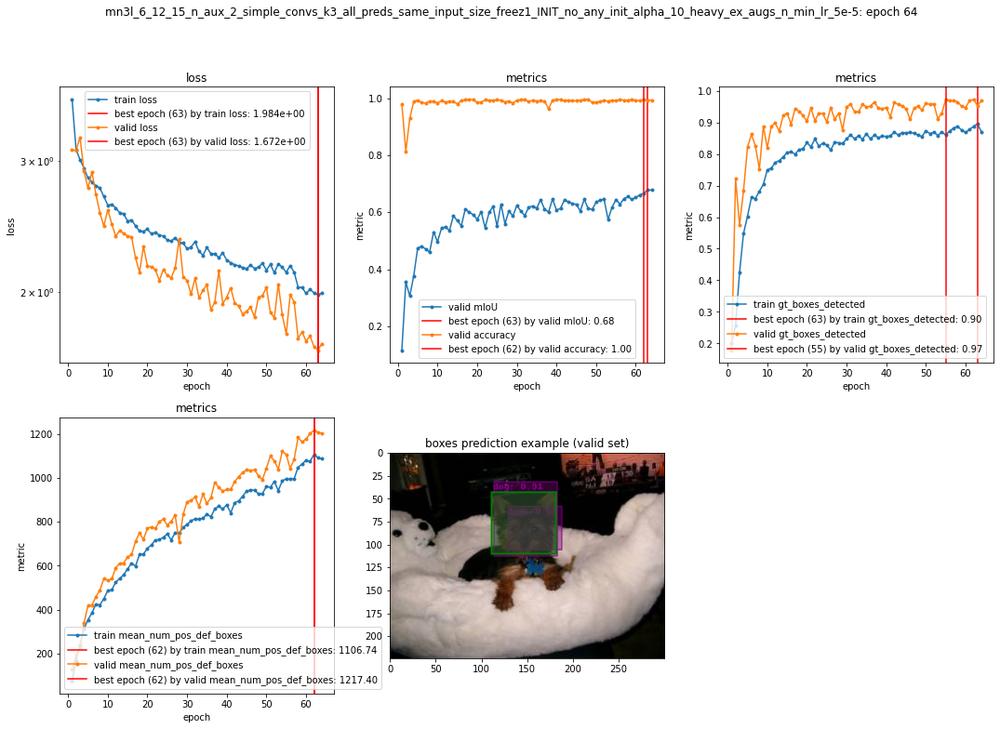

priors scales usage report for train (epoch 64):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.77 |            566
       0.43 |              0.90 |            939
       0.67 |              0.92 |            582
       0.90 |              0.93 |            265
------------------------------------------------

priors scales usage report for valid (epoch 64):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




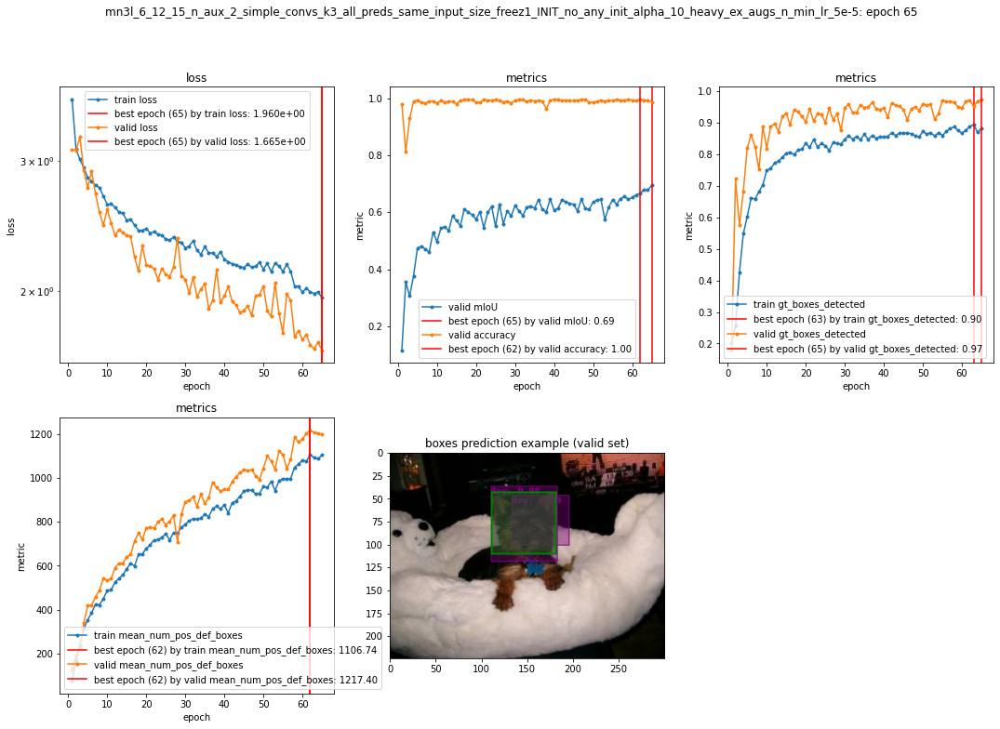

priors scales usage report for train (epoch 65):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             20
       0.20 |              0.80 |            556
       0.43 |              0.91 |            962
       0.67 |              0.93 |            586
       0.90 |              0.95 |            246
------------------------------------------------

priors scales usage report for valid (epoch 65):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




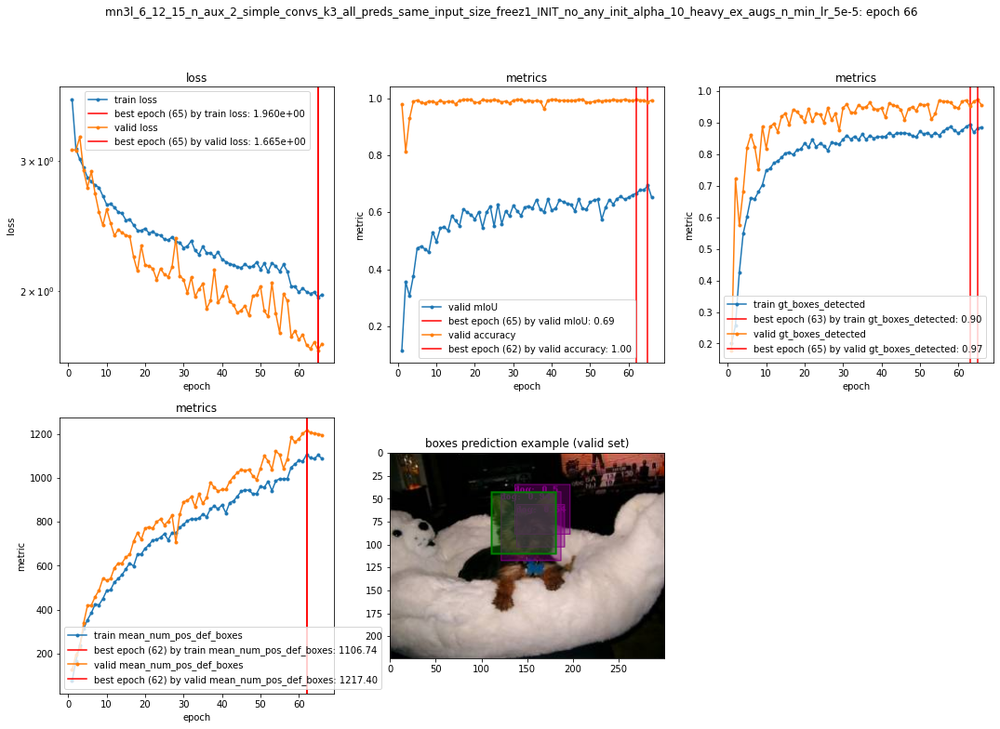

priors scales usage report for train (epoch 66):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             19
       0.20 |              0.81 |            565
       0.43 |              0.90 |            968
       0.67 |              0.94 |            557
       0.90 |              0.94 |            261
------------------------------------------------

priors scales usage report for valid (epoch 66):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.96 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




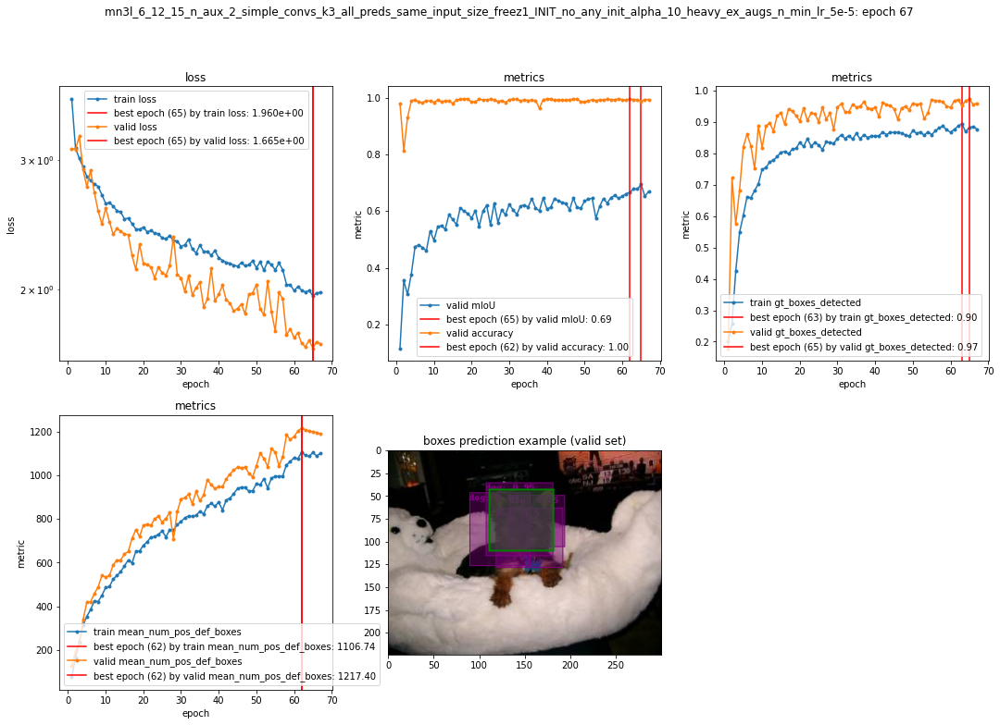

priors scales usage report for train (epoch 67):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             21
       0.20 |              0.77 |            541
       0.43 |              0.91 |            992
       0.67 |              0.93 |            544
       0.90 |              0.94 |            272
------------------------------------------------

priors scales usage report for valid (epoch 67):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.97 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




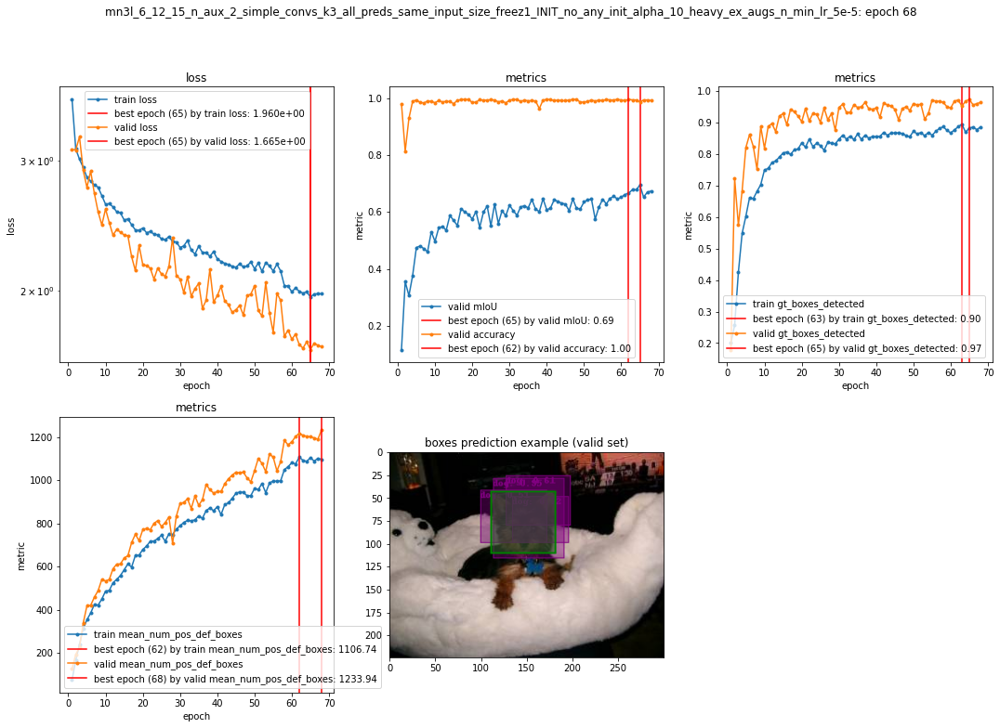

priors scales usage report for train (epoch 68):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             19
       0.20 |              0.80 |            554
       0.43 |              0.91 |            967
       0.67 |              0.94 |            562
       0.90 |              0.94 |            268
------------------------------------------------

priors scales usage report for valid (epoch 68):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.98 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




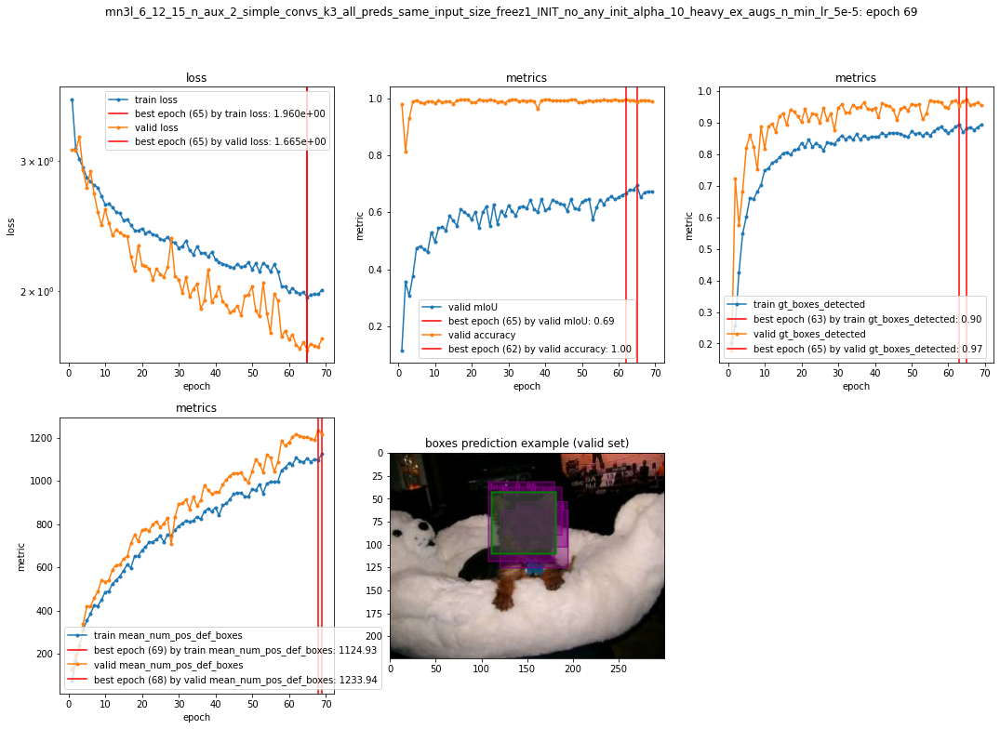

priors scales usage report for train (epoch 69):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.80 |            562
       0.43 |              0.92 |            934
       0.67 |              0.95 |            583
       0.90 |              0.94 |            270
------------------------------------------------

priors scales usage report for valid (epoch 69):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.96 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




Epoch    68: reducing learning rate of group 0 to 7.5000e-05.


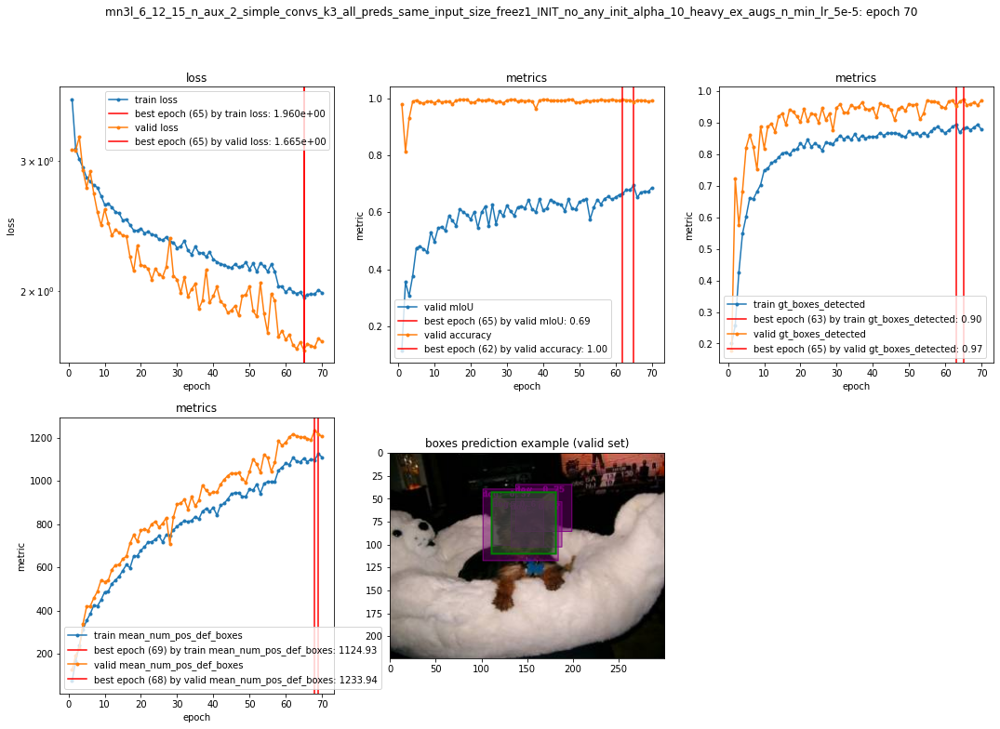

priors scales usage report for train (epoch 70):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.80 |            556
       0.43 |              0.89 |            973
       0.67 |              0.93 |            555
       0.90 |              0.93 |            269
------------------------------------------------

priors scales usage report for valid (epoch 70):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




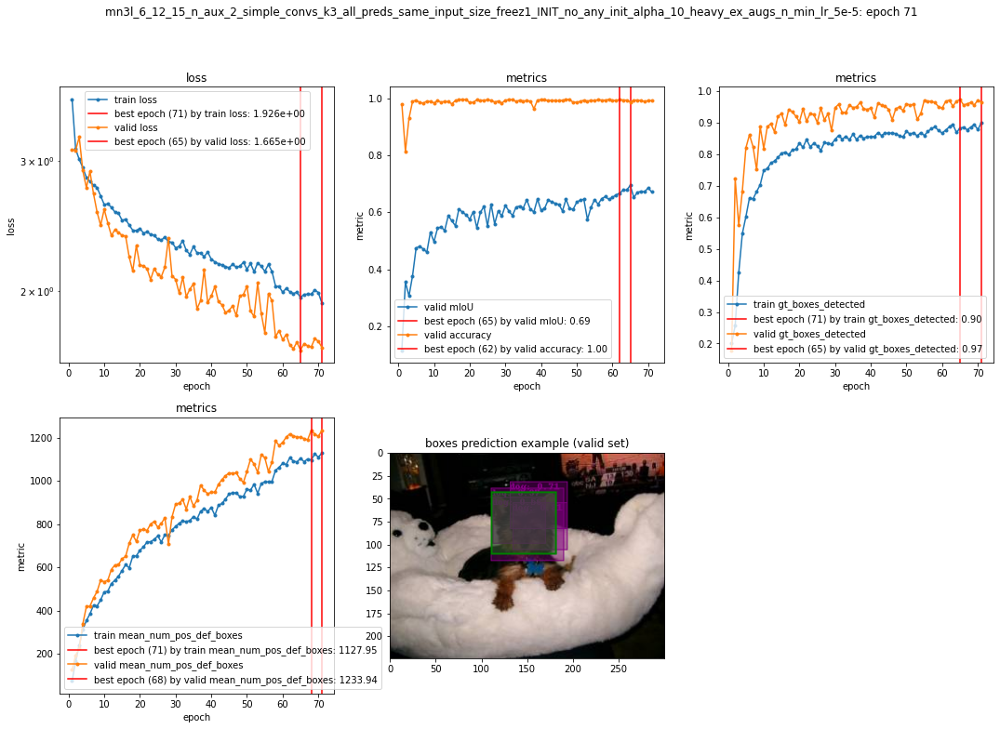

priors scales usage report for train (epoch 71):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             19
       0.20 |              0.84 |            590
       0.43 |              0.92 |            949
       0.67 |              0.93 |            557
       0.90 |              0.95 |            255
------------------------------------------------

priors scales usage report for valid (epoch 71):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.98 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




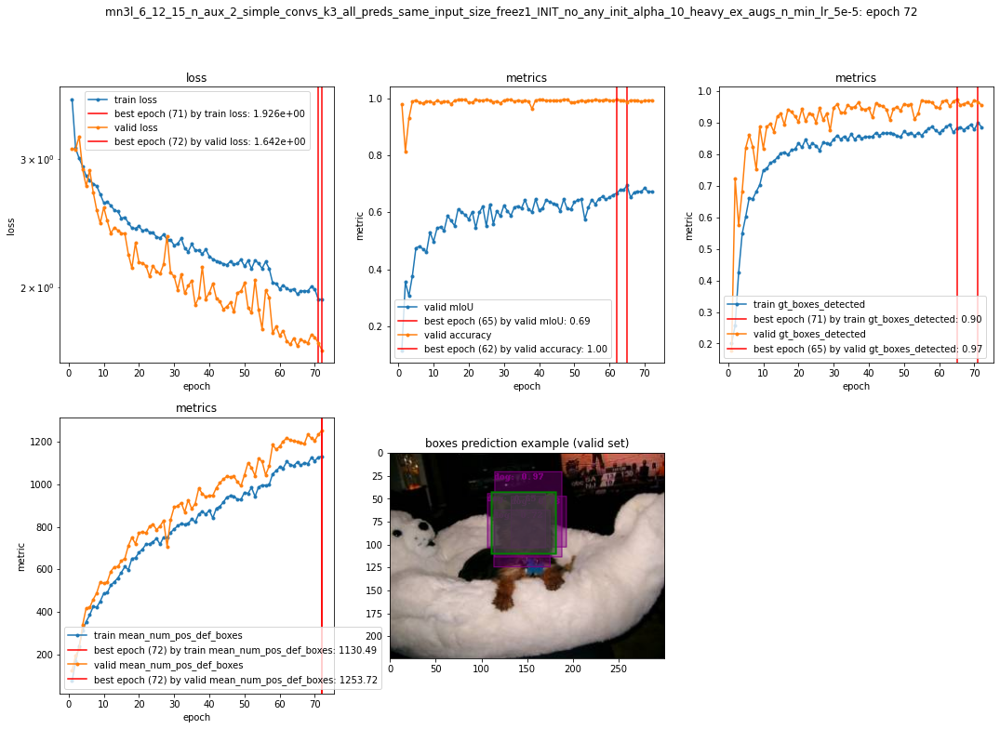

priors scales usage report for train (epoch 72):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             21
       0.20 |              0.79 |            534
       0.43 |              0.91 |          1,000
       0.67 |              0.94 |            557
       0.90 |              0.93 |            258
------------------------------------------------

priors scales usage report for valid (epoch 72):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.95 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




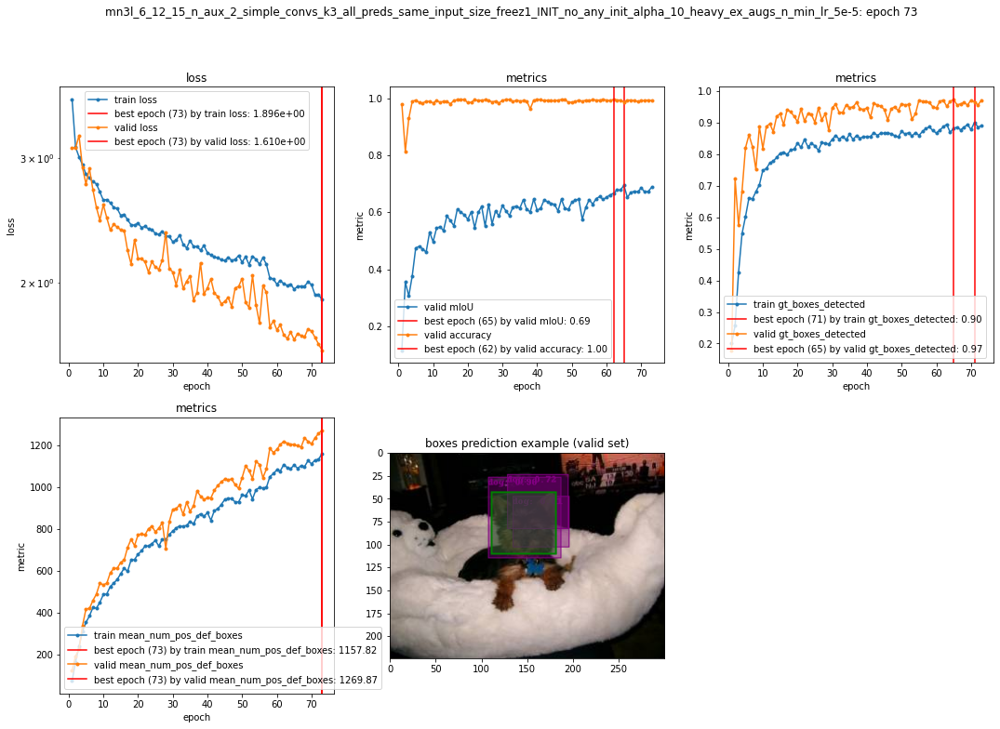

priors scales usage report for train (epoch 73):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.25 |             20
       0.20 |              0.83 |            559
       0.43 |              0.89 |            967
       0.67 |              0.94 |            580
       0.90 |              0.93 |            244
------------------------------------------------

priors scales usage report for valid (epoch 73):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




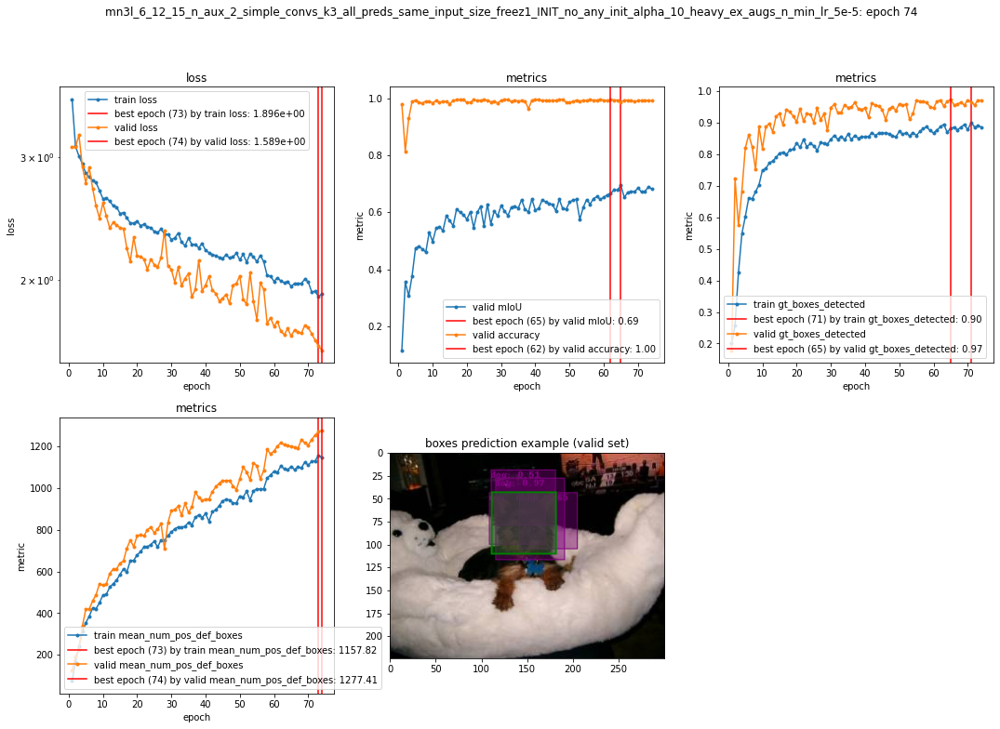

priors scales usage report for train (epoch 74):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.83 |            534
       0.43 |              0.90 |            990
       0.67 |              0.93 |            580
       0.90 |              0.94 |            245
------------------------------------------------

priors scales usage report for valid (epoch 74):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




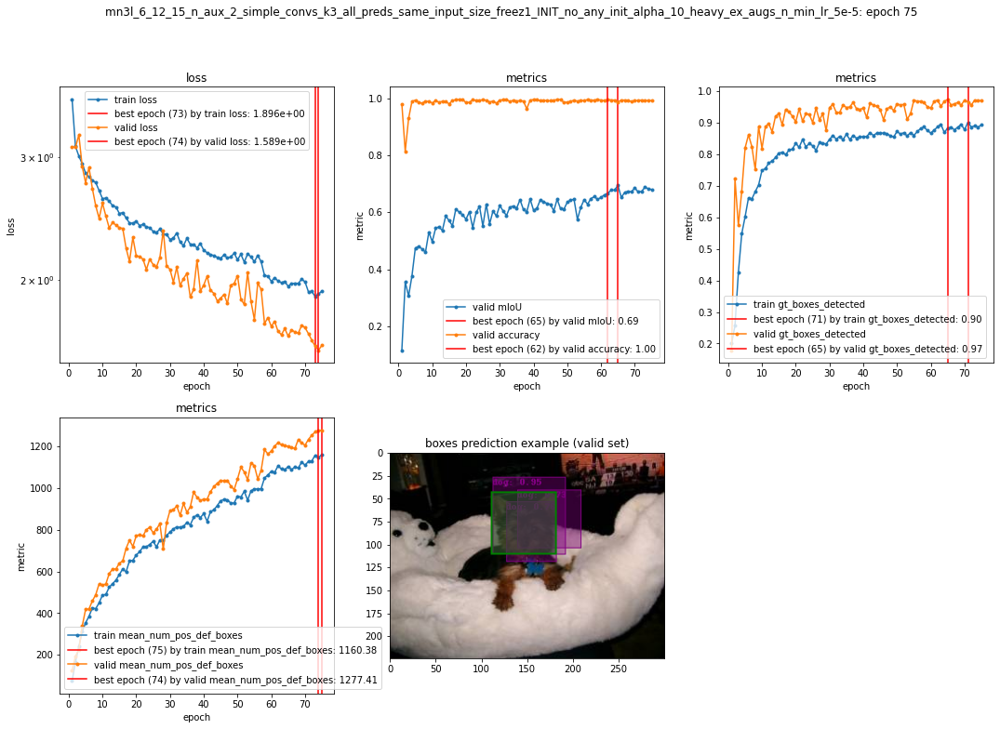

priors scales usage report for train (epoch 75):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.08 |             24
       0.20 |              0.81 |            553
       0.43 |              0.92 |            969
       0.67 |              0.94 |            563
       0.90 |              0.94 |            261
------------------------------------------------

priors scales usage report for valid (epoch 75):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




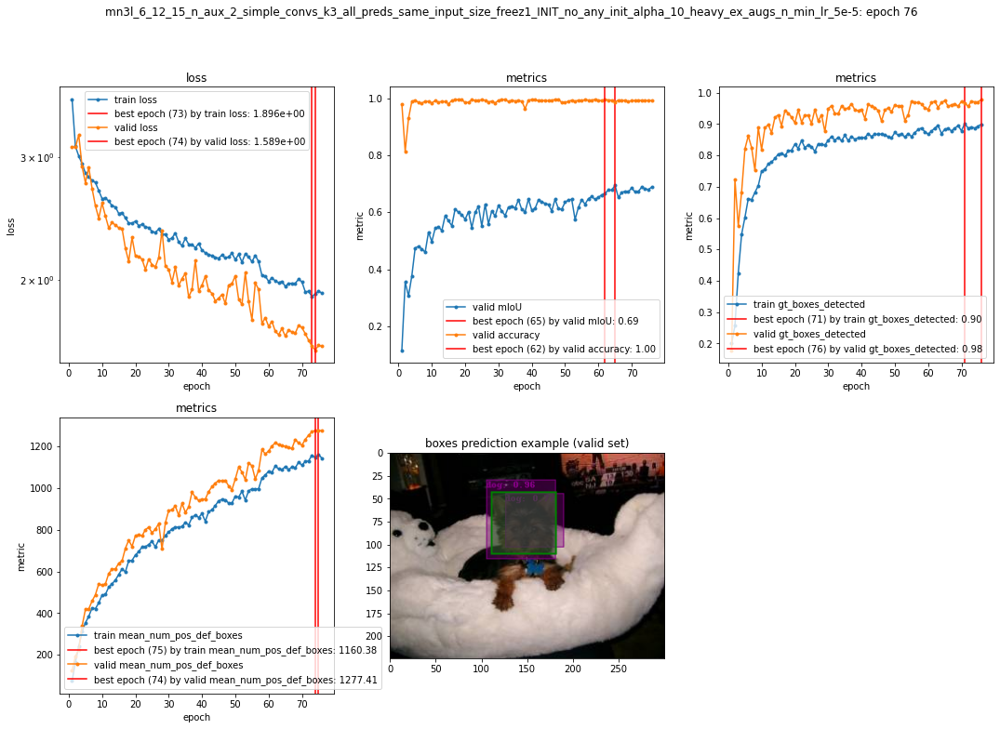

priors scales usage report for train (epoch 76):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             21
       0.20 |              0.84 |            569
       0.43 |              0.92 |            948
       0.67 |              0.95 |            565
       0.90 |              0.93 |            267
------------------------------------------------

priors scales usage report for valid (epoch 76):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




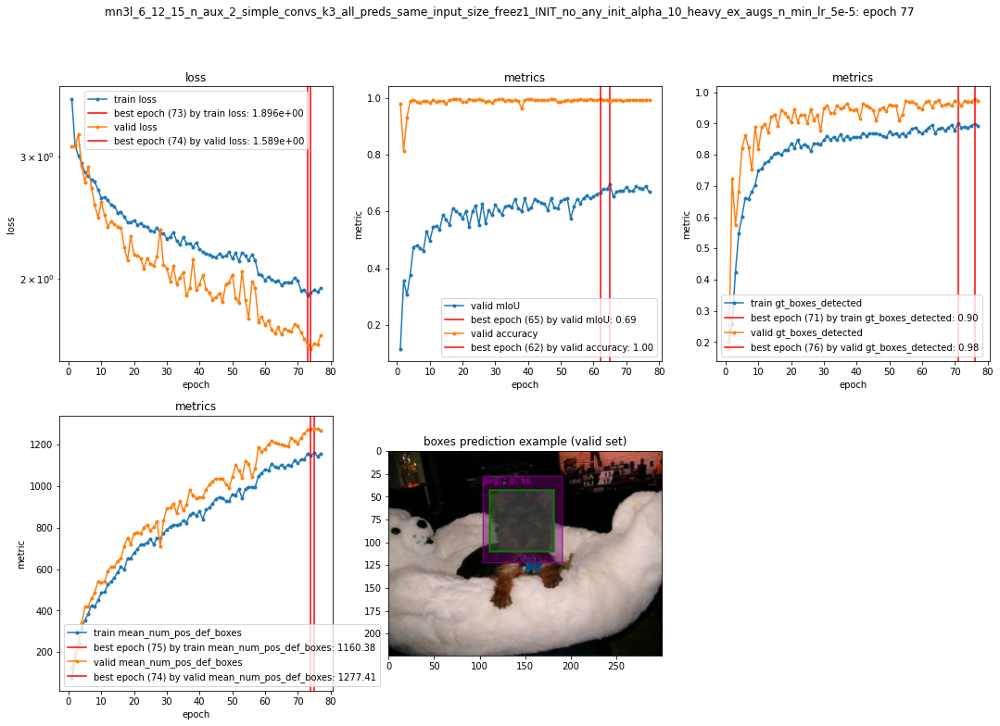

priors scales usage report for train (epoch 77):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             18
       0.20 |              0.83 |            561
       0.43 |              0.91 |            962
       0.67 |              0.93 |            561
       0.90 |              0.93 |            268
------------------------------------------------

priors scales usage report for valid (epoch 77):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




Epoch    76: reducing learning rate of group 0 to 5.0000e-05.


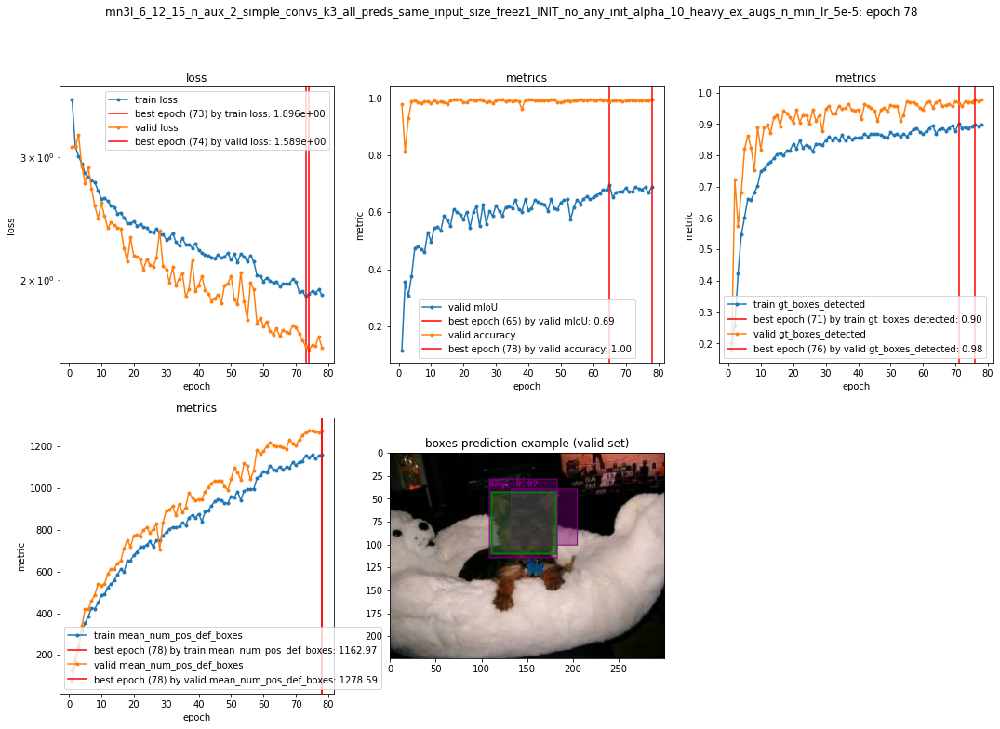

priors scales usage report for train (epoch 78):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             21
       0.20 |              0.81 |            550
       0.43 |              0.93 |            984
       0.67 |              0.95 |            550
       0.90 |              0.92 |            265
------------------------------------------------

priors scales usage report for valid (epoch 78):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




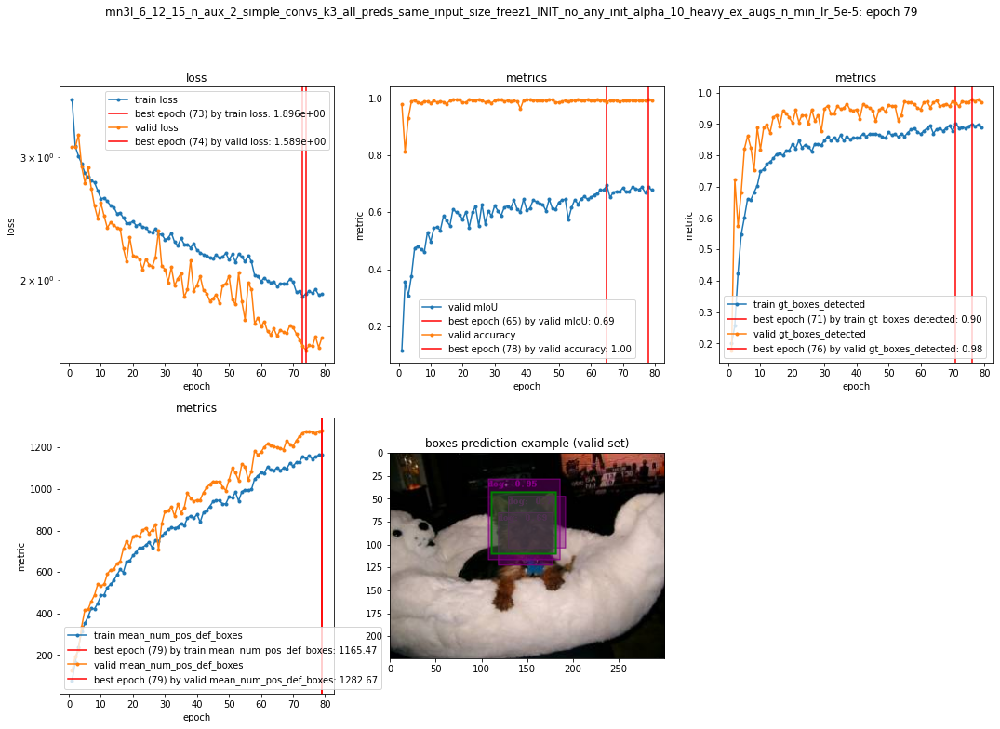

priors scales usage report for train (epoch 79):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.19 |             21
       0.20 |              0.81 |            546
       0.43 |              0.90 |            966
       0.67 |              0.95 |            582
       0.90 |              0.95 |            255
------------------------------------------------

priors scales usage report for valid (epoch 79):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




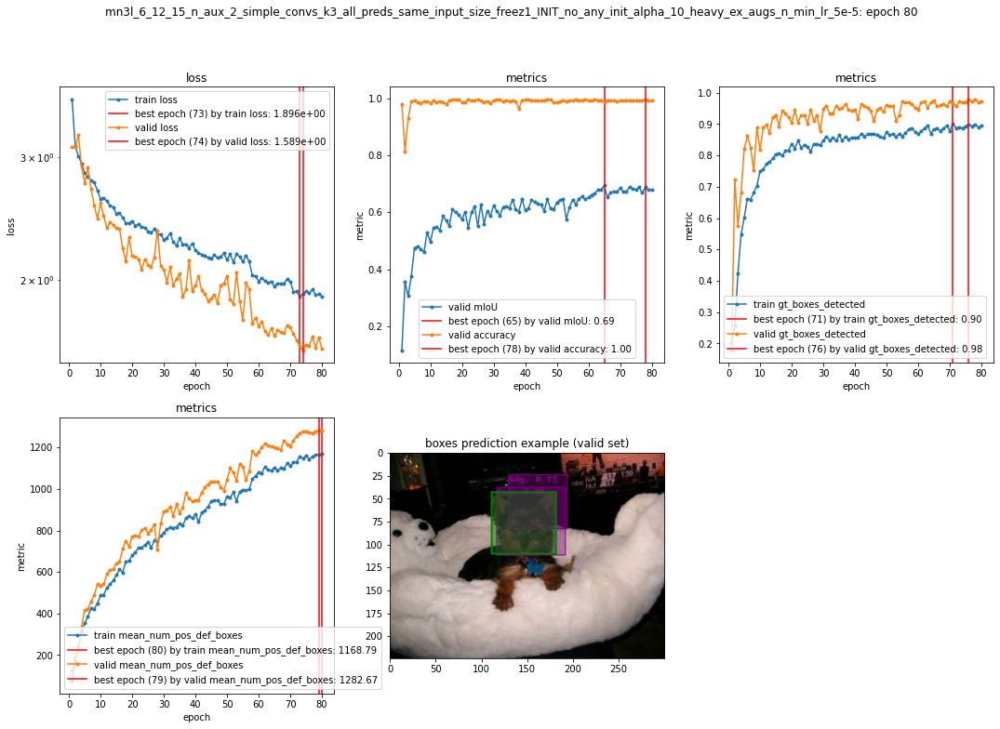

priors scales usage report for train (epoch 80):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.23 |             22
       0.20 |              0.82 |            574
       0.43 |              0.92 |            952
       0.67 |              0.93 |            549
       0.90 |              0.96 |            273
------------------------------------------------

priors scales usage report for valid (epoch 80):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




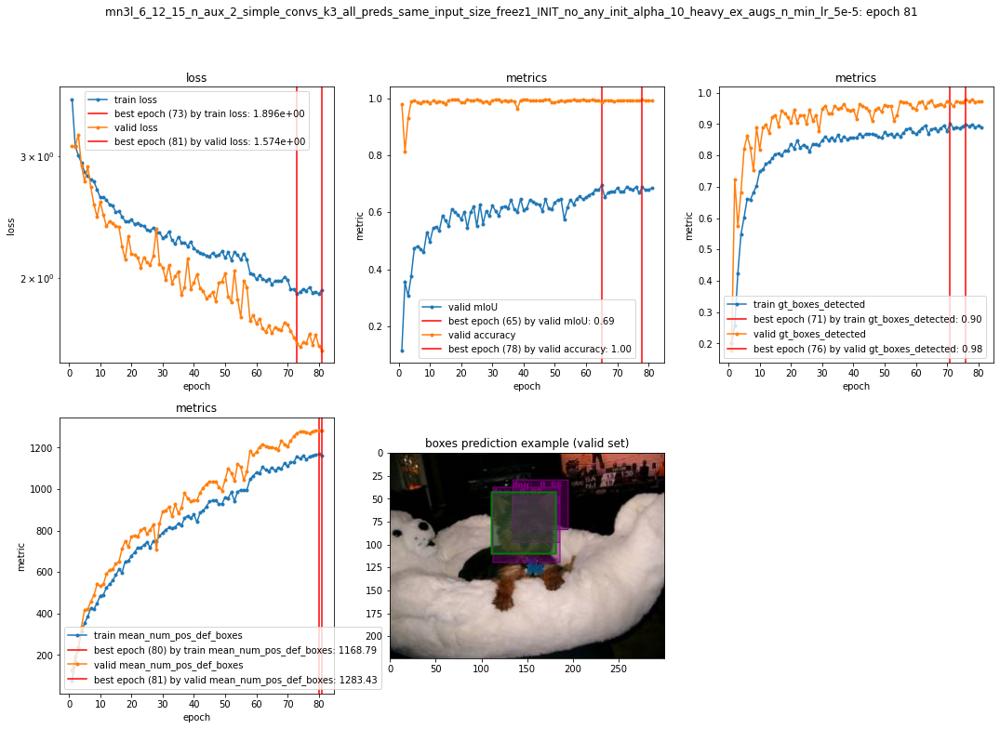

priors scales usage report for train (epoch 81):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             24
       0.20 |              0.82 |            558
       0.43 |              0.90 |            958
       0.67 |              0.93 |            568
       0.90 |              0.94 |            262
------------------------------------------------

priors scales usage report for valid (epoch 81):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




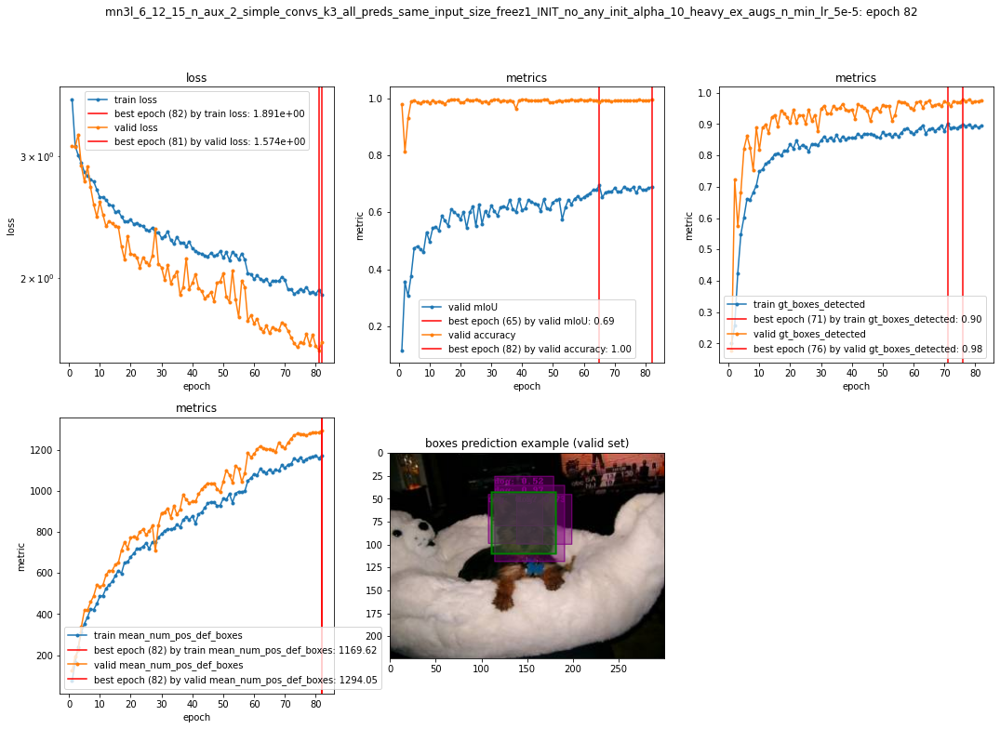

priors scales usage report for train (epoch 82):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.16 |             19
       0.20 |              0.81 |            569
       0.43 |              0.93 |            938
       0.67 |              0.93 |            603
       0.90 |              0.92 |            241
------------------------------------------------

priors scales usage report for valid (epoch 82):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




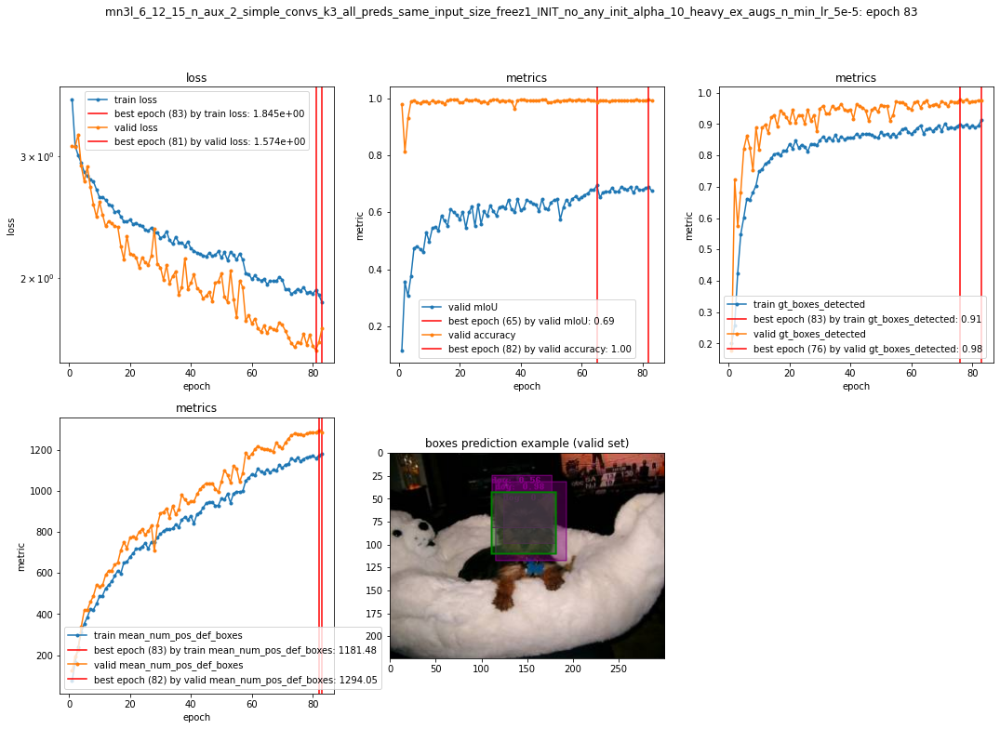

priors scales usage report for train (epoch 83):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.19 |             21
       0.20 |              0.86 |            566
       0.43 |              0.92 |            936
       0.67 |              0.95 |            577
       0.90 |              0.95 |            270
------------------------------------------------

priors scales usage report for valid (epoch 83):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




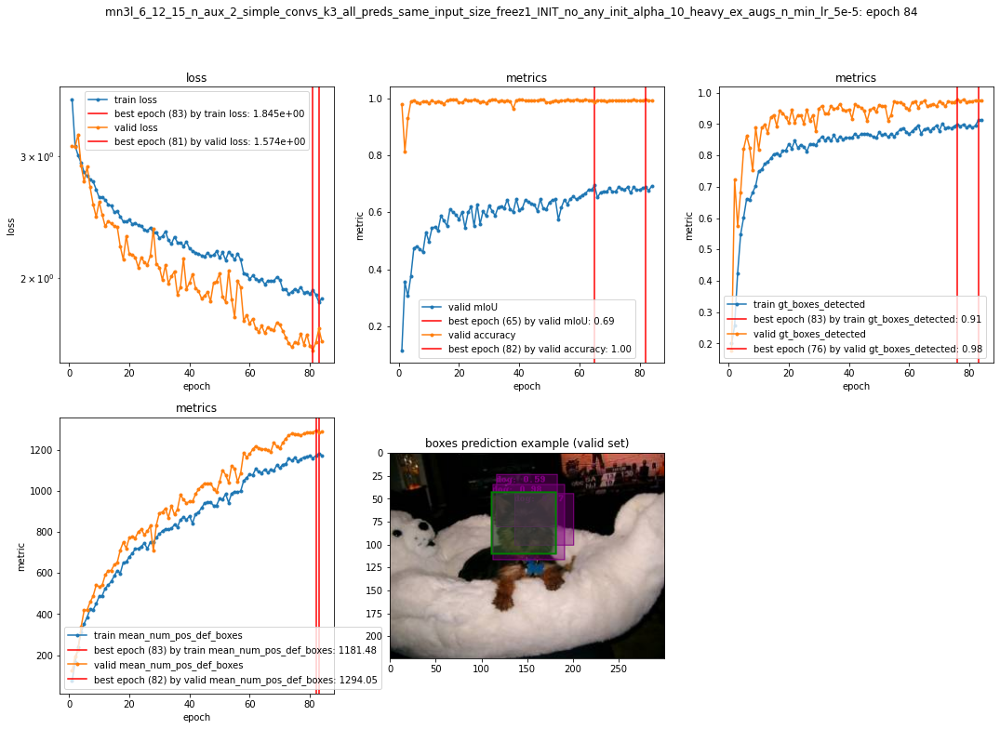

priors scales usage report for train (epoch 84):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.13 |             15
       0.20 |              0.85 |            581
       0.43 |              0.94 |            943
       0.67 |              0.93 |            584
       0.90 |              0.94 |            247
------------------------------------------------

priors scales usage report for valid (epoch 84):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




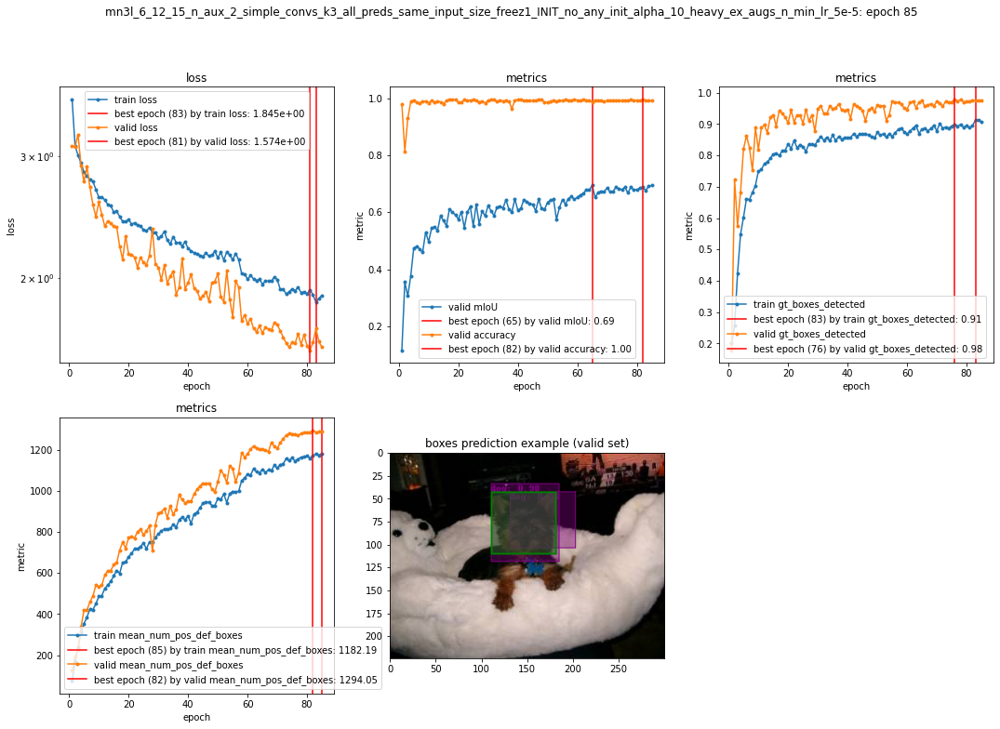

priors scales usage report for train (epoch 85):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             18
       0.20 |              0.85 |            575
       0.43 |              0.92 |            948
       0.67 |              0.95 |            578
       0.90 |              0.94 |            251
------------------------------------------------

priors scales usage report for valid (epoch 85):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




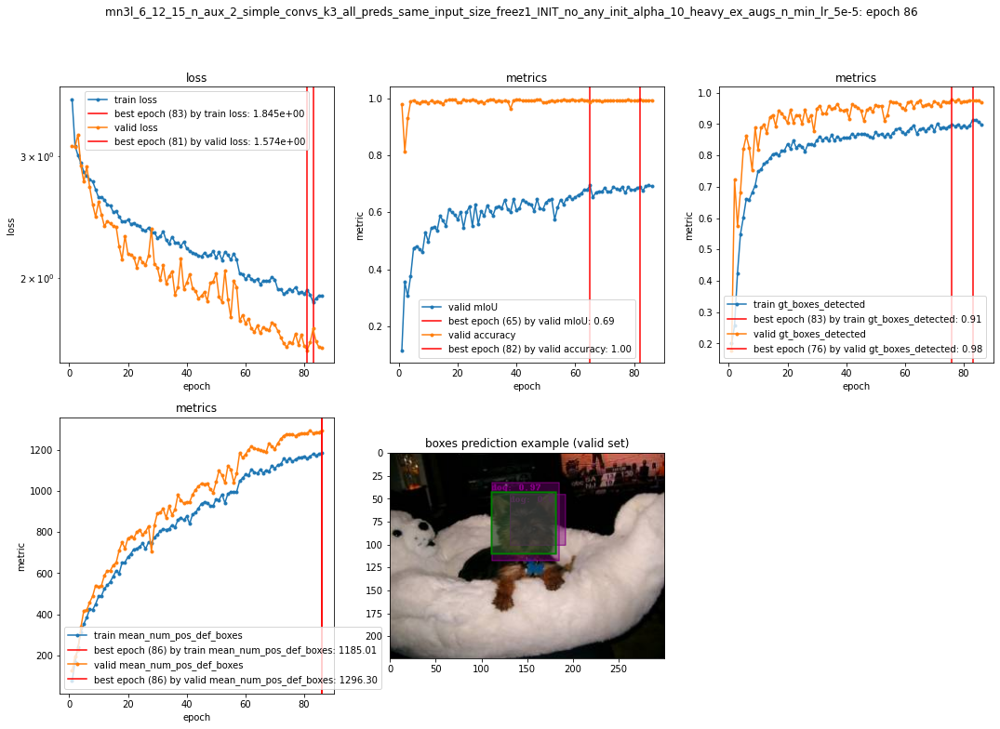

priors scales usage report for train (epoch 86):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.20 |             15
       0.20 |              0.81 |            560
       0.43 |              0.93 |            983
       0.67 |              0.93 |            563
       0.90 |              0.95 |            249
------------------------------------------------

priors scales usage report for valid (epoch 86):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




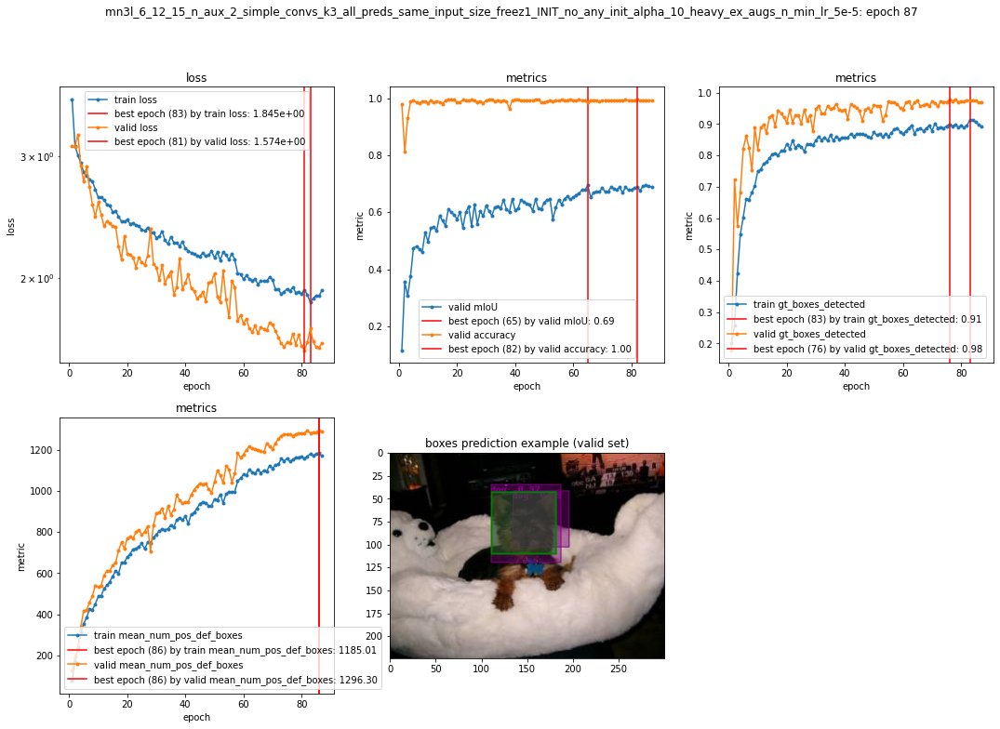

priors scales usage report for train (epoch 87):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.19 |             16
       0.20 |              0.83 |            557
       0.43 |              0.90 |            945
       0.67 |              0.93 |            595
       0.90 |              0.93 |            257
------------------------------------------------

priors scales usage report for valid (epoch 87):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




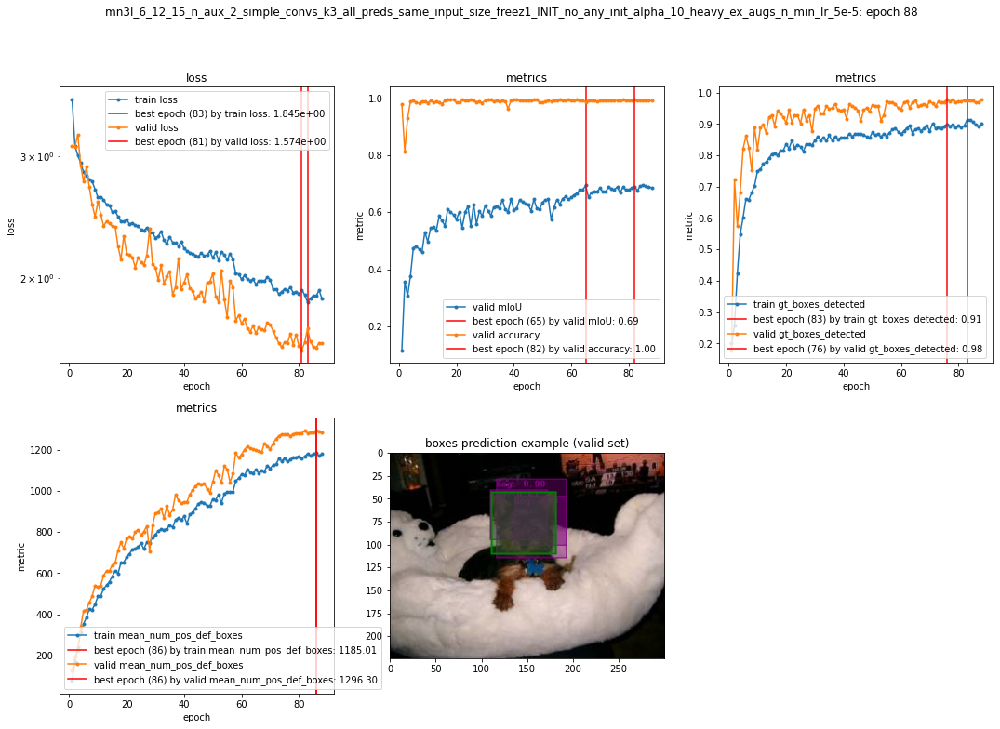

priors scales usage report for train (epoch 88):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             17
       0.20 |              0.86 |            582
       0.43 |              0.92 |            940
       0.67 |              0.94 |            564
       0.90 |              0.93 |            267
------------------------------------------------

priors scales usage report for valid (epoch 88):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




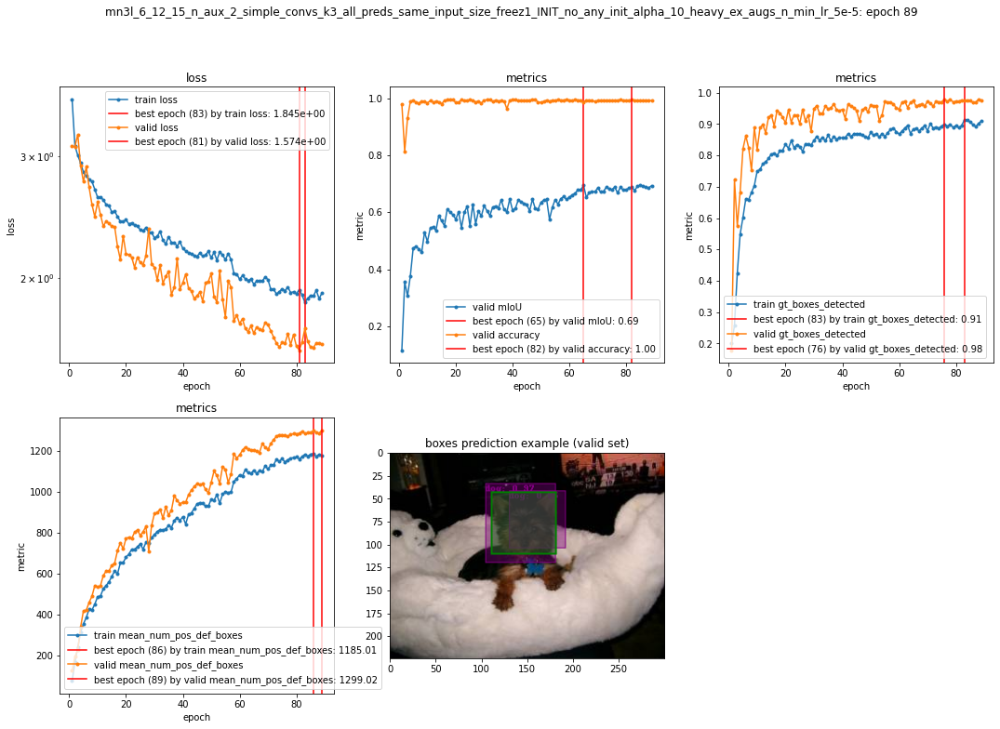

priors scales usage report for train (epoch 89):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             20
       0.20 |              0.86 |            574
       0.43 |              0.93 |            937
       0.67 |              0.93 |            598
       0.90 |              0.94 |            241
------------------------------------------------

priors scales usage report for valid (epoch 89):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




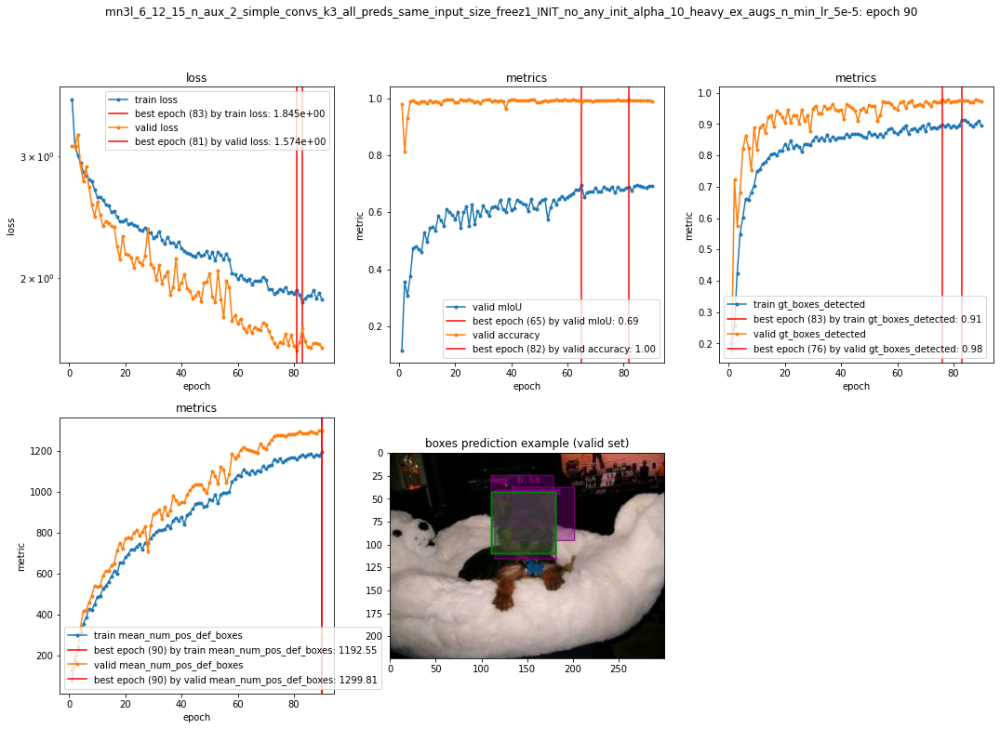

priors scales usage report for train (epoch 90):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             18
       0.20 |              0.83 |            550
       0.43 |              0.91 |            964
       0.67 |              0.94 |            578
       0.90 |              0.94 |            260
------------------------------------------------

priors scales usage report for valid (epoch 90):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




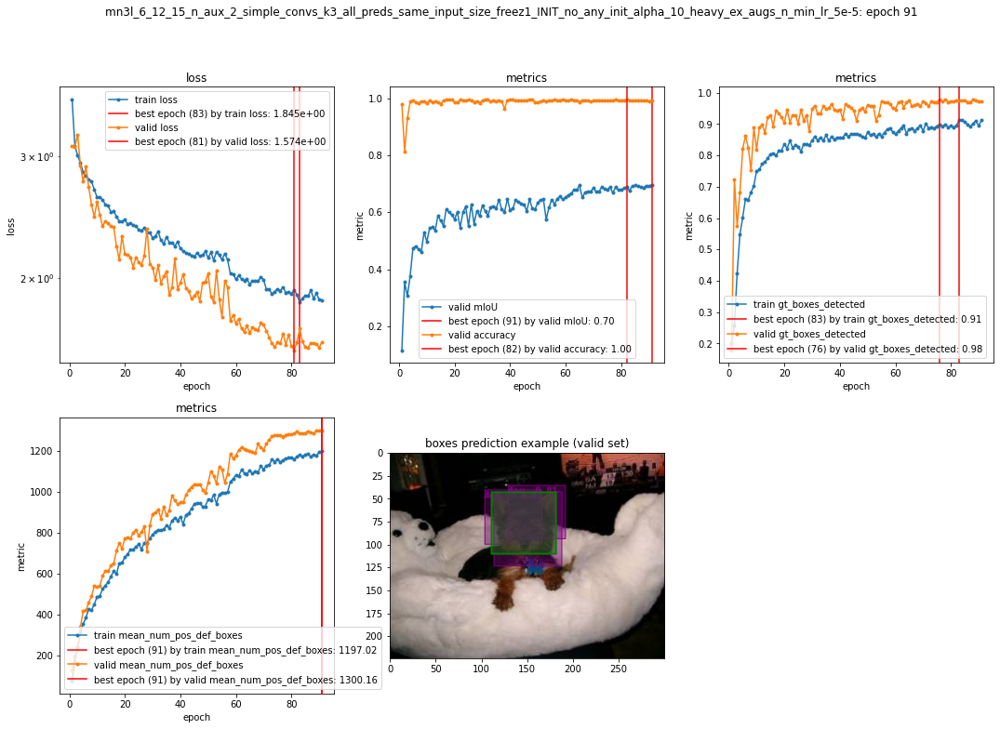

priors scales usage report for train (epoch 91):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.32 |             19
       0.20 |              0.85 |            570
       0.43 |              0.92 |            943
       0.67 |              0.95 |            590
       0.90 |              0.95 |            248
------------------------------------------------

priors scales usage report for valid (epoch 91):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




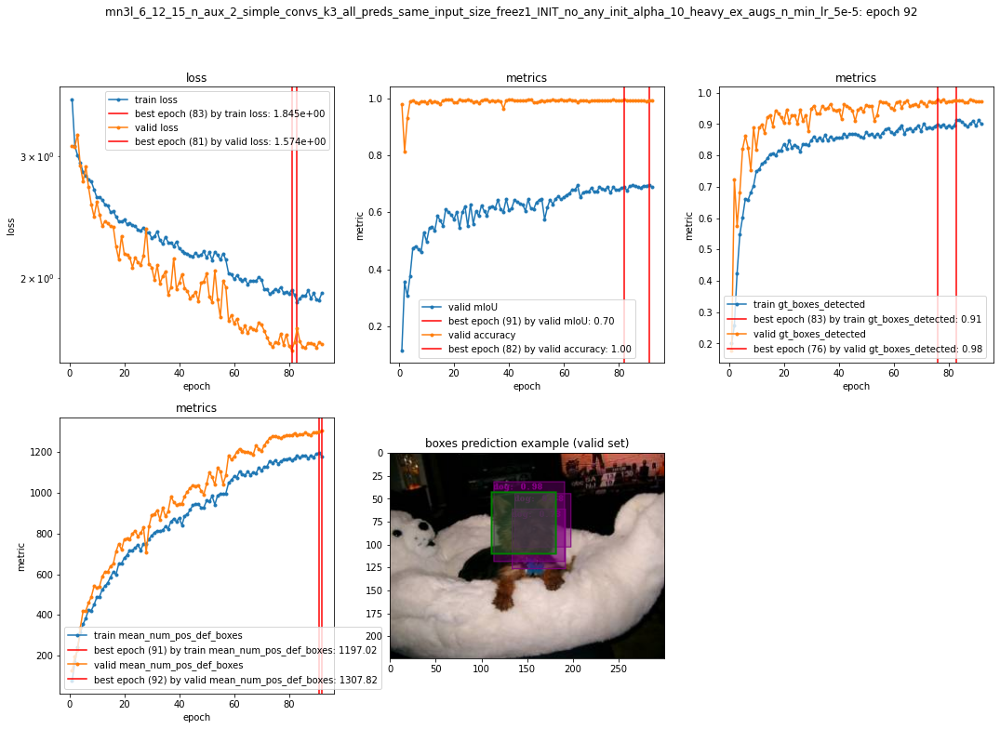

priors scales usage report for train (epoch 92):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.11 |             18
       0.20 |              0.85 |            560
       0.43 |              0.91 |            973
       0.67 |              0.94 |            568
       0.90 |              0.95 |            251
------------------------------------------------

priors scales usage report for valid (epoch 92):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




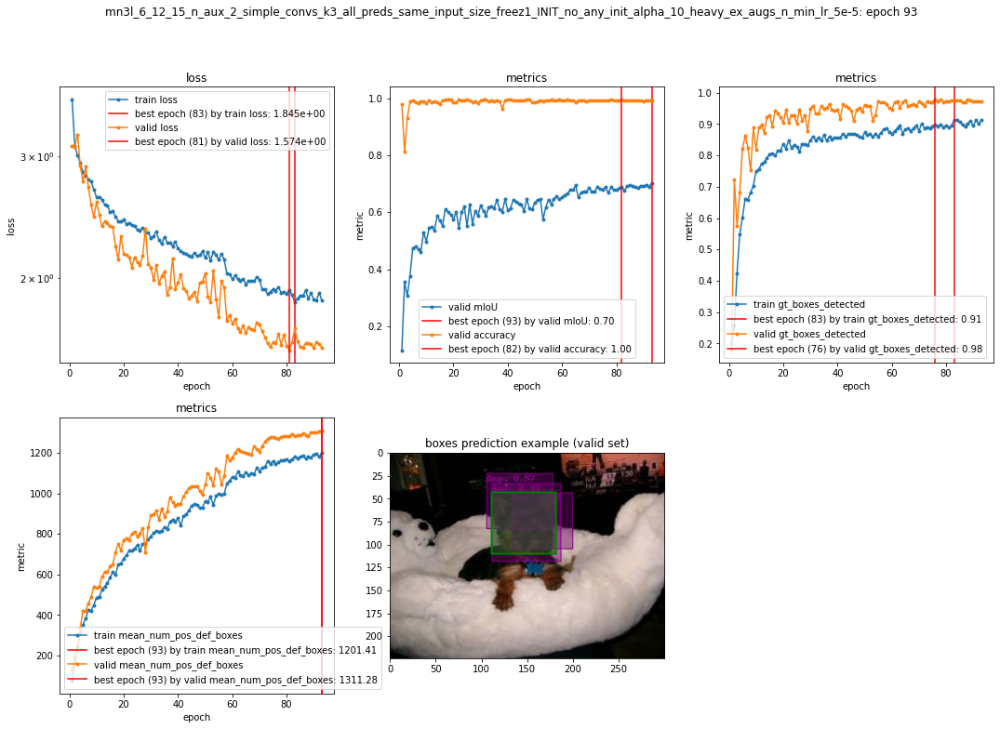

priors scales usage report for train (epoch 93):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.25 |             24
       0.20 |              0.85 |            543
       0.43 |              0.93 |            955
       0.67 |              0.95 |            593
       0.90 |              0.95 |            255
------------------------------------------------

priors scales usage report for valid (epoch 93):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




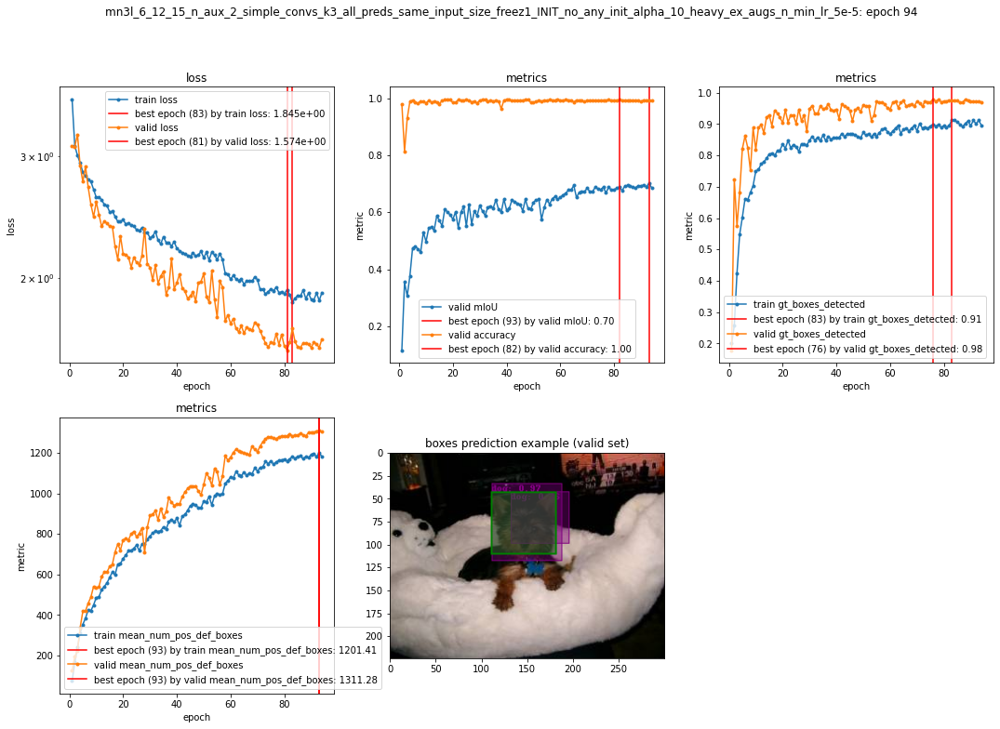

priors scales usage report for train (epoch 94):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.13 |             23
       0.20 |              0.84 |            558
       0.43 |              0.91 |            966
       0.67 |              0.93 |            544
       0.90 |              0.94 |            279
------------------------------------------------

priors scales usage report for valid (epoch 94):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




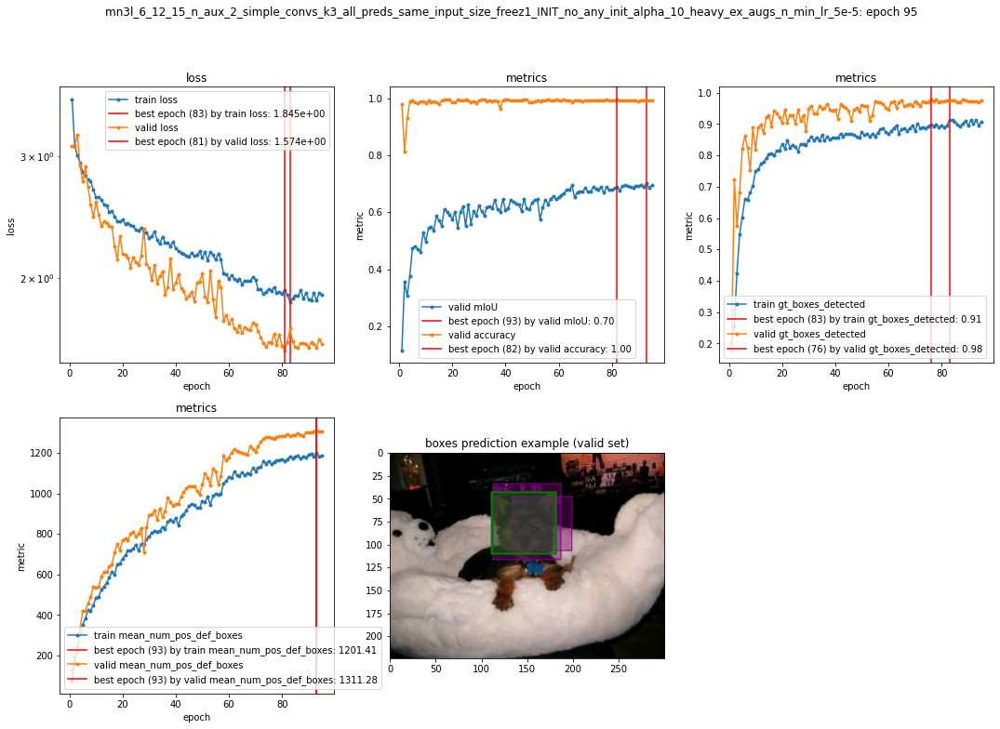

priors scales usage report for train (epoch 95):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             22
       0.20 |              0.86 |            564
       0.43 |              0.93 |            961
       0.67 |              0.94 |            560
       0.90 |              0.93 |            263
------------------------------------------------

priors scales usage report for valid (epoch 95):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




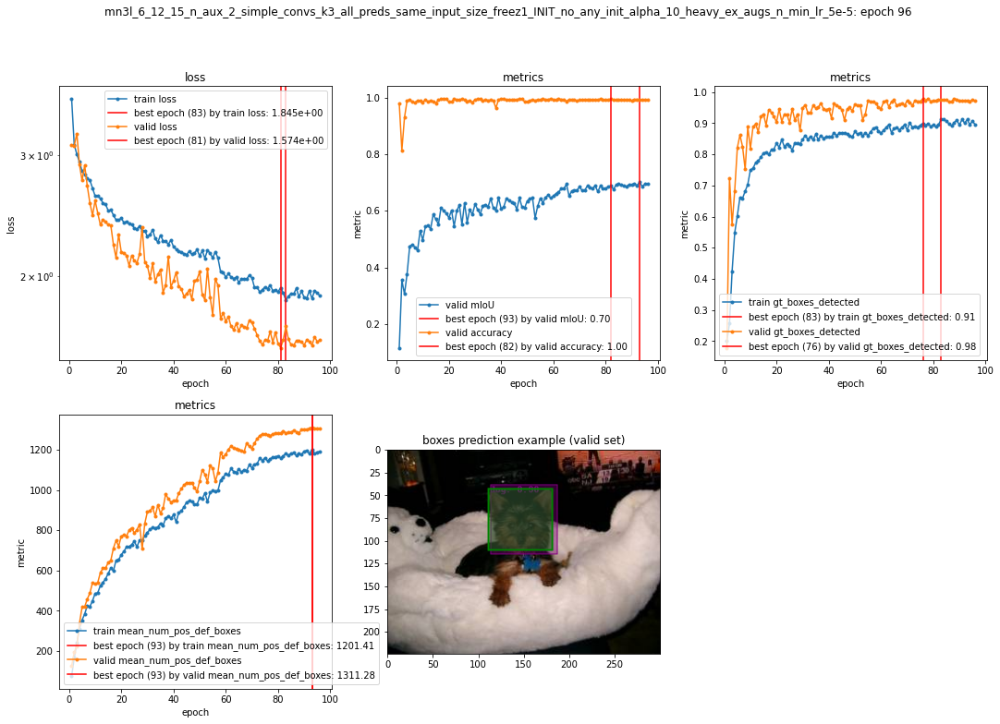

priors scales usage report for train (epoch 96):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.26 |             23
       0.20 |              0.84 |            531
       0.43 |              0.90 |            990
       0.67 |              0.94 |            547
       0.90 |              0.95 |            279
------------------------------------------------

priors scales usage report for valid (epoch 96):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




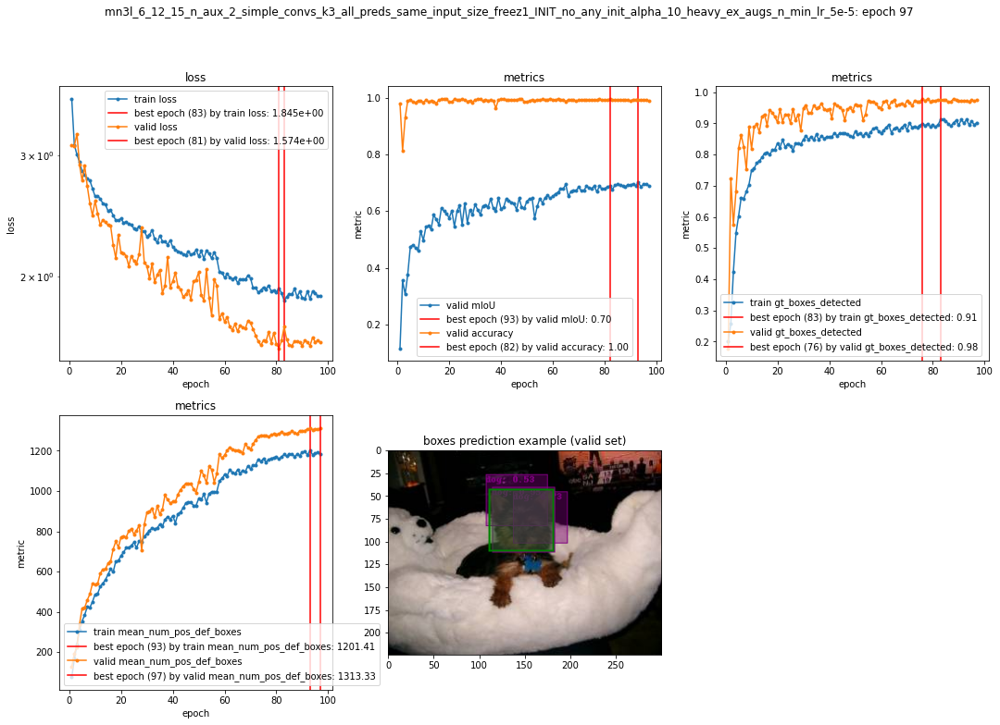

priors scales usage report for train (epoch 97):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.05 |             22
       0.20 |              0.86 |            558
       0.43 |              0.93 |            963
       0.67 |              0.92 |            566
       0.90 |              0.95 |            261
------------------------------------------------

priors scales usage report for valid (epoch 97):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




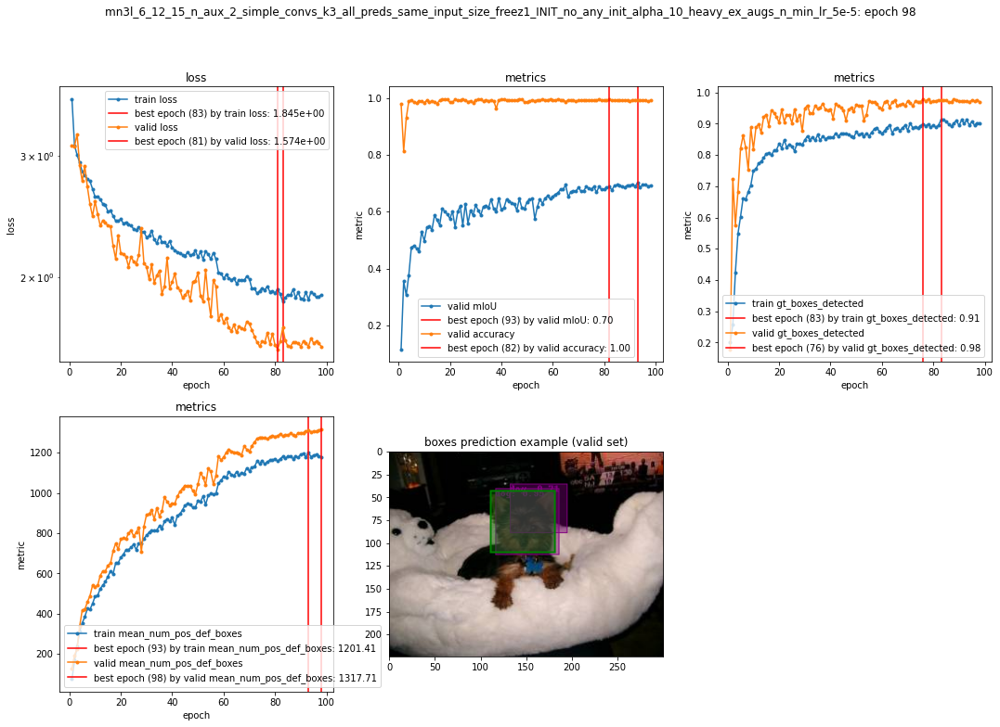

priors scales usage report for train (epoch 98):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             20
       0.20 |              0.86 |            570
       0.43 |              0.91 |            942
       0.67 |              0.95 |            576
       0.90 |              0.90 |            262
------------------------------------------------

priors scales usage report for valid (epoch 98):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




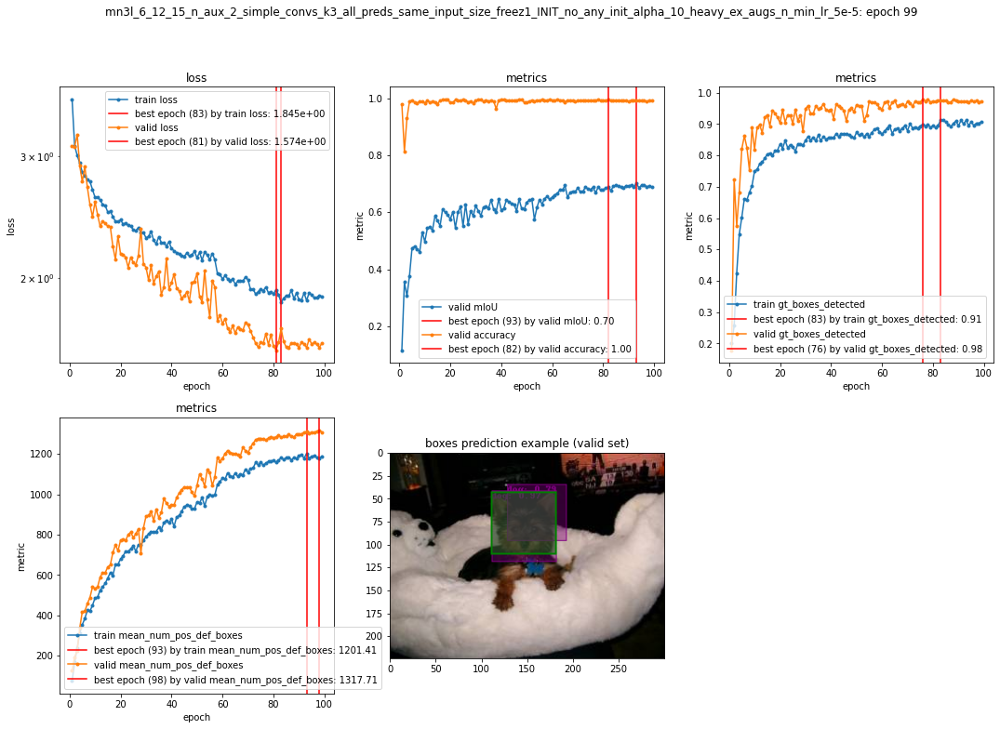

priors scales usage report for train (epoch 99):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.23 |             26
       0.20 |              0.87 |            553
       0.43 |              0.92 |            946
       0.67 |              0.93 |            598
       0.90 |              0.95 |            247
------------------------------------------------

priors scales usage report for valid (epoch 99):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




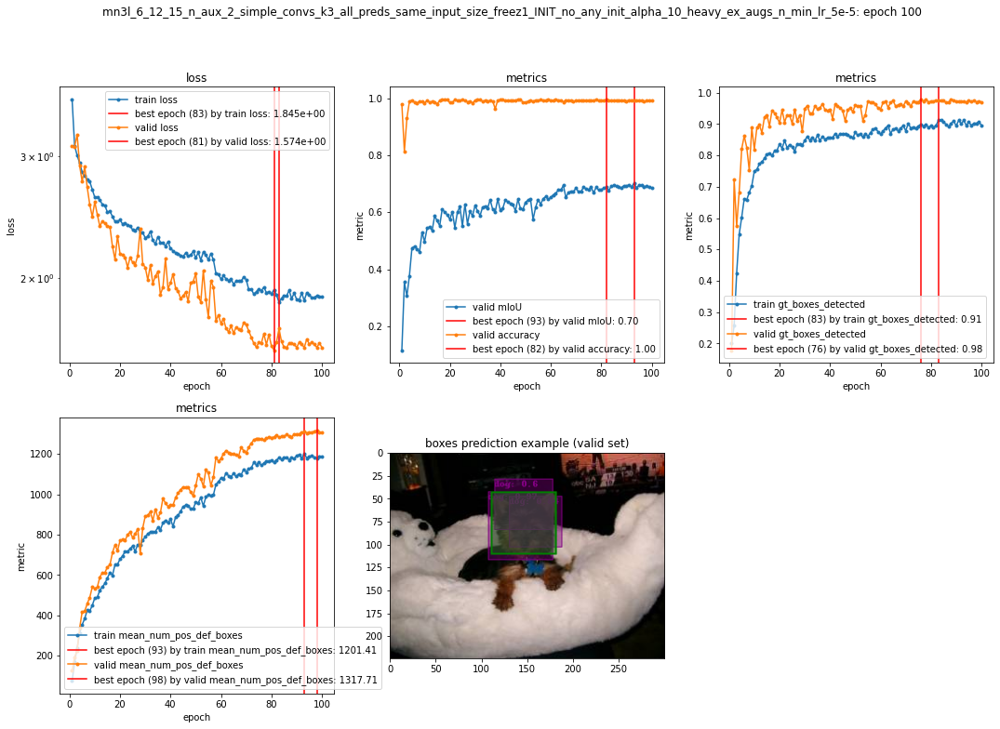

priors scales usage report for train (epoch 100):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.84 |            558
       0.43 |              0.91 |            957
       0.67 |              0.93 |            586
       0.90 |              0.96 |            248
------------------------------------------------

priors scales usage report for valid (epoch 100):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              0.99 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------





In [52]:
NUM_EPOCHS = 50
train(
    TRAIN_HISTORY_STORAGE,
    MODEL_NAME, model, NUM_EPOCHS,
    train_loader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls, optimizer, valid_loader,
    alpha=10,
    lr_scheduler=lr_scheduler, lr_scheduler_1st_epoch=3, use_valid_loss_for_scheduler=False, init_epoch_callback=init_epoch_callback, max_grad_norm=MAX_GRAD_NORM,
    calc_mIoU=MetricsCalculation.valid, calc_accuracy=MetricsCalculation.valid,
    calc_gt_boxes_detected=MetricsCalculation.both, calc_mean_num_pos_def_boxes=MetricsCalculation.both,
    report_priors_scales_usage=MetricsCalculation.both,
    prediction_example_choosing='first', show_only_last_plot=False,
    # early_stopping=True, es_patience=2, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=3, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=5, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=7, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=9, es_rel_threshold=1e-2,
    # early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=True,
    early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=False,
    device=DEVICE,
    resume=True)

In [53]:
len(optimizer.param_groups), optimizer.param_groups[0]['lr']



(1, 5e-05)

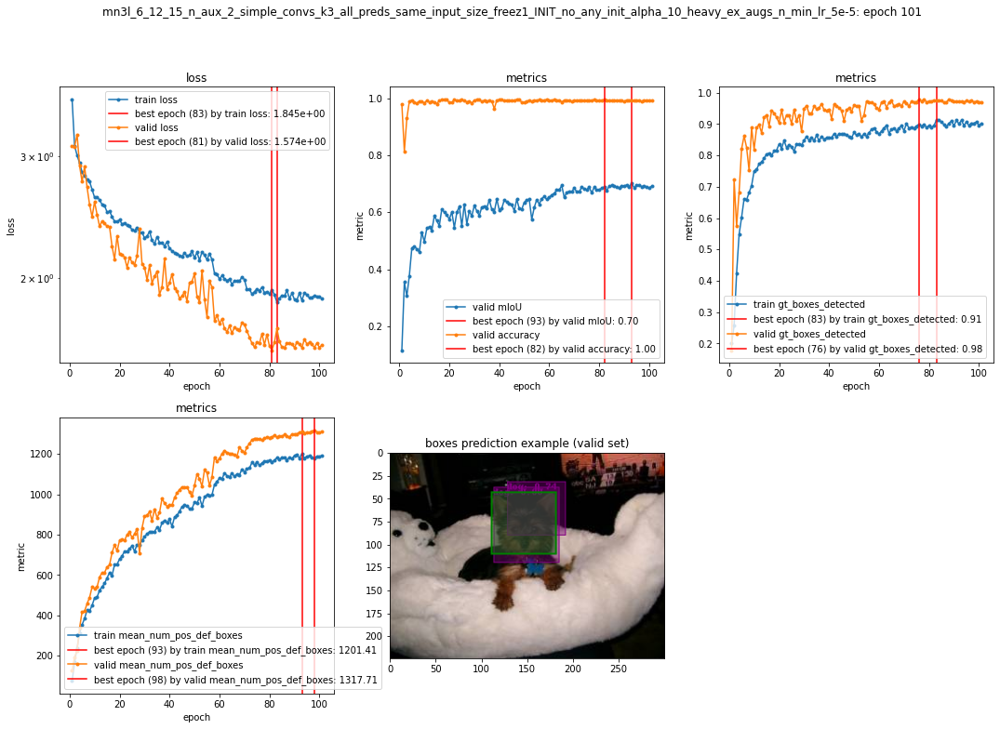

priors scales usage report for train (epoch 101):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.18 |             17
       0.20 |              0.85 |            564
       0.43 |              0.93 |            956
       0.67 |              0.93 |            574
       0.90 |              0.93 |            259
------------------------------------------------

priors scales usage report for valid (epoch 101):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.98 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




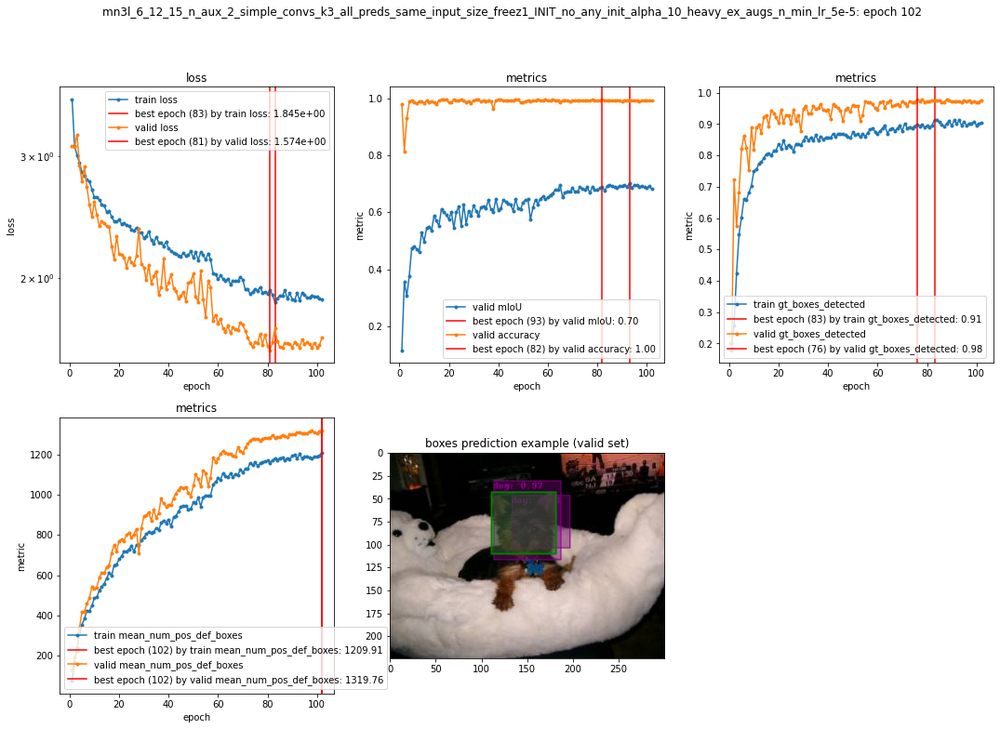

priors scales usage report for train (epoch 102):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.09 |             22
       0.20 |              0.85 |            552
       0.43 |              0.92 |            959
       0.67 |              0.94 |            585
       0.90 |              0.94 |            252
------------------------------------------------

priors scales usage report for valid (epoch 102):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




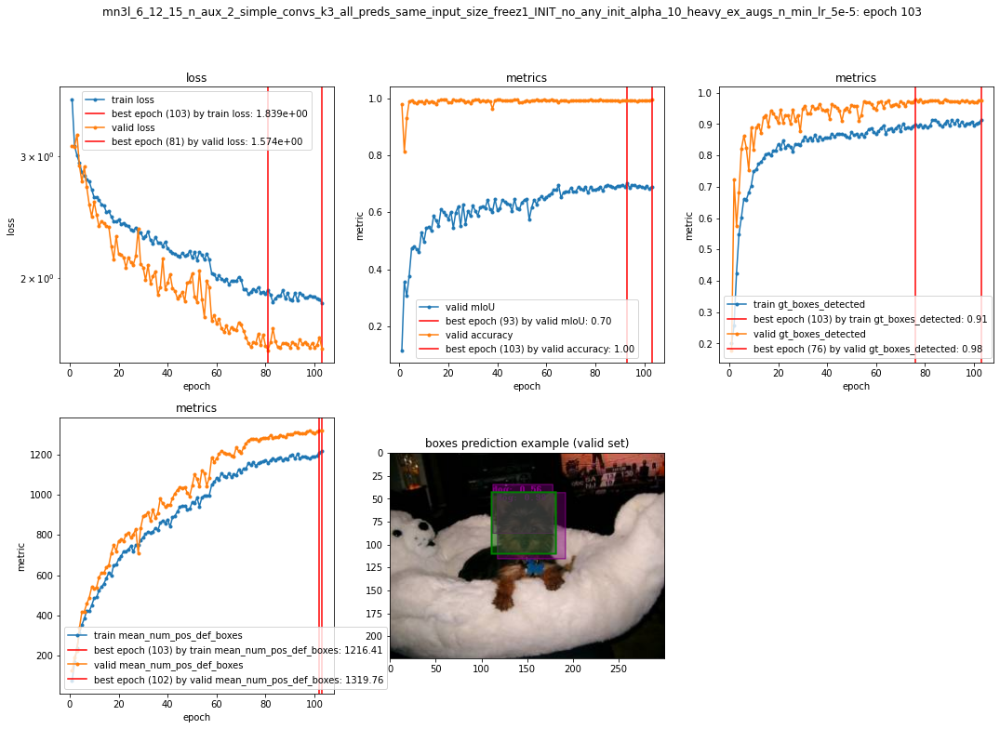

priors scales usage report for train (epoch 103):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.06 |             18
       0.20 |              0.87 |            568
       0.43 |              0.93 |            965
       0.67 |              0.95 |            560
       0.90 |              0.95 |            259
------------------------------------------------

priors scales usage report for valid (epoch 103):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




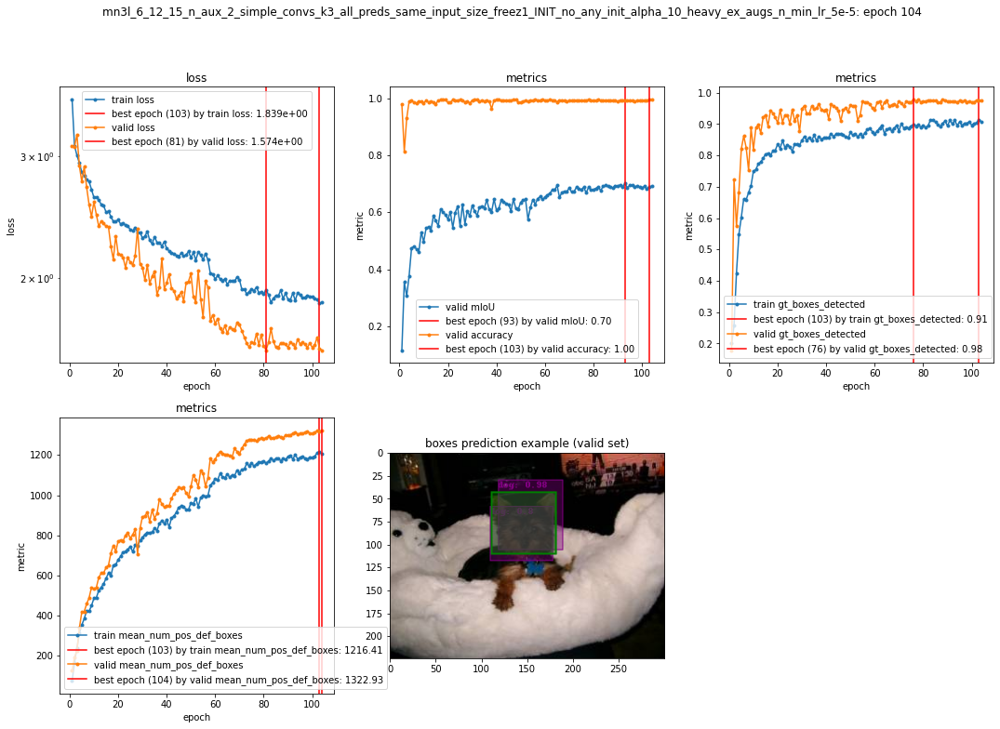

priors scales usage report for train (epoch 104):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.23 |             22
       0.20 |              0.84 |            551
       0.43 |              0.93 |            987
       0.67 |              0.94 |            565
       0.90 |              0.96 |            245
------------------------------------------------

priors scales usage report for valid (epoch 104):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




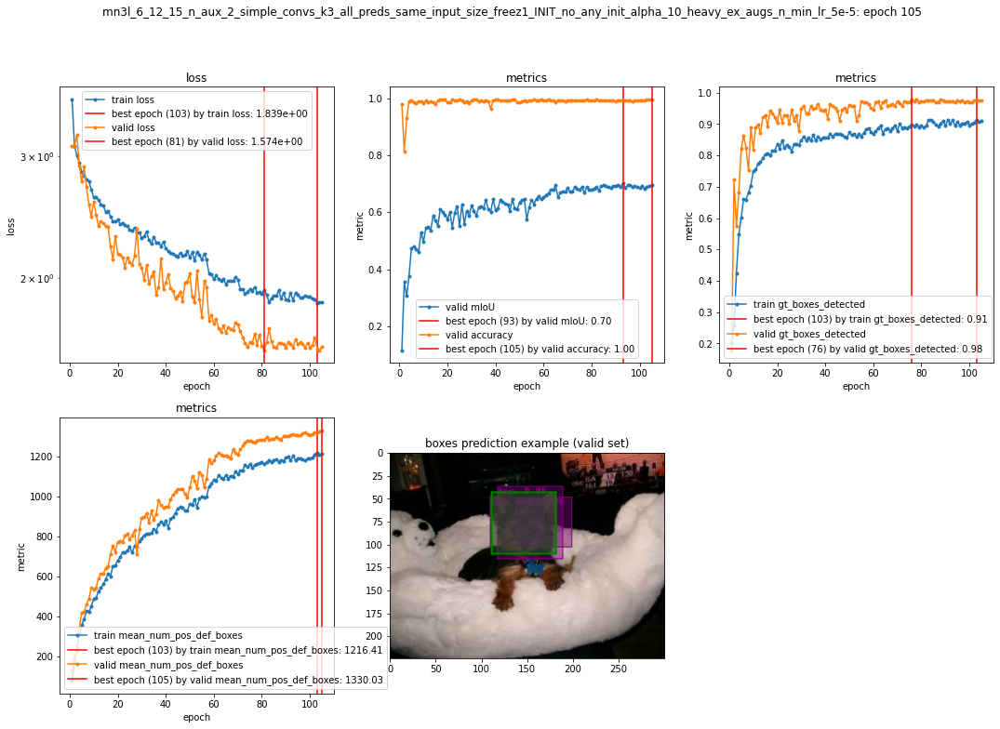

priors scales usage report for train (epoch 105):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.33 |             21
       0.20 |              0.86 |            554
       0.43 |              0.91 |            959
       0.67 |              0.96 |            574
       0.90 |              0.95 |            262
------------------------------------------------

priors scales usage report for valid (epoch 105):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




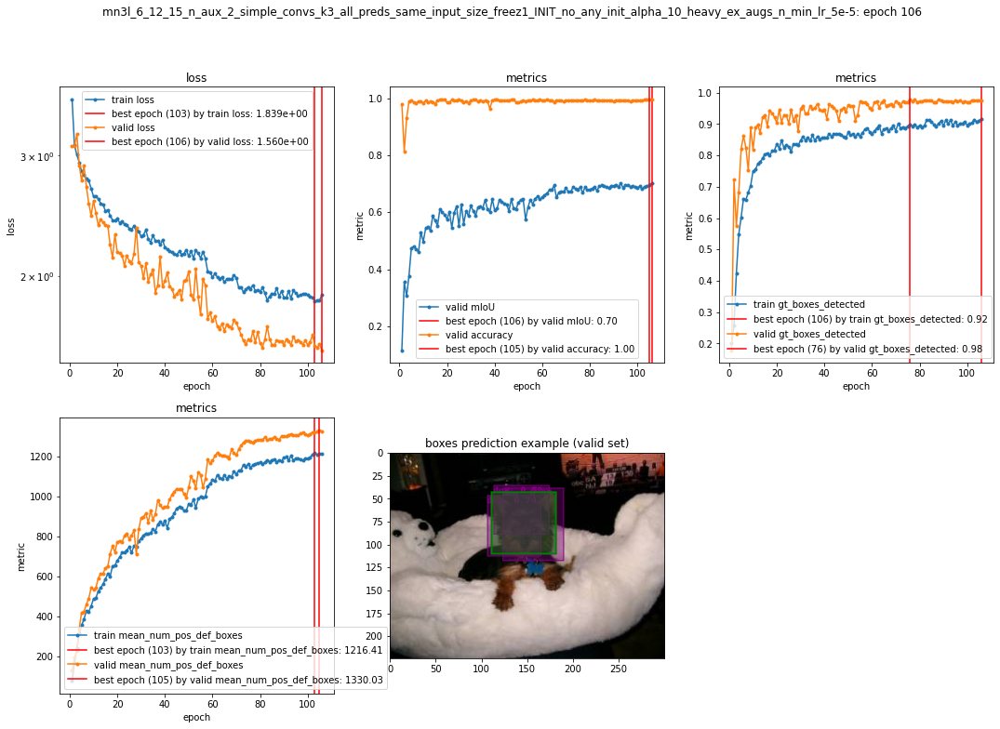

priors scales usage report for train (epoch 106):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             17
       0.20 |              0.87 |            564
       0.43 |              0.93 |            963
       0.67 |              0.93 |            567
       0.90 |              0.96 |            259
------------------------------------------------

priors scales usage report for valid (epoch 106):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




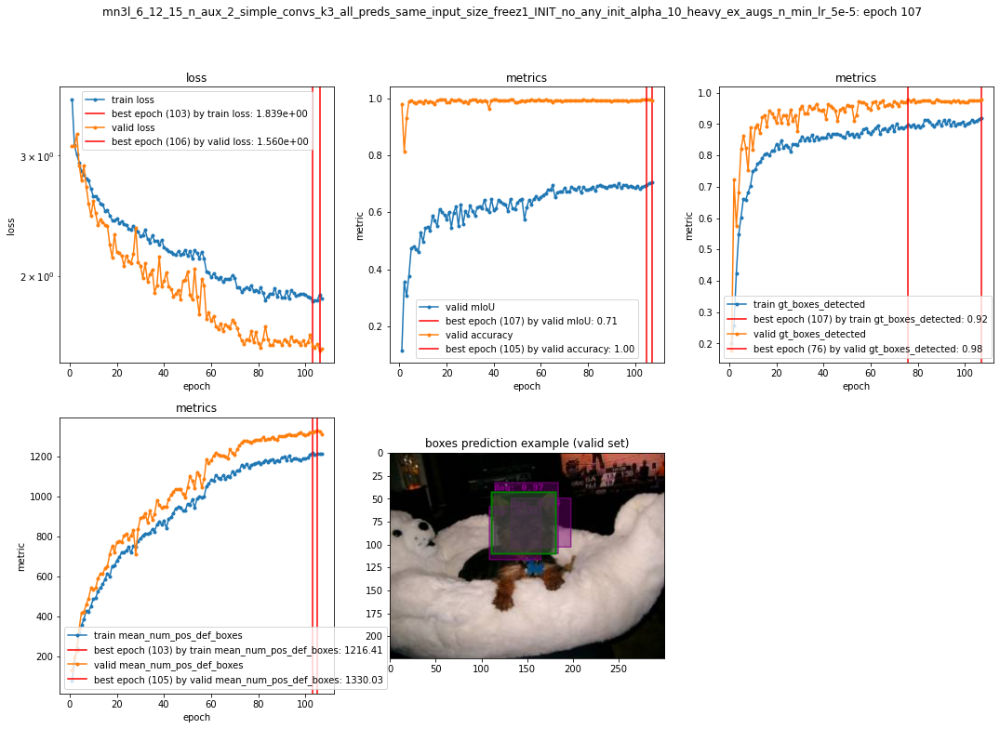

priors scales usage report for train (epoch 107):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.28 |             18
       0.20 |              0.86 |            561
       0.43 |              0.93 |            952
       0.67 |              0.97 |            577
       0.90 |              0.96 |            262
------------------------------------------------

priors scales usage report for valid (epoch 107):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




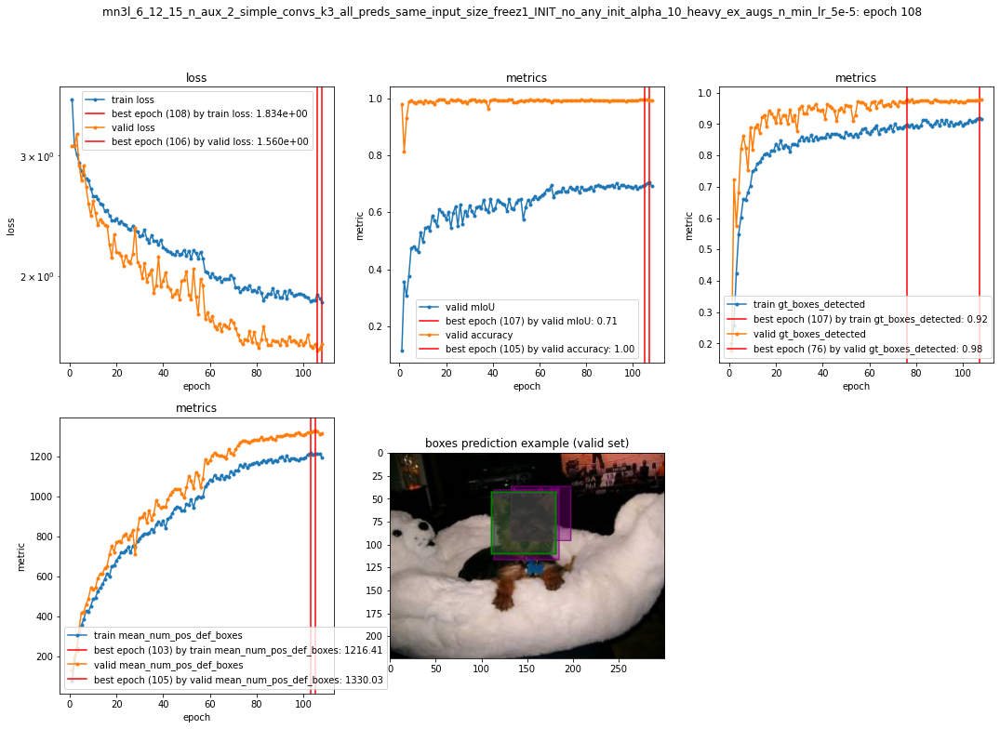

priors scales usage report for train (epoch 108):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             23
       0.20 |              0.87 |            551
       0.43 |              0.93 |            965
       0.67 |              0.93 |            577
       0.90 |              0.96 |            254
------------------------------------------------

priors scales usage report for valid (epoch 108):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




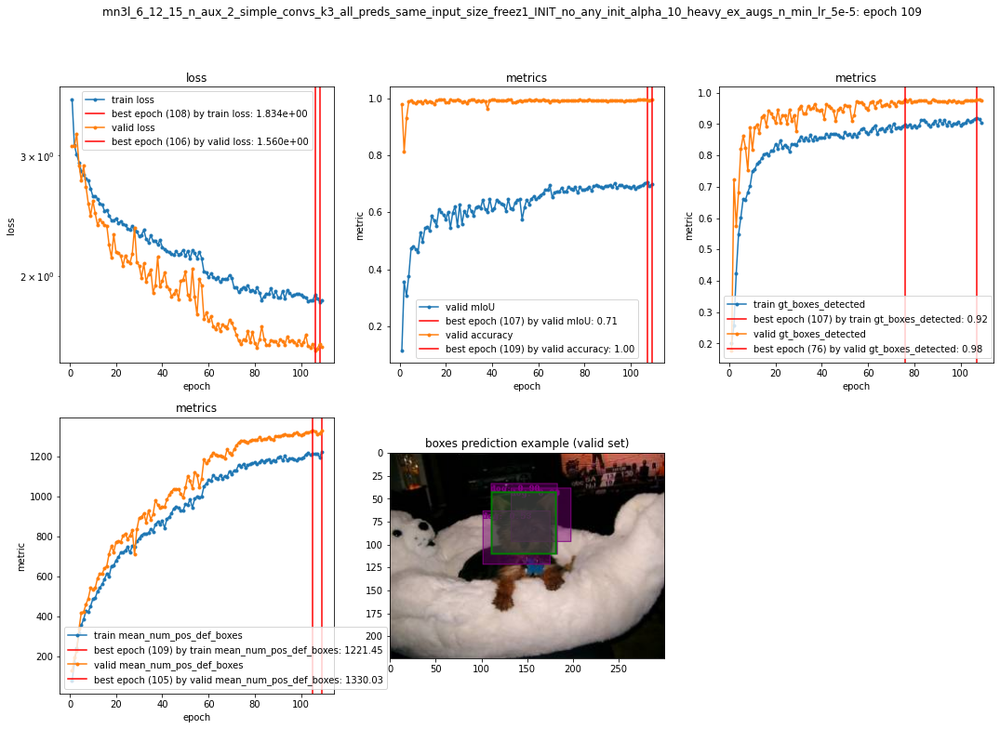

priors scales usage report for train (epoch 109):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.84 |            532
       0.43 |              0.92 |            971
       0.67 |              0.94 |            591
       0.90 |              0.96 |            255
------------------------------------------------

priors scales usage report for valid (epoch 109):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




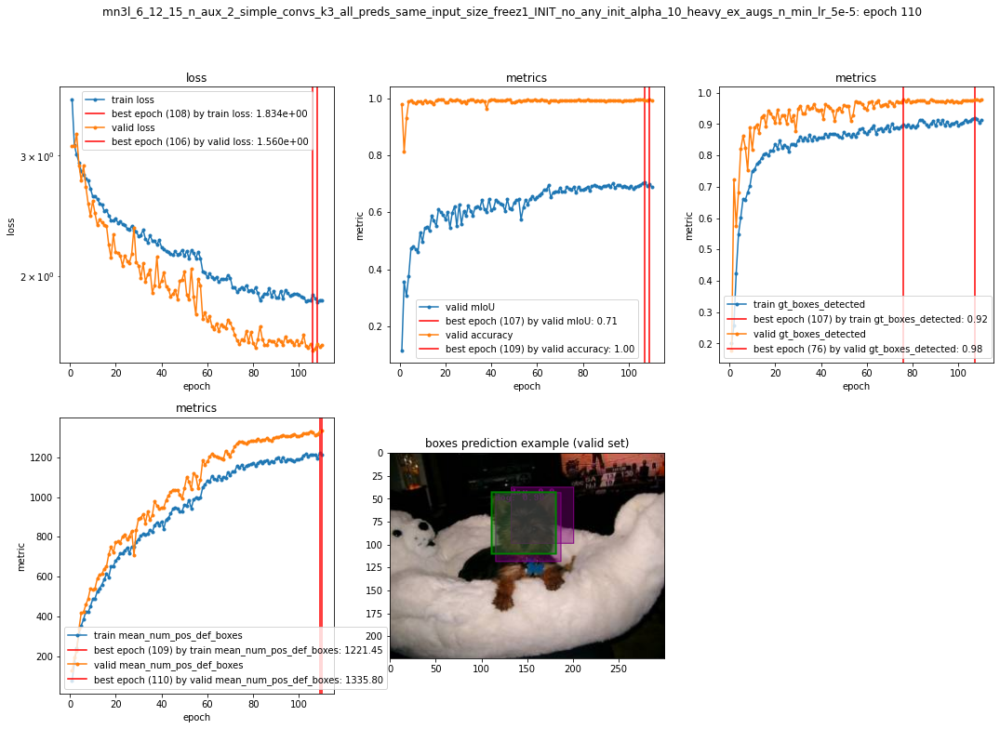

priors scales usage report for train (epoch 110):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.25 |             16
       0.20 |              0.85 |            557
       0.43 |              0.93 |            964
       0.67 |              0.95 |            573
       0.90 |              0.94 |            260
------------------------------------------------

priors scales usage report for valid (epoch 110):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




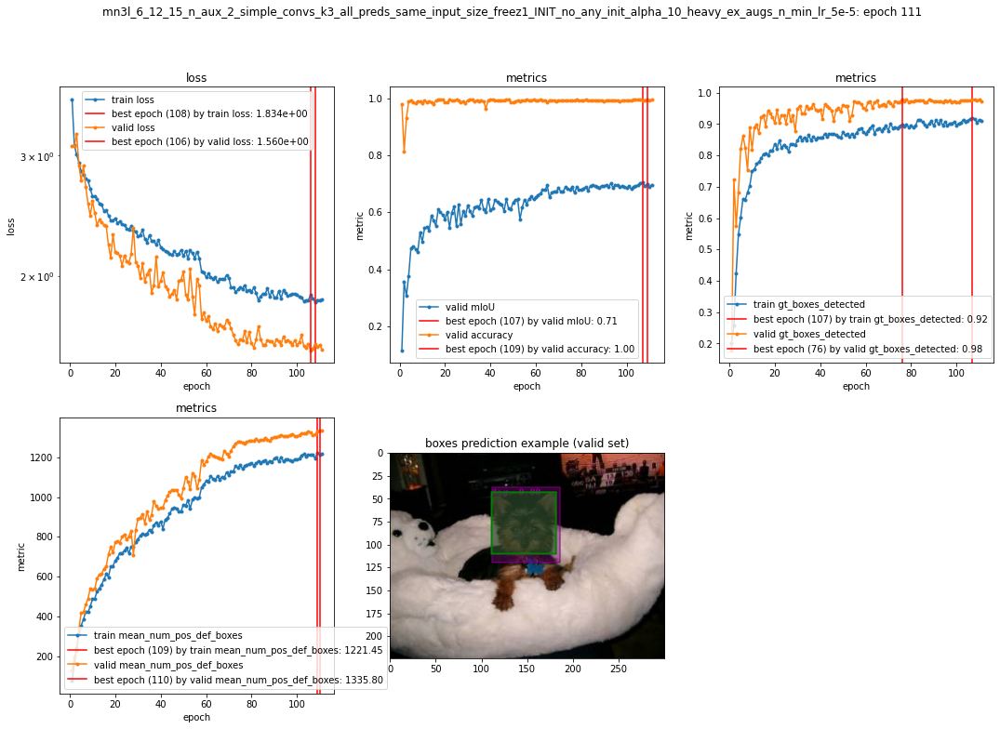

priors scales usage report for train (epoch 111):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             16
       0.20 |              0.87 |            553
       0.43 |              0.92 |            958
       0.67 |              0.93 |            573
       0.90 |              0.95 |            270
------------------------------------------------

priors scales usage report for valid (epoch 111):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




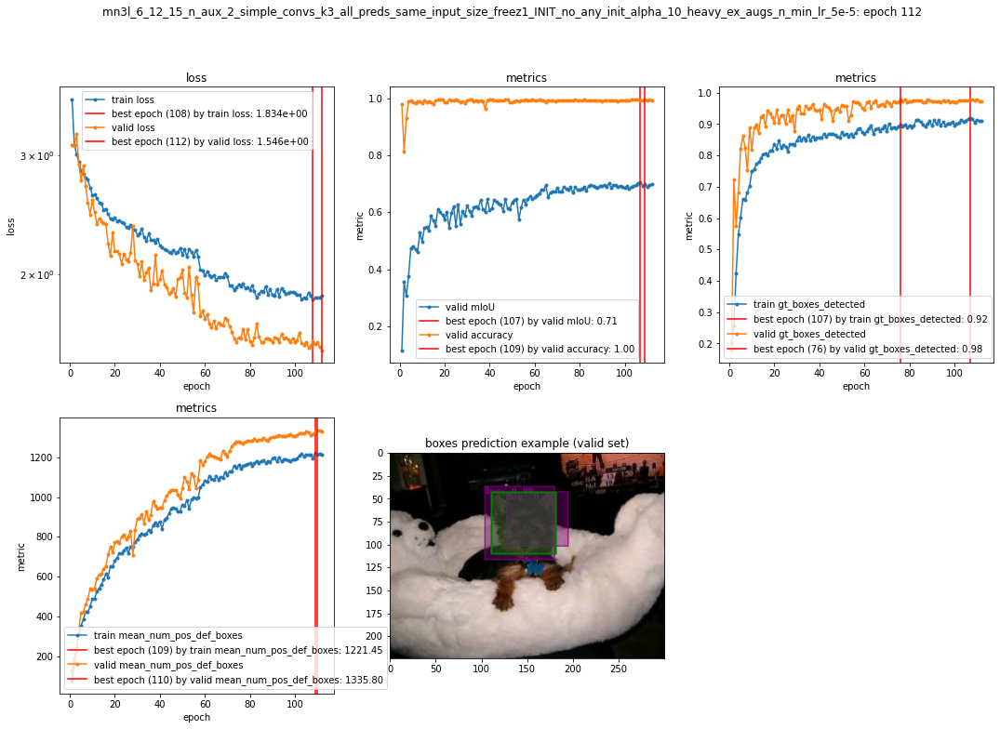

priors scales usage report for train (epoch 112):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.11 |             19
       0.20 |              0.85 |            568
       0.43 |              0.92 |            967
       0.67 |              0.96 |            549
       0.90 |              0.94 |            267
------------------------------------------------

priors scales usage report for valid (epoch 112):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




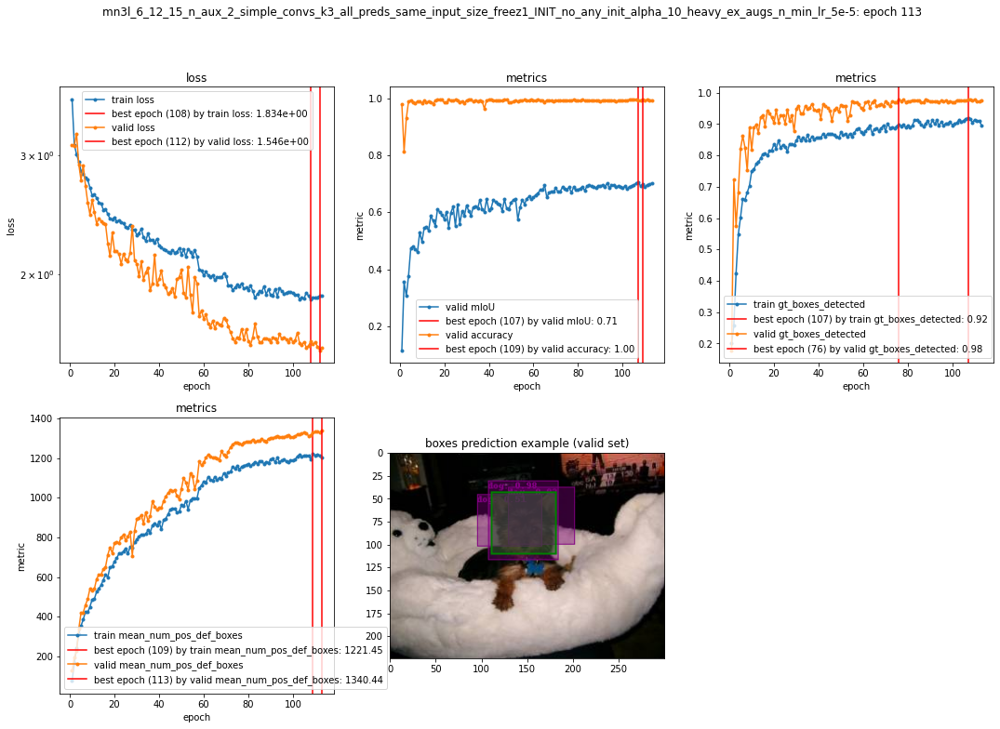

priors scales usage report for train (epoch 113):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.23 |             22
       0.20 |              0.84 |            546
       0.43 |              0.91 |            971
       0.67 |              0.94 |            585
       0.90 |              0.94 |            246
------------------------------------------------

priors scales usage report for valid (epoch 113):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




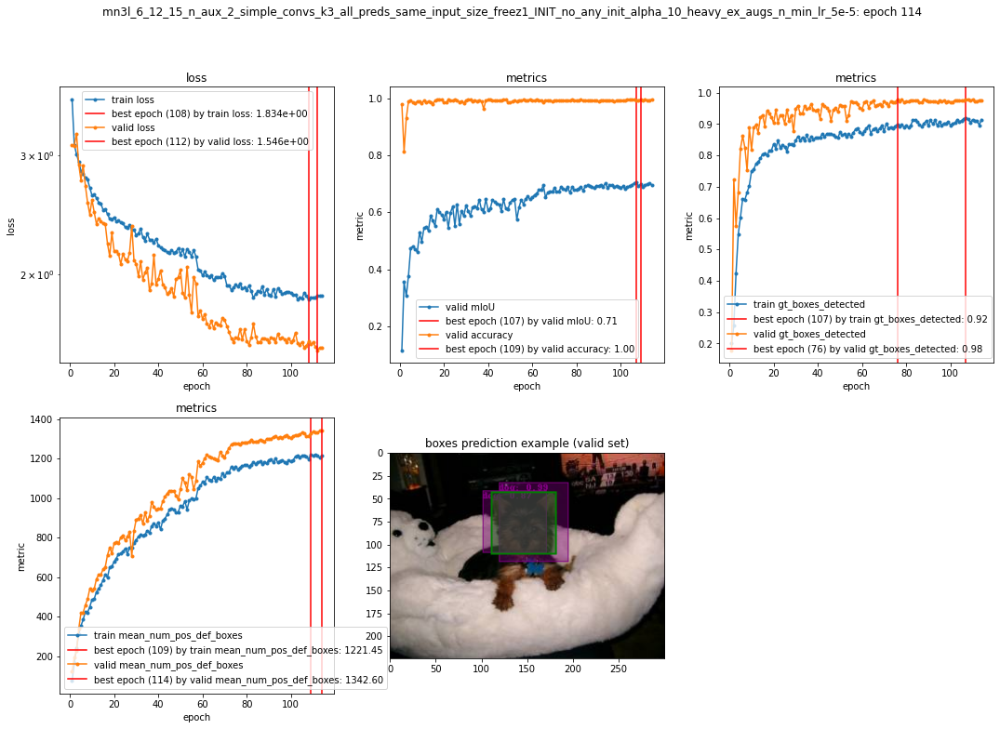

priors scales usage report for train (epoch 114):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.26 |             23
       0.20 |              0.86 |            563
       0.43 |              0.93 |            935
       0.67 |              0.95 |            599
       0.90 |              0.96 |            250
------------------------------------------------

priors scales usage report for valid (epoch 114):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




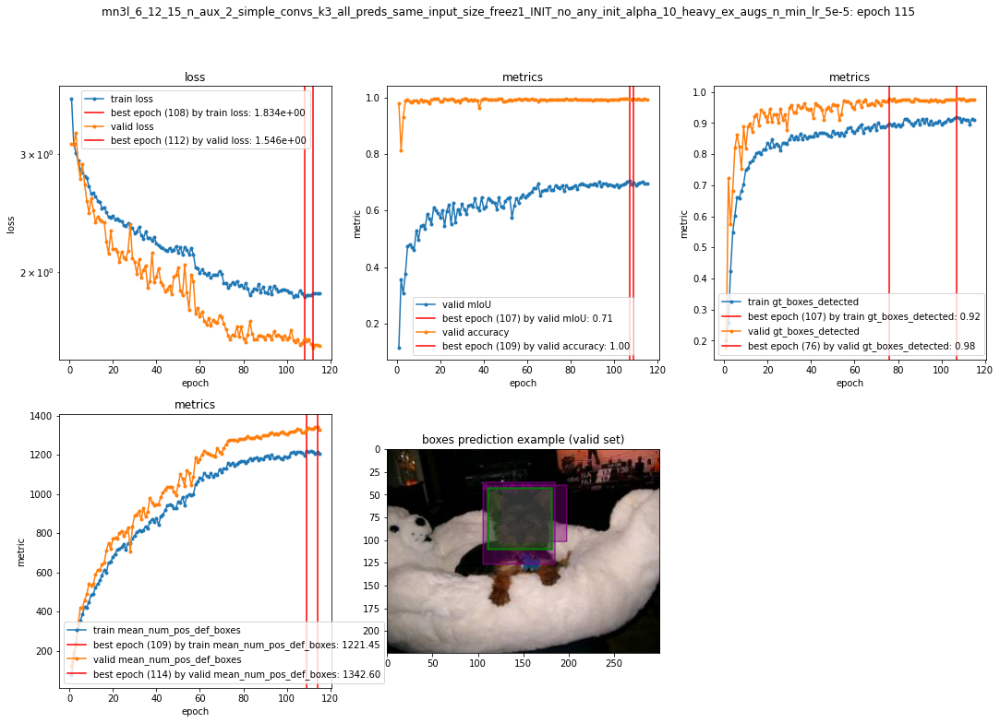

priors scales usage report for train (epoch 115):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.13 |             23
       0.20 |              0.85 |            545
       0.43 |              0.93 |            964
       0.67 |              0.95 |            569
       0.90 |              0.95 |            269
------------------------------------------------

priors scales usage report for valid (epoch 115):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




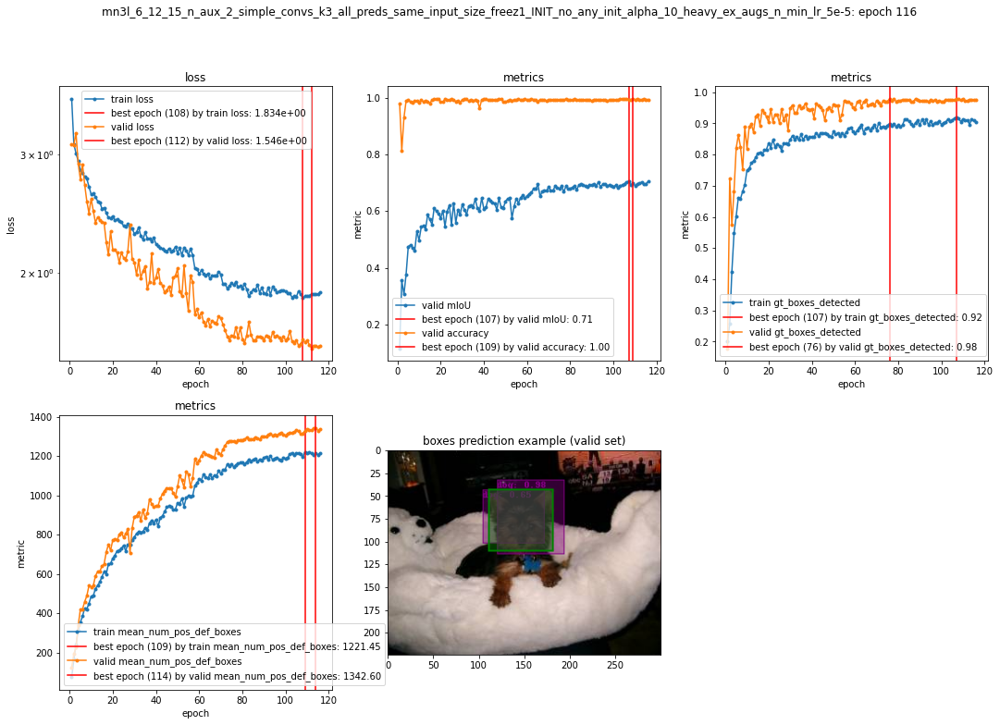

priors scales usage report for train (epoch 116):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.18 |             22
       0.20 |              0.86 |            543
       0.43 |              0.91 |            949
       0.67 |              0.93 |            607
       0.90 |              0.95 |            249
------------------------------------------------

priors scales usage report for valid (epoch 116):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




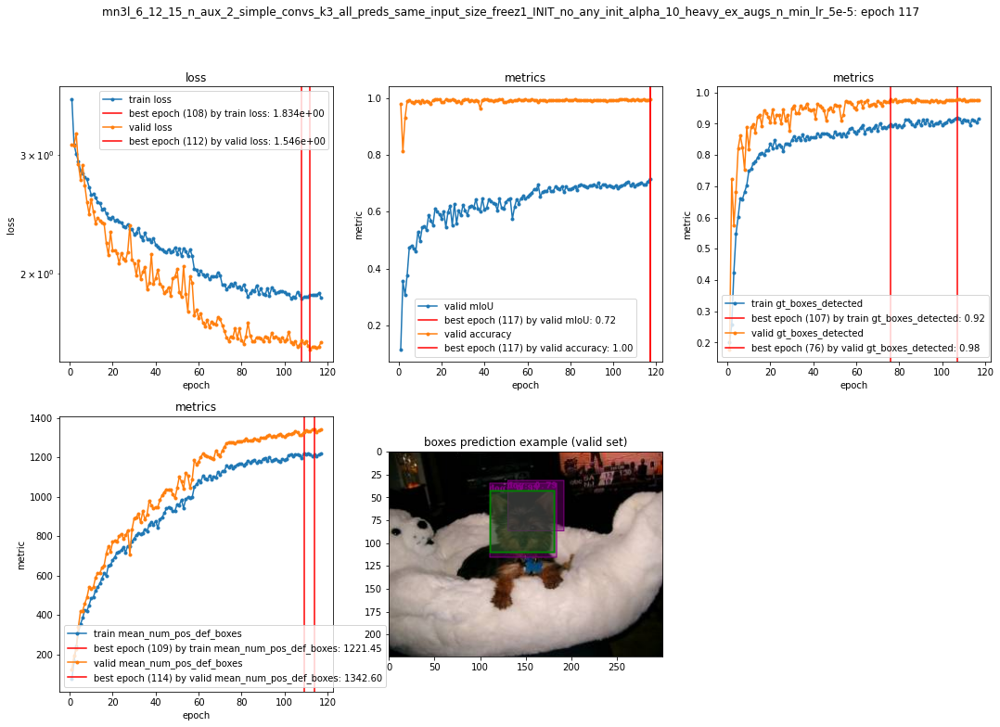

priors scales usage report for train (epoch 117):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             21
       0.20 |              0.87 |            564
       0.43 |              0.93 |            960
       0.67 |              0.94 |            553
       0.90 |              0.97 |            272
------------------------------------------------

priors scales usage report for valid (epoch 117):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




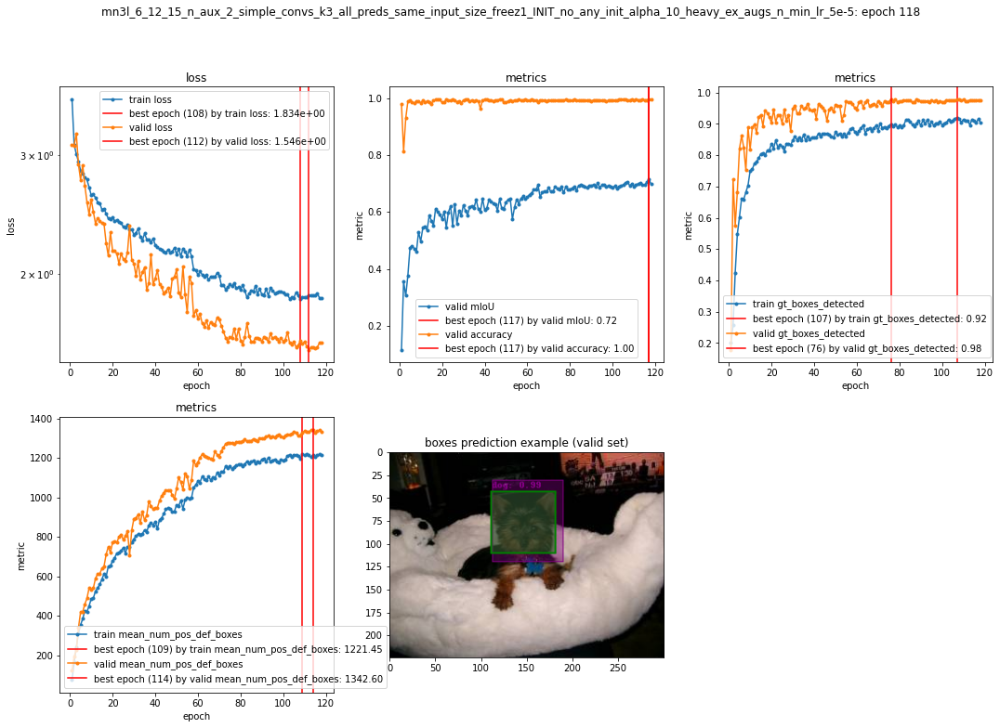

priors scales usage report for train (epoch 118):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.86 |            555
       0.43 |              0.91 |            964
       0.67 |              0.93 |            588
       0.90 |              0.97 |            242
------------------------------------------------

priors scales usage report for valid (epoch 118):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




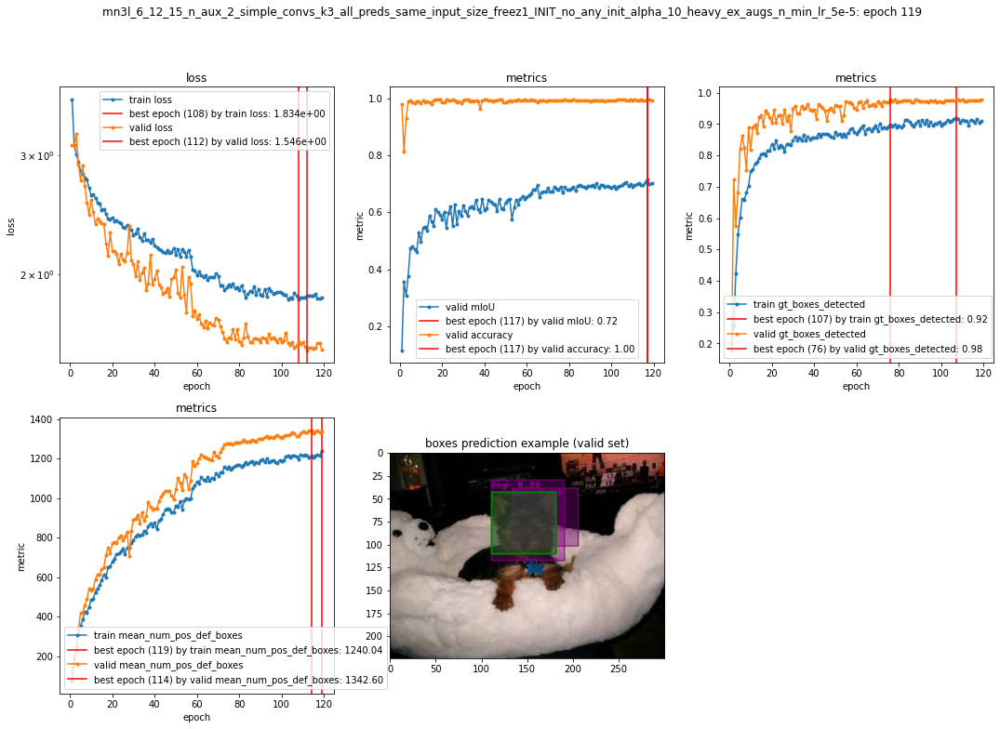

priors scales usage report for train (epoch 119):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.11 |             18
       0.20 |              0.85 |            559
       0.43 |              0.94 |            965
       0.67 |              0.94 |            574
       0.90 |              0.95 |            254
------------------------------------------------

priors scales usage report for valid (epoch 119):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




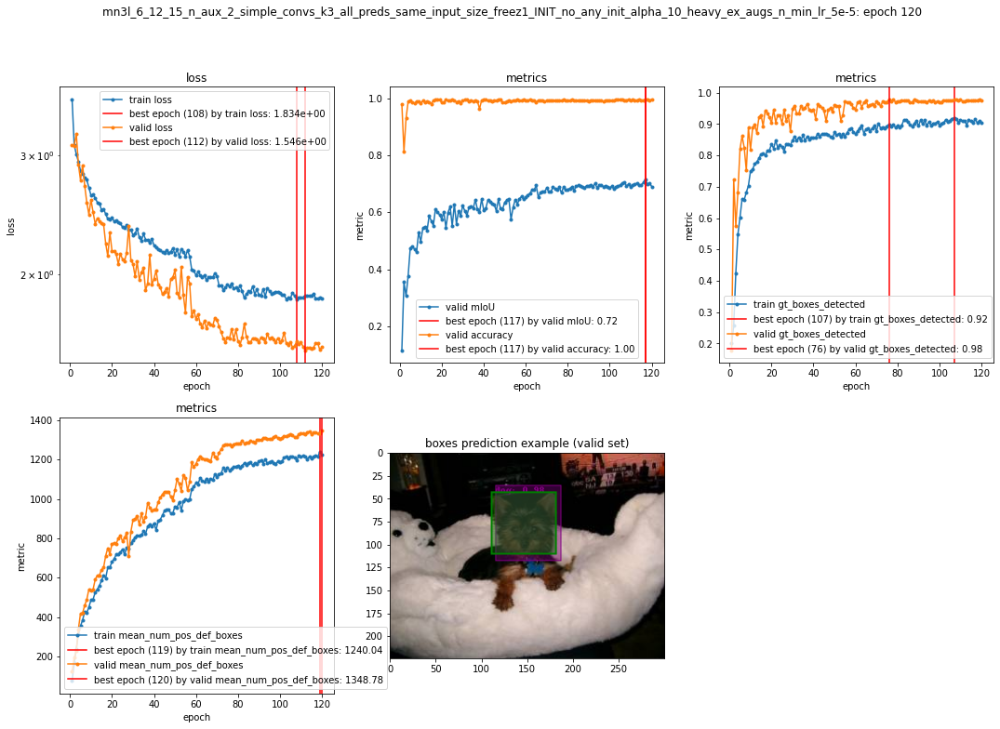

priors scales usage report for train (epoch 120):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             19
       0.20 |              0.84 |            566
       0.43 |              0.92 |            961
       0.67 |              0.95 |            567
       0.90 |              0.96 |            257
------------------------------------------------

priors scales usage report for valid (epoch 120):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




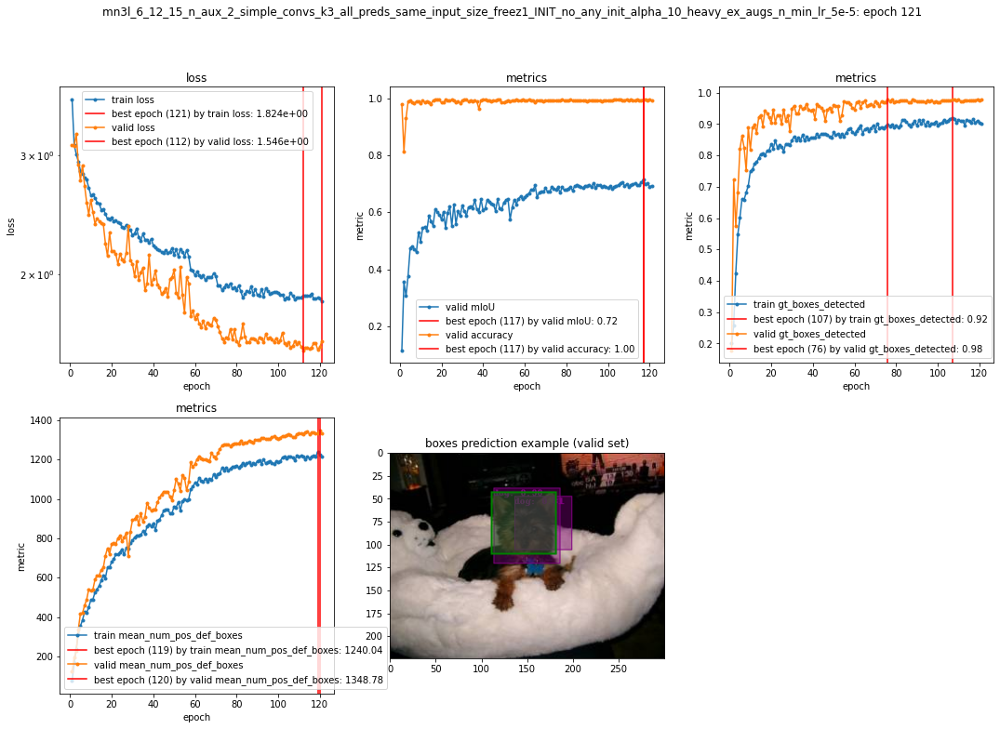

priors scales usage report for train (epoch 121):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             23
       0.20 |              0.85 |            561
       0.43 |              0.92 |            959
       0.67 |              0.94 |            579
       0.90 |              0.94 |            248
------------------------------------------------

priors scales usage report for valid (epoch 121):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




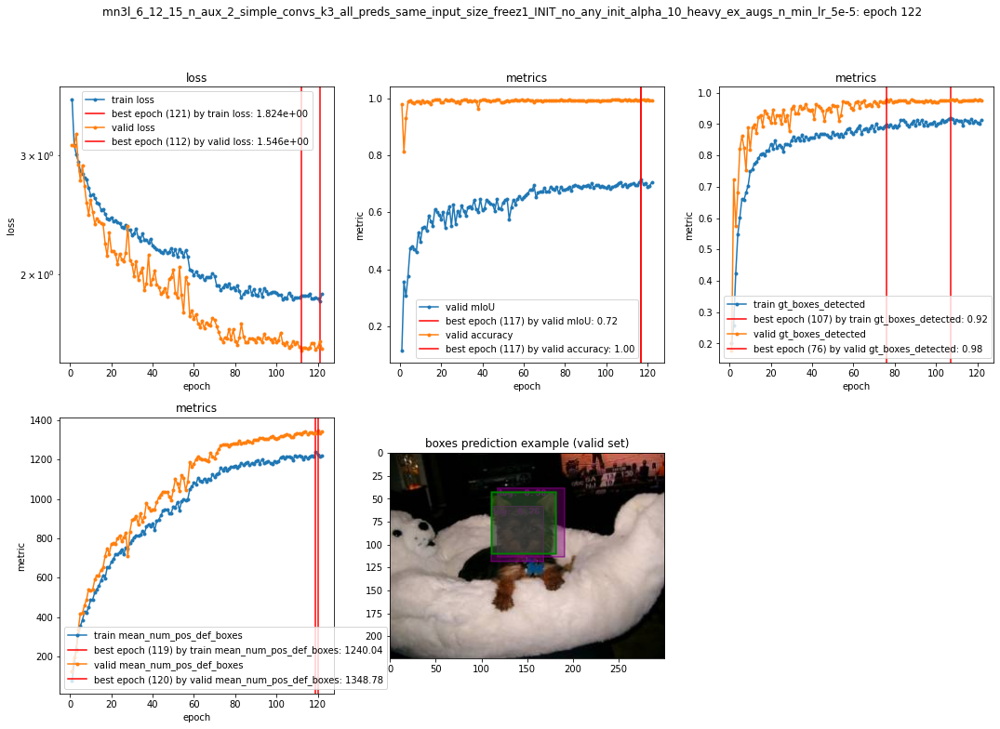

priors scales usage report for train (epoch 122):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             23
       0.20 |              0.86 |            529
       0.43 |              0.92 |          1,001
       0.67 |              0.95 |            549
       0.90 |              0.95 |            268
------------------------------------------------

priors scales usage report for valid (epoch 122):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




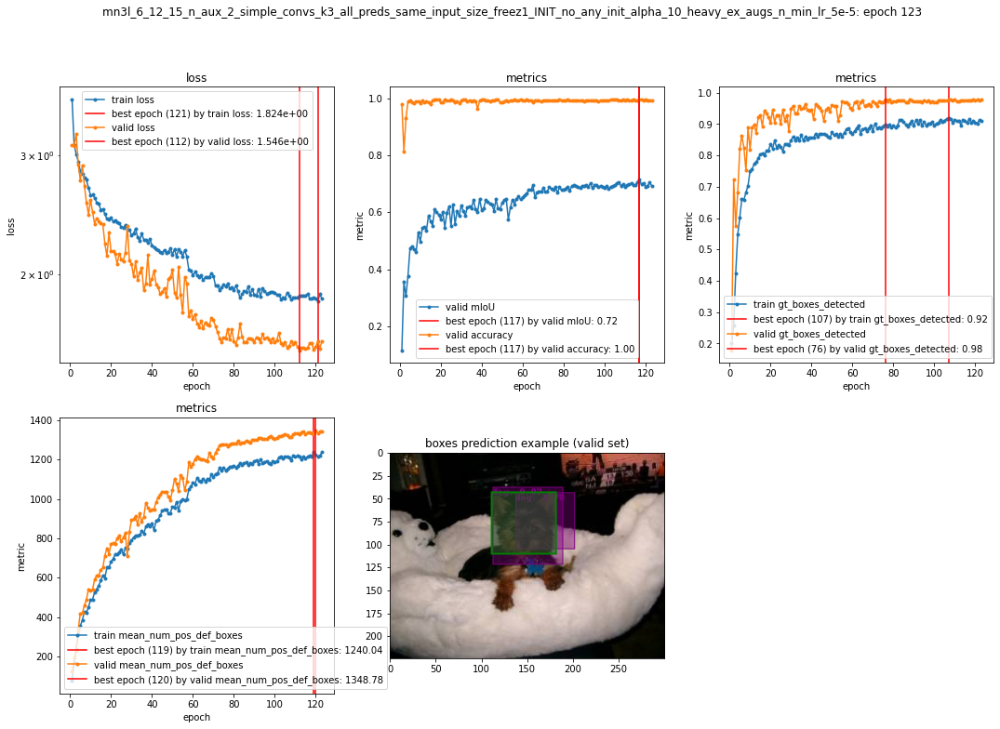

priors scales usage report for train (epoch 123):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.15 |             20
       0.20 |              0.86 |            562
       0.43 |              0.93 |            955
       0.67 |              0.95 |            582
       0.90 |              0.94 |            251
------------------------------------------------

priors scales usage report for valid (epoch 123):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




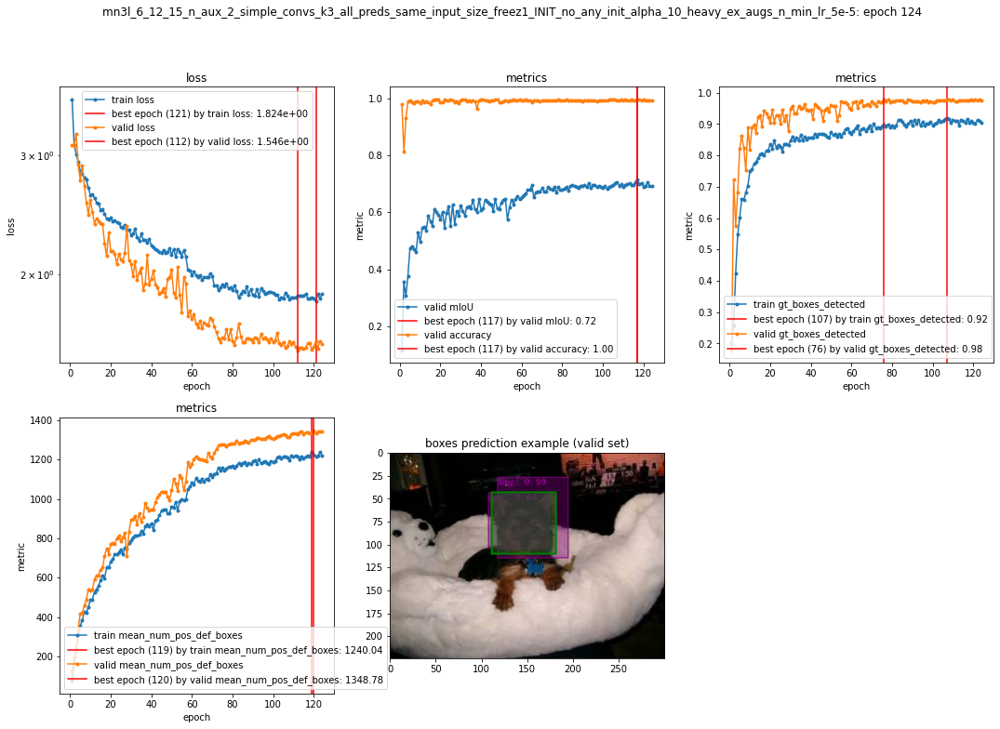

priors scales usage report for train (epoch 124):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.25 |             16
       0.20 |              0.84 |            548
       0.43 |              0.93 |            974
       0.67 |              0.93 |            559
       0.90 |              0.93 |            273
------------------------------------------------

priors scales usage report for valid (epoch 124):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




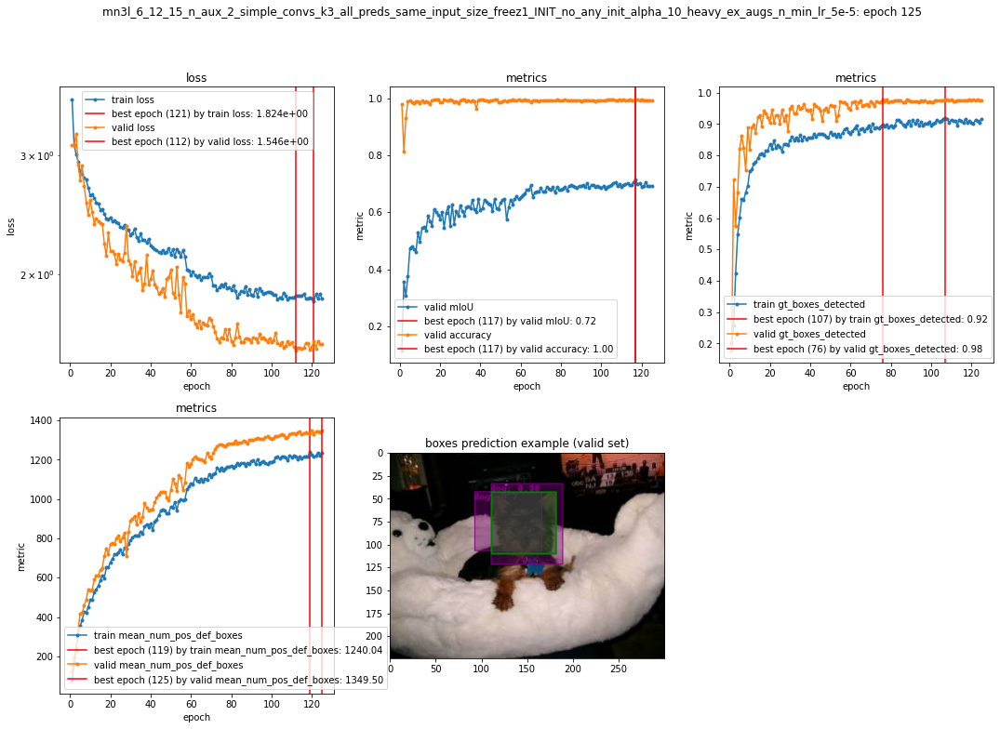

priors scales usage report for train (epoch 125):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.35 |             20
       0.20 |              0.86 |            534
       0.43 |              0.93 |            953
       0.67 |              0.94 |            614
       0.90 |              0.96 |            249
------------------------------------------------

priors scales usage report for valid (epoch 125):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




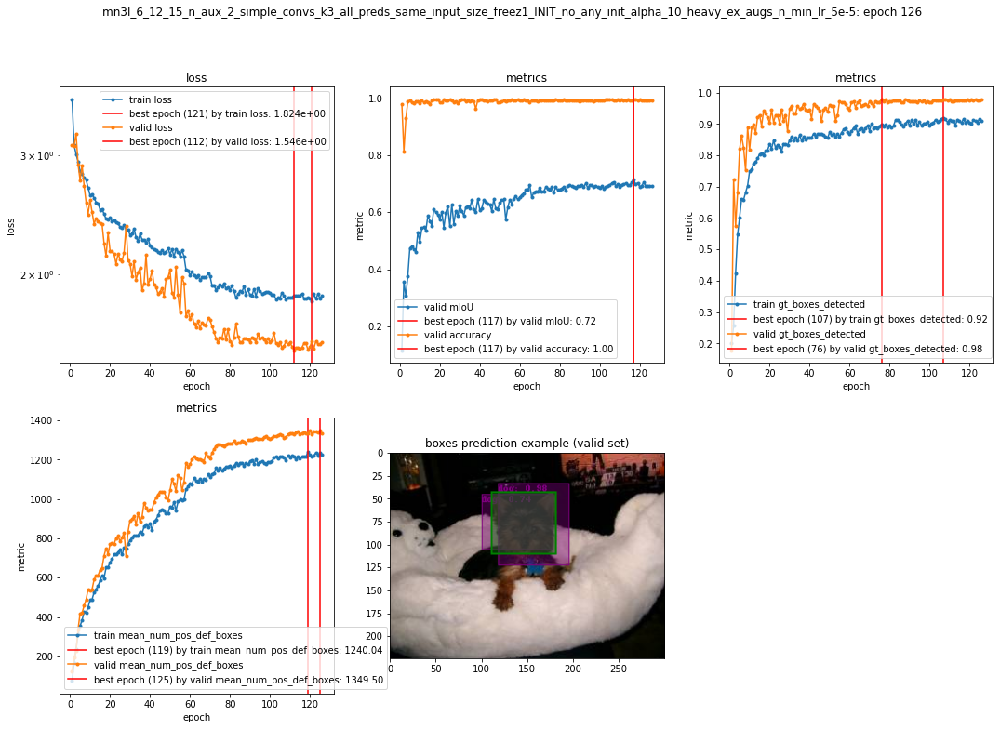

priors scales usage report for train (epoch 126):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             18
       0.20 |              0.85 |            579
       0.43 |              0.93 |            938
       0.67 |              0.93 |            572
       0.90 |              0.95 |            263
------------------------------------------------

priors scales usage report for valid (epoch 126):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




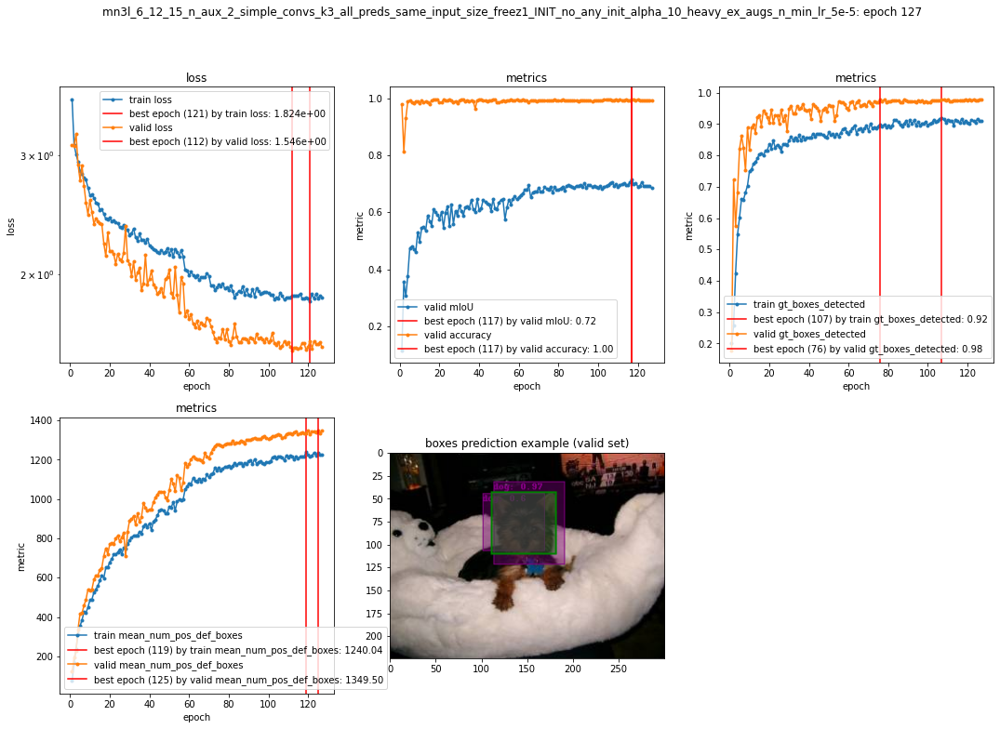

priors scales usage report for train (epoch 127):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.00 |             14
       0.20 |              0.86 |            565
       0.43 |              0.92 |            965
       0.67 |              0.95 |            572
       0.90 |              0.94 |            254
------------------------------------------------

priors scales usage report for valid (epoch 127):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




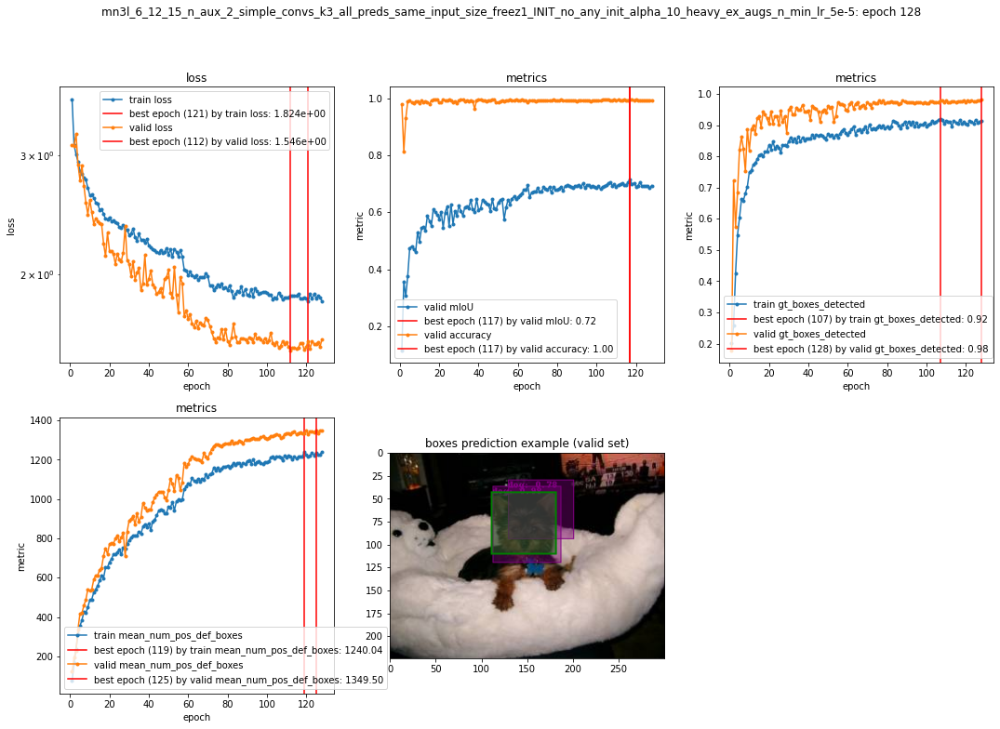

priors scales usage report for train (epoch 128):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.86 |            559
       0.43 |              0.93 |            931
       0.67 |              0.95 |            600
       0.90 |              0.96 |            259
------------------------------------------------

priors scales usage report for valid (epoch 128):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




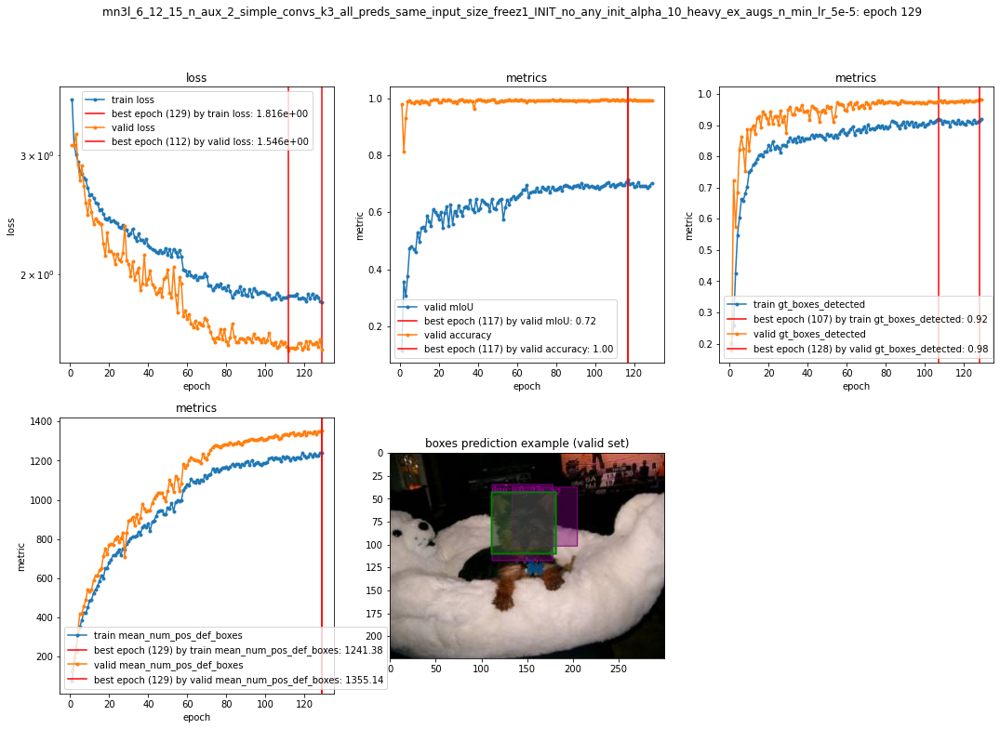

priors scales usage report for train (epoch 129):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.24 |             21
       0.20 |              0.86 |            565
       0.43 |              0.94 |            933
       0.67 |              0.96 |            588
       0.90 |              0.93 |            263
------------------------------------------------

priors scales usage report for valid (epoch 129):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




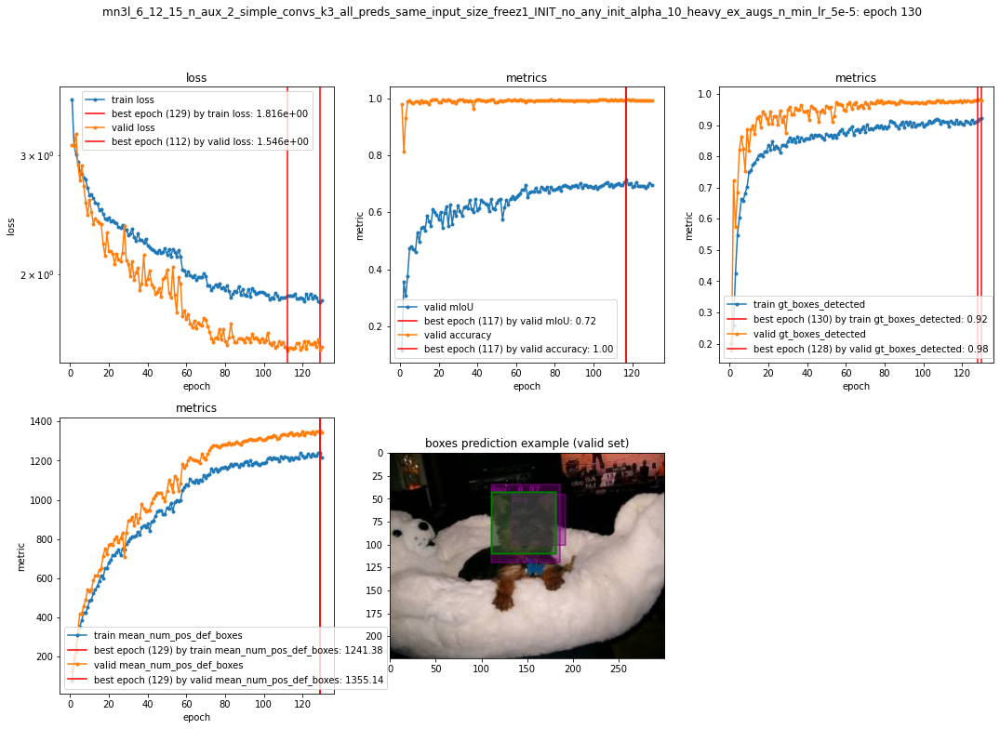

priors scales usage report for train (epoch 130):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.20 |             20
       0.20 |              0.87 |            527
       0.43 |              0.94 |            968
       0.67 |              0.95 |            590
       0.90 |              0.96 |            265
------------------------------------------------

priors scales usage report for valid (epoch 130):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




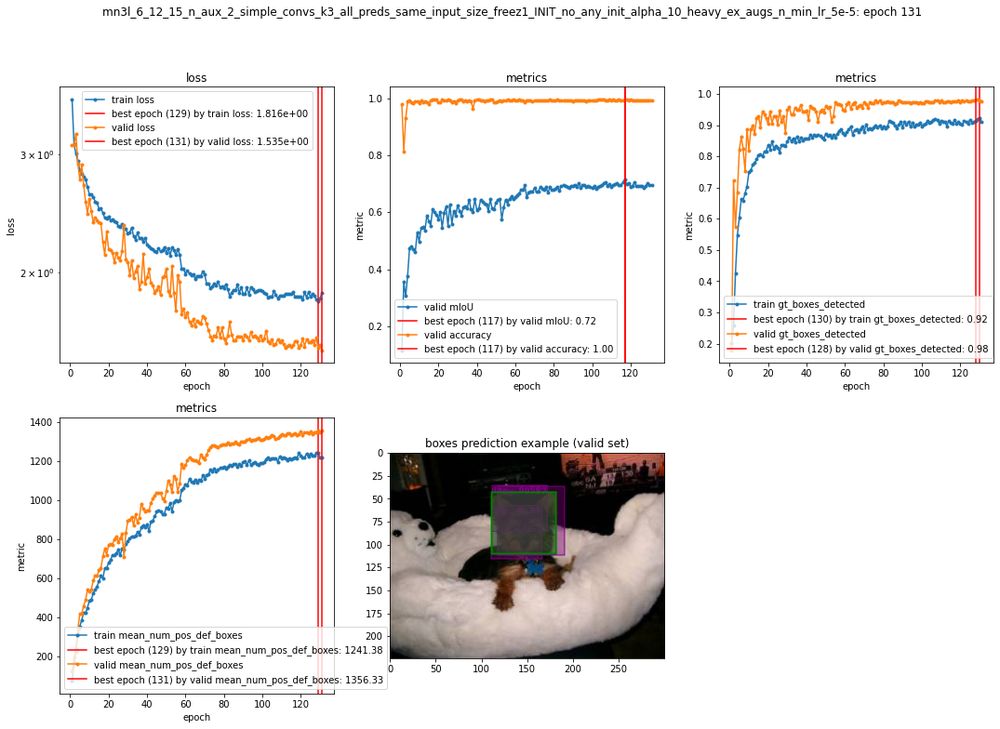

priors scales usage report for train (epoch 131):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.35 |             20
       0.20 |              0.87 |            576
       0.43 |              0.92 |            962
       0.67 |              0.95 |            553
       0.90 |              0.93 |            259
------------------------------------------------

priors scales usage report for valid (epoch 131):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




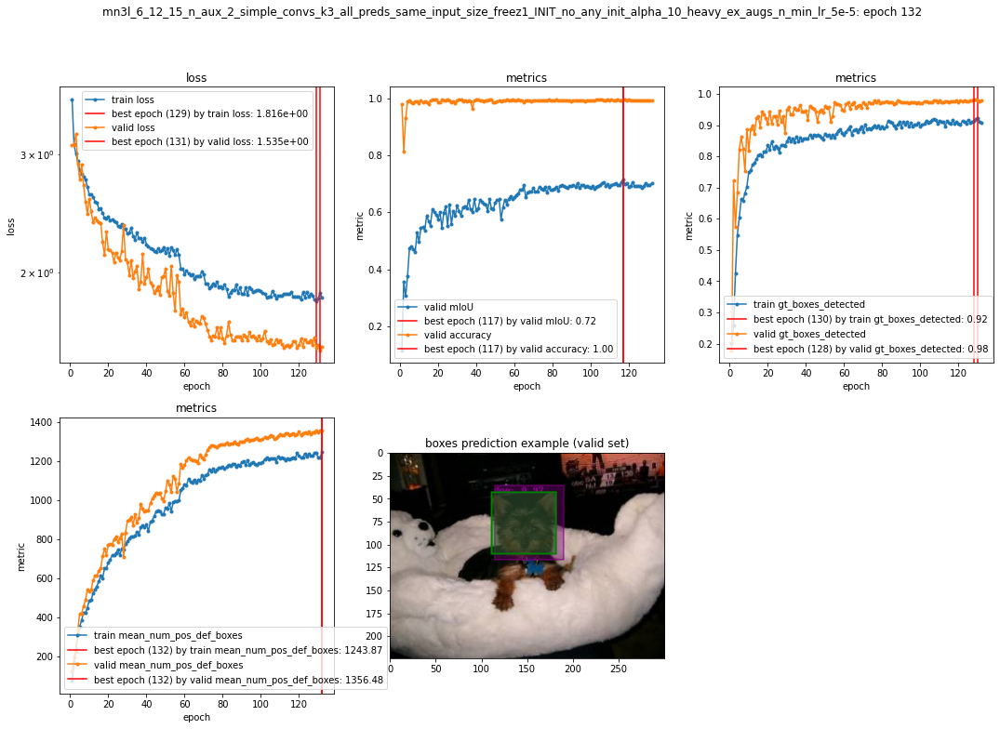

priors scales usage report for train (epoch 132):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             21
       0.20 |              0.85 |            555
       0.43 |              0.92 |            952
       0.67 |              0.95 |            590
       0.90 |              0.96 |            252
------------------------------------------------

priors scales usage report for valid (epoch 132):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




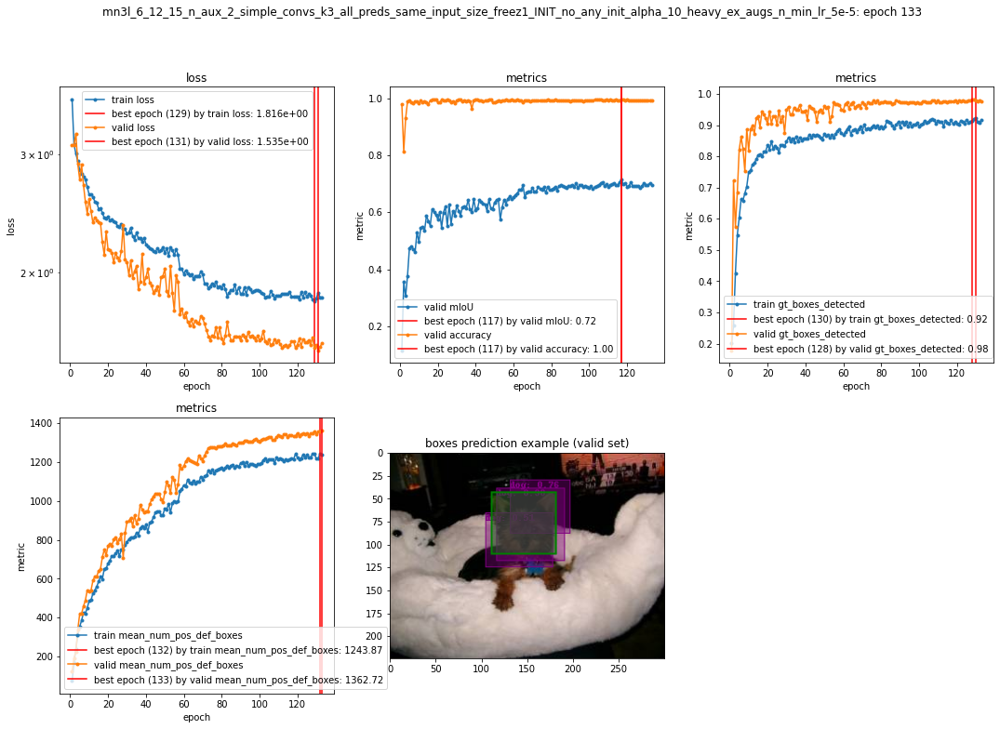

priors scales usage report for train (epoch 133):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.26 |             19
       0.20 |              0.86 |            561
       0.43 |              0.94 |            963
       0.67 |              0.95 |            540
       0.90 |              0.94 |            287
------------------------------------------------

priors scales usage report for valid (epoch 133):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




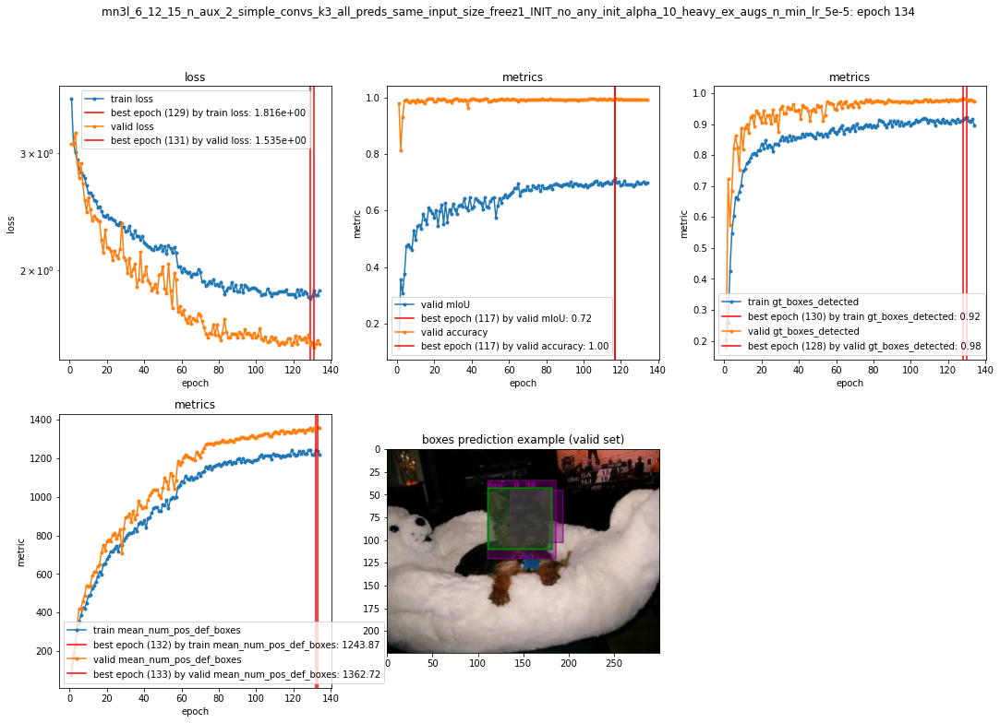

priors scales usage report for train (epoch 134):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.10 |             20
       0.20 |              0.83 |            582
       0.43 |              0.92 |            948
       0.67 |              0.94 |            553
       0.90 |              0.92 |            267
------------------------------------------------

priors scales usage report for valid (epoch 134):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




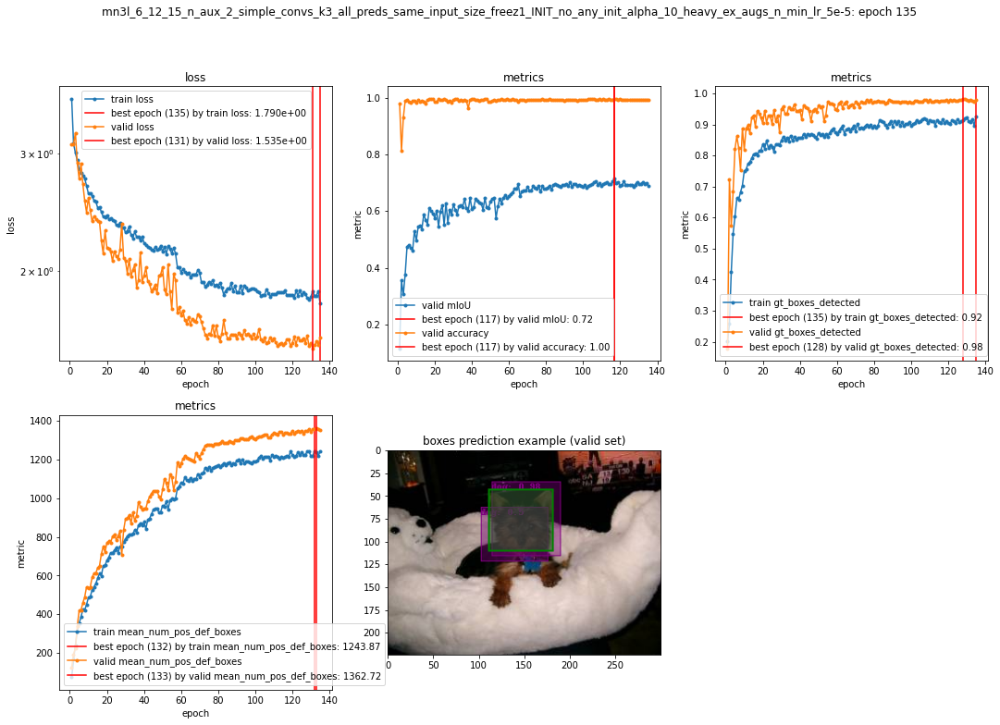

priors scales usage report for train (epoch 135):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.33 |             15
       0.20 |              0.86 |            557
       0.43 |              0.94 |            967
       0.67 |              0.97 |            576
       0.90 |              0.95 |            255
------------------------------------------------

priors scales usage report for valid (epoch 135):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




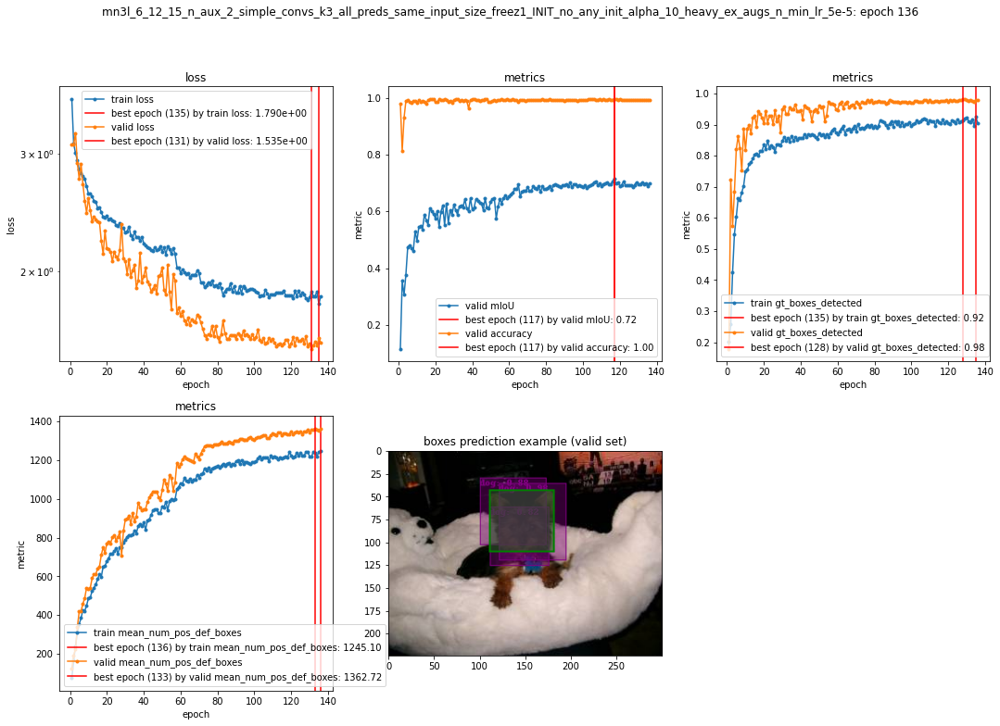

priors scales usage report for train (epoch 136):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.39 |             28
       0.20 |              0.86 |            529
       0.43 |              0.92 |            973
       0.67 |              0.93 |            573
       0.90 |              0.94 |            267
------------------------------------------------

priors scales usage report for valid (epoch 136):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




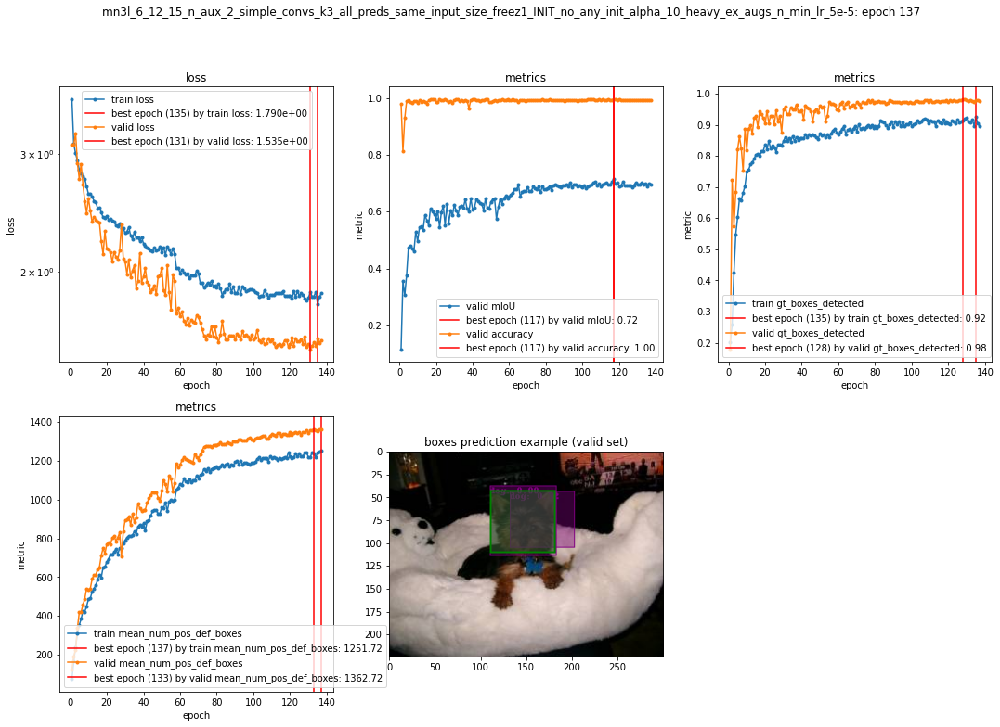

priors scales usage report for train (epoch 137):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.85 |            558
       0.43 |              0.90 |            975
       0.67 |              0.94 |            556
       0.90 |              0.92 |            267
------------------------------------------------

priors scales usage report for valid (epoch 137):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




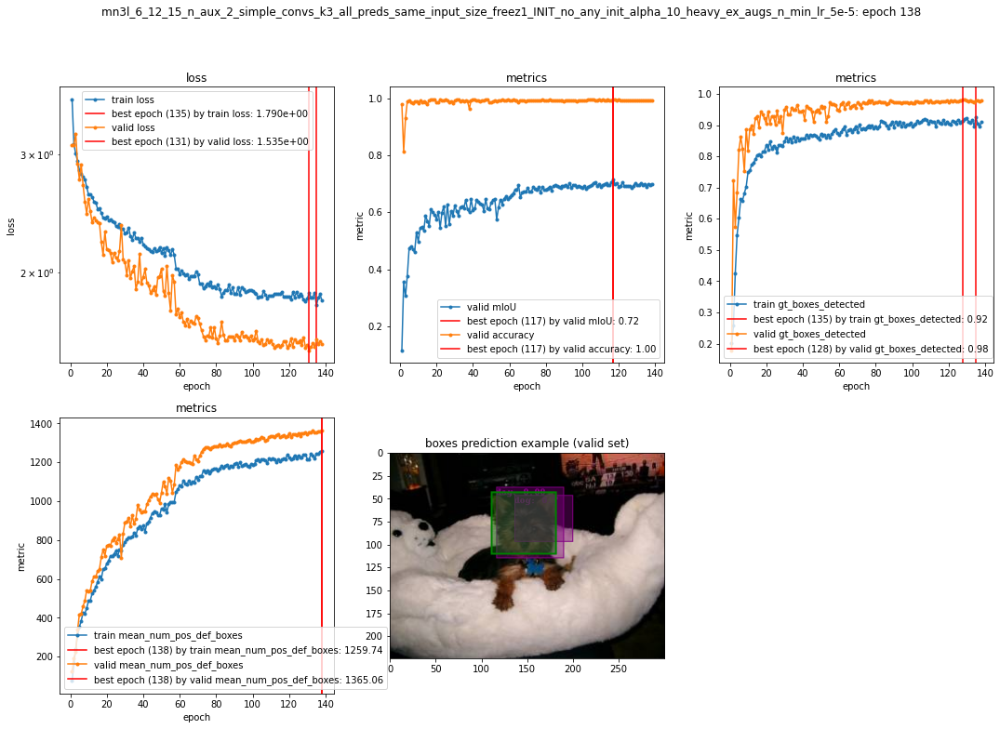

priors scales usage report for train (epoch 138):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.14 |             22
       0.20 |              0.86 |            548
       0.43 |              0.93 |            977
       0.67 |              0.95 |            563
       0.90 |              0.95 |            260
------------------------------------------------

priors scales usage report for valid (epoch 138):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




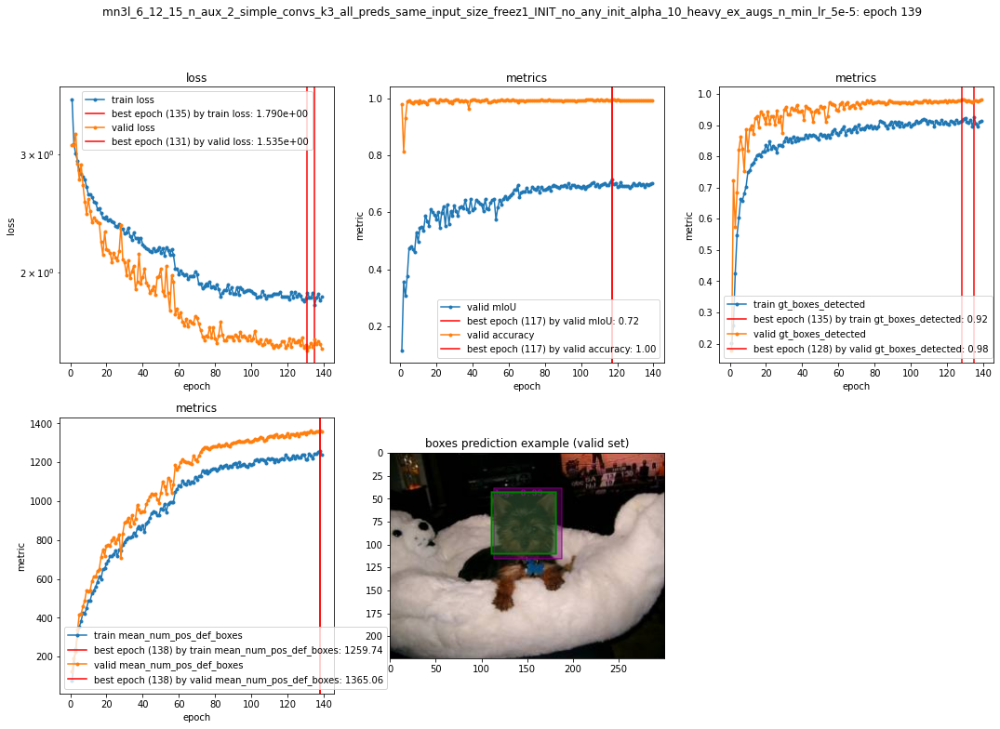

priors scales usage report for train (epoch 139):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.24 |             21
       0.20 |              0.88 |            566
       0.43 |              0.92 |            932
       0.67 |              0.94 |            576
       0.90 |              0.96 |            275
------------------------------------------------

priors scales usage report for valid (epoch 139):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.43 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




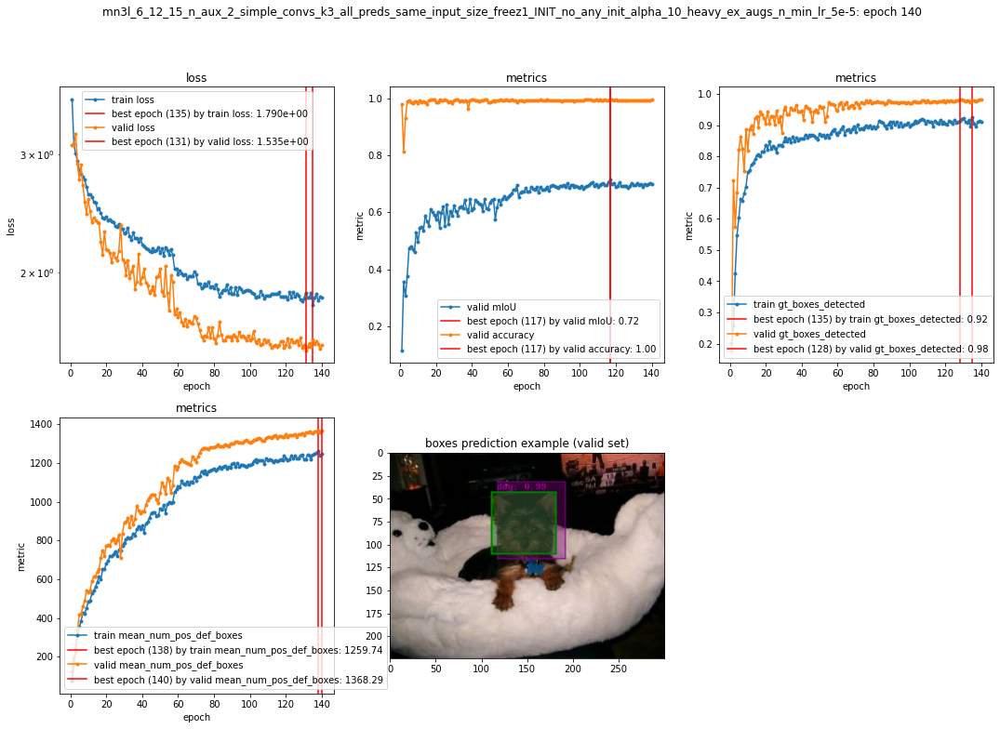

priors scales usage report for train (epoch 140):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             17
       0.20 |              0.86 |            552
       0.43 |              0.92 |            972
       0.67 |              0.95 |            575
       0.90 |              0.93 |            254
------------------------------------------------

priors scales usage report for valid (epoch 140):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




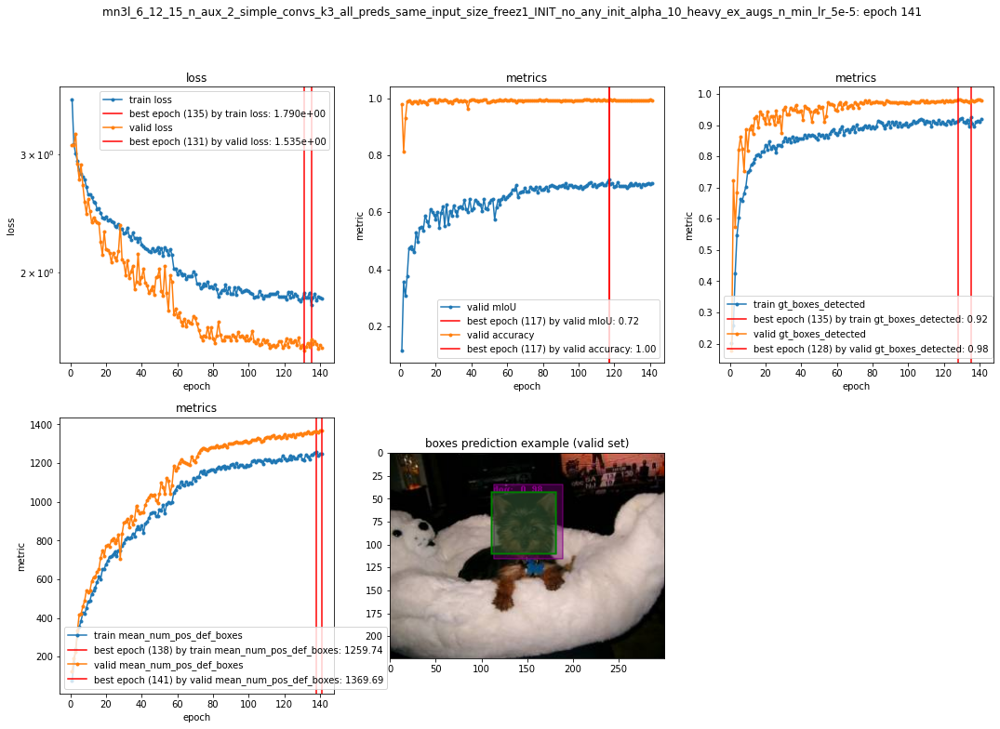

priors scales usage report for train (epoch 141):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.38 |             21
       0.20 |              0.88 |            562
       0.43 |              0.93 |            931
       0.67 |              0.95 |            604
       0.90 |              0.94 |            252
------------------------------------------------

priors scales usage report for valid (epoch 141):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




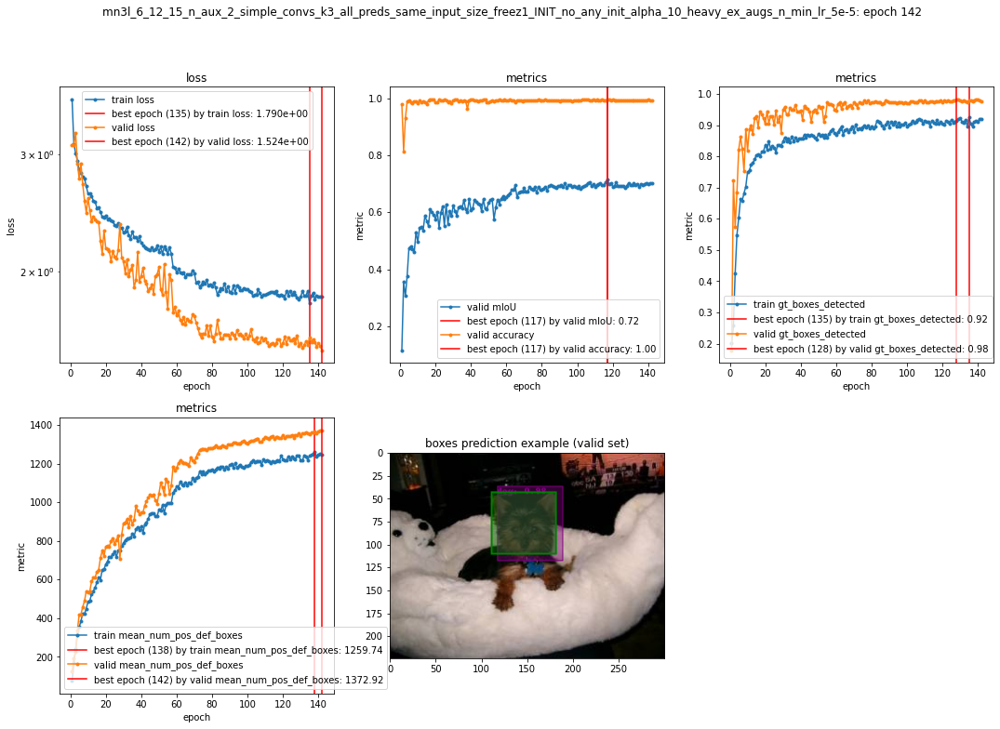

priors scales usage report for train (epoch 142):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.31 |             16
       0.20 |              0.88 |            541
       0.43 |              0.93 |            990
       0.67 |              0.95 |            552
       0.90 |              0.94 |            271
------------------------------------------------

priors scales usage report for valid (epoch 142):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




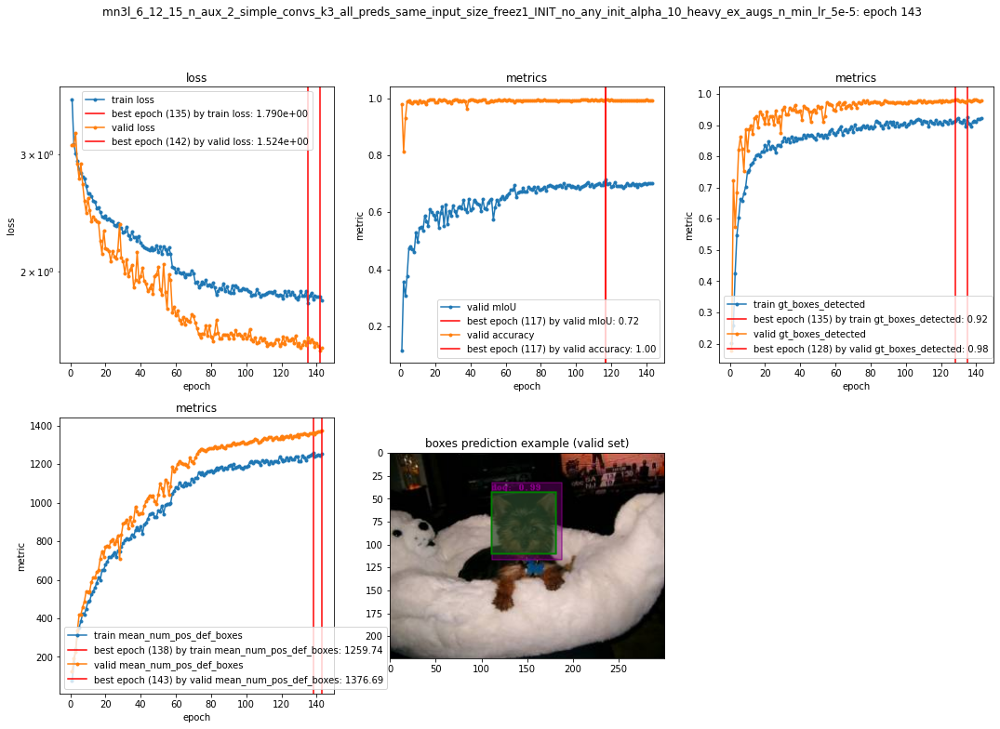

priors scales usage report for train (epoch 143):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             28
       0.20 |              0.87 |            550
       0.43 |              0.95 |            965
       0.67 |              0.95 |            579
       0.90 |              0.95 |            248
------------------------------------------------

priors scales usage report for valid (epoch 143):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




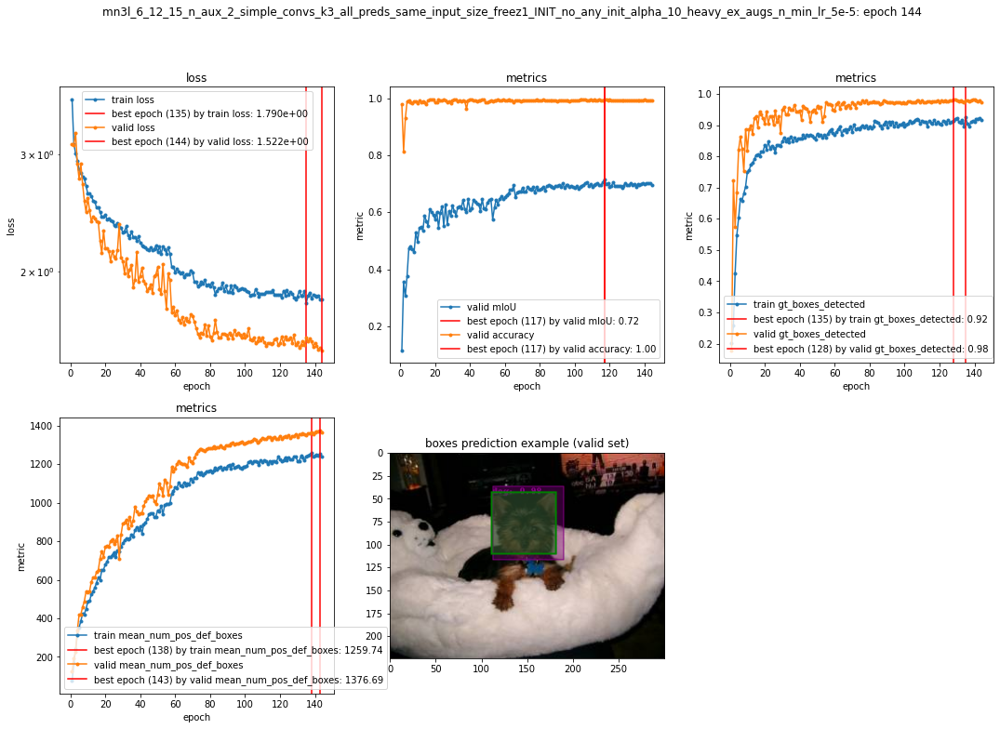

priors scales usage report for train (epoch 144):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.32 |             22
       0.20 |              0.86 |            581
       0.43 |              0.93 |            948
       0.67 |              0.96 |            566
       0.90 |              0.96 |            253
------------------------------------------------

priors scales usage report for valid (epoch 144):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




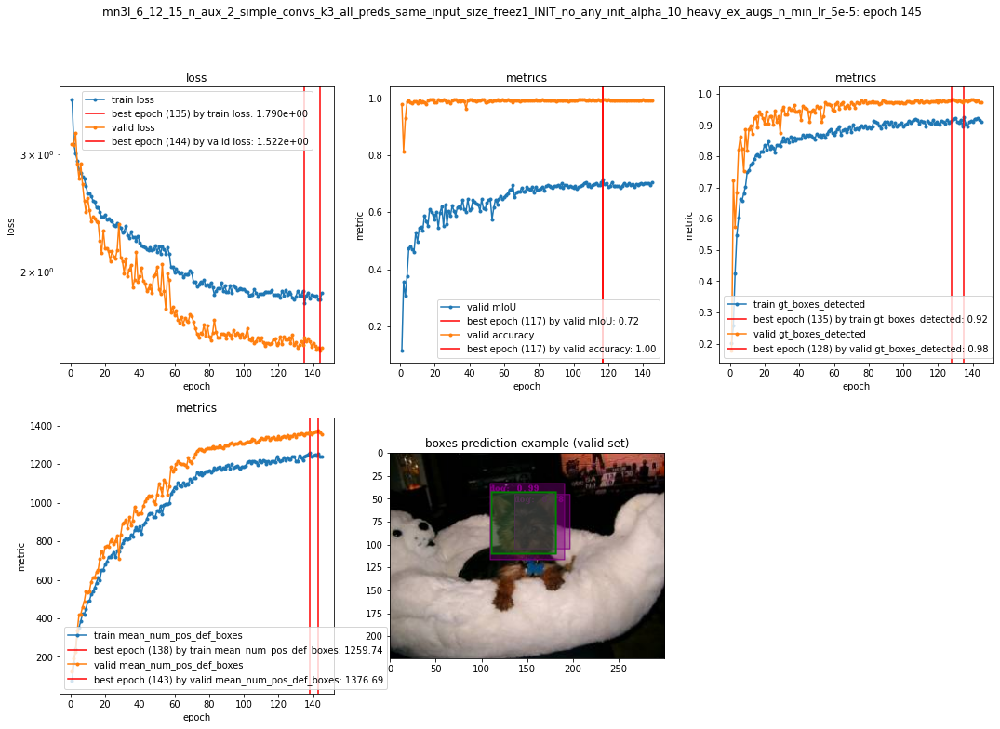

priors scales usage report for train (epoch 145):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             19
       0.20 |              0.86 |            552
       0.43 |              0.91 |            970
       0.67 |              0.95 |            558
       0.90 |              0.97 |            271
------------------------------------------------

priors scales usage report for valid (epoch 145):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




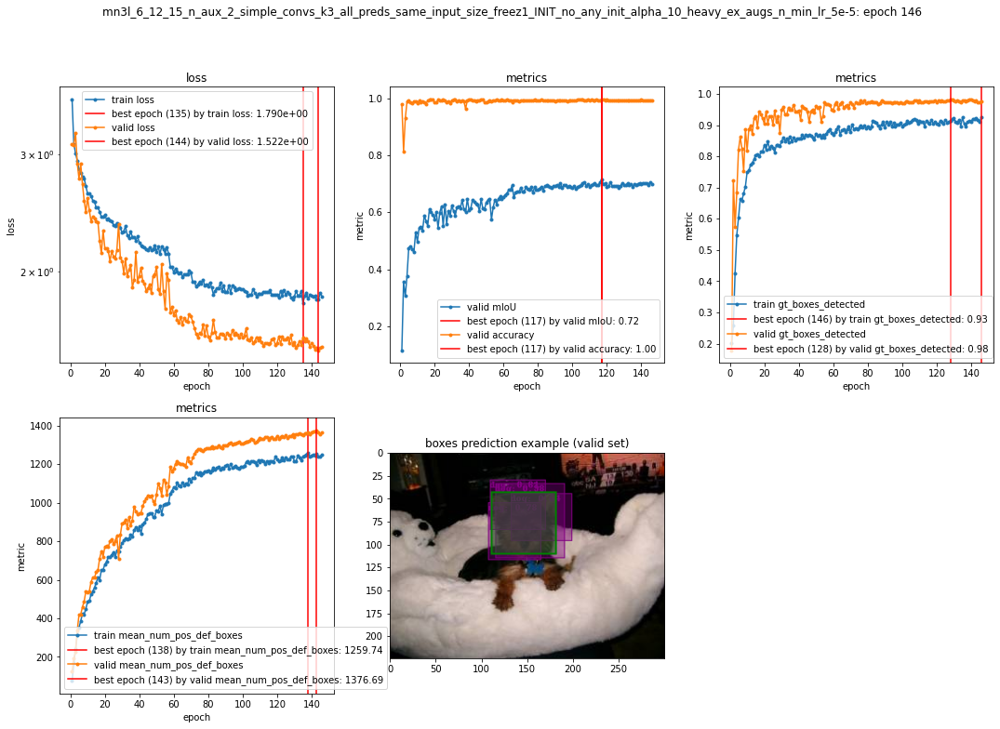

priors scales usage report for train (epoch 146):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.30 |             20
       0.20 |              0.88 |            574
       0.43 |              0.94 |            930
       0.67 |              0.95 |            579
       0.90 |              0.97 |            267
------------------------------------------------

priors scales usage report for valid (epoch 146):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.36 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




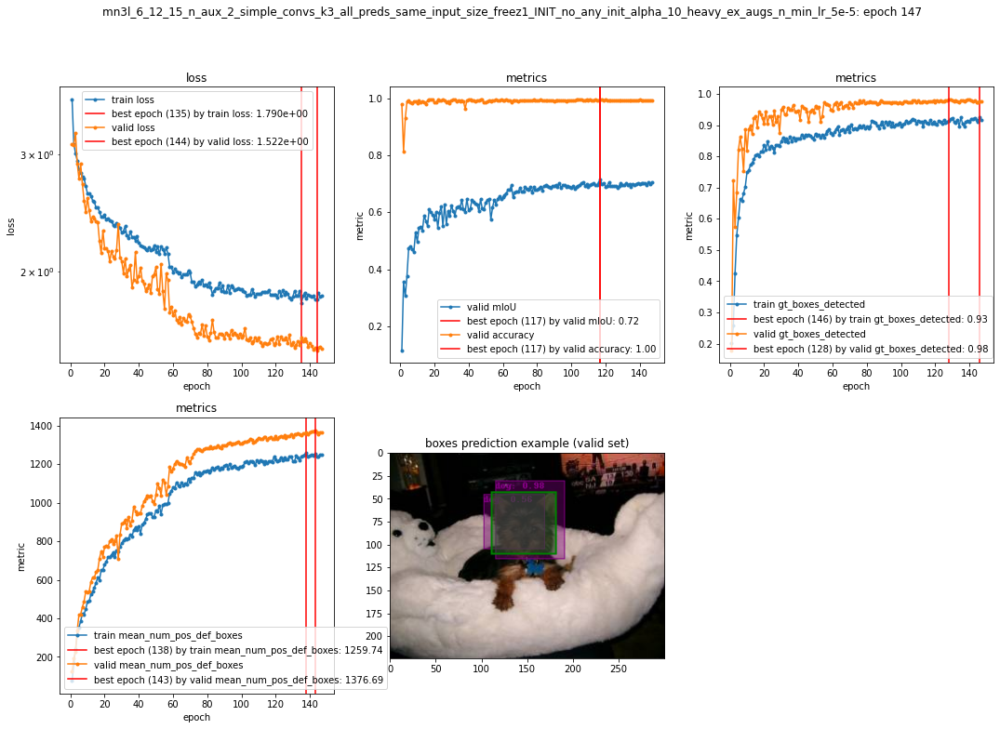

priors scales usage report for train (epoch 147):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.38 |             26
       0.20 |              0.86 |            559
       0.43 |              0.93 |            930
       0.67 |              0.96 |            592
       0.90 |              0.95 |            263
------------------------------------------------

priors scales usage report for valid (epoch 147):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




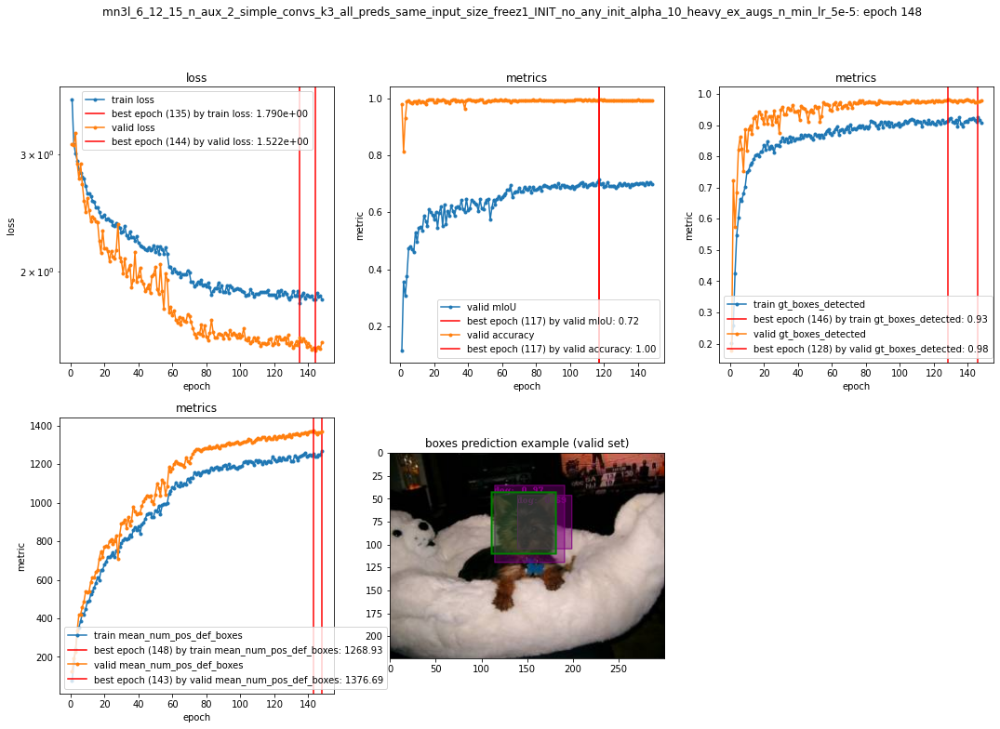

priors scales usage report for train (epoch 148):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.12 |             17
       0.20 |              0.86 |            559
       0.43 |              0.93 |            958
       0.67 |              0.93 |            569
       0.90 |              0.94 |            267
------------------------------------------------

priors scales usage report for valid (epoch 148):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              1.00 |            174
       0.43 |              1.00 |            219
       0.67 |              0.99 |             87
       0.90 |              1.00 |             14
------------------------------------------------




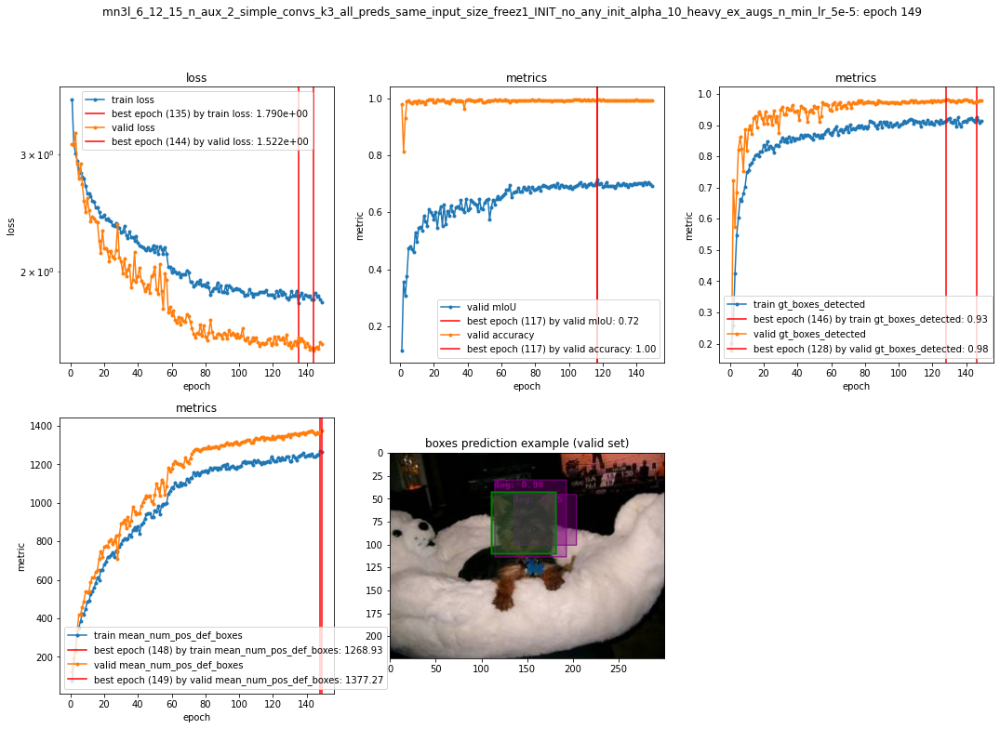

priors scales usage report for train (epoch 149):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.33 |             18
       0.20 |              0.86 |            543
       0.43 |              0.92 |            980
       0.67 |              0.95 |            578
       0.90 |              0.96 |            251
------------------------------------------------

priors scales usage report for valid (epoch 149):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.29 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------




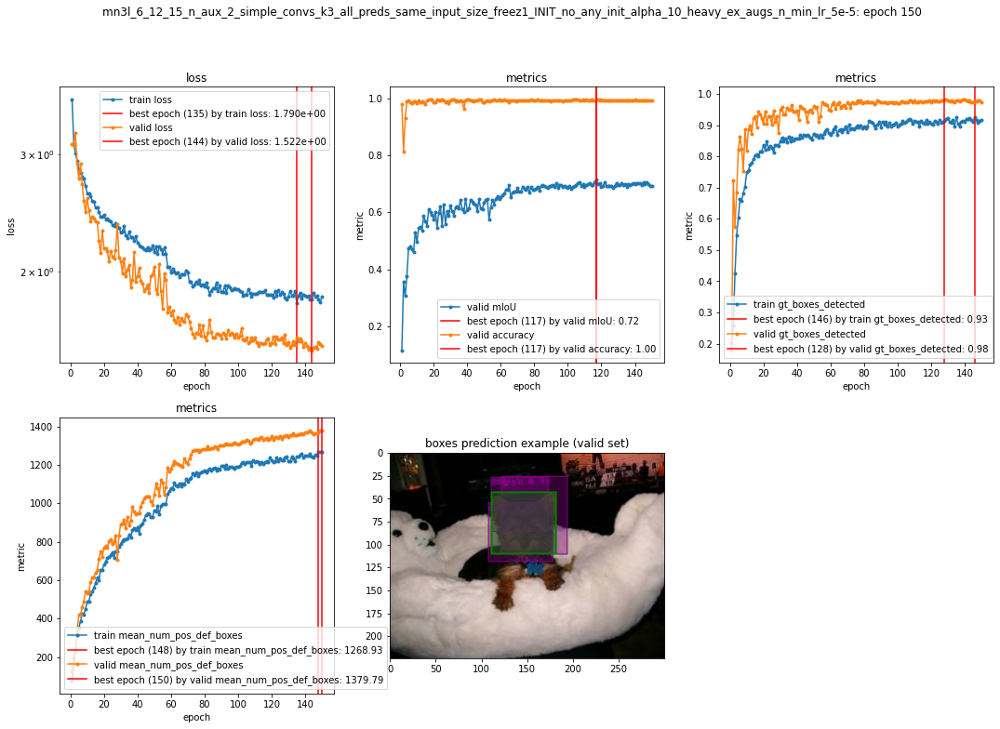

priors scales usage report for train (epoch 150):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.22 |             18
       0.20 |              0.88 |            565
       0.43 |              0.92 |            971
       0.67 |              0.94 |            570
       0.90 |              0.98 |            246
------------------------------------------------

priors scales usage report for valid (epoch 150):
------------------------------------------------
prior scale | gt boxes detected | gt boxes total
------------------------------------------------
       0.10 |              0.21 |             14
       0.20 |              0.99 |            174
       0.43 |              1.00 |            219
       0.67 |              1.00 |             87
       0.90 |              1.00 |             14
------------------------------------------------





In [55]:
NUM_EPOCHS = 50
train(
    TRAIN_HISTORY_STORAGE,
    MODEL_NAME, model, NUM_EPOCHS,
    train_loader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls, optimizer, valid_loader,
    alpha=10,
    lr_scheduler=lr_scheduler, lr_scheduler_1st_epoch=3, use_valid_loss_for_scheduler=False, init_epoch_callback=init_epoch_callback, max_grad_norm=MAX_GRAD_NORM,
    calc_mIoU=MetricsCalculation.valid, calc_accuracy=MetricsCalculation.valid,
    calc_gt_boxes_detected=MetricsCalculation.both, calc_mean_num_pos_def_boxes=MetricsCalculation.both,
    report_priors_scales_usage=MetricsCalculation.both,
    prediction_example_choosing='first', show_only_last_plot=False,
    # early_stopping=True, es_patience=2, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=3, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=5, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=7, es_rel_threshold=5e-2,
    # early_stopping=True, es_patience=9, es_rel_threshold=1e-2,
    # early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=True,
    early_stopping=False, es_patience=19, es_rel_threshold=1e-2, use_valid_loss_for_es=False,
    device=DEVICE,
    resume=True)

In [56]:
len(optimizer.param_groups), optimizer.param_groups[0]['lr']

(1, 5e-05)

In [ ]:
# TEST: results comparison of different splits
from pprint import pprint

for split, dataloader in zip(['train', 'valid', 'test'], [train_loader, valid_loader, test_loader]):
    metrics, _ = evaluate(
        model, dataloader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls,
        test=split == 'test', calc_mIoU=True, calc_accuracy=True, prediction_example_choosing='none', device=DEVICE)
    print(f"Metrics on {split}:")
    pprint(metrics)

In [ ]:
benchmark(model, input_shape=(1, 3, 224, 224), device=DEVICE)

   ## One box

In [ ]:
from torch import nn


class SimpleCNNExactlyOneBoxDetector(nn.Module):
    super().__init__()
    ...

   ## Testing

In [ ]:
# TEST: results comparison of different splits
from pprint import pprint

EPOCH = 'best'
MODEL_NAME = "MobileNetV3-Small_pretrained_backbone_SSMBDLikeDetector"

loc_criterion_cls = nn.SmoothL1Loss
conf_pos_criterion_cls = nn.CrossEntropyLoss
conf_neg_criterion_cls = nn.CrossEntropyLoss
model = model.to(DEVICE)

states = load_states_and_train_info(MODEL_NAME, EPOCH)  # device is cpu by default
print(
    f"Loaded epoch: {EPOCH}, num: {states['epoch_num']}")
# print(
#  f"Loaded epoch: {EPOCH}, num: {states['epoch_num']}, "
#  f"train loss {states['train_history']['train']['loss'][states['epoch_num'] - 1]}")
model.load_state_dict(states['model_state'])
for split, dataloader in zip(['train', 'valid', 'test'], [train_loader, valid_loader, test_loader]):
    metrics, _ = evaluate(
        model, dataloader, loc_criterion_cls, conf_pos_criterion_cls, conf_neg_criterion_cls,
        test=split == 'test', calc_mIoU=True, calc_accuracy=True, prediction_example_choosing='none', device=DEVICE)
    print(f"Metrics on {split}:")
    pprint(metrics)

In [ ]:
show_train_history_plots(states['train_history'],
                         model_name=states['model_name'],
                         epochs=states['epoch_num'])

In [ ]:
benchmark(model, input_shape=(1, 3, 224, 224), device=DEVICE)

In [ ]:
INFERENCE_TIME = 9e-3  # 9ms
f"mIoU {metrics['mIoU'] * 100:.2f}%, classification accuracy {metrics['accuracy'] * 100:.2f}%, {INFERENCE_TIME:.2f}ms, {len(train_dataset)} train, {len(valid_dataset)} valid, {len(test_dataset)} test."

In [ ]:
image_idx, (boxes, labels, probs) = make_and_show_prediction(model, test_dataset, idx=183, nms_iou_threshold=0.45, confidence_threshold=0.5, topk=1)

In [ ]:
states['train_history']

In [ ]:
# loaded trained model to do some debug
net = torchvision.models.mobilenet_v3_small(pretrained=True)
# model = build_mobilenetv3_small_based_ssd_detector(net, num_classes=3).to(DEVICE)
model = SSMBDLikeDetector(net.features, feature_layers_nums=(4, 8, 12),  # instead feature_layers_nums=(3, 8, 12)
                          num_aux_layers=3, num_classes=3).to(DEVICE)
# model.load_state_dict(load_states_and_train_info("MobileNetV3-Small_pretrained_backbone_SSMBDLikeDetector", 'best')['model_state'])

   #### Утилиты для проверки предсказаний и боксов

In [ ]:
import torch


def _get_device(model, device):
    if device is None:
        try:
            device = model.device
        except AttributeError as exc:
            raise ValueError(
                "either `device` must not be None or "
                "`model` must have `device` attribute") from exc
    return torch.device(device)


import random

import matplotlib.pyplot as plt


@torch.no_grad()
def make_and_show_prediction(model, dataset, idx=None, *,
                             show_ground_truth_labels=False, device=None, **make_prediction_kwargs):
    device = _get_device(model, device)
    if idx is None:
        idx = random.randrange(len(dataset))
    print(f"Trying to predict boxes for {idx}-th image of the dataset.")
    image, target = dataset[idx]
    original_image = dataset.get_original_image(idx).cpu()
    gt_boxes = target['boxes'].cpu()
    if show_ground_truth_labels:
        gt_labels = target['labels'].cpu()
    else:
        gt_labels = None
    image = image.to(device)
    prediction = boxes, labels, probs = make_prediction(
        model, image, out_fmt='xyxy', device=device, **make_prediction_kwargs)
    boxes = boxes.cpu()
    labels = labels.cpu()
    probs = probs.cpu()

    image_with_preds = draw_predictions(original_image, boxes, labels, probs, fill_box=True, box_width=1, show_plot=False)
    image_with_preds_and_gt = draw_predictions(image_with_preds, gt_boxes, gt_labels, fill_box=True, box_width=2, show_plot=False)
    show_image(image_with_preds_and_gt)

    return idx, prediction


# prediction_model = model
# prediction_model = best_model
prediction_model = model
# dataset = train_dataset
# IDX = 1577
# IDX = 1466
# IDX = 1722
# IDX = 1937
# IDX = 165
# IDX = 2356
# IDX = None
dataset = valid_dataset
IDX = None
image_idx, (boxes, labels, probs) = res = make_and_show_prediction(
    prediction_model, dataset,
    idx=IDX,
    confidence_threshold=0.5,
    nms_iou_threshold=0.45,
    topk=1,
    not_to_filter_out_background_boxes=False
)

In [ ]:
from torchvision.ops import box_convert, box_iou


@torch.no_grad()
def find_images_with_no_positive_matches_to_default_boxes(
        model, dataset, start_idx=0, *, layer_num=None,
        iou_positive_match_threshold=IOU_POSITIVE_MATCH_THRESHOLD,
        shapes=None, images_have_same_shape=True, device=None):
    device = _get_device(model, device)
    no_positive_match_images = []
    positive_match_images = []
    was_training = model.training
    model.eval()
    for idx in tqdm(range(start_idx, len(dataset))):
        image, target = dataset[idx]
        gt_boxes = target['boxes'].to(device)
        if shapes is not None:
            default_boxes = model._generate_default_boxes(shapes)
        else:
            if not images_have_same_shape or not model._default_boxes_cache:
                model._default_boxes_cache.clear()
                batch = image.unsqueeze(0).to(device)
                model(batch)
            default_boxes = list(model._default_boxes_cache.values())[0]
        if layer_num is not None:
            default_boxes = default_boxes[layer_num].view(-1, 4)
        else:
            default_boxes = torch.vstack([db.view(-1, 4) for db in default_boxes])
        default_boxes = box_convert(default_boxes, 'cxcywh', 'xyxy')
        gt_vs_df_iou = box_iou(gt_boxes, default_boxes).squeeze(0)
        positive_matches_cond = gt_vs_df_iou > iou_positive_match_threshold
        if not positive_matches_cond.any():
            no_positive_match_images.append(idx)
        else:
            positive_match_images.append(idx)
    model.train(was_training)
    return no_positive_match_images, positive_match_images


neg, pos = find_images_with_no_positive_matches_to_default_boxes(model, dataset, layer_num=0)
print(f"len(neg) = {len(neg)}; len(pos) = {len(pos)}")



In [ ]:
model2 = SSMBDLikeDetector(torchvision.models.mobilenet_v3_small(pretrained=True).features, feature_layers_nums=(4, 8, 12),
                           num_aux_layers=3, num_classes=3)
pos, neg = find_images_with_no_positive_matches_to_default_boxes(model2, dataset, layer_num=1, device=DEVICE)
print(len(pos), len(neg))

   # Результаты

   ## Метрики

   ## Визуализация примеров